# Introduction
We wanted to know the degree of overlap between same-kinases networks predicted by the different predictors. This notebook: 
1. compares the similarity of the kinase networks predicted by the different predictors.  The similarity is measured by Jaccard's Index. The Jaccard's index is the ratio of the intersection to the union of the two sets.  The values range from 0 for no similarity to 1 for the complete overlap of the two compared sets.  
2. plots the distribution of the same-kinase similarity ranks.

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator

# customized python modules (see the .py files for detail documentation)
import meltMatrix # convert the matrix to a list-like dataframe
import df_by_kin  # split the prediction data into two dataframe by kinase type
import kinase_mutual_information, plot_kinase_heatmap # measures and plots the network similarity of Jaccard's Index
import sameKinase_rank, plot_sameKinase_rank # plots the same-kinase similarity ranking 



In [2]:
# file location
# local (../../)
base = '../../'

# Prediction data type:
#. 'all' = all human phosphosites
#. '2exp' = with > 2 experimental evidence
#. '3exp' = with > 3 experimental evidence
d_type = 'all'

In [3]:
# input files

# kinase map
KinaseMap = base + 'Data/Map/globalKinaseMap.csv'

# prediction data
PhosphoPICK1 = base + 'Data/comparison/Thresh/PhosphoPICK/'+ d_type + '/PhosphoPICK_0.1.csv'                 #low
PhosphoPICK06 = base + 'Data/comparison/Thresh/PhosphoPICK/'+ d_type + '/PhosphoPICK_0.06.csv'               #med
PhosphoPICK02 = base + 'Data/comparison/Thresh/PhosphoPICK/'+ d_type + '/PhosphoPICK_0.02.csv'               #high

NetworKIN03 = base + 'Data/comparison/Thresh/NetworKIN/'+ d_type + '/NetworKIN_0.3.csv'                      #low
NetworKIN05 = base + 'Data/comparison/Thresh/NetworKIN/'+ d_type + '/NetworKIN_0.5.csv'                      #med
NetworKIN1 = base + 'Data/comparison/Thresh/NetworKIN/'+ d_type + '/NetworKIN_1.csv'                         #high

GPS_lo = base + 'Data/comparison/Thresh/GPS5.0/'+ d_type + '/GPS_low.csv'
GPS_md = base + 'Data/comparison/Thresh/GPS5.0/'+ d_type + '/GPS_medium.csv'
GPS_hi = base + 'Data/comparison/Thresh/GPS5.0/'+ d_type + '/GPS_high.csv' 

# output files dir for kinase network similarity comparison across predictors (heatmap)
heatmap_p_dir = base + 'Data/comparison/kinaseNetworkSimilarity_acrossPredictor/heatmap/'
heatmap_p_data_dir = base + 'Data/comparison/kinaseNetworkSimilarity_acrossPredictor/dataframe/'
# output files dir for kinase network similarity rank between predictors (hist/scatter)
rank_data_dir = base + 'Data/comparison/kinaseNetworkSimilarity_acrossPredictor/rank/dataframe/'
rank_dir = base + 'Data/comparison/kinaseNetworkSimilarity_acrossPredictor/rank/'


In [4]:
# load df, convert the matrix to a list-like df
cols = ['Kinase Name', 'substrate_id', 'site']
# PhosphoPICK
pp1_df = meltMatrix.meltMatrix(PhosphoPICK1)[cols]
pp06_df = meltMatrix.meltMatrix(PhosphoPICK06)[cols]
pp02_df = meltMatrix.meltMatrix(PhosphoPICK02)[cols]
# NetworKIN
nw03_df = meltMatrix.meltMatrix(NetworKIN03)[cols]
nw05_df = meltMatrix.meltMatrix(NetworKIN05)[cols]
nw1_df = meltMatrix.meltMatrix(NetworKIN1)[cols]
# GPS
gpsl_df = meltMatrix.meltMatrix(GPS_lo)[cols]
gpsm_df = meltMatrix.meltMatrix(GPS_md)[cols]
gpsh_df = meltMatrix.meltMatrix(GPS_hi)[cols]


In [5]:
# group and define df as y kinase and s/t kinase groups
# PhosphoPICK
pp1_y, pp1_st = df_by_kin.df_by_kin(pp1_df)
pp06_y, pp06_st = df_by_kin.df_by_kin(pp06_df)
pp02_y, pp02_st = df_by_kin.df_by_kin(pp02_df)
# NetworKIN
nw03_y, nw03_st = df_by_kin.df_by_kin(nw03_df)
nw05_y, nw05_st = df_by_kin.df_by_kin(nw05_df)
nw1_y, nw1_st = df_by_kin.df_by_kin(nw1_df)
# GPS
gpsl_y, gpsl_st = df_by_kin.df_by_kin(gpsl_df)
gpsm_y, gpsm_st = df_by_kin.df_by_kin(gpsm_df)
gpsh_y, gpsh_st = df_by_kin.df_by_kin(gpsh_df)


### Kinase Network Similarity between Predictors (same stringency)


### NetworKIN(0.3) vs PhosphoPICK (0.1)
- index: kinases in NetworKIN
- column: kinases in PhosphoPICK

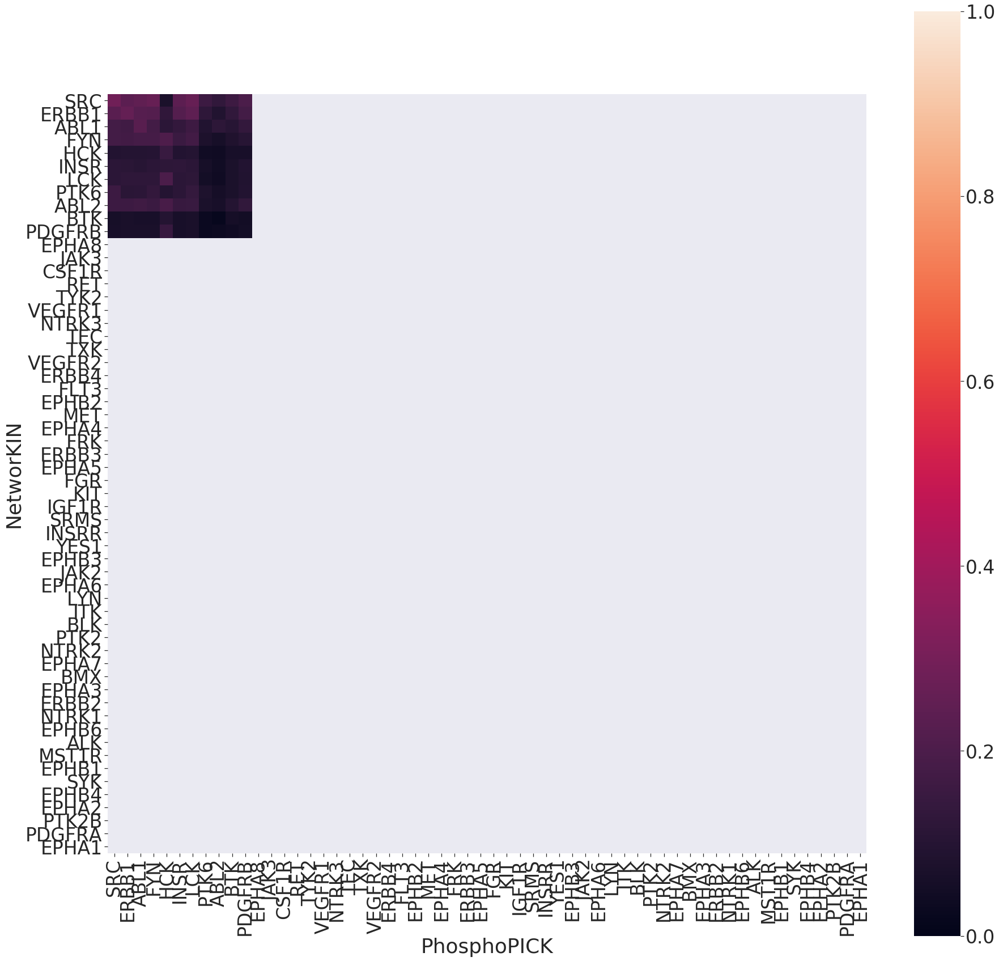

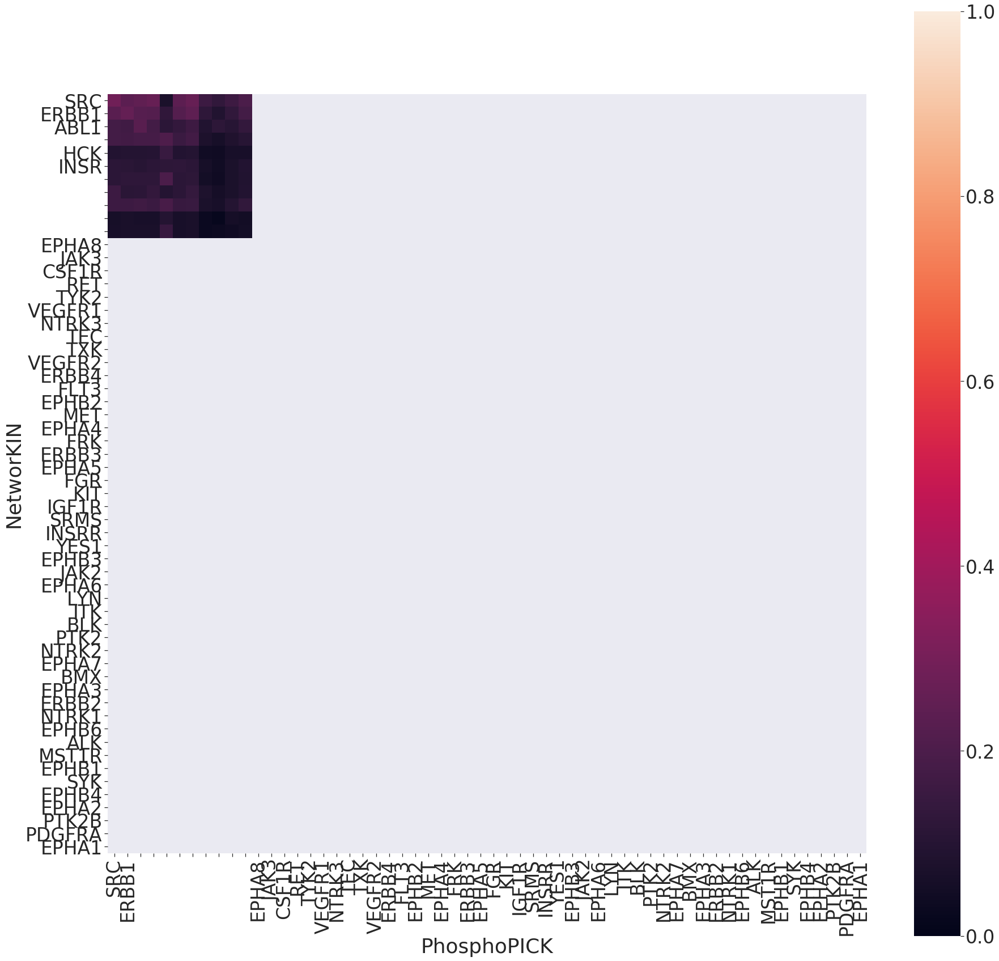

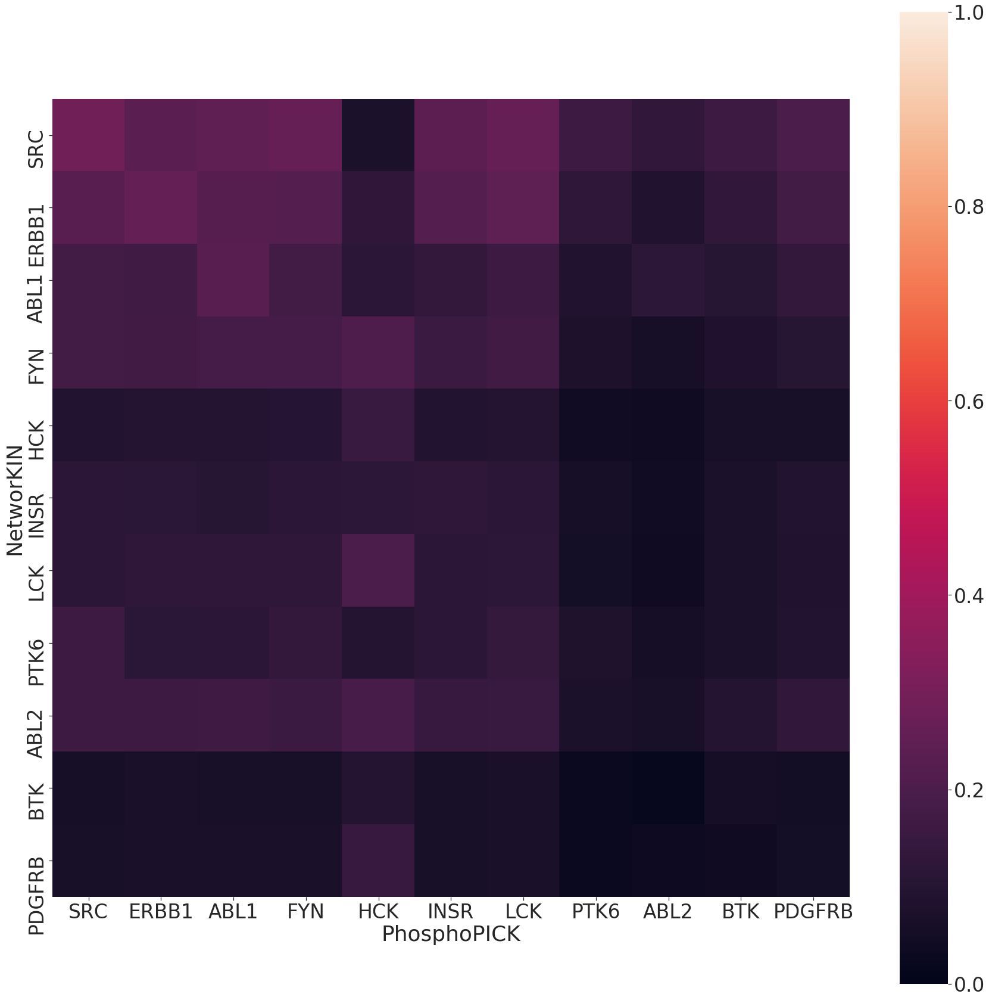

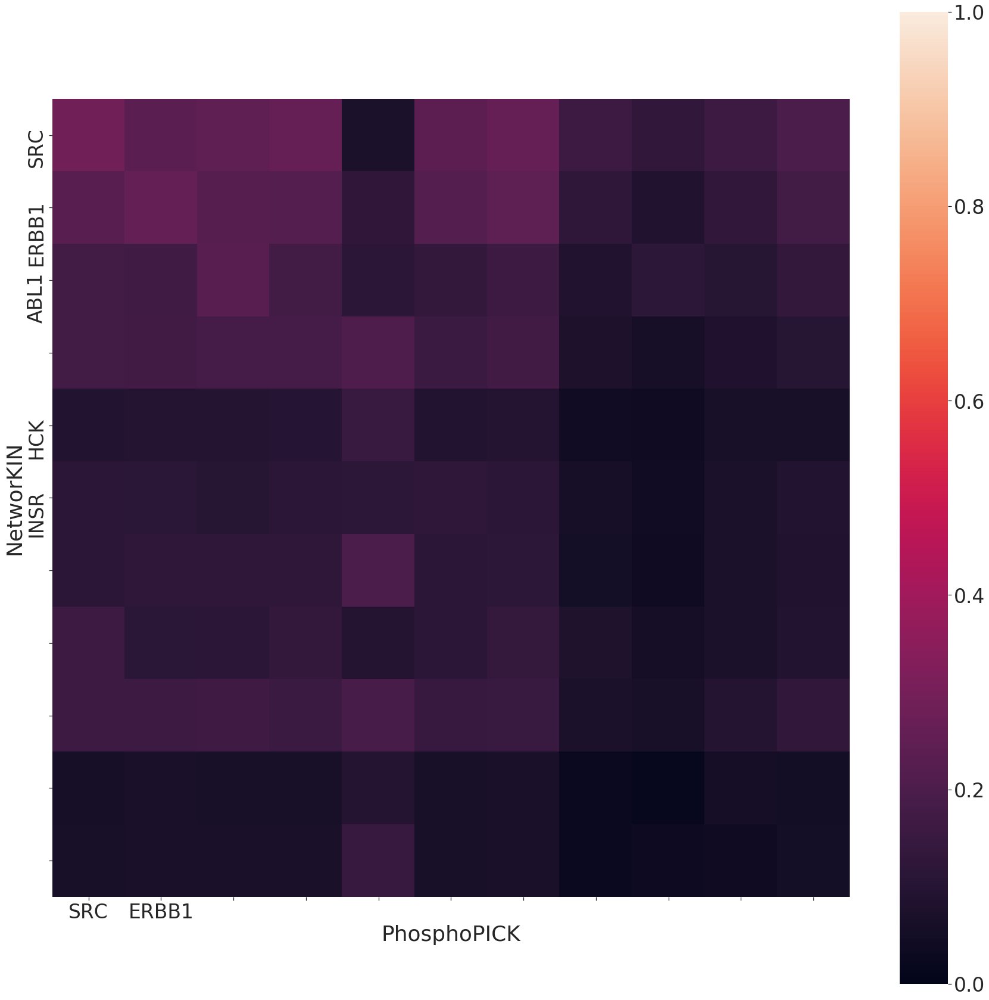

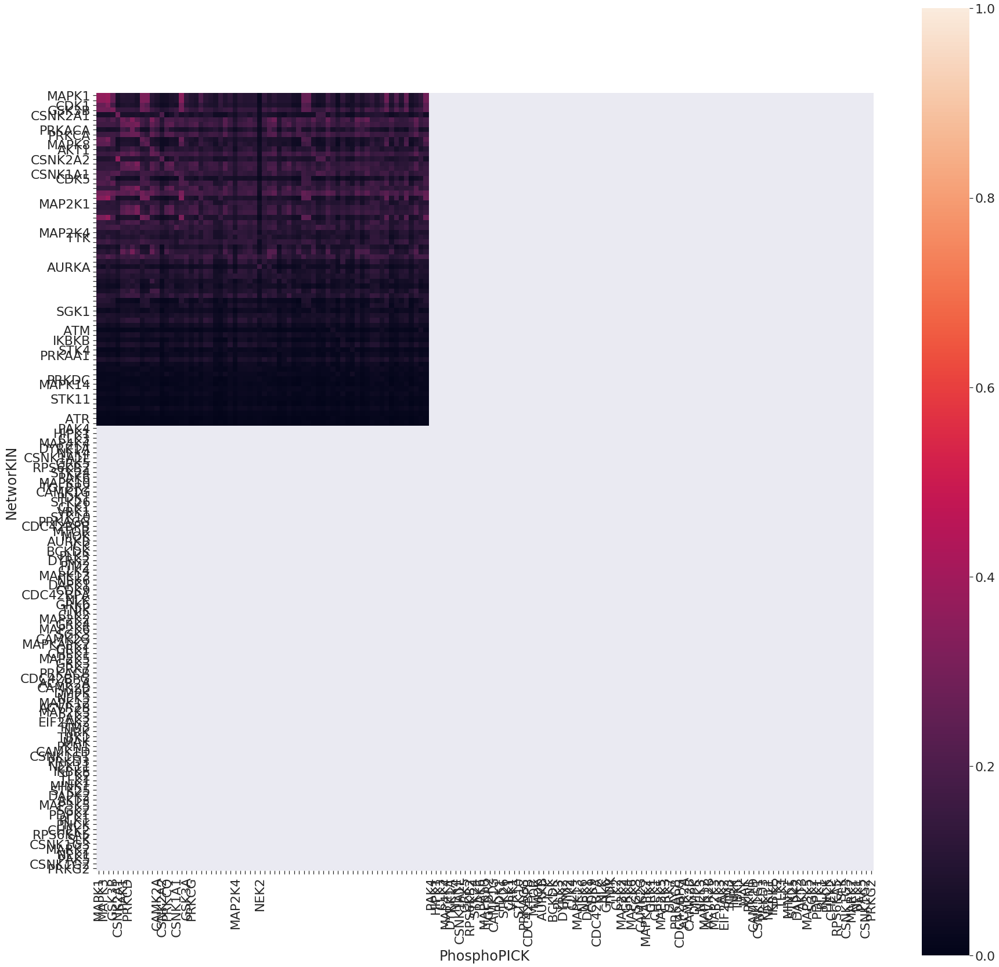

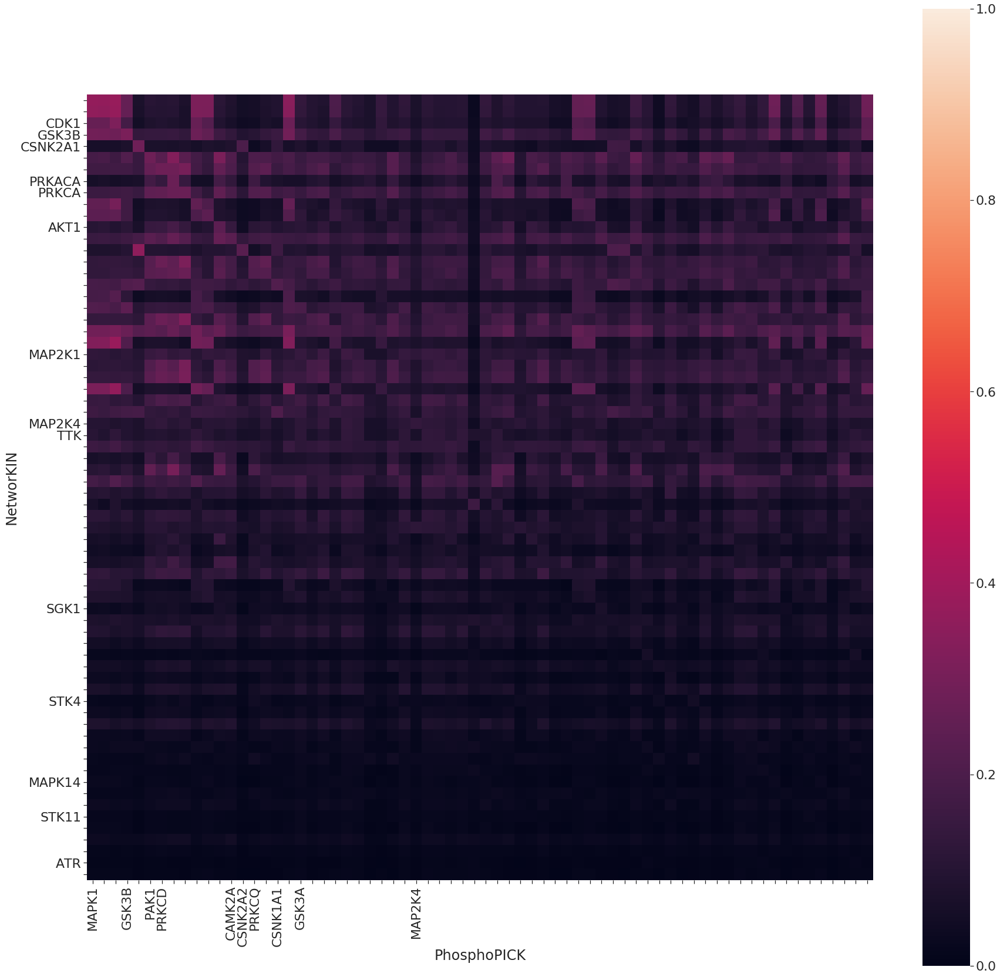

In [6]:
# Plot the network similarity of Jaccard's Index
# Y kinases
# calculate Jaccard's Indexes
heatmap_y_l = kinase_mutual_information.between_predictors(nw03_y, pp1_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_NetworKIN_vs_PhosphoPICK_low_Y_kinase_heatmap_df')
# plot the heatmap
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_l, heatmap_p_dir + d_type +'_NetworKIN_vs_PhosphoPICK_low_Y_kinase', 'NetworKIN', 'PhosphoPICK', 'y')

# S/Y kinases
heatmap_st_l = kinase_mutual_information.between_predictors(nw03_st, pp1_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_NetworKIN_vs_PhosphoPICK_low_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_l, heatmap_p_dir + d_type +'_NetworKIN_vs_PhosphoPICK_low_ST_kinase', 'NetworKIN', 'PhosphoPICK', 'st')


11 overlapped kinases 
 NetworKIN :  50 kinases 
 PhosphoPICK :  19 kinases 



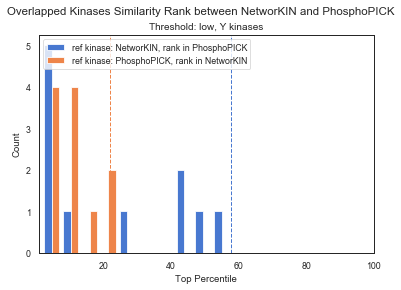

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


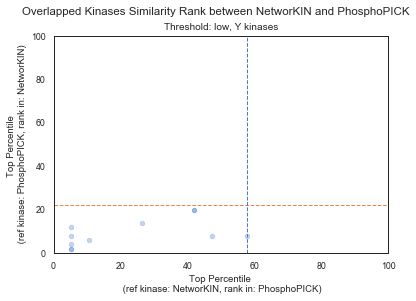

68 overlapped kinases 
 NetworKIN :  140 kinases 
 PhosphoPICK :  87 kinases 



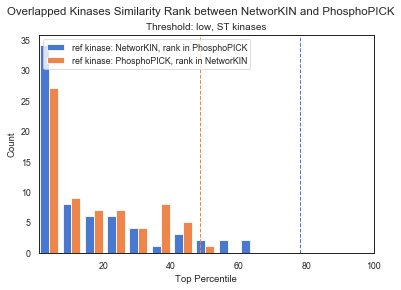

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


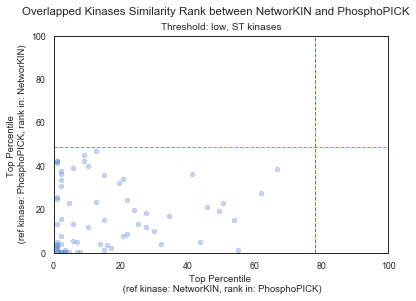

In [6]:
# Plot the same-kinase network similarly ranks in the compared predictors 
# Y kinase
# load the Jaccard's index matrix if not already defined
heatmap_y_l = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_vs_PhosphoPICK_low_Y_kinase_heatmap_df.csv', index_col = 0)
# get the same-kinase similarly ranks
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_l, nw03_y, pp1_y , 'NetworKIN', 'PhosphoPICK' )
# save the ranking summary df 
kin_rank_y.to_csv(rank_data_dir + d_type +'_low_Y_nw_pp.csv')
# plot the hist and scatter plots for the ranking
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'pp', 'low', 'Y kinases', rank_dir + d_type + '_' )

# S/T kinase
heatmap_st_l = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_vs_PhosphoPICK_low_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_l, nw03_st, pp1_st , 'NetworKIN', 'PhosphoPICK' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_low_ST_nw_pp.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'pp', 'low', 'ST kinases', rank_dir + d_type + '_')


### NetworKIN(0.5) vs PhosphoPICK (0.06)
- index: kinases in NetworKIN
- column: kinases in PhosphoPICK

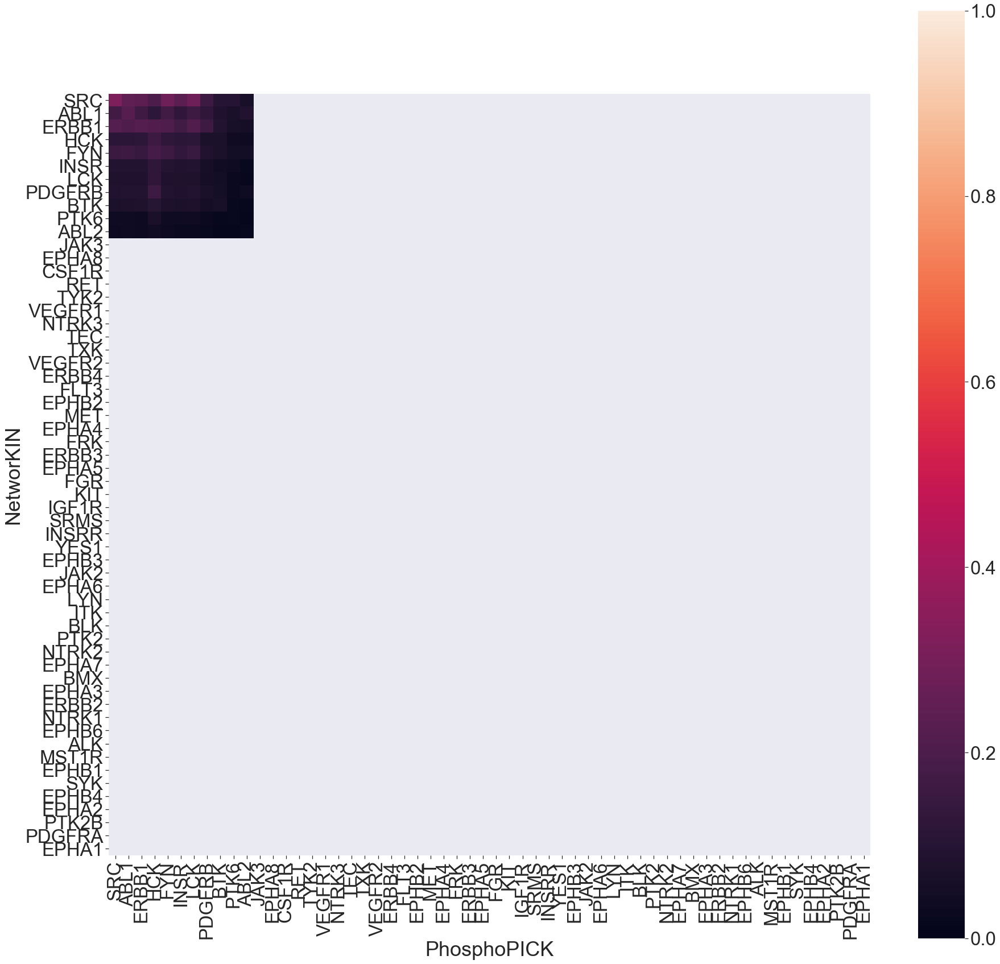

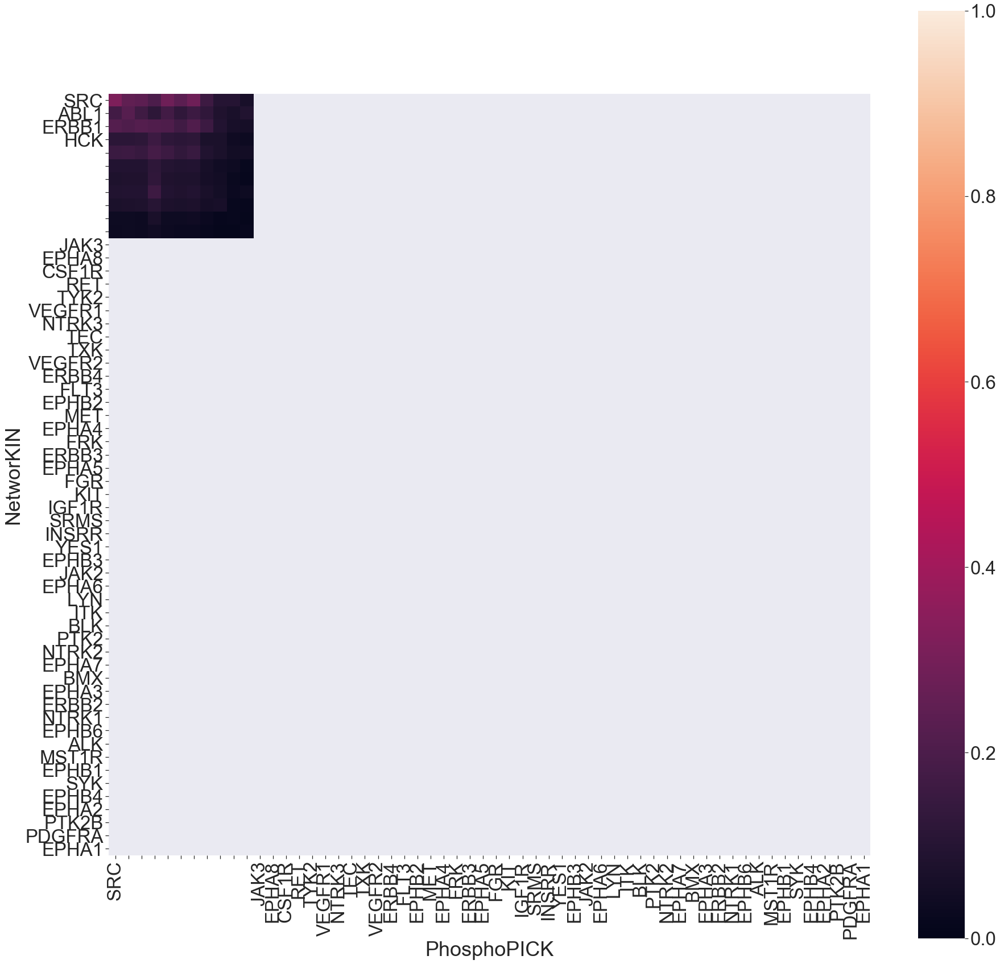

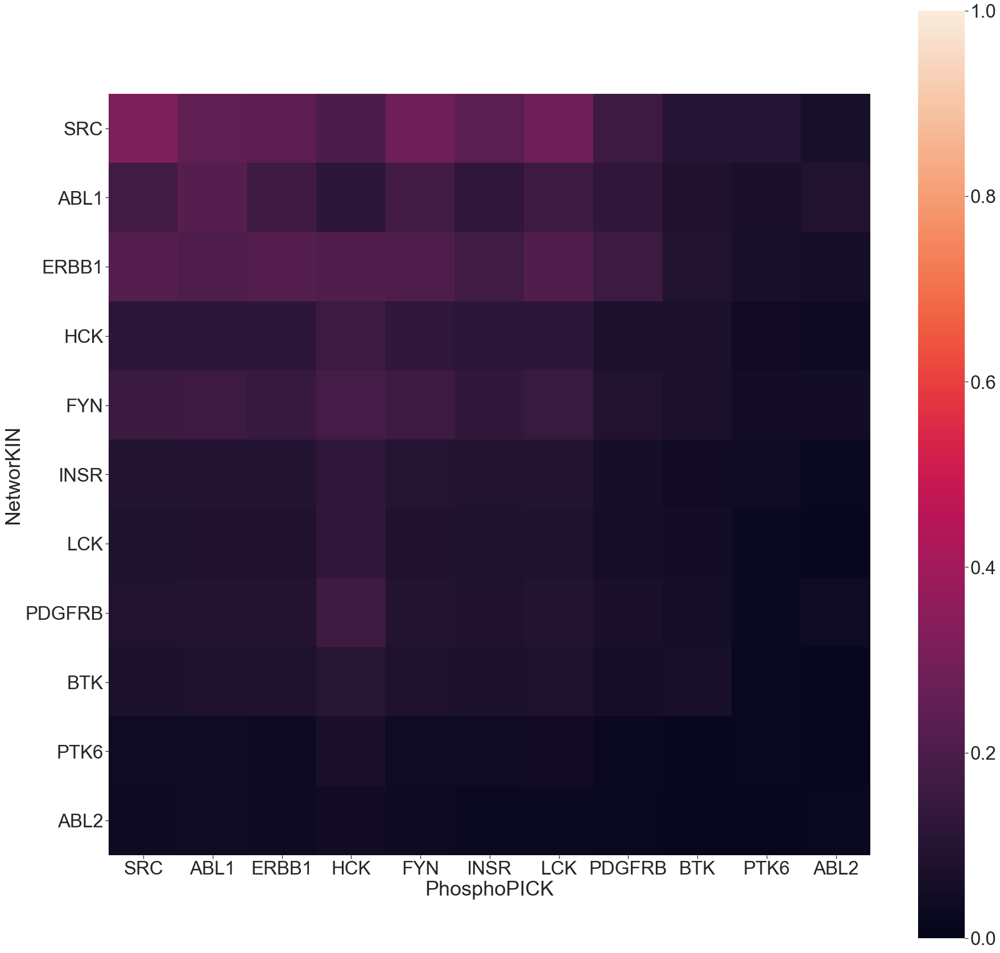

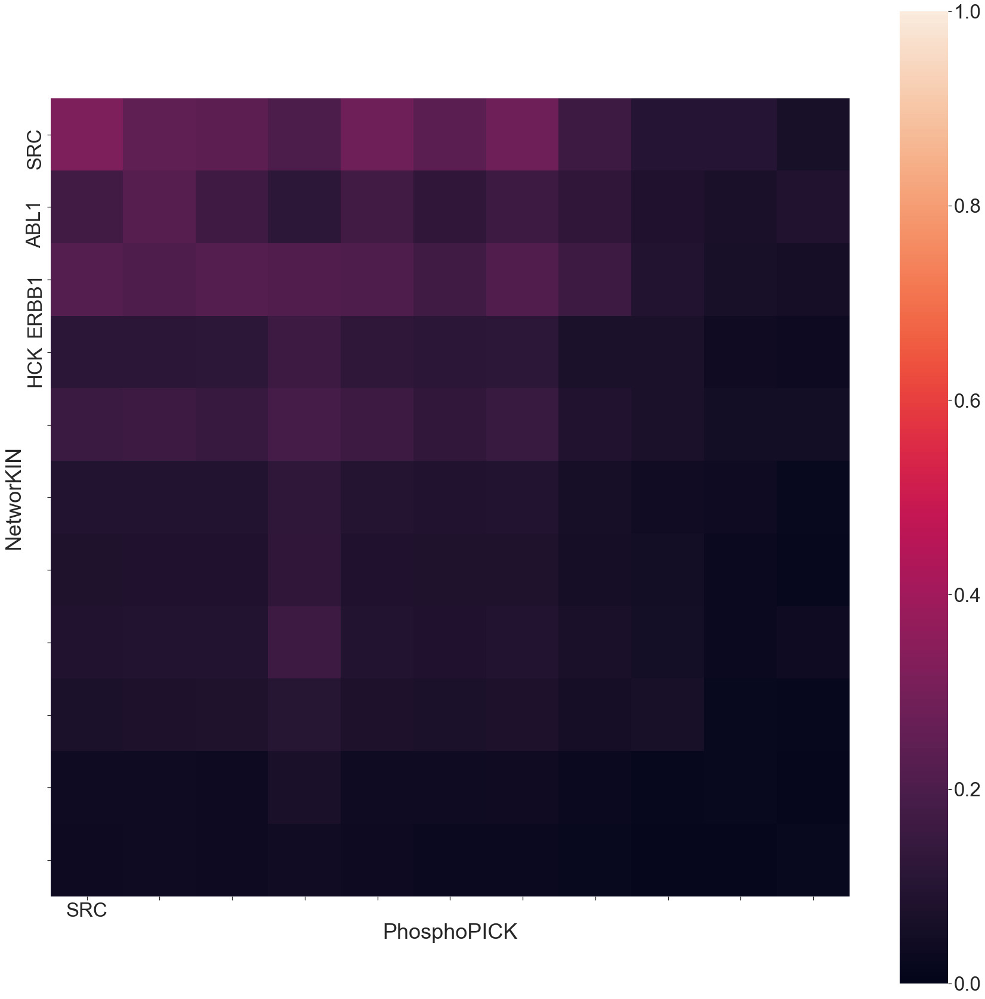

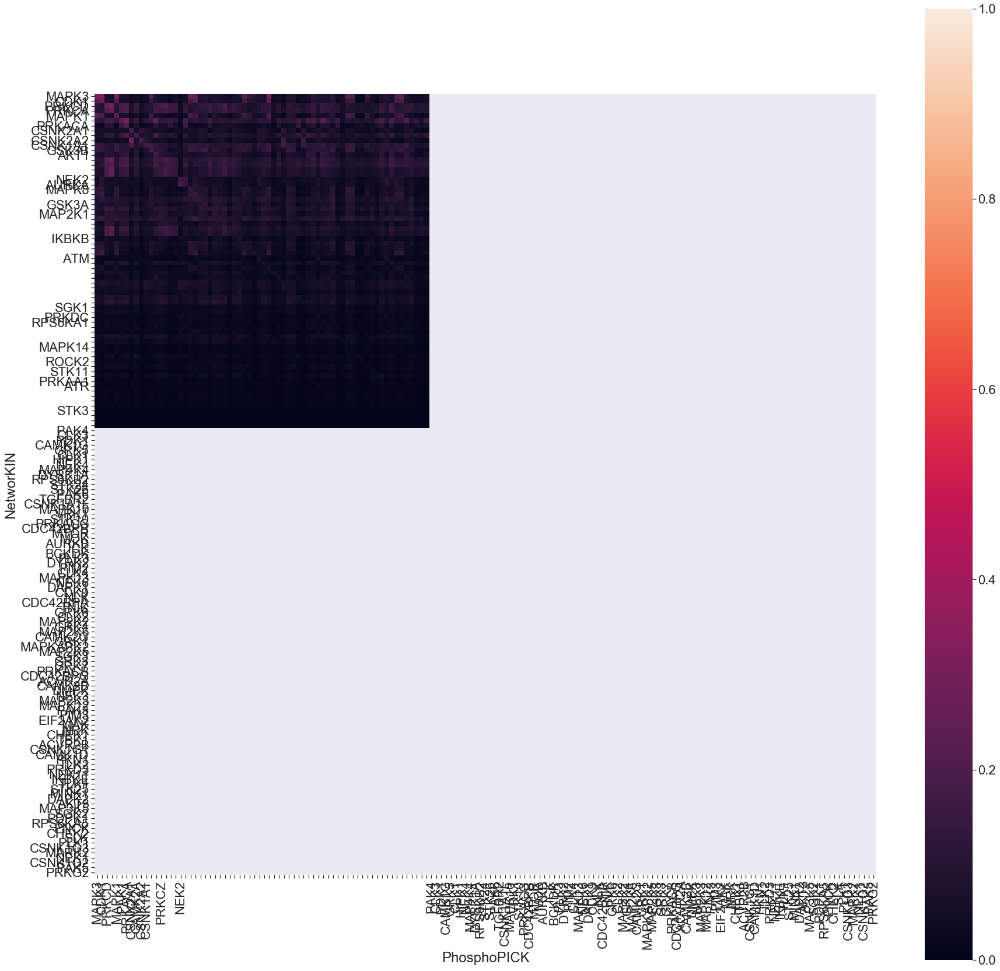

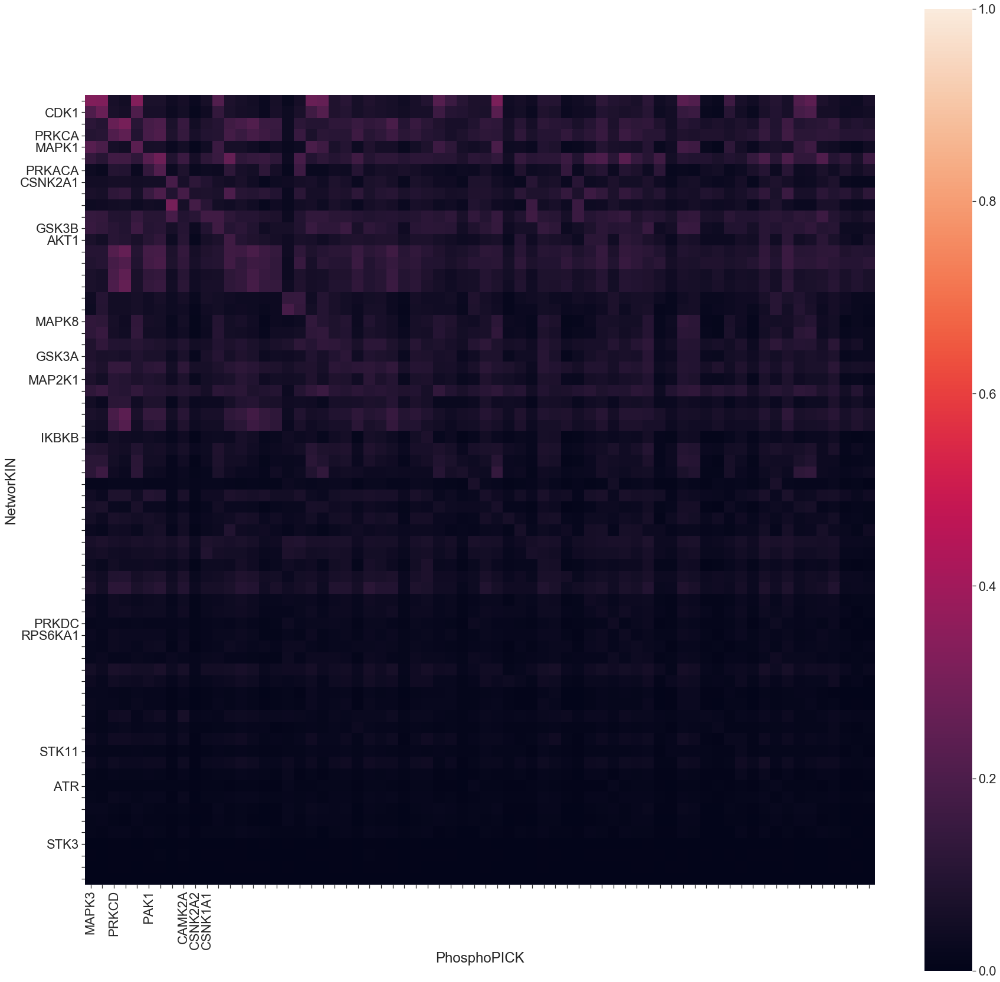

In [8]:
heatmap_y_m = kinase_mutual_information.between_predictors(nw05_y, pp06_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_NetworKIN_vs_PhosphoPICK_med_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_m, heatmap_p_dir  + d_type +'_NetworKIN_vs_PhosphoPICK_med_Y_kinase', 'NetworKIN', 'PhosphoPICK', 'y')

heatmap_st_m = kinase_mutual_information.between_predictors(nw05_st, pp06_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_NetworKIN_vs_PhosphoPICK_med_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_m, heatmap_p_dir + d_type +'_NetworKIN_vs_PhosphoPICK_med_ST_kinase', 'NetworKIN', 'PhosphoPICK', 'st')


11 overlapped kinases 
 NetworKIN :  50 kinases 
 PhosphoPICK :  19 kinases 



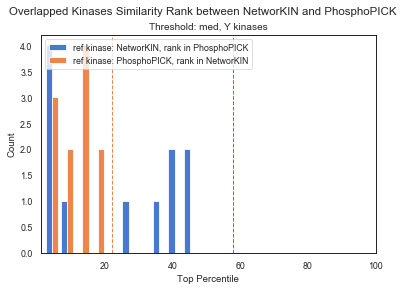

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


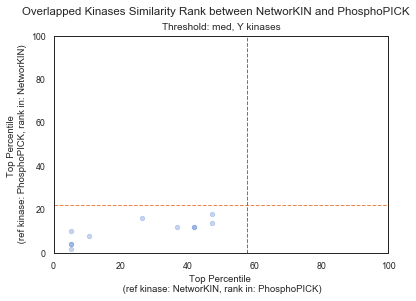

68 overlapped kinases 
 NetworKIN :  140 kinases 
 PhosphoPICK :  87 kinases 



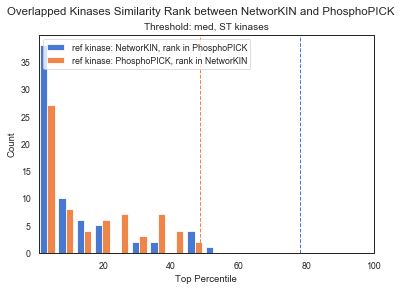

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


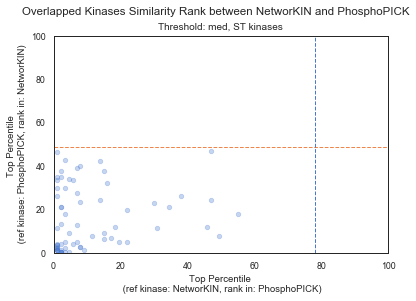

In [7]:
heatmap_y_m = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_vs_PhosphoPICK_med_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_m, nw05_y, pp06_y , 'NetworKIN', 'PhosphoPICK' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_med_Y_nw_pp.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'pp', 'med', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_m = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_vs_PhosphoPICK_med_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_m, nw05_st, pp06_st , 'NetworKIN', 'PhosphoPICK' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_med_ST_nw_pp.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'pp', 'med', 'ST kinases', rank_dir + d_type + '_')


### NetworKIN(1) vs PhosphoPICK (0.02)
- index: kinases in NetworKIN
- column: kinases in PhosphoPICK

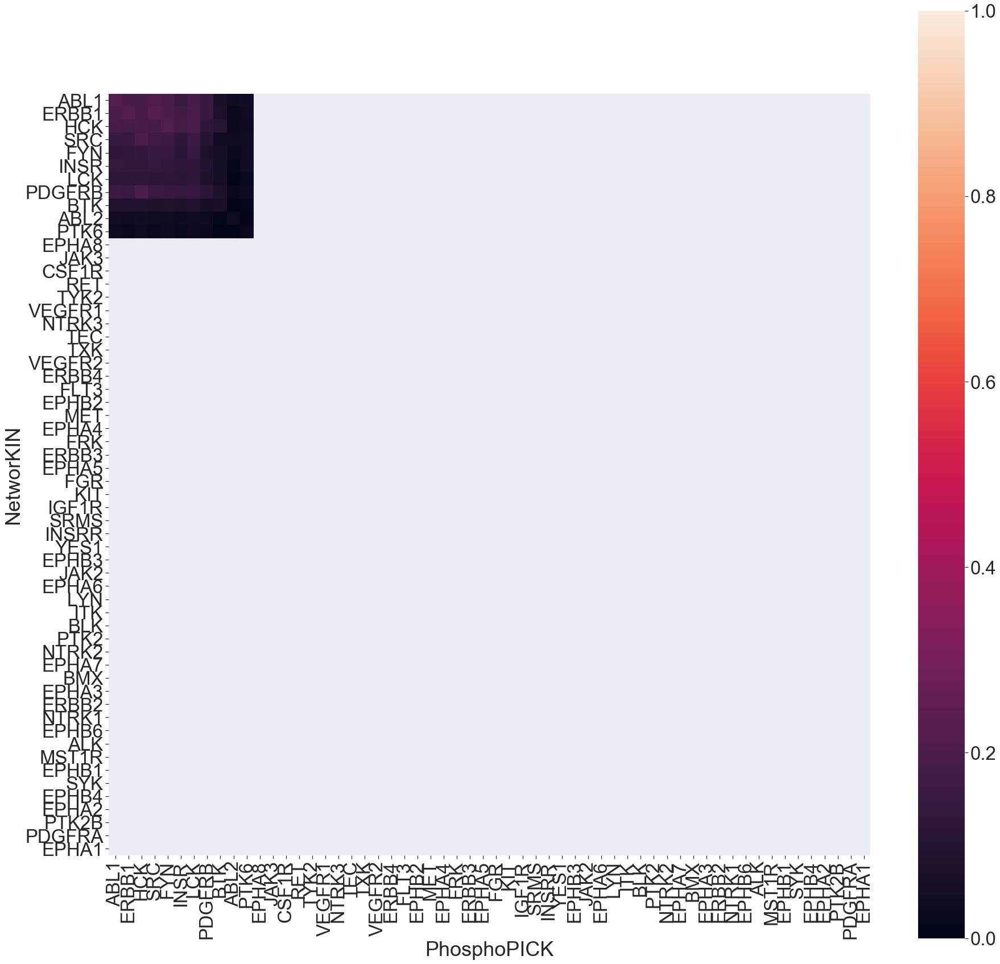

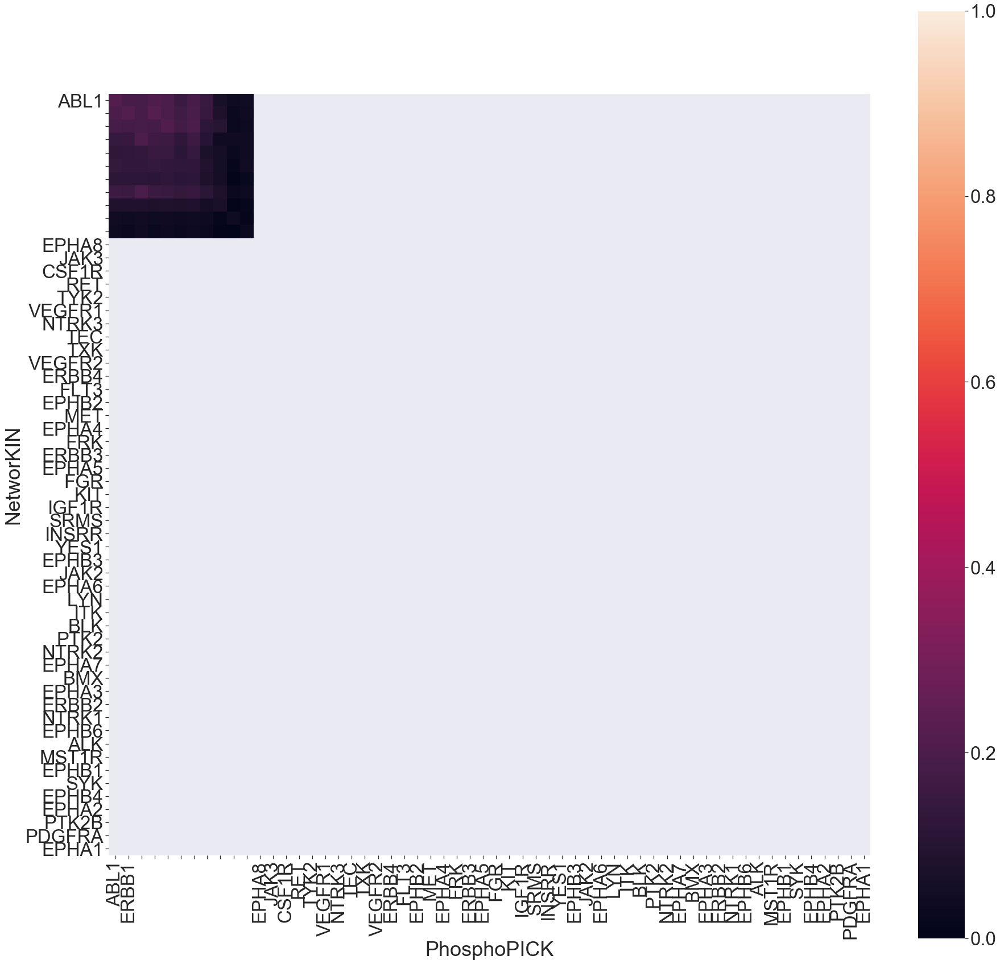

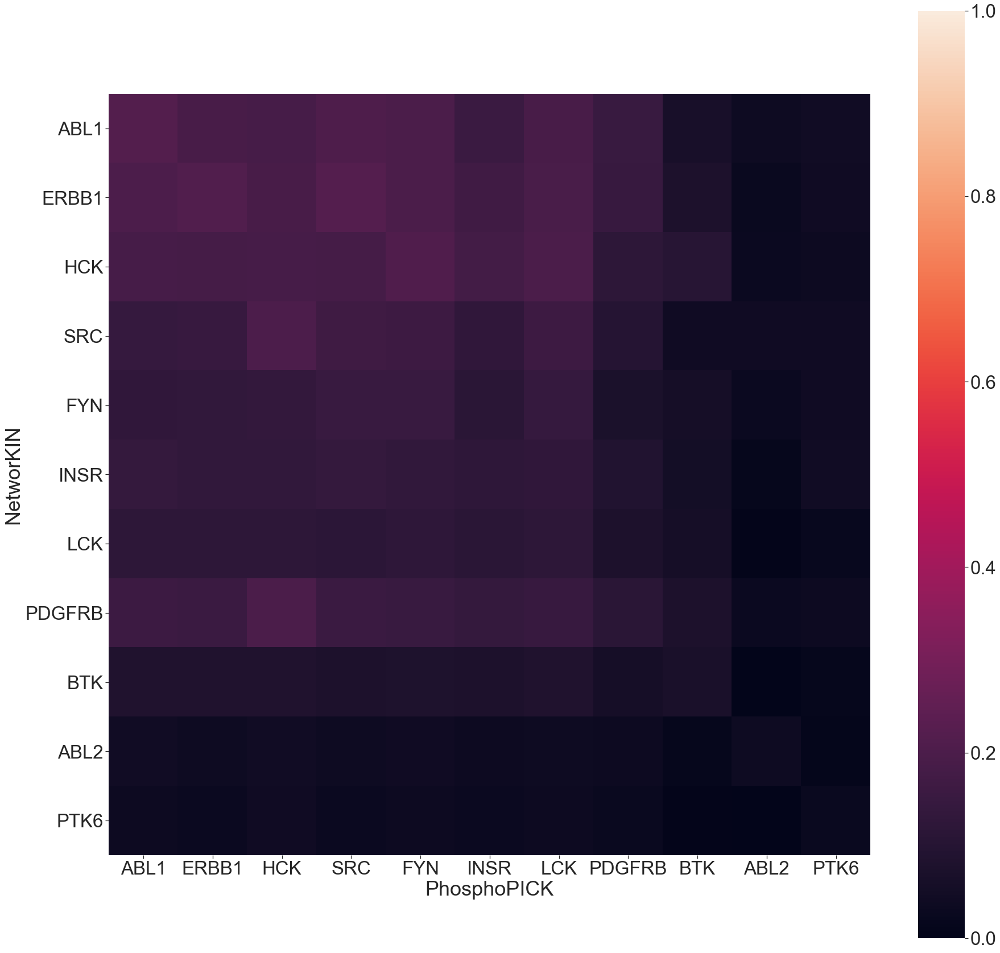

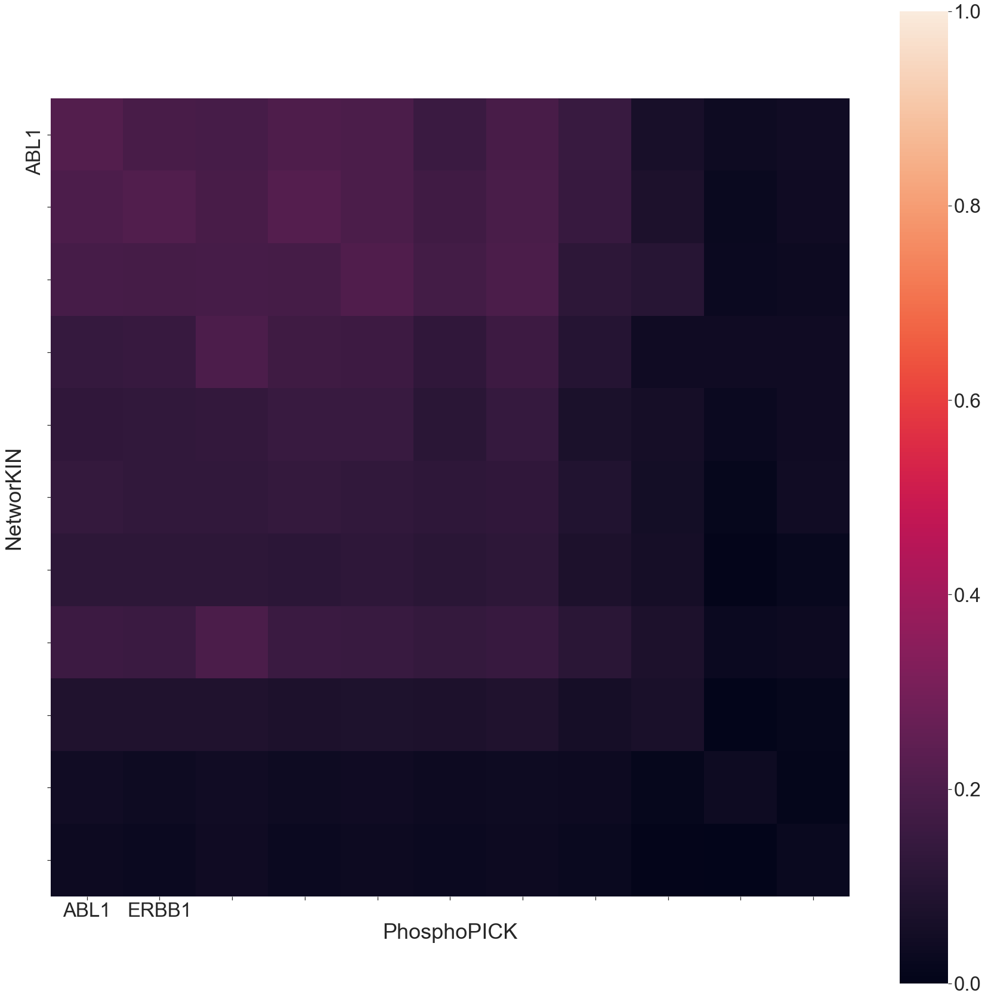

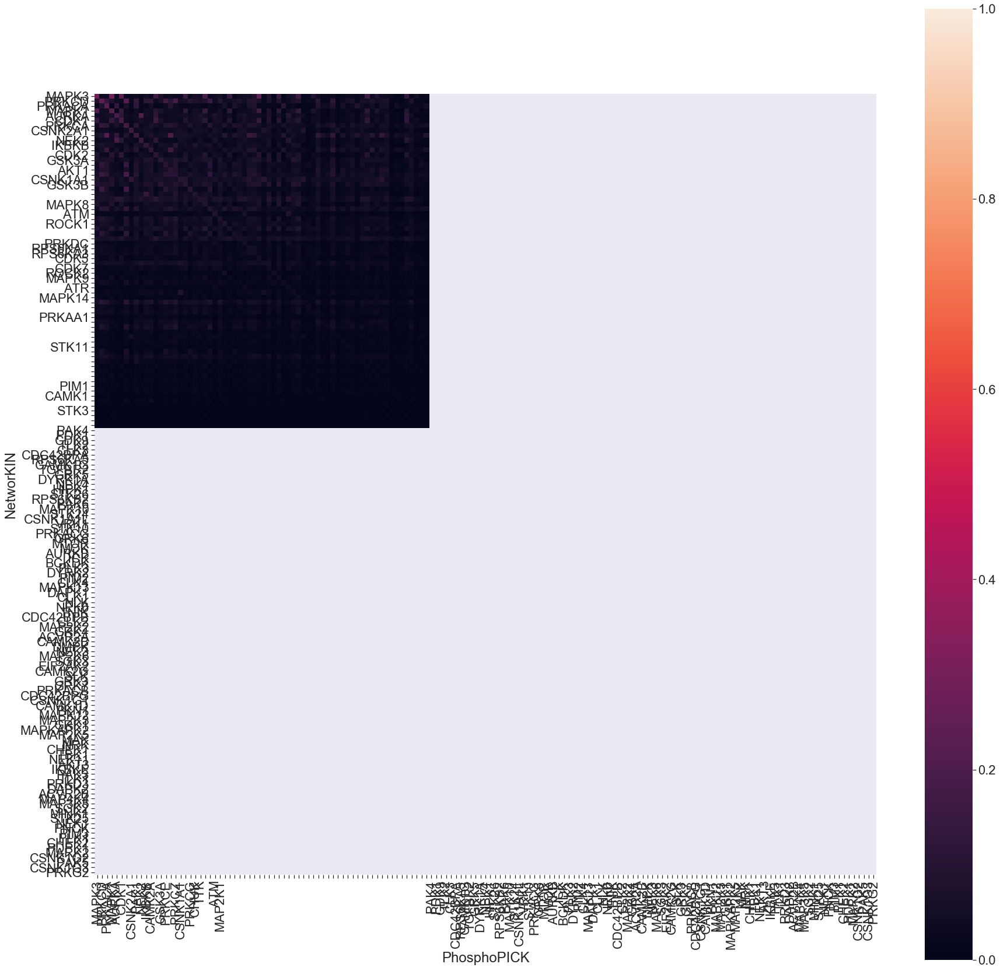

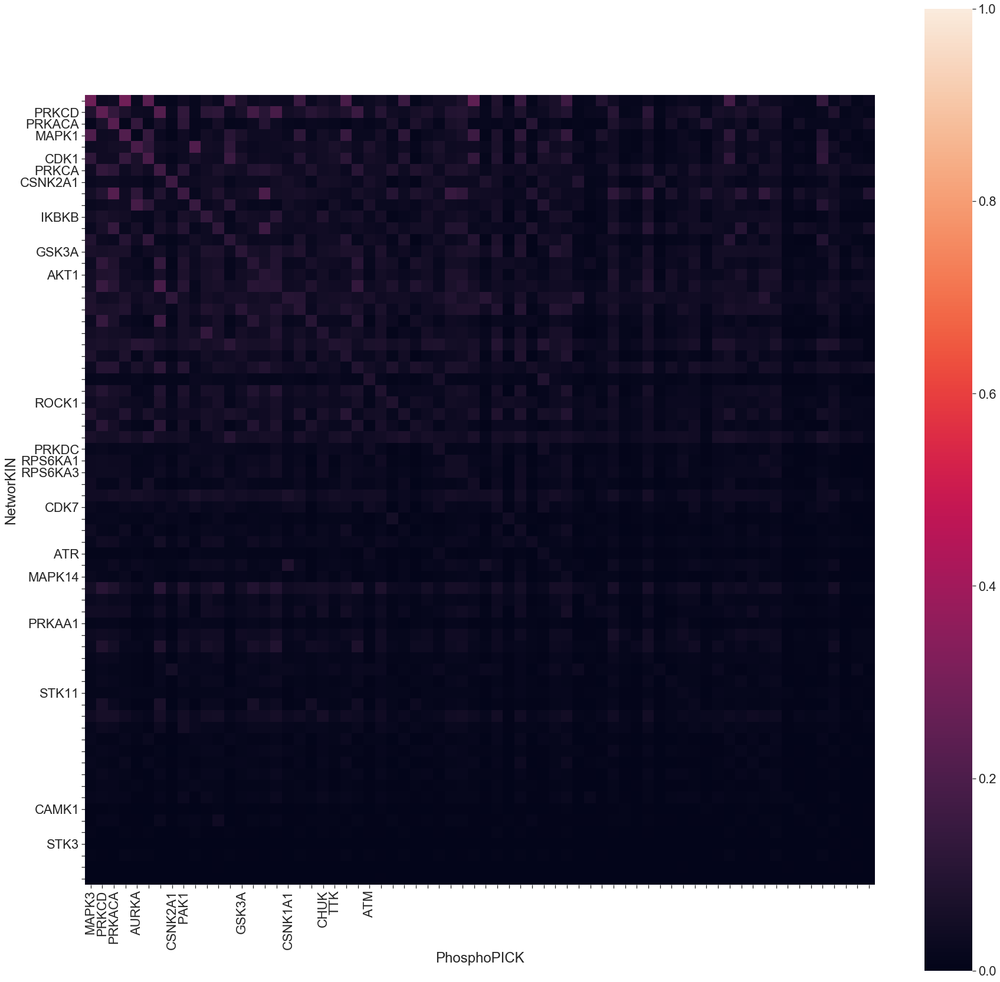

In [10]:
heatmap_y_h = kinase_mutual_information.between_predictors(nw1_y, pp02_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_NetworKIN_vs_PhosphoPICK_high_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_h, heatmap_p_dir  + d_type +'_NetworKIN_vs_PhosphoPICK_high_Y_kinase', 'NetworKIN', 'PhosphoPICK', 'y')

heatmap_st_h = kinase_mutual_information.between_predictors(nw1_st, pp02_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_NetworKIN_vs_PhosphoPICK_high_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_h, heatmap_p_dir + d_type +'_NetworKIN_vs_PhosphoPICK_high_ST_kinase', 'NetworKIN', 'PhosphoPICK', 'st')


11 overlapped kinases 
 NetworKIN :  50 kinases 
 PhosphoPICK :  19 kinases 



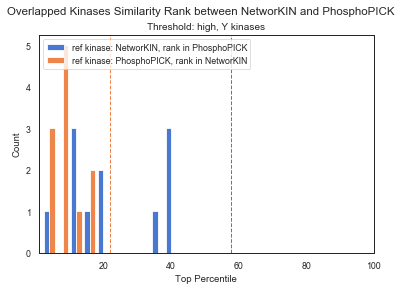

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


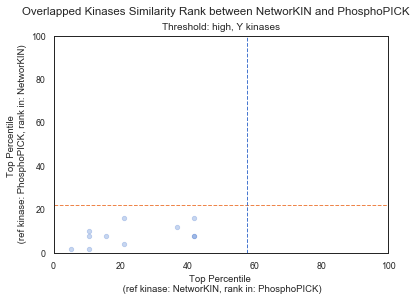

68 overlapped kinases 
 NetworKIN :  140 kinases 
 PhosphoPICK :  87 kinases 



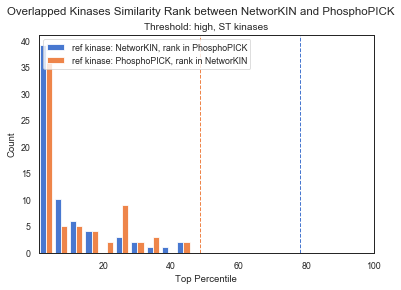

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


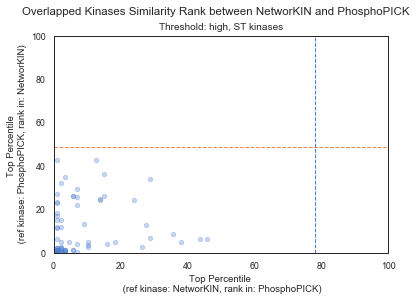

In [8]:
heatmap_y_h = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_vs_PhosphoPICK_high_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_h, nw1_y, pp02_y , 'NetworKIN', 'PhosphoPICK' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_high_Y_nw_pp.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'pp', 'high', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_h = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_vs_PhosphoPICK_high_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_h, nw1_st, pp02_st , 'NetworKIN', 'PhosphoPICK' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_high_ST_nw_pp.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'pp', 'high', 'ST kinases', rank_dir + d_type + '_')


### NetworKIN(0.3) vs GPS5.0 (low)
- index: kinases in NetworKIN
- column: kinases in GPS5.0

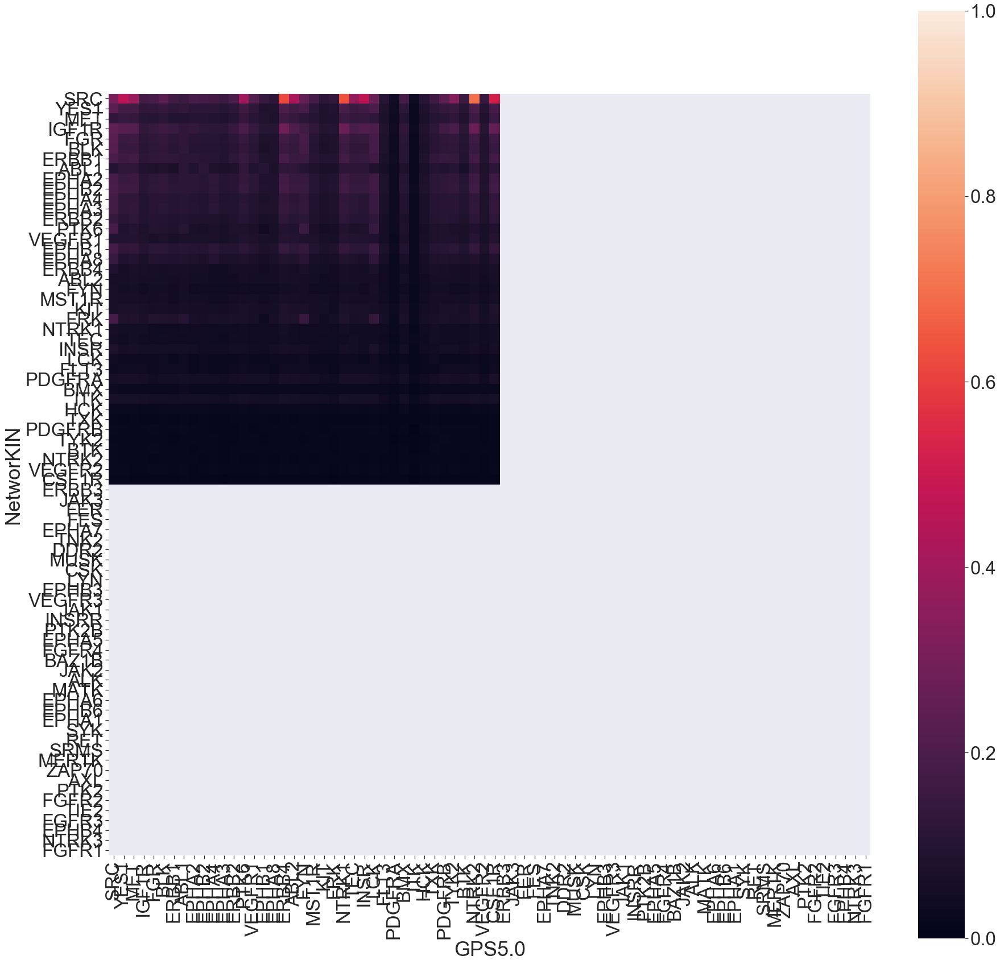

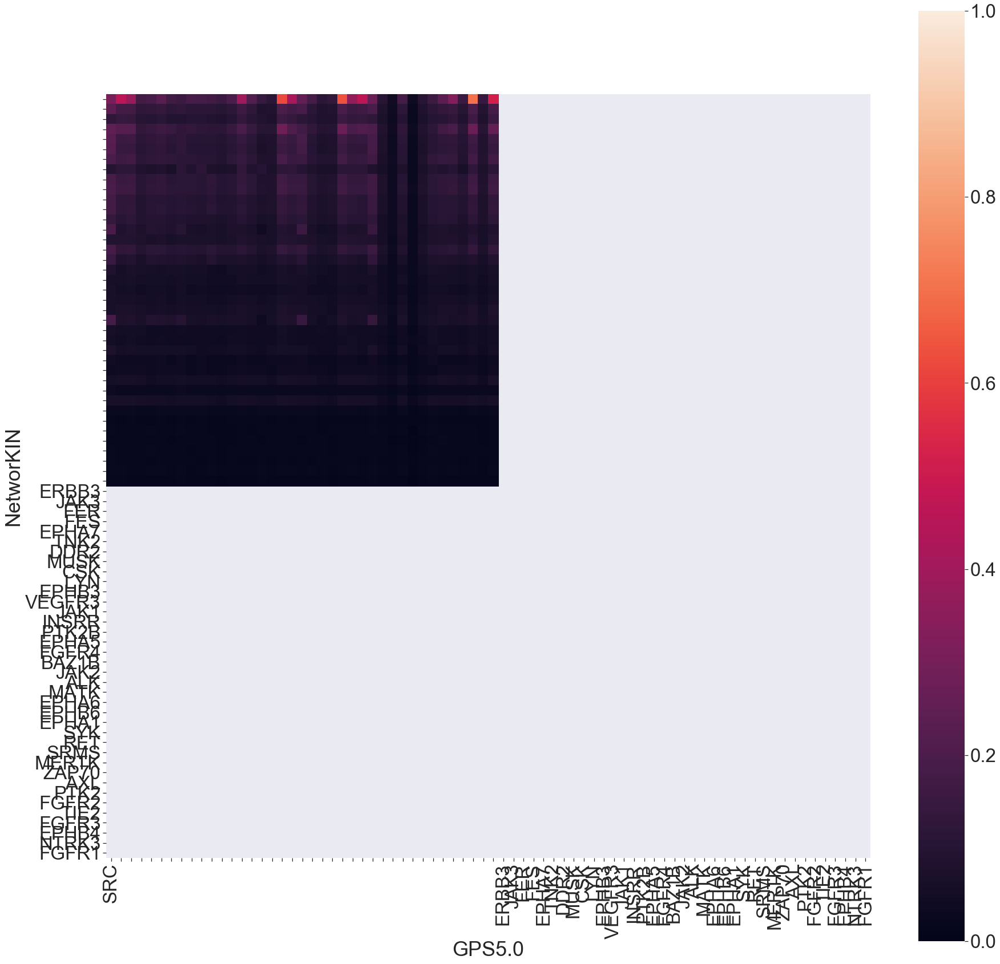

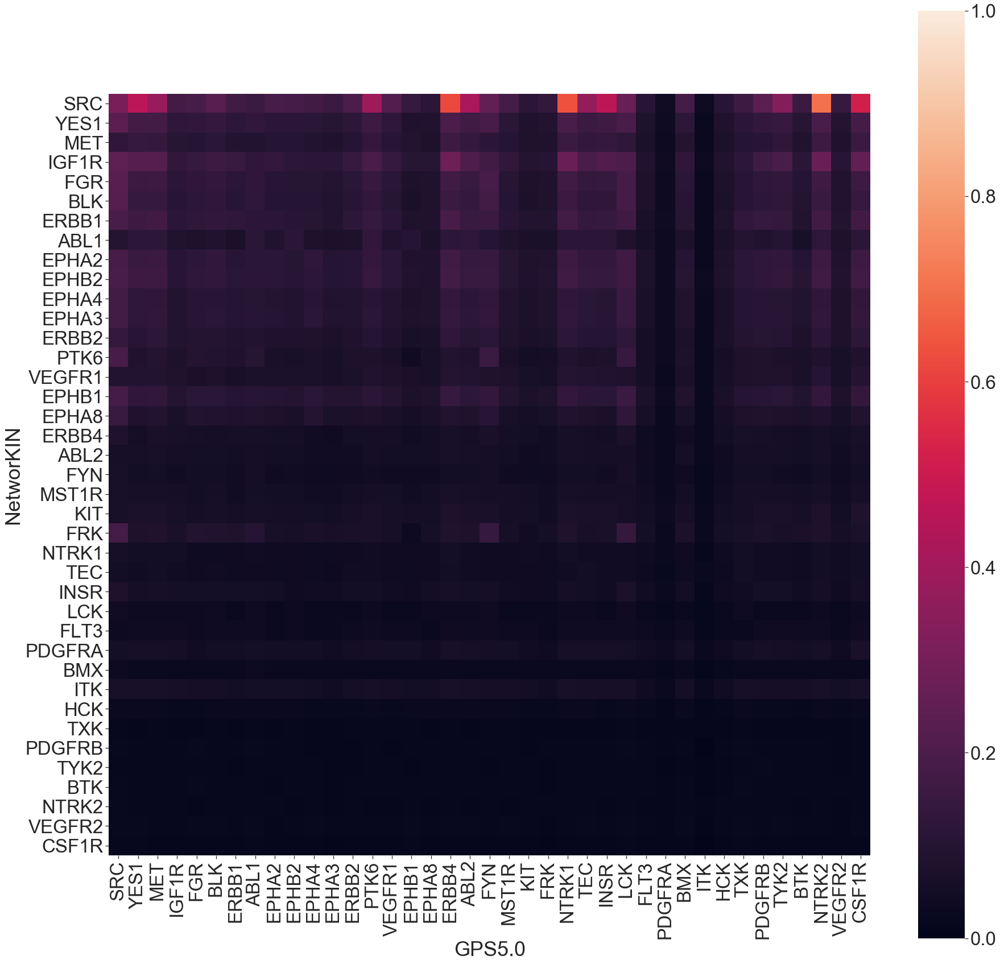

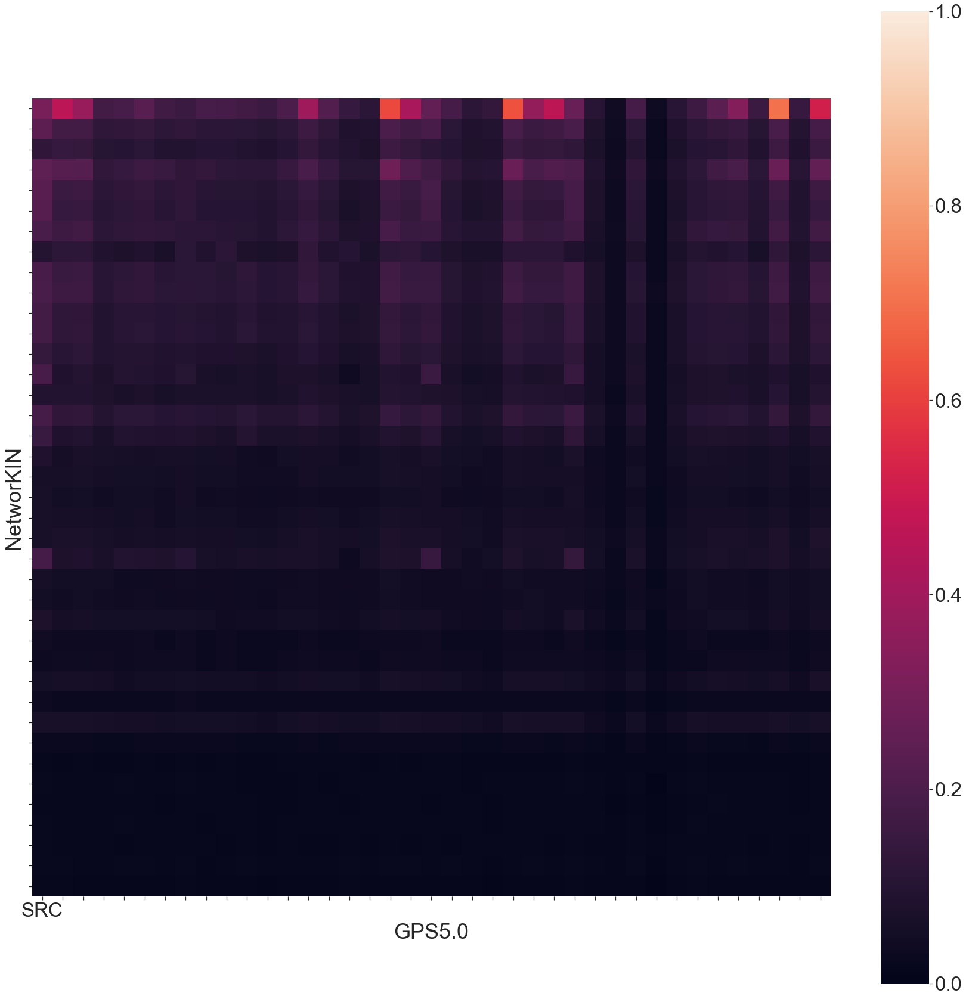

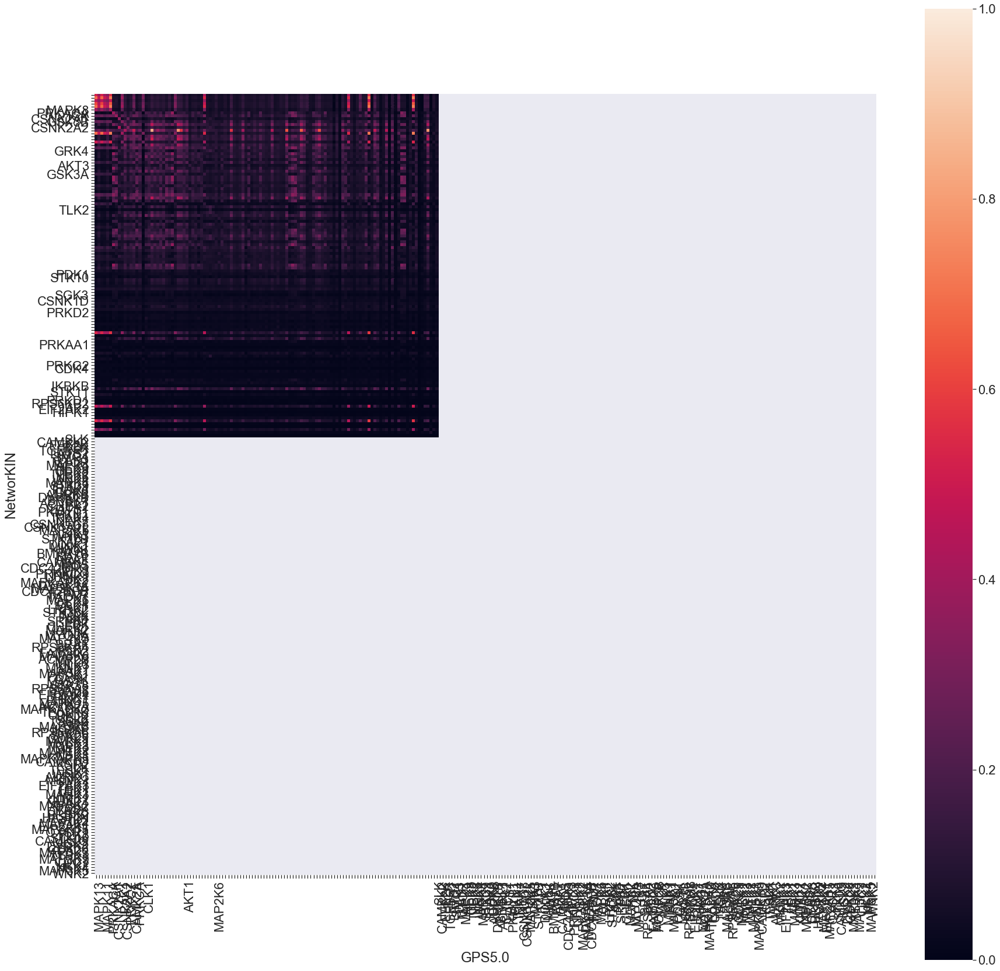

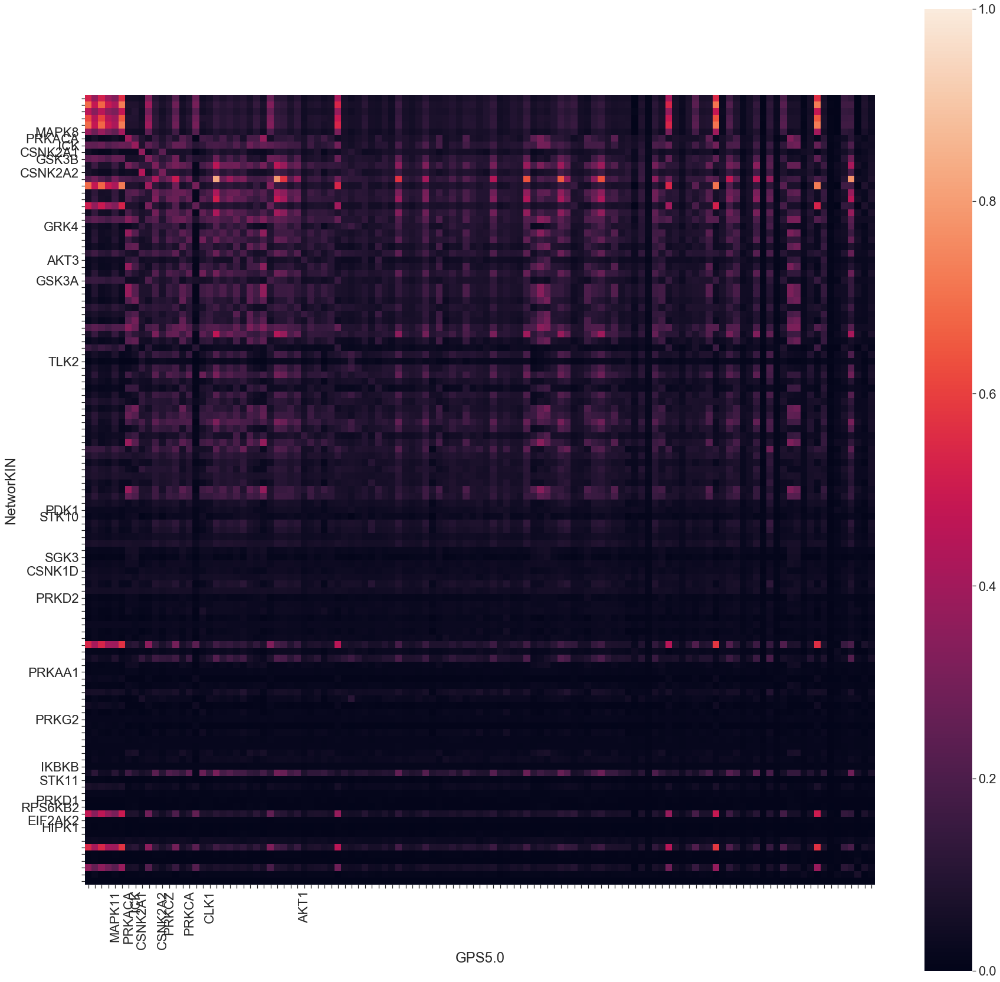

In [27]:
heatmap_y_l = kinase_mutual_information.between_predictors(nw03_y, gpsl_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_NetworKIN_vs_GPS5.0_low_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_l, heatmap_p_dir  + d_type +'_NetworKIN_vs_GPS5.0_low_Y_kinase', 'NetworKIN', 'GPS5.0', 'y')

heatmap_st_l = kinase_mutual_information.between_predictors(nw03_st, gpsl_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_NetworKIN_vs_GPS5.0_low_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_l, heatmap_p_dir + d_type +'_NetworKIN_vs_GPS5.0_low_ST_kinase', 'NetworKIN', 'GPS5.0', 'st')


39 overlapped kinases 
 NetworKIN :  50 kinases 
 GPS :  65 kinases 



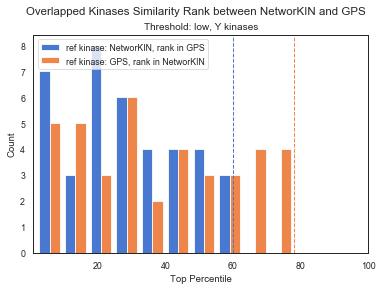

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


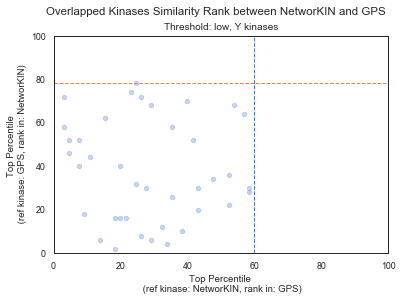

117 overlapped kinases 
 NetworKIN :  140 kinases 
 GPS :  243 kinases 



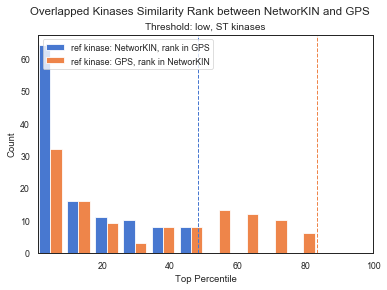

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


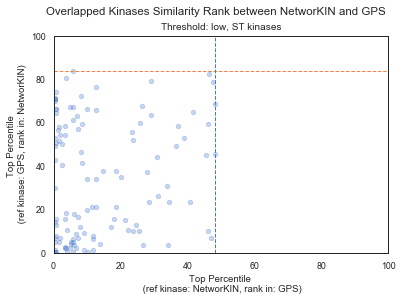

In [9]:
heatmap_y_l = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_vs_GPS5.0_low_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_l, nw03_y, gpsl_y , 'NetworKIN', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_low_Y_nw_gps.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'gps', 'low', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_l = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_vs_GPS5.0_low_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_l, nw03_st, gpsl_st , 'NetworKIN', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_low_ST_nw_gps.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'gps', 'low', 'ST kinases', rank_dir + d_type + '_')


### NetworKIN(0.5) vs GPS5.0 (med)
- index: kinases in NetworKIN
- column: kinases in GPS5.0

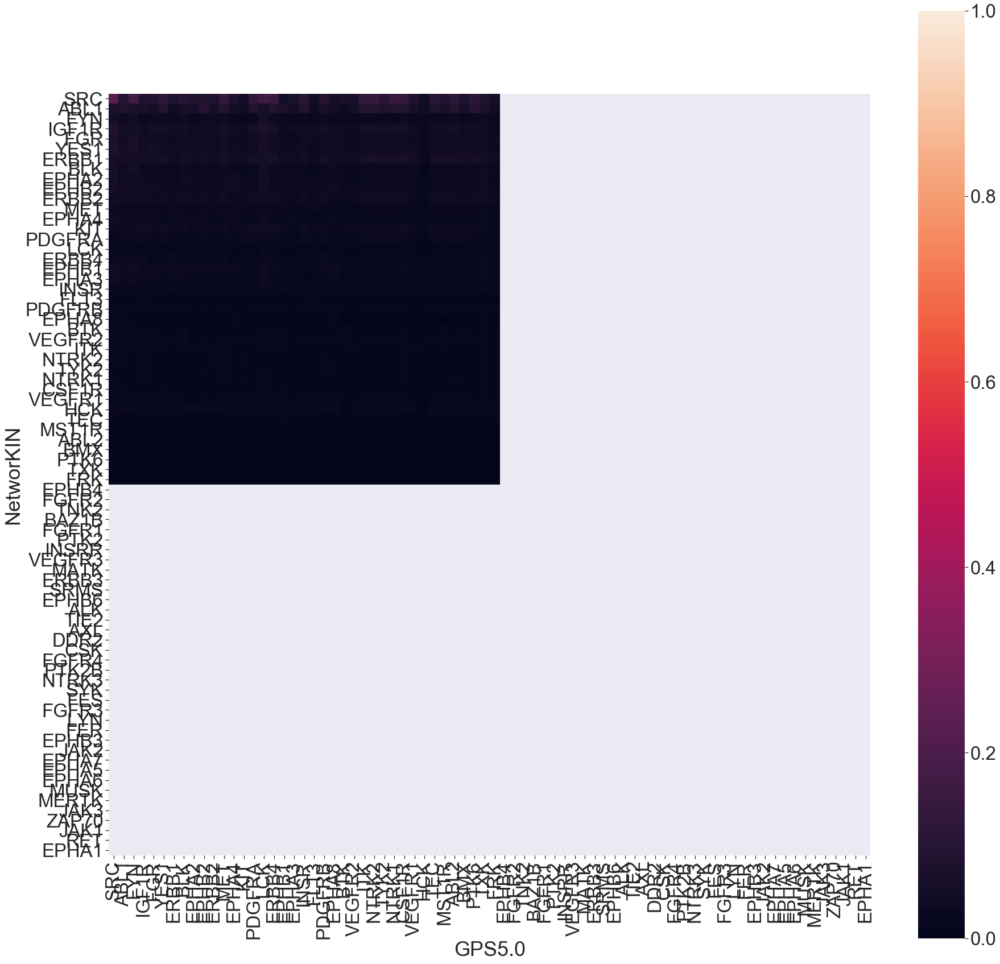

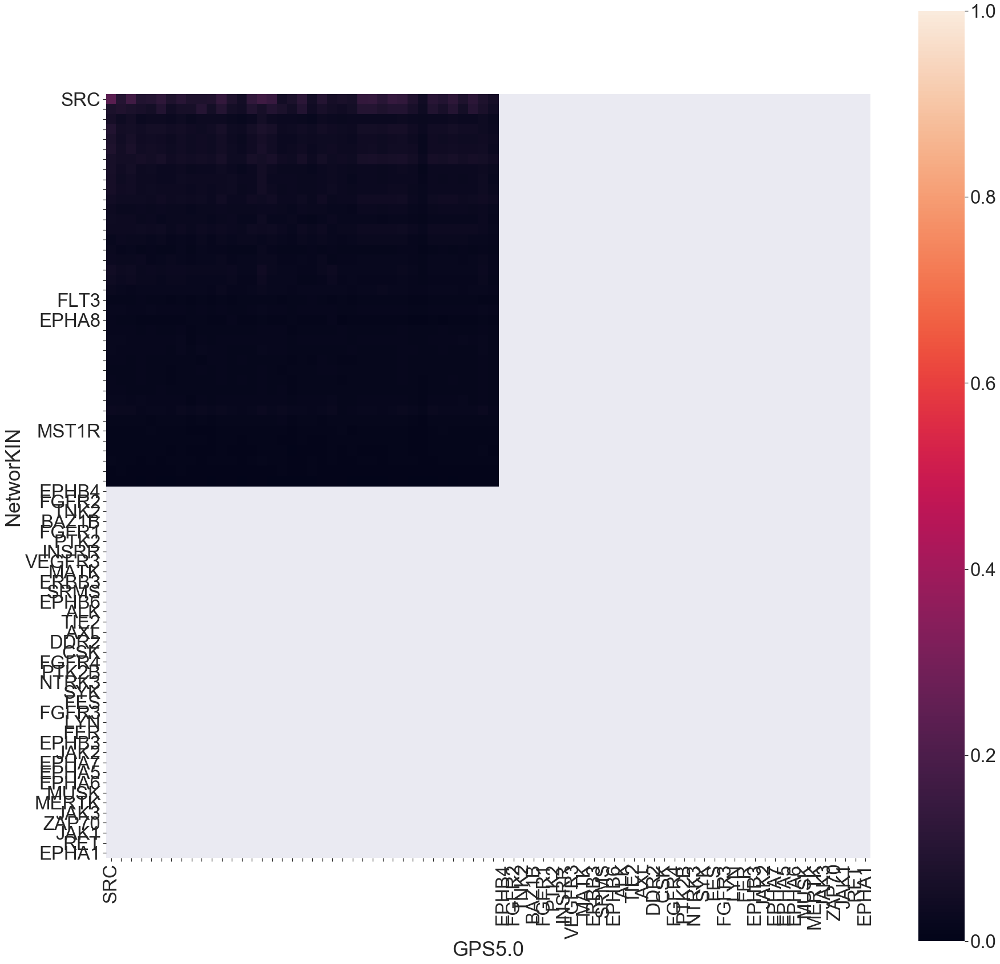

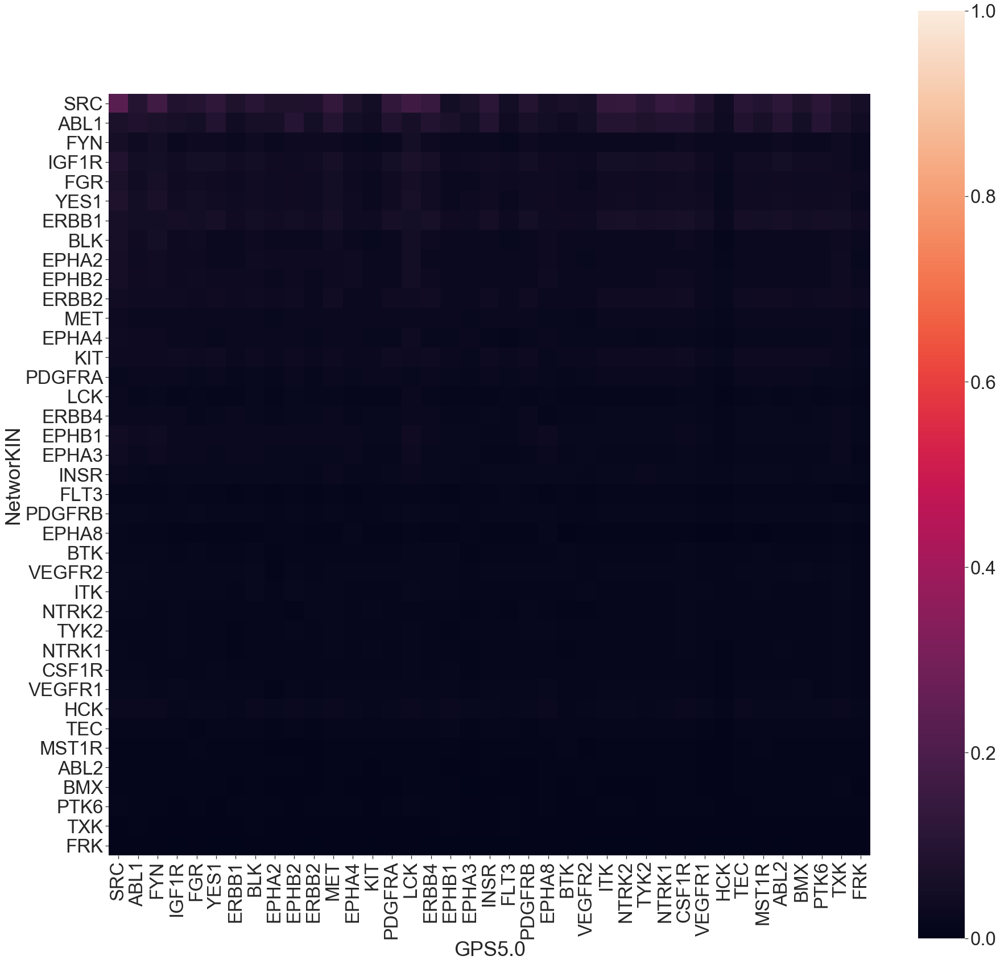

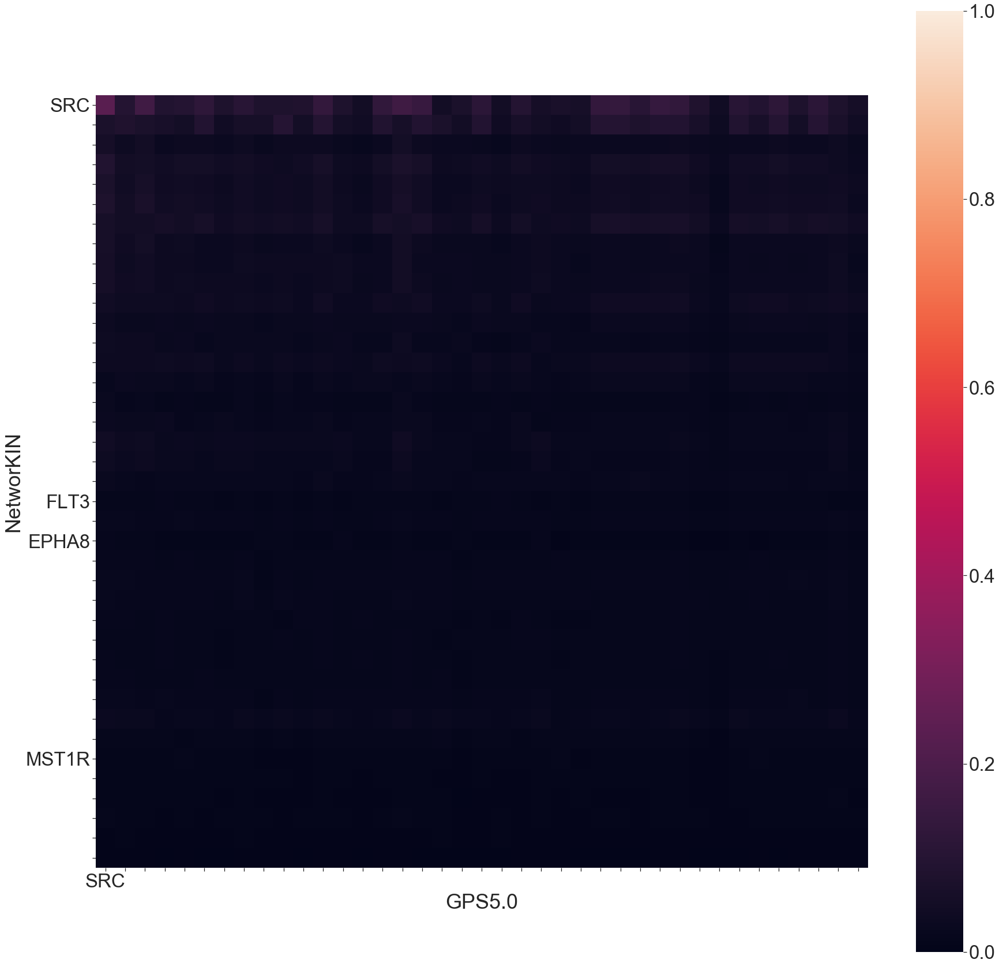

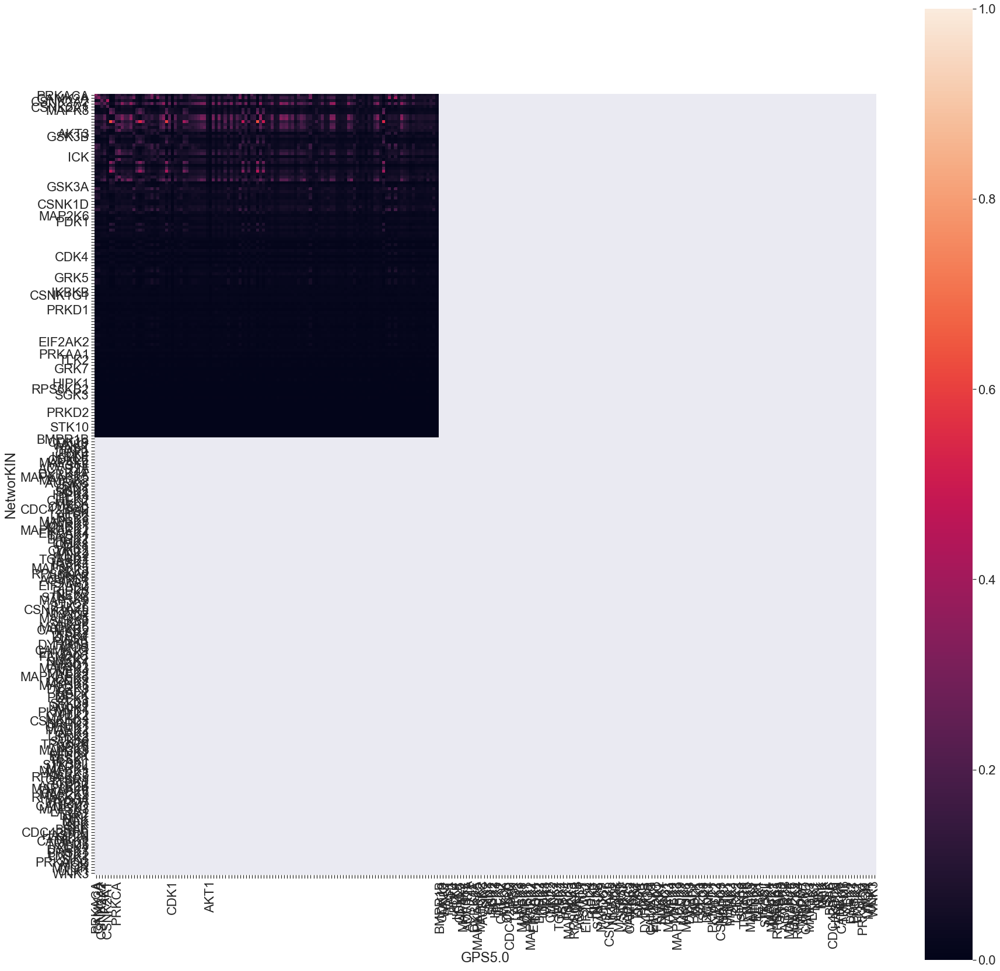

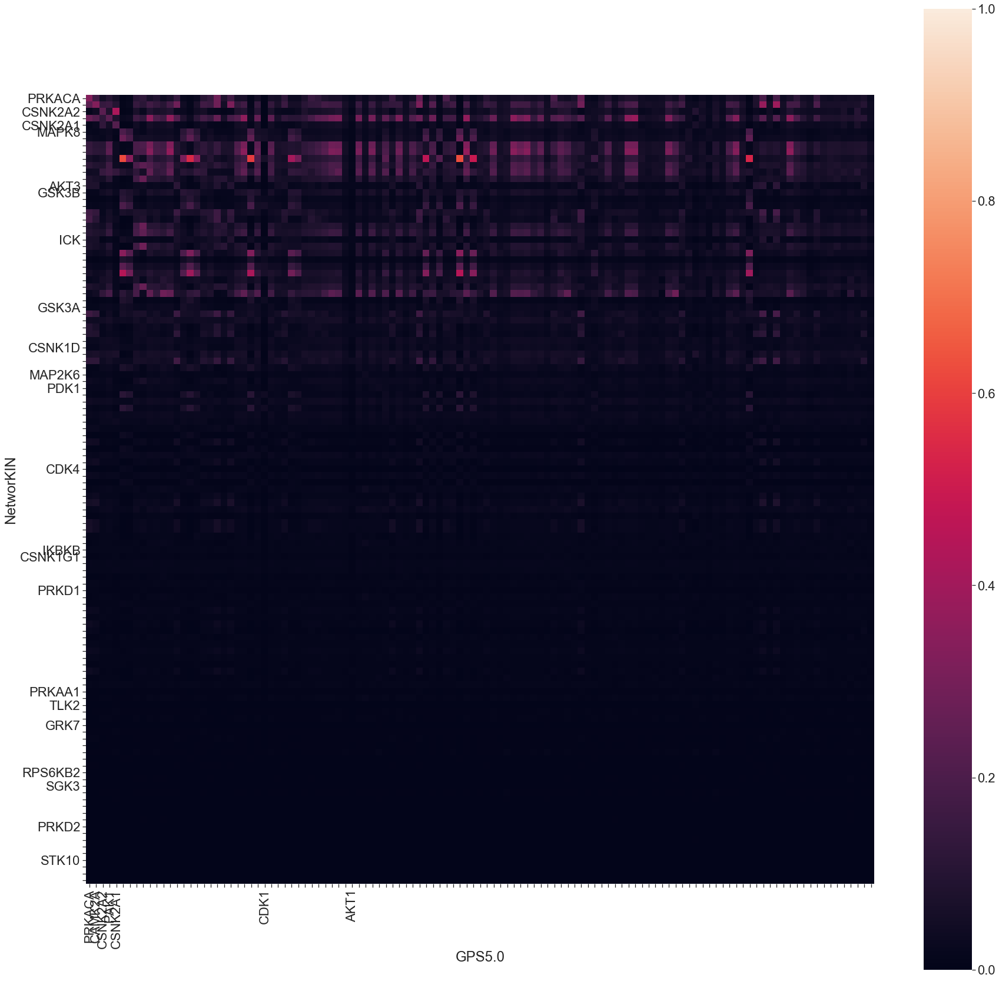

In [20]:
heatmap_y_m = kinase_mutual_information.between_predictors(nw05_y, gpsm_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_NetworKIN_vs_GPS5.0_med_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_m, heatmap_p_dir  + d_type +'_NetworKIN_vs_GPS5.0_med_Y_kinase', 'NetworKIN', 'GPS5.0', 'y')

heatmap_st_m = kinase_mutual_information.between_predictors(nw05_st, gpsm_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_NetworKIN_vs_GPS5.0_med_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_m, heatmap_p_dir + d_type +'_NetworKIN_vs_GPS5.0_med_ST_kinase', 'NetworKIN', 'GPS5.0', 'st')


39 overlapped kinases 
 NetworKIN :  50 kinases 
 GPS :  65 kinases 



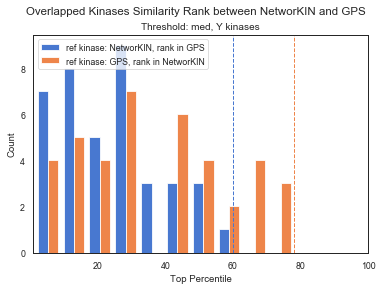

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


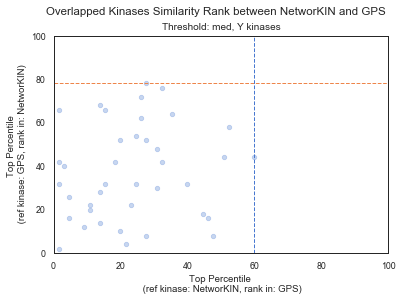

117 overlapped kinases 
 NetworKIN :  140 kinases 
 GPS :  243 kinases 



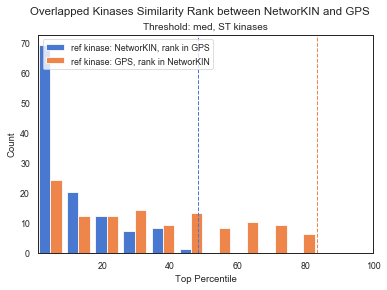

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


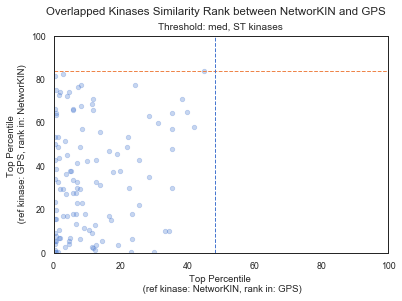

In [10]:
heatmap_y_m = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_vs_GPS5.0_med_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_m, nw05_y, gpsm_y , 'NetworKIN', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_med_Y_nw_gps.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'gps', 'med', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_m = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_vs_GPS5.0_med_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_m, nw05_st, gpsm_st , 'NetworKIN', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_med_ST_nw_gps.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'gps', 'med', 'ST kinases', rank_dir + d_type + '_')


### NetworKIN(1) vs GPS5.0 (high)
- index: kinases in NetworKIN
- column: kinases in GPS5.0

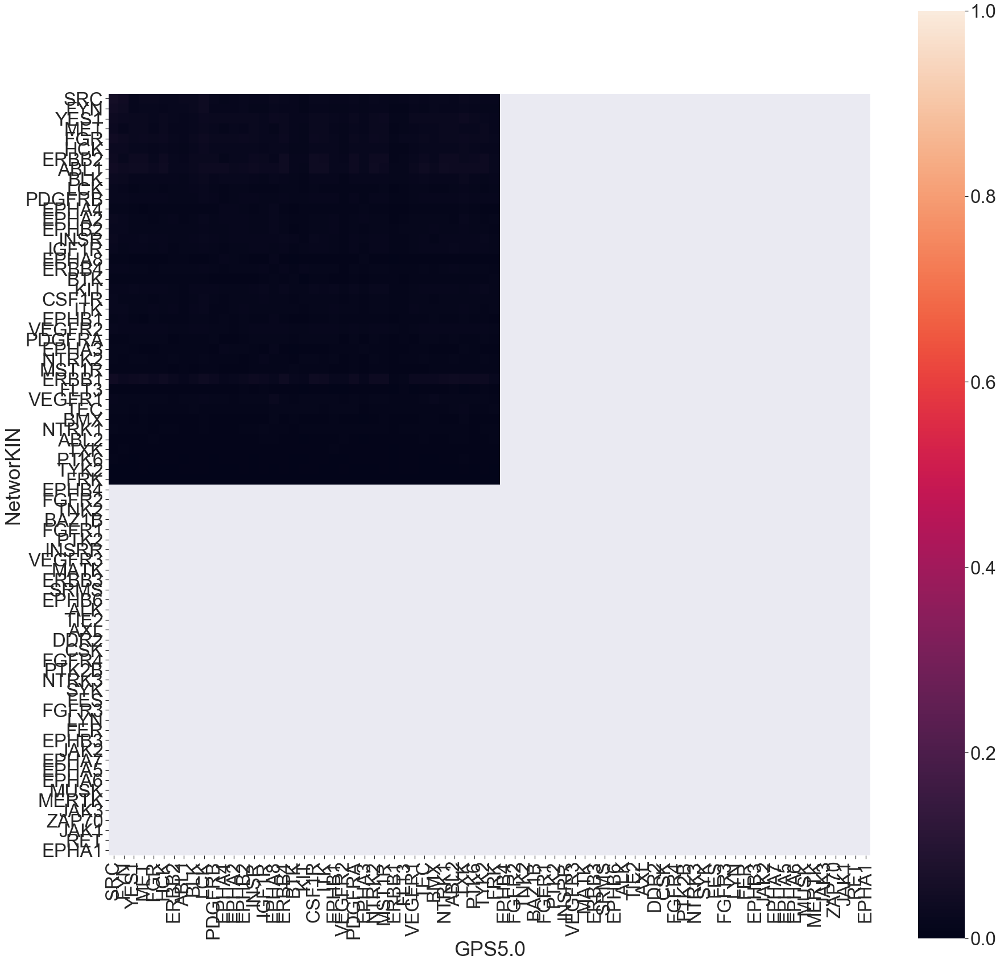

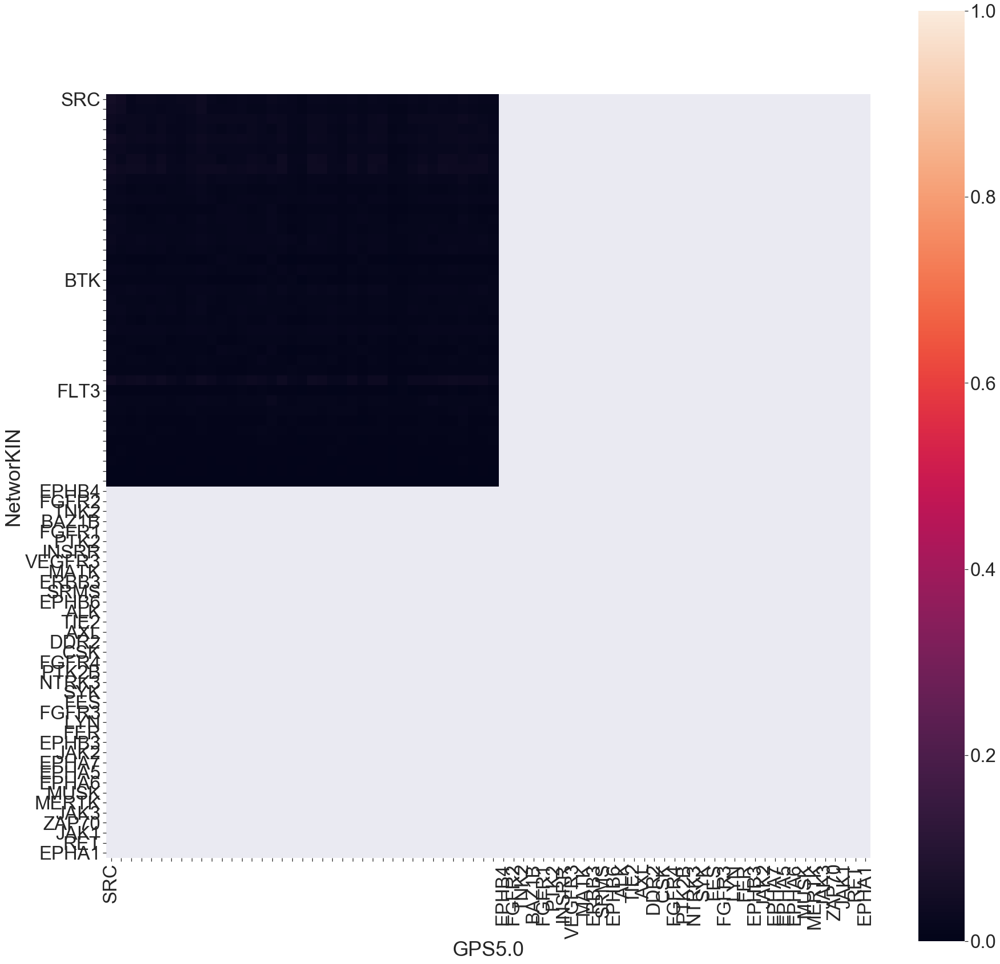

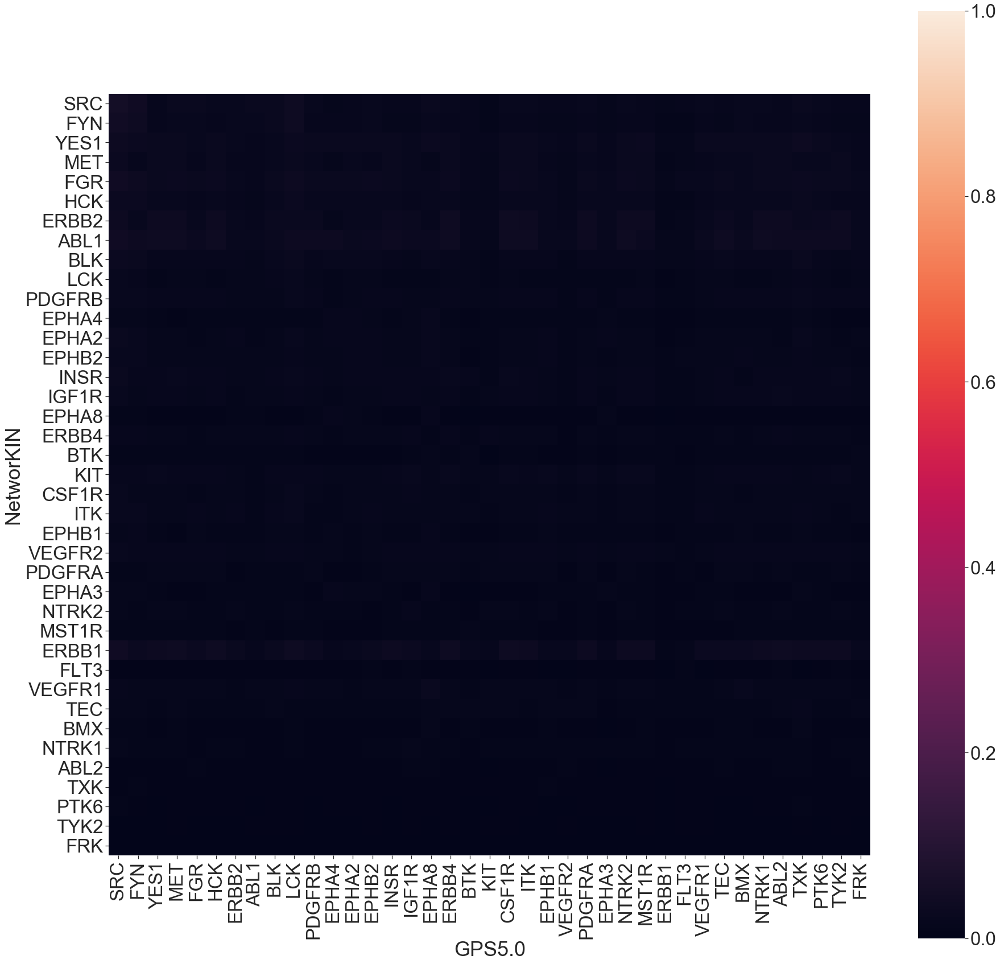

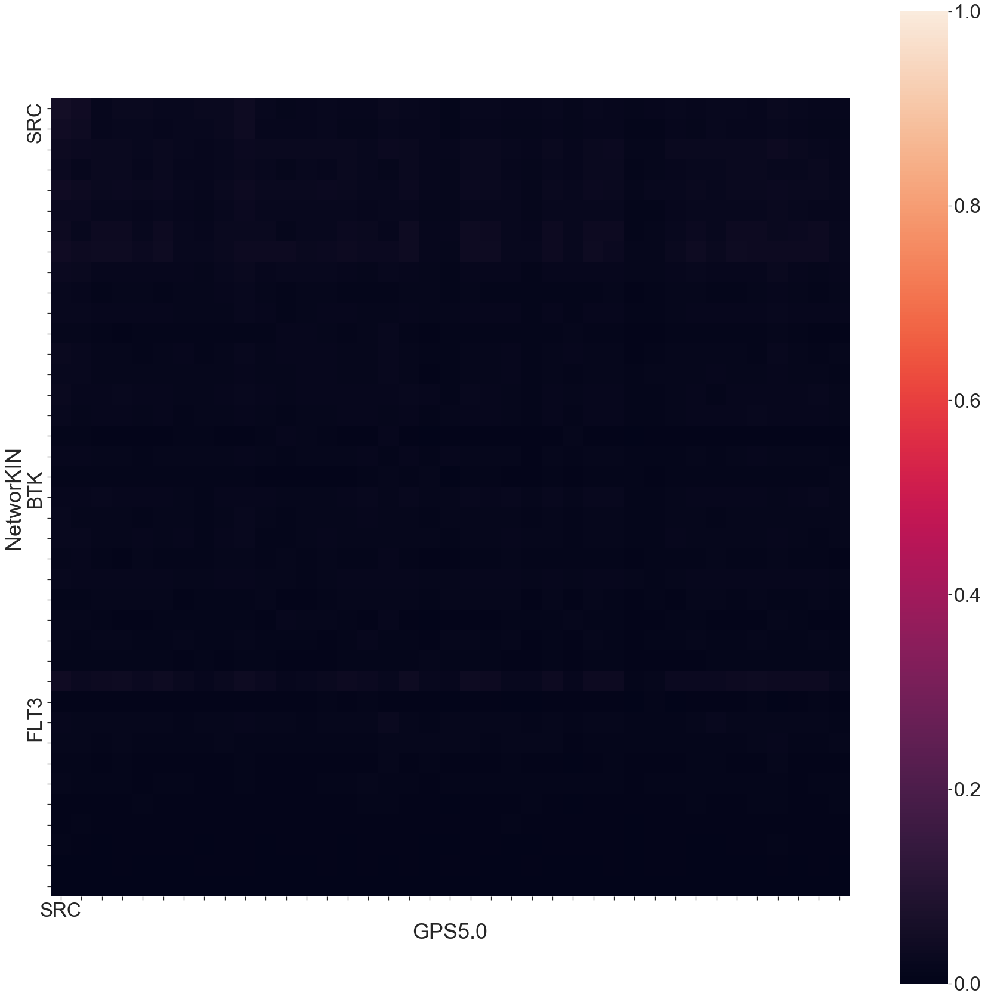

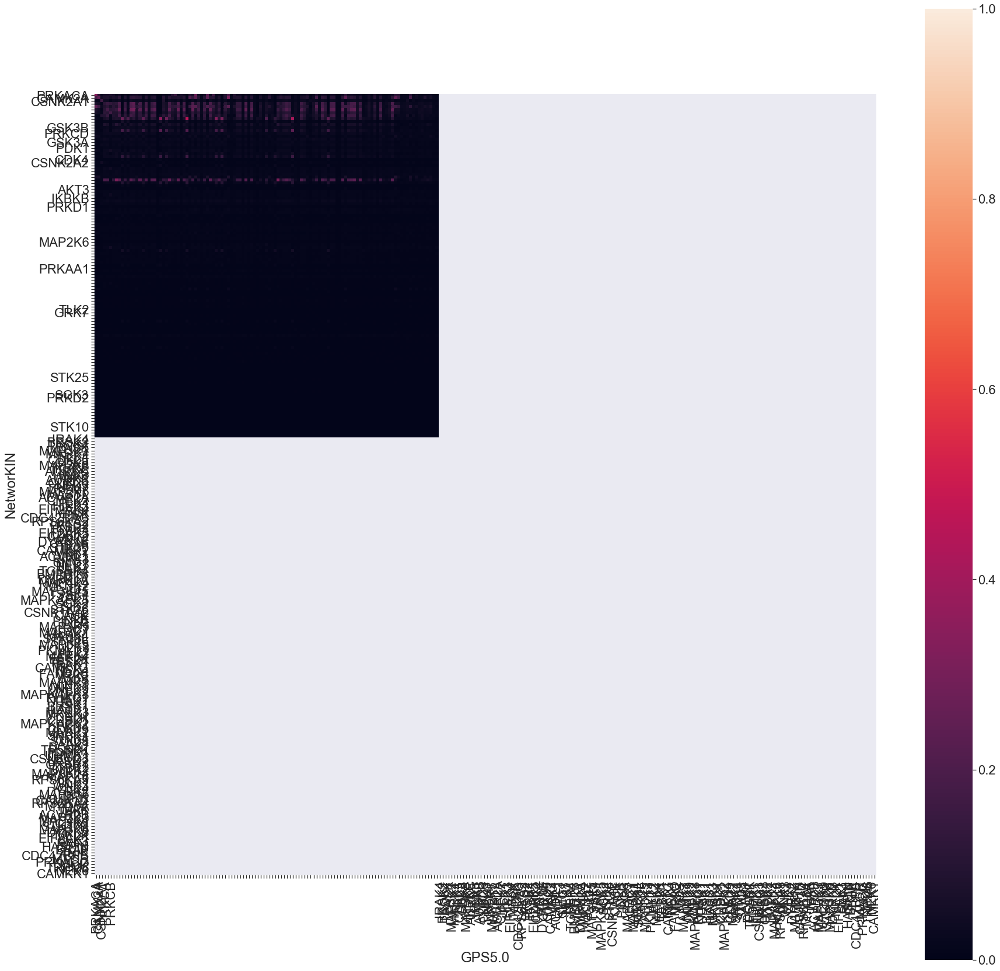

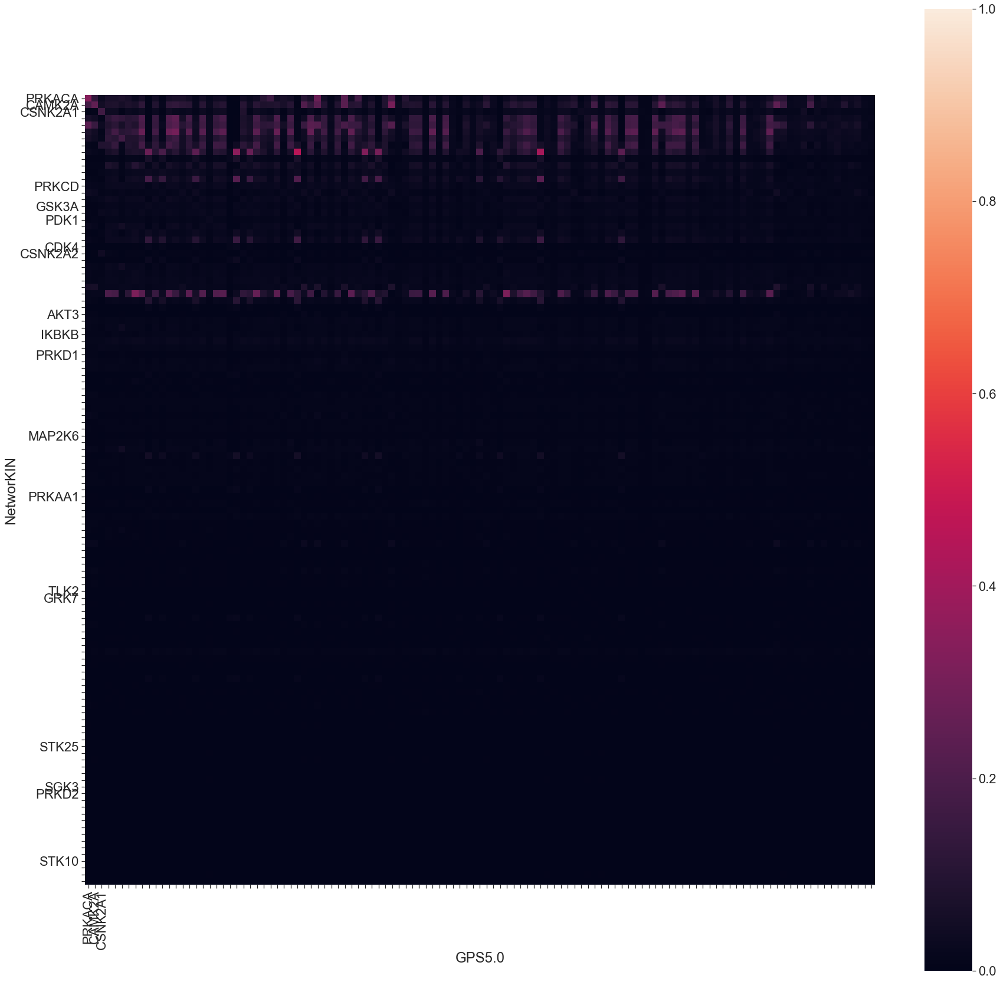

In [22]:
heatmap_y_h = kinase_mutual_information.between_predictors(nw1_y, gpsh_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_NetworKIN_vs_GPS5.0_high_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_h, heatmap_p_dir  + d_type +'_NetworKIN_vs_GPS5.0_high_Y_kinase', 'NetworKIN', 'GPS5.0', 'y')

heatmap_st_h = kinase_mutual_information.between_predictors(nw1_st, gpsh_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_NetworKIN_vs_GPS5.0_high_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_h, heatmap_p_dir + d_type +'_NetworKIN_vs_GPS5.0_high_ST_kinase', 'NetworKIN', 'GPS5.0', 'st')


39 overlapped kinases 
 NetworKIN :  50 kinases 
 GPS :  65 kinases 



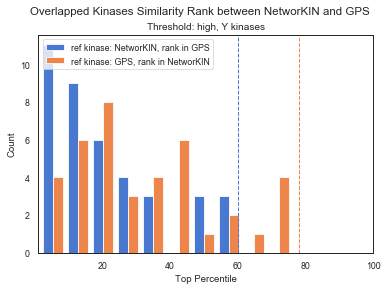

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


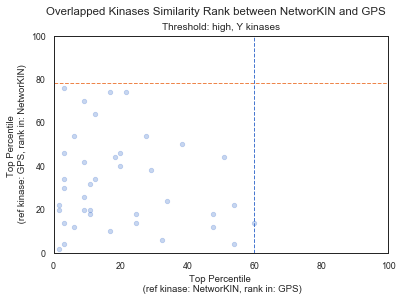

117 overlapped kinases 
 NetworKIN :  140 kinases 
 GPS :  243 kinases 



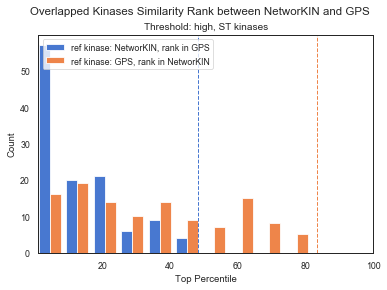

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


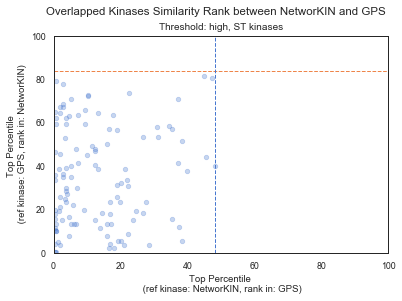

In [11]:
heatmap_y_h = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_vs_GPS5.0_high_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_h, nw1_y, gpsh_y , 'NetworKIN', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_high_Y_nw_gps.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'gps', 'high', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_h = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_vs_GPS5.0_high_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_h, nw1_st, gpsh_st , 'NetworKIN', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_high_ST_nw_gps.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'gps', 'high', 'ST kinases', rank_dir + d_type + '_')


### PhosphoPICK (0.1) vs GPS5.0 (low)
- index: kinases in PhosphoPICK
- column: kinases in GPS5.0

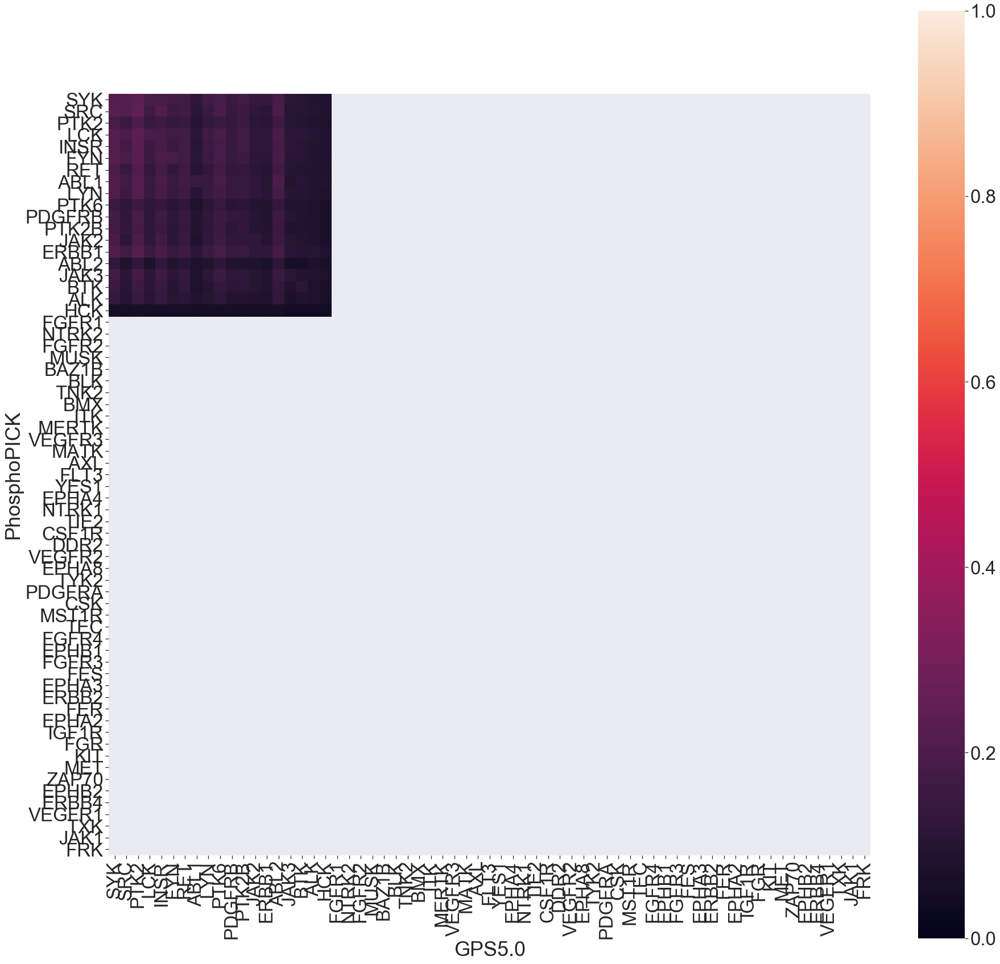

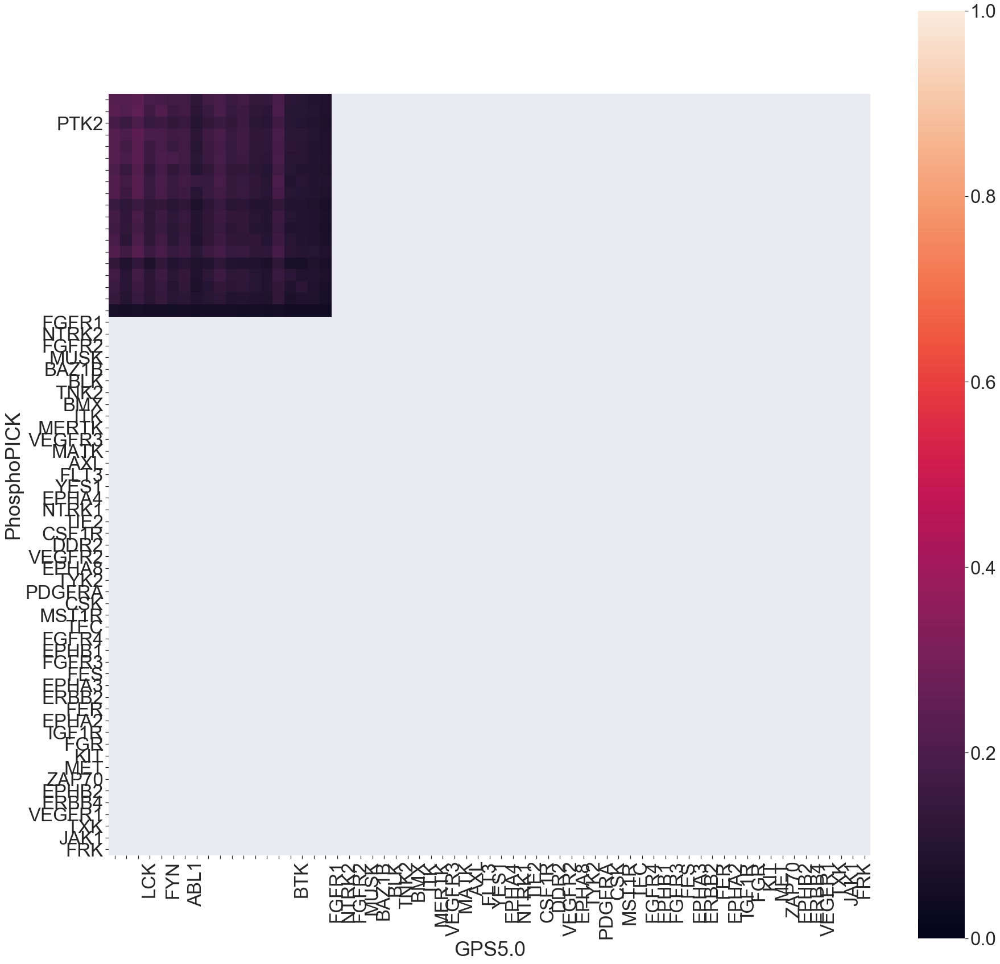

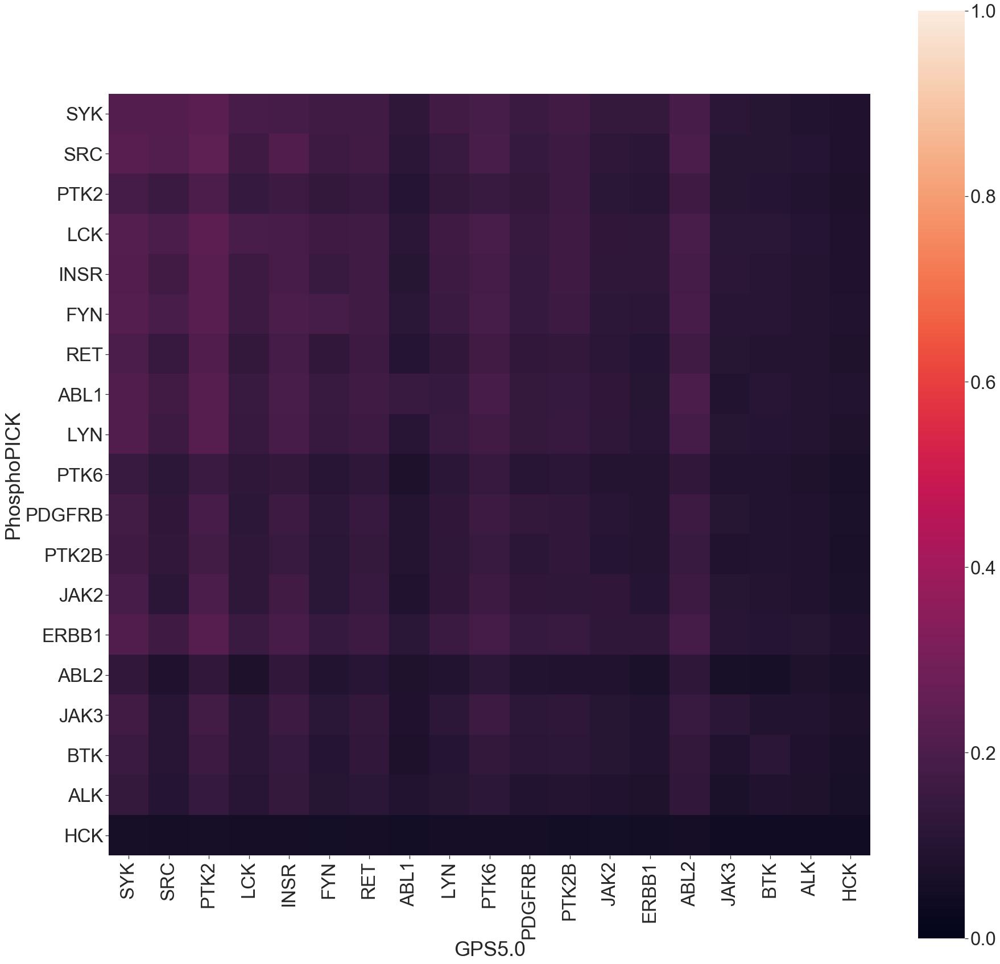

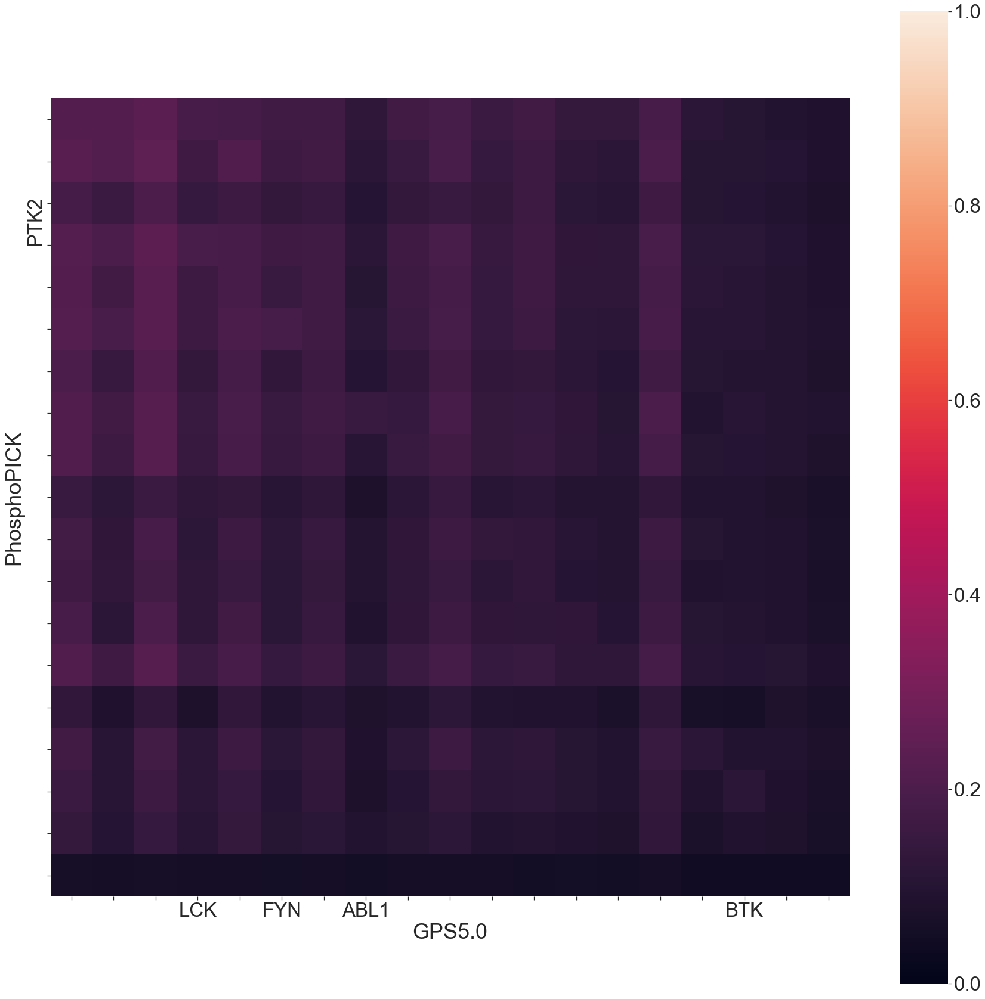

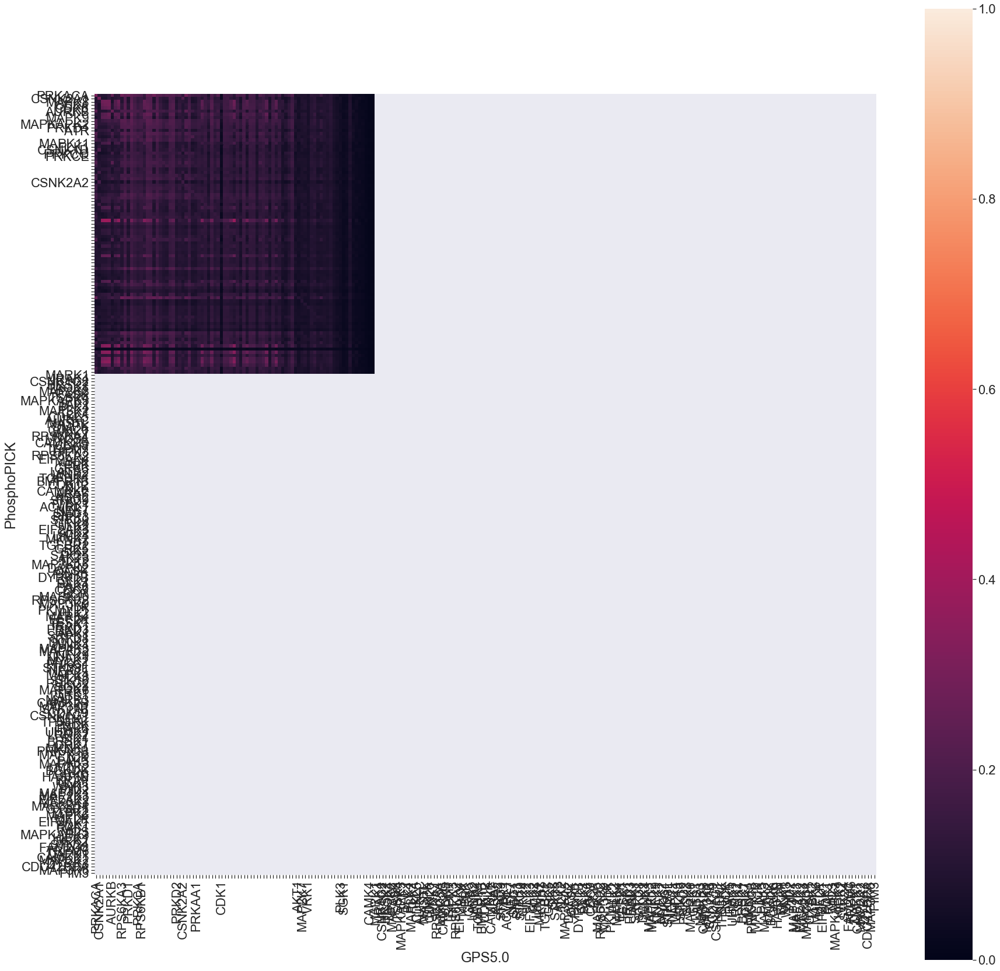

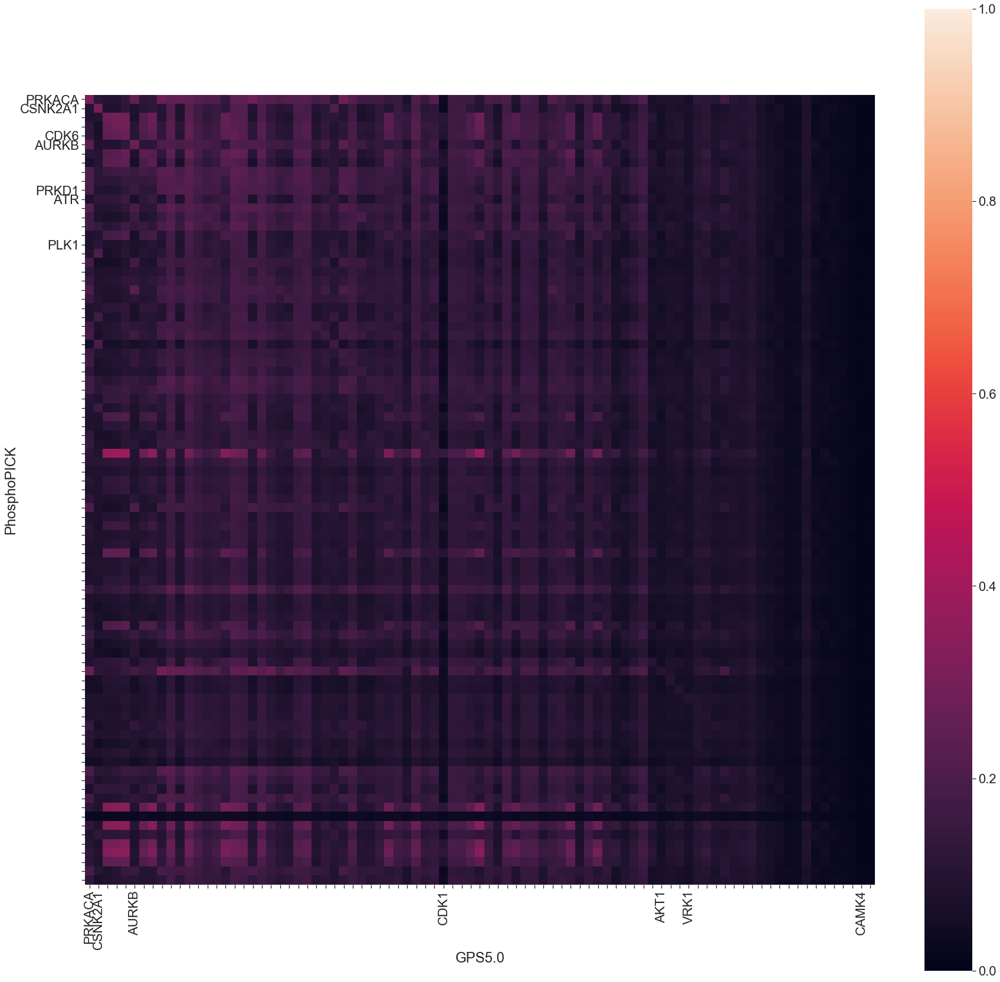

In [25]:
heatmap_y_l = kinase_mutual_information.between_predictors(pp1_y, gpsl_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_PhosphoPICK_vs_GPS5.0_low_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_l, heatmap_p_dir  + d_type +'_PhosphoPICK_vs_GPS5.0_low_Y_kinase', 'PhosphoPICK', 'GPS5.0', 'y')

heatmap_st_l = kinase_mutual_information.between_predictors(pp1_st, gpsl_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_PhosphoPICK_vs_GPS5.0_low_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_l, heatmap_p_dir + d_type +'_PhosphoPICK_vs_GPS5.0_low_ST_kinase', 'PhosphoPICK', 'GPS5.0', 'st')


19 overlapped kinases 
 PhosphoPICK :  19 kinases 
 GPS :  65 kinases 



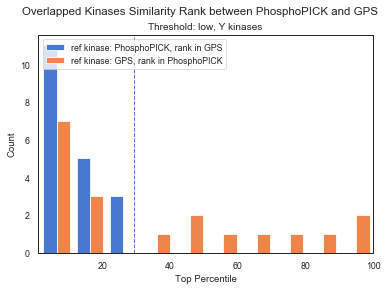

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


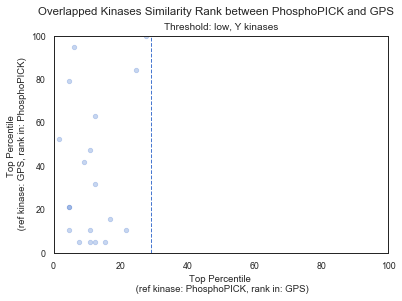

87 overlapped kinases 
 PhosphoPICK :  87 kinases 
 GPS :  243 kinases 



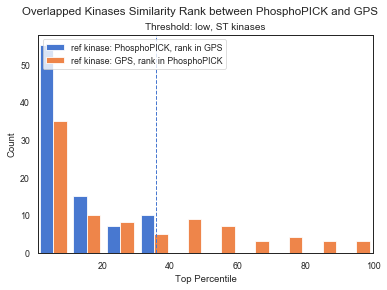

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


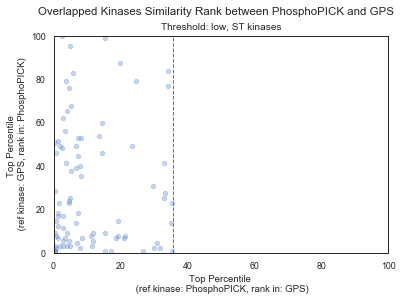

In [12]:
heatmap_y_l = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_vs_GPS5.0_low_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_l, pp1_y, gpsl_y , 'PhosphoPICK', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_low_Y_pp_gps.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'pp', 'gps', 'low', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_l = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_vs_GPS5.0_low_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_l, pp1_st, gpsl_st , 'PhosphoPICK', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_low_ST_pp_gps.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'pp', 'gps', 'low', 'ST kinases', rank_dir + d_type + '_')


### PhosphoPICK (0.06) vs GPS5.0 (med)
- index: kinases in PhosphoPICK
- column: kinases in GPS5.0

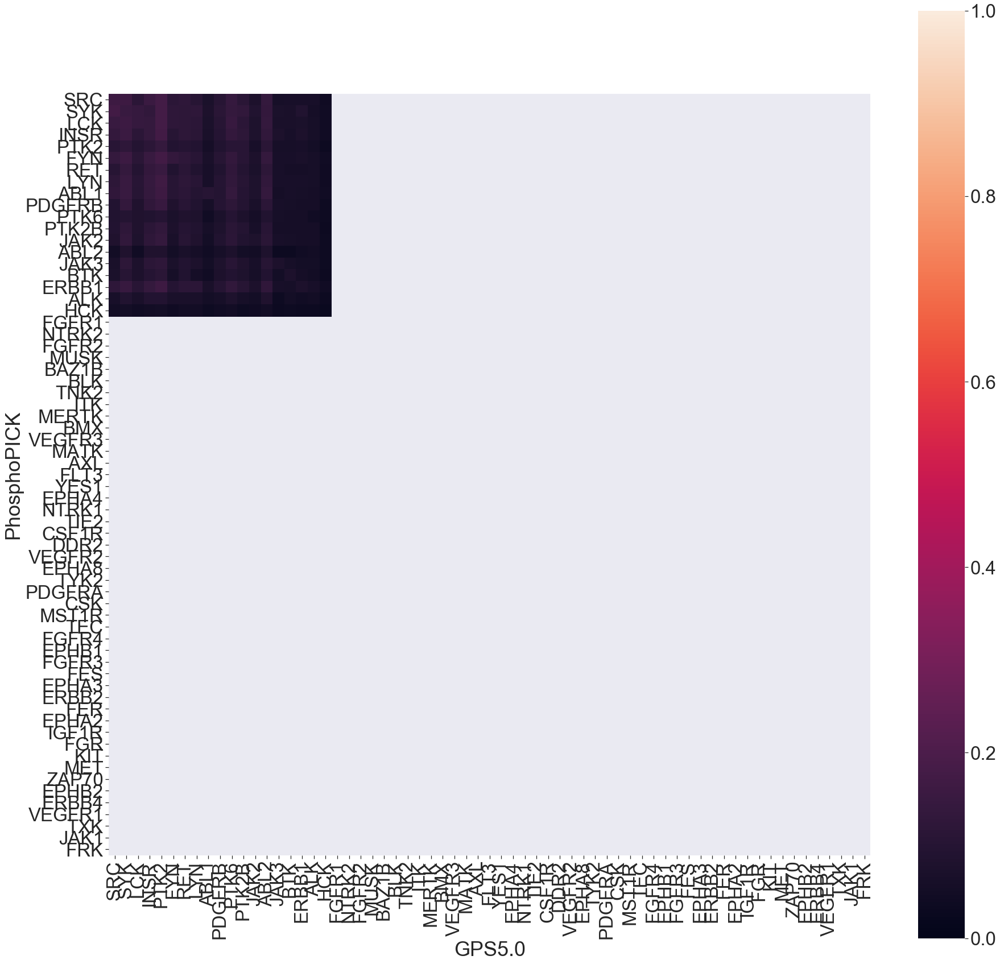

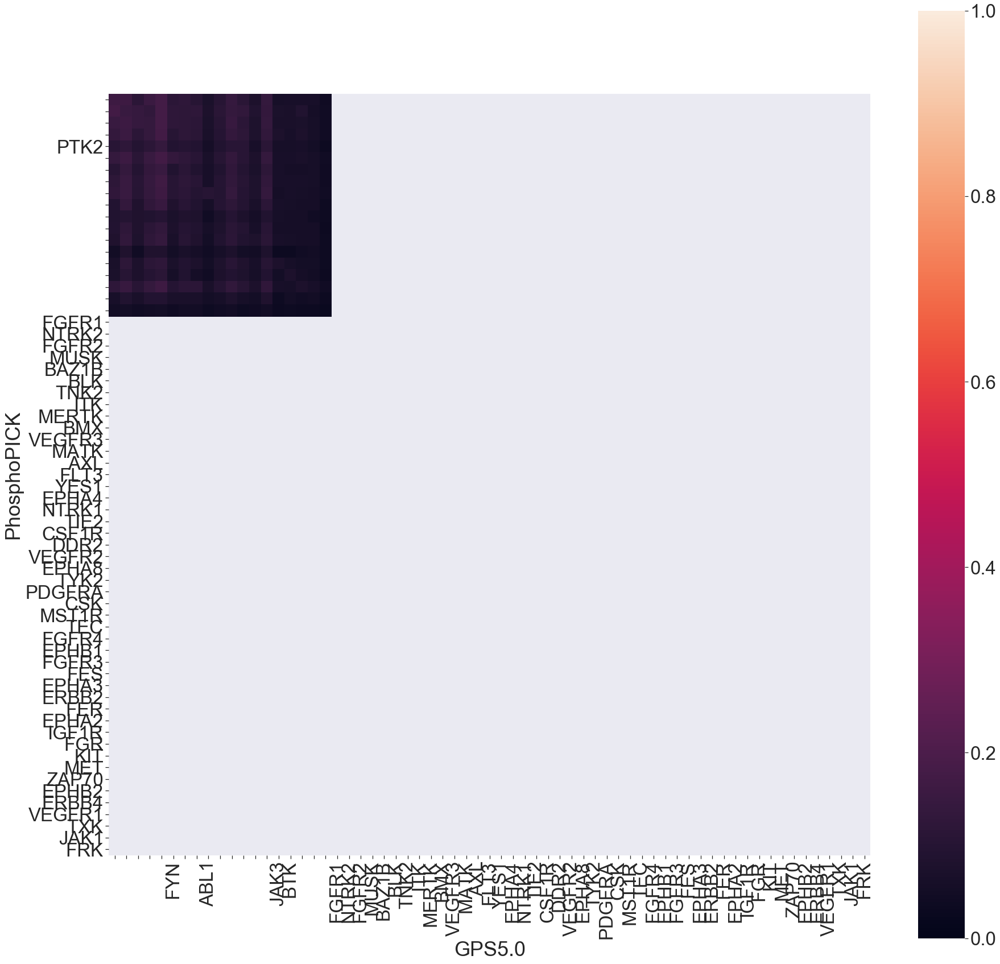

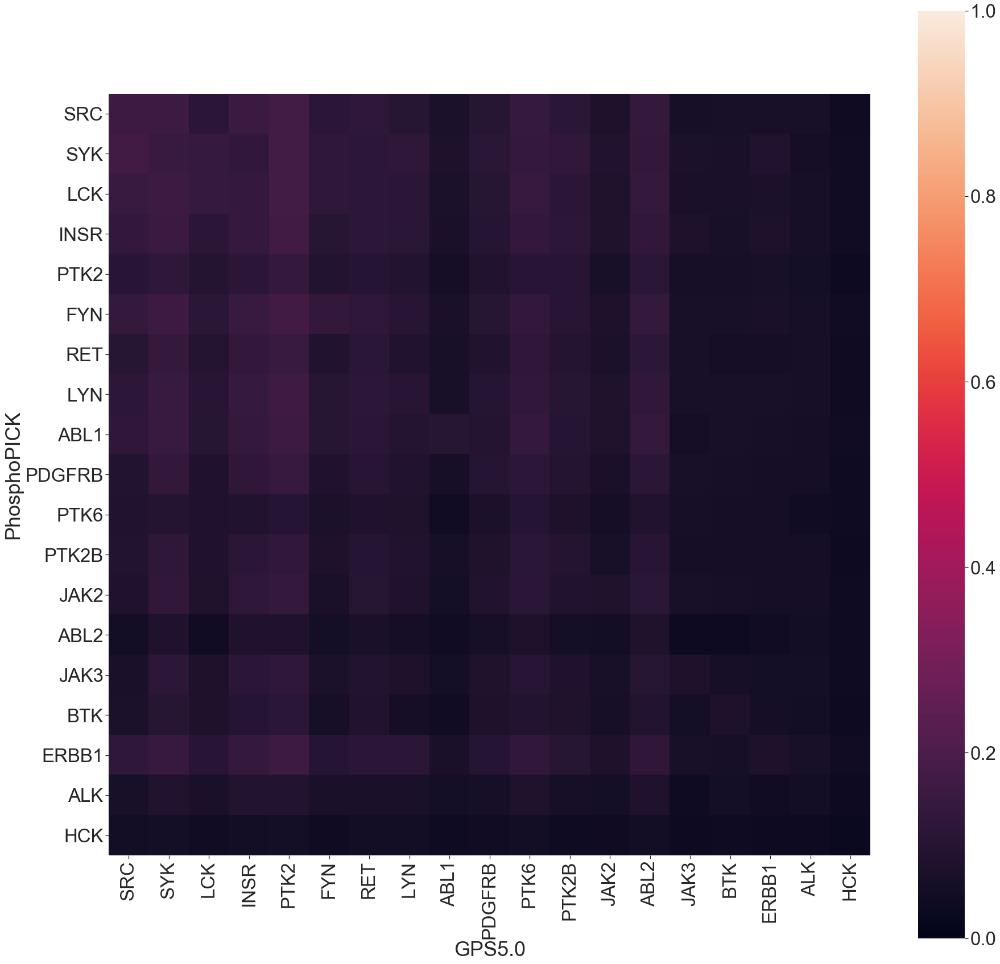

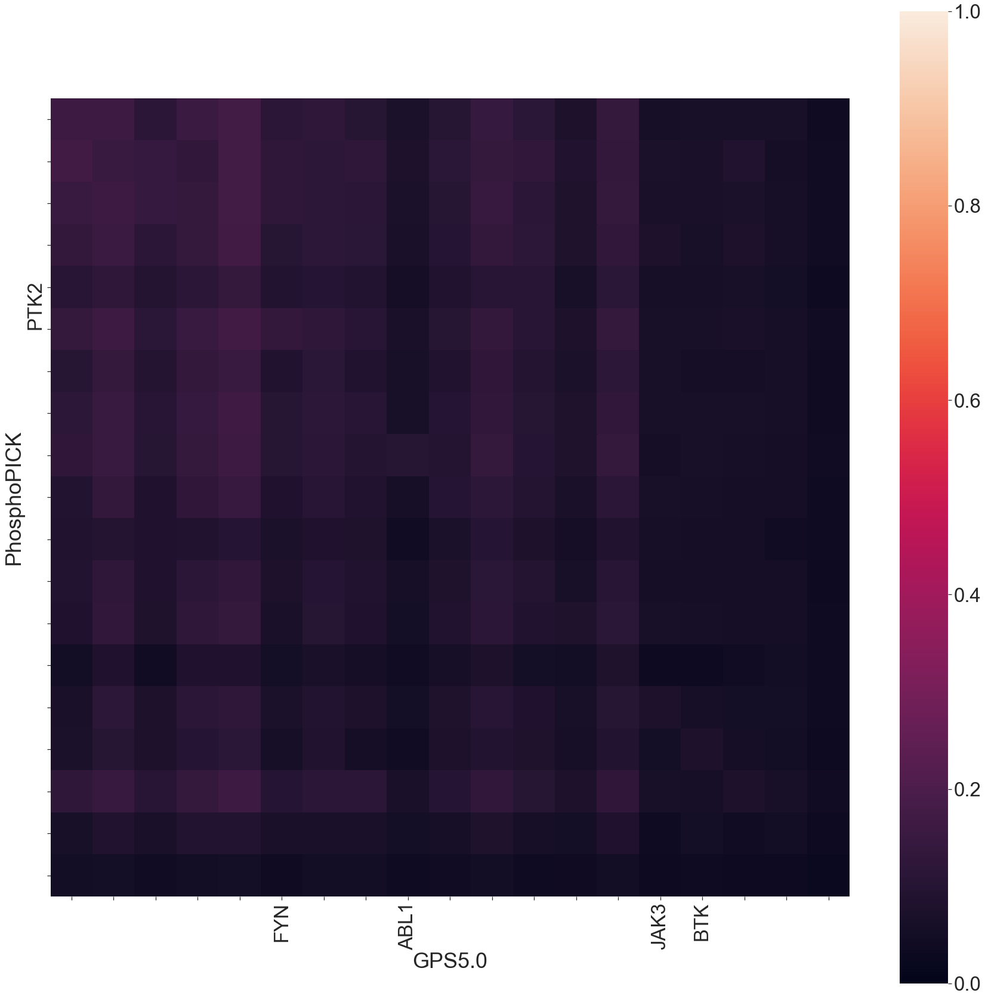

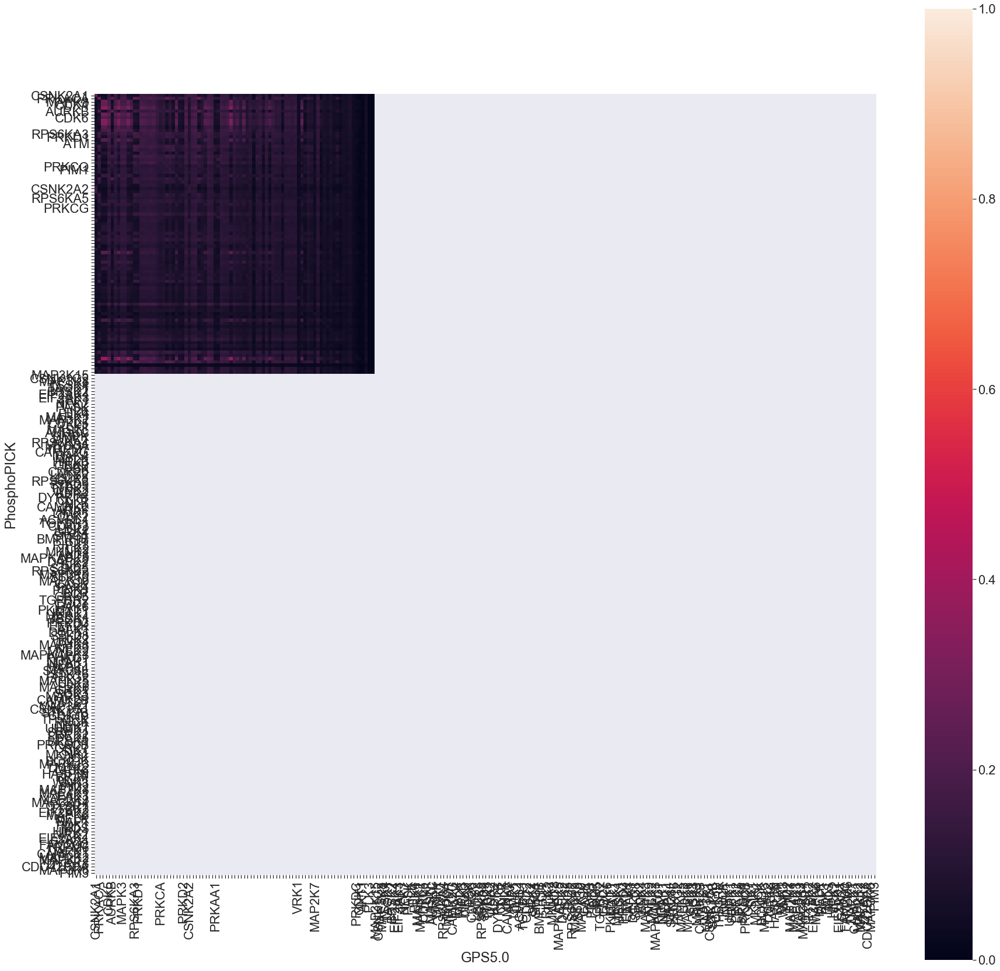

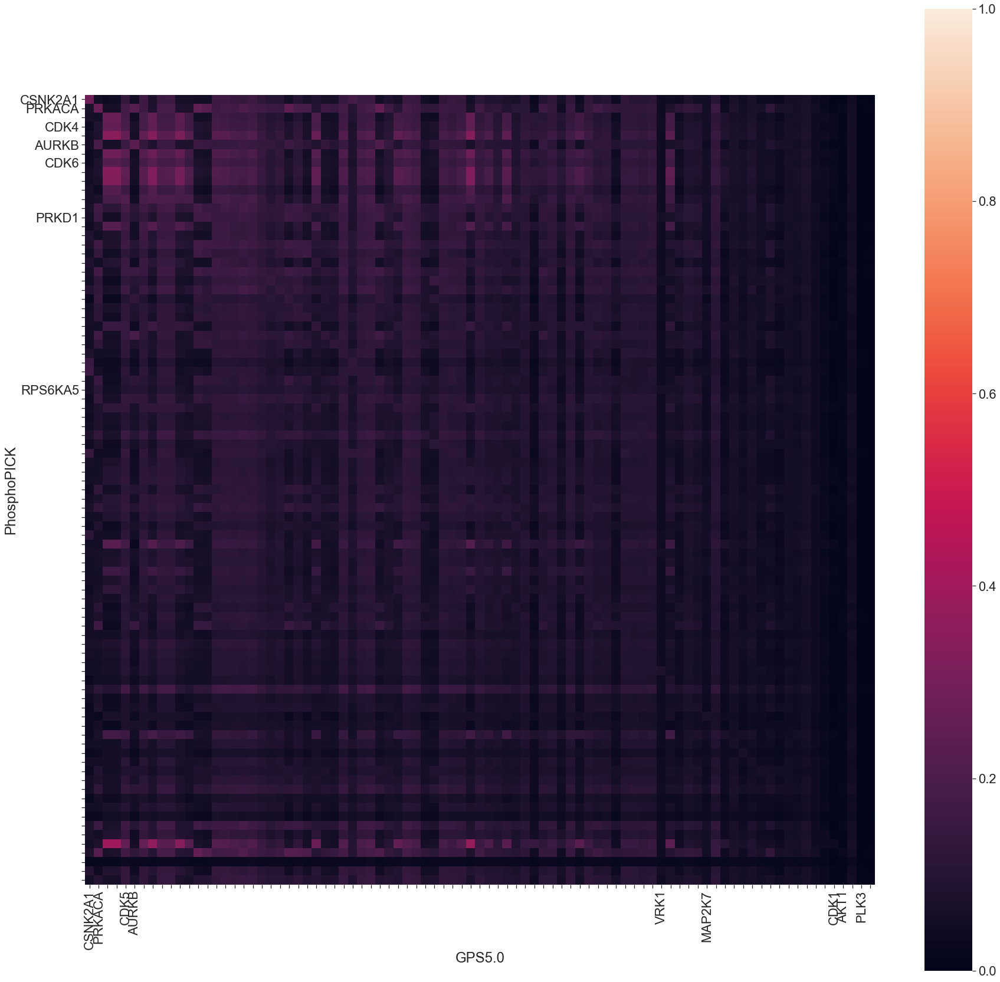

In [27]:
heatmap_y_m = kinase_mutual_information.between_predictors(pp06_y, gpsm_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_PhosphoPICK_vs_GPS5.0_med_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_m, heatmap_p_dir  + d_type +'_PhosphoPICK_vs_GPS5.0_med_Y_kinase', 'PhosphoPICK', 'GPS5.0', 'y')

heatmap_st_m = kinase_mutual_information.between_predictors(pp06_st, gpsm_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_PhosphoPICK_vs_GPS5.0_med_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_m, heatmap_p_dir + d_type +'_PhosphoPICK_vs_GPS5.0_med_ST_kinase', 'PhosphoPICK', 'GPS5.0', 'st')


19 overlapped kinases 
 PhosphoPICK :  19 kinases 
 GPS :  65 kinases 



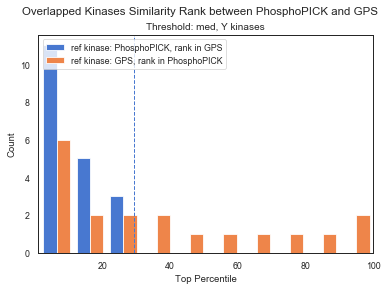

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


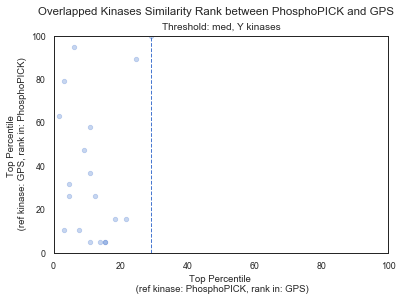

87 overlapped kinases 
 PhosphoPICK :  87 kinases 
 GPS :  243 kinases 



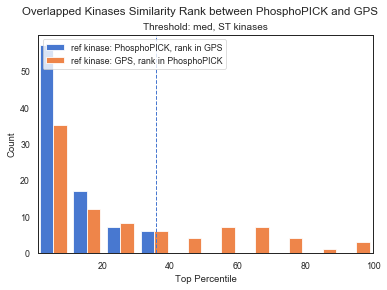

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


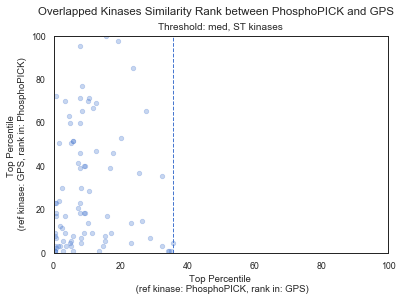

In [13]:
heatmap_y_m = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_vs_GPS5.0_med_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_m, pp06_y, gpsm_y , 'PhosphoPICK', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_med_Y_pp_gps.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'pp', 'gps', 'med', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_m = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_vs_GPS5.0_med_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_m, pp06_st, gpsm_st , 'PhosphoPICK', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_med_ST_pp_gps.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'pp', 'gps', 'med', 'ST kinases', rank_dir + d_type + '_')


### PhosphoPICK (0.02) vs GPS5.0 (high)
- index: kinases in PhosphoPICK
- column: kinases in GPS5.0

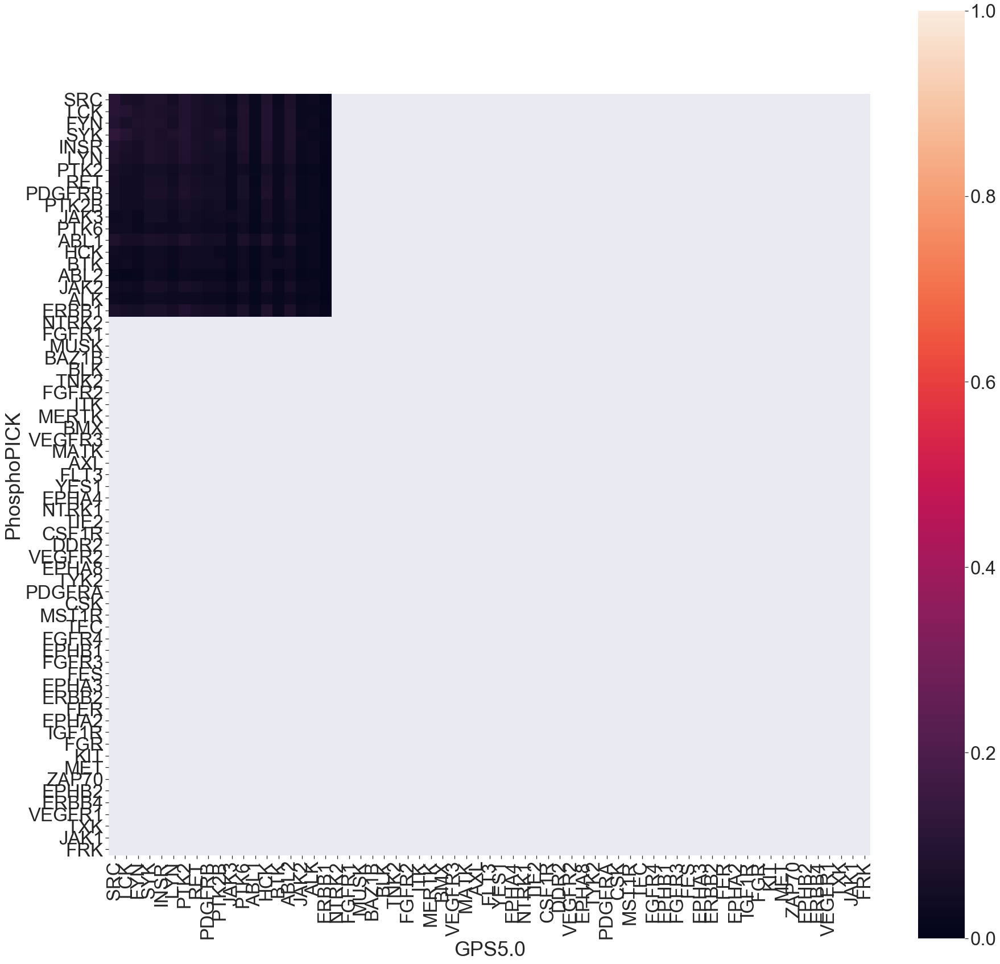

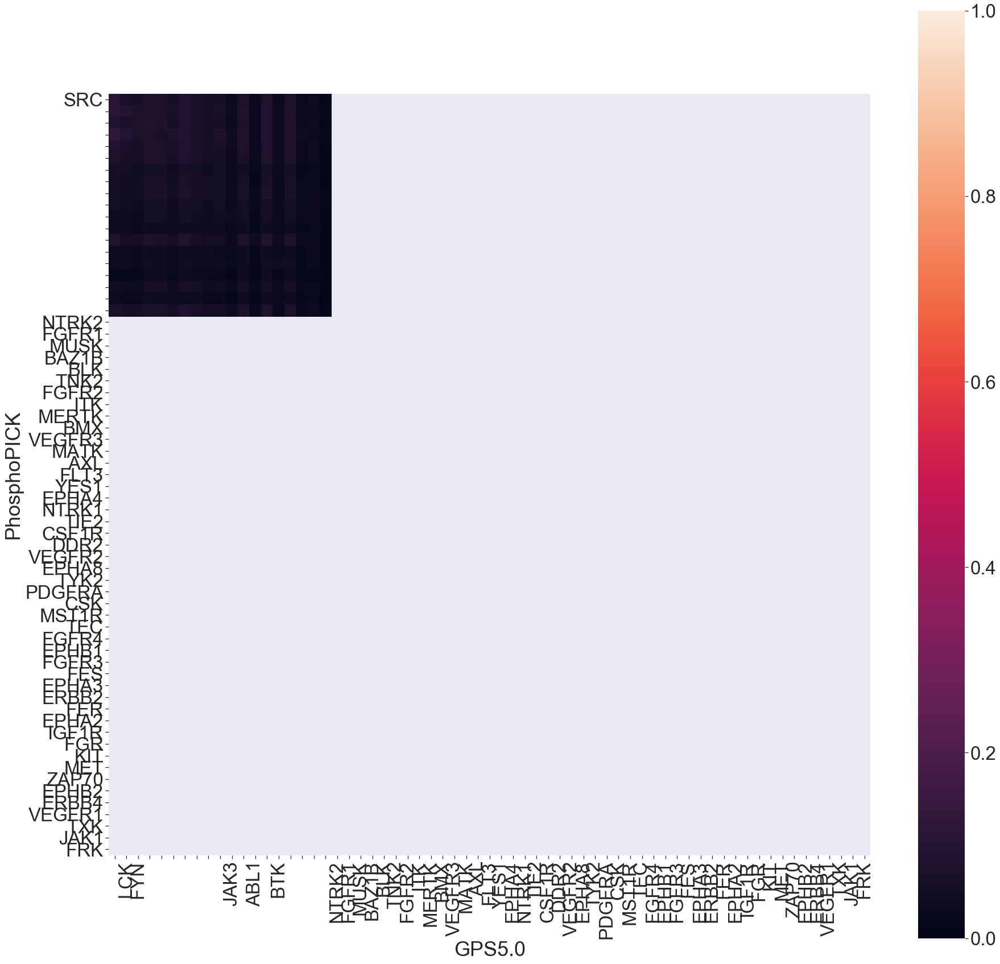

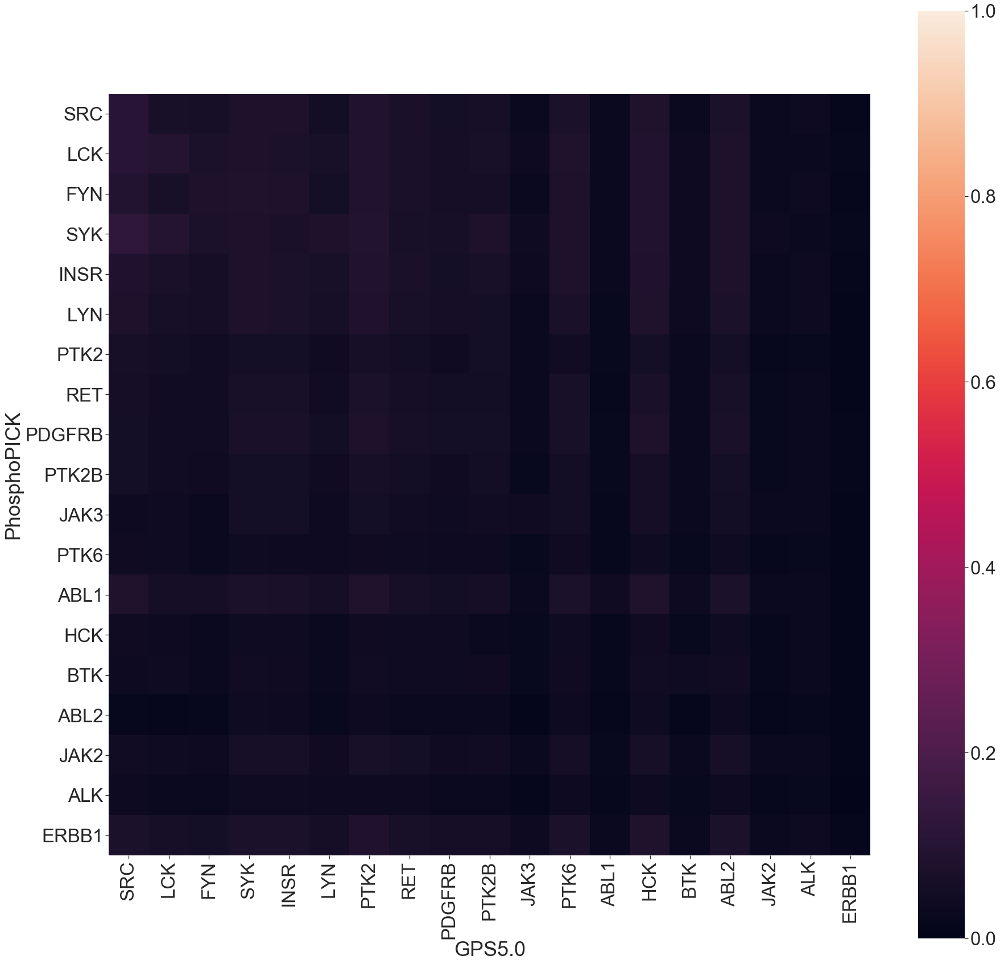

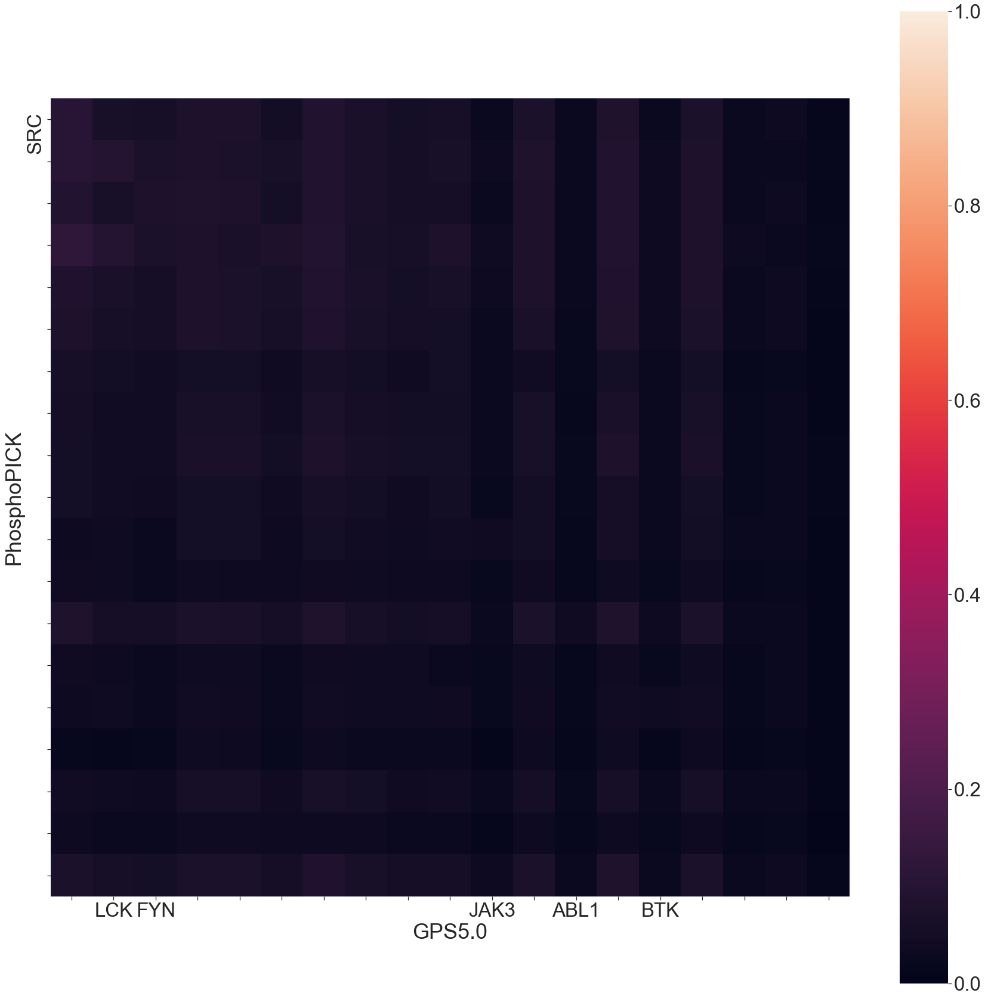

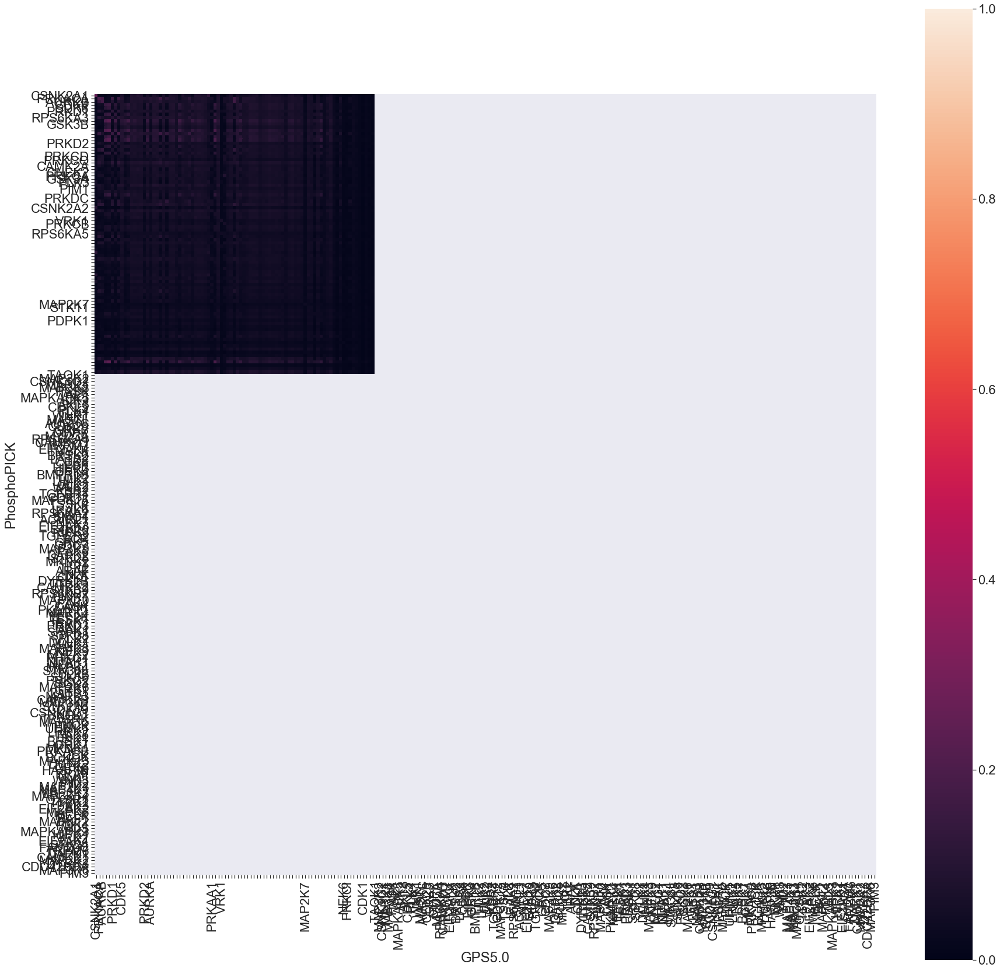

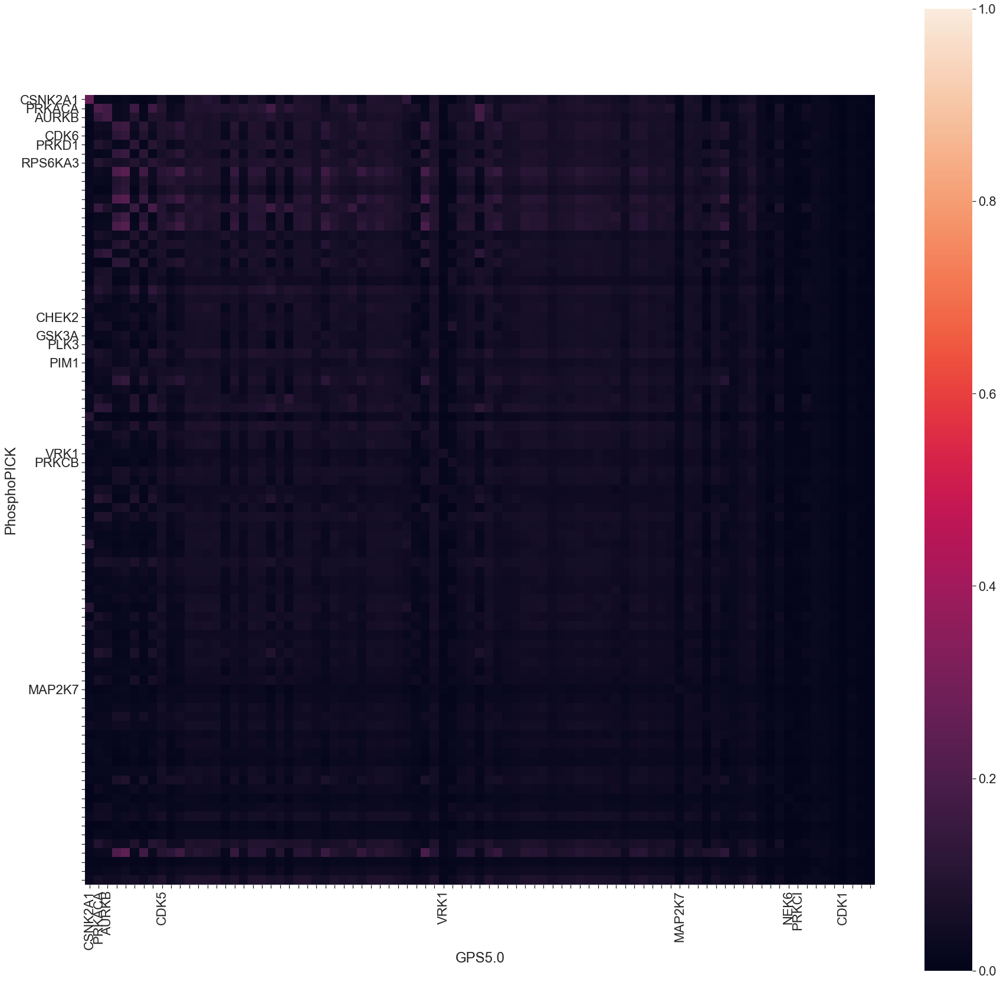

In [29]:
heatmap_y_h = kinase_mutual_information.between_predictors(pp02_y, gpsh_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_PhosphoPICK_vs_GPS5.0_high_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_h, heatmap_p_dir  + d_type +'_PhosphoPICK_vs_GPS5.0_high_Y_kinase', 'PhosphoPICK', 'GPS5.0', 'y')

heatmap_st_h = kinase_mutual_information.between_predictors(pp02_st, gpsh_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir  + d_type +'_PhosphoPICK_vs_GPS5.0_high_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_h, heatmap_p_dir + d_type +'_PhosphoPICK_vs_GPS5.0_high_ST_kinase', 'PhosphoPICK', 'GPS5.0', 'st')


19 overlapped kinases 
 PhosphoPICK :  19 kinases 
 GPS :  65 kinases 



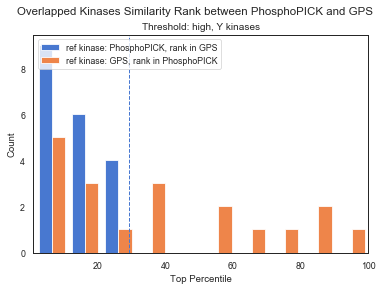

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


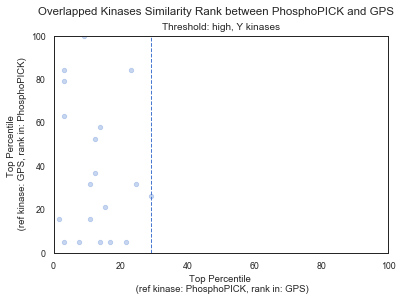

87 overlapped kinases 
 PhosphoPICK :  87 kinases 
 GPS :  243 kinases 



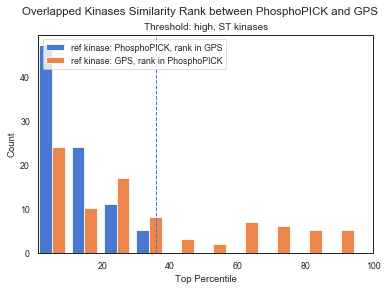

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


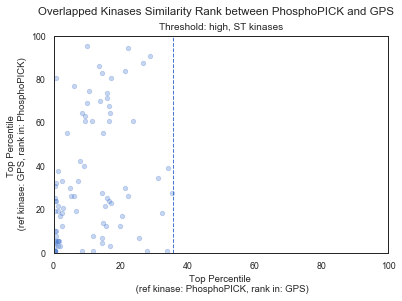

In [14]:
heatmap_y_h = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_vs_GPS5.0_high_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_h, pp02_y, gpsh_y , 'PhosphoPICK', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_high_Y_pp_gps.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'pp', 'gps', 'high', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_h = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_vs_GPS5.0_high_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_h, pp02_st, gpsh_st , 'PhosphoPICK', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_high_ST_pp_gps.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'pp', 'gps', 'high', 'ST kinases', rank_dir + d_type + '_')


### CDFs for the same-kinase ranking (same stringency comparisom)

In [5]:
# NetworKIN vs. GPS
gn_y_l = pd.read_csv(rank_data_dir + d_type +'_low_Y_nw_gps.csv')
gn_y_m = pd.read_csv(rank_data_dir + d_type +'_med_Y_nw_gps.csv')
gn_y_h = pd.read_csv(rank_data_dir + d_type +'_high_Y_nw_gps.csv')
dfs_y_nw_gps = [gn_y_l, gn_y_m, gn_y_h]

gn_st_l = pd.read_csv(rank_data_dir + d_type +'_low_ST_nw_gps.csv')
gn_st_m = pd.read_csv(rank_data_dir + d_type +'_med_ST_nw_gps.csv')
gn_st_h = pd.read_csv(rank_data_dir + d_type +'_high_ST_nw_gps.csv')
dfs_st_nw_gps = [gn_st_l, gn_st_m, gn_st_h]


In [4]:
# NetworKIN vs. PhosphoPICK
# Y kinase
# load the ranking summary dfs
pn_y_l = pd.read_csv(rank_data_dir + d_type +'_low_Y_nw_pp.csv')
pn_y_m = pd.read_csv(rank_data_dir + d_type +'_med_Y_nw_pp.csv')
pn_y_h = pd.read_csv(rank_data_dir + d_type +'_high_Y_nw_pp.csv')
dfs_y_nw_pp= [pn_y_l, pn_y_m, pn_y_h]

# S/T kinase
pn_st_l = pd.read_csv(rank_data_dir + d_type +'_low_ST_nw_pp.csv')
pn_st_m = pd.read_csv(rank_data_dir + d_type +'_med_ST_nw_pp.csv')
pn_st_h = pd.read_csv(rank_data_dir + d_type +'_high_ST_nw_pp.csv')
dfs_st_nw_pp = [pn_st_l, pn_st_m, pn_st_h]


In [6]:
# PhosphoPICK vs GPS
gp_y_l = pd.read_csv(rank_data_dir + d_type +'_low_Y_pp_gps.csv')
gp_y_m = pd.read_csv(rank_data_dir + d_type +'_med_Y_pp_gps.csv')
gp_y_h = pd.read_csv(rank_data_dir + d_type +'_high_Y_pp_gps.csv')
dfs_y_pp_gps = [gp_y_l, gp_y_m, gp_y_h]

gp_st_l = pd.read_csv(rank_data_dir + d_type +'_low_ST_pp_gps.csv')
gp_st_m = pd.read_csv(rank_data_dir + d_type +'_med_ST_pp_gps.csv')
gp_st_h = pd.read_csv(rank_data_dir + d_type +'_high_ST_pp_gps.csv')
dfs_st_pp_gps = [gp_st_l, gp_st_m, gp_st_h]



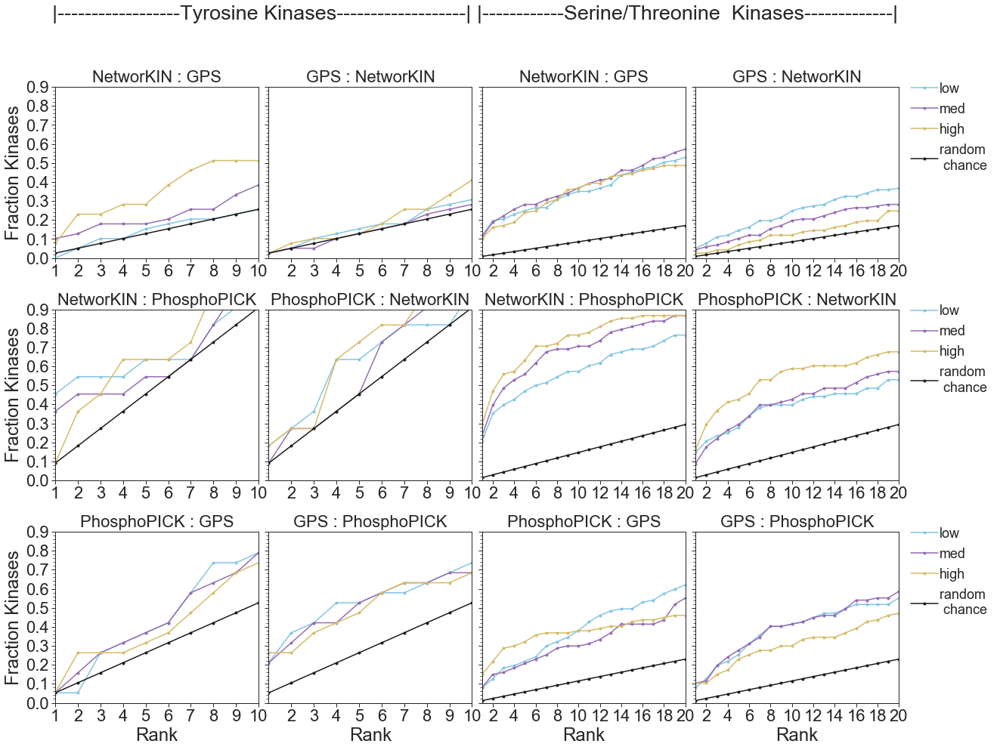

In [7]:
dfs = [dfs_y_nw_gps, dfs_st_nw_gps,
       dfs_y_nw_pp, dfs_st_nw_pp,
       dfs_y_pp_gps, dfs_st_pp_gps]
plot_sameKinase_rank.plot_rank_density (dfs, rank_dir + d_type + '_')

### Kinase Network Similarity between Predictors (Mixed stringency)


### NetworKIN(0.3) vs PhosphoPICK (0.06)
- index: kinases in NetworKIN
- column: kinases in PhosphoPICK

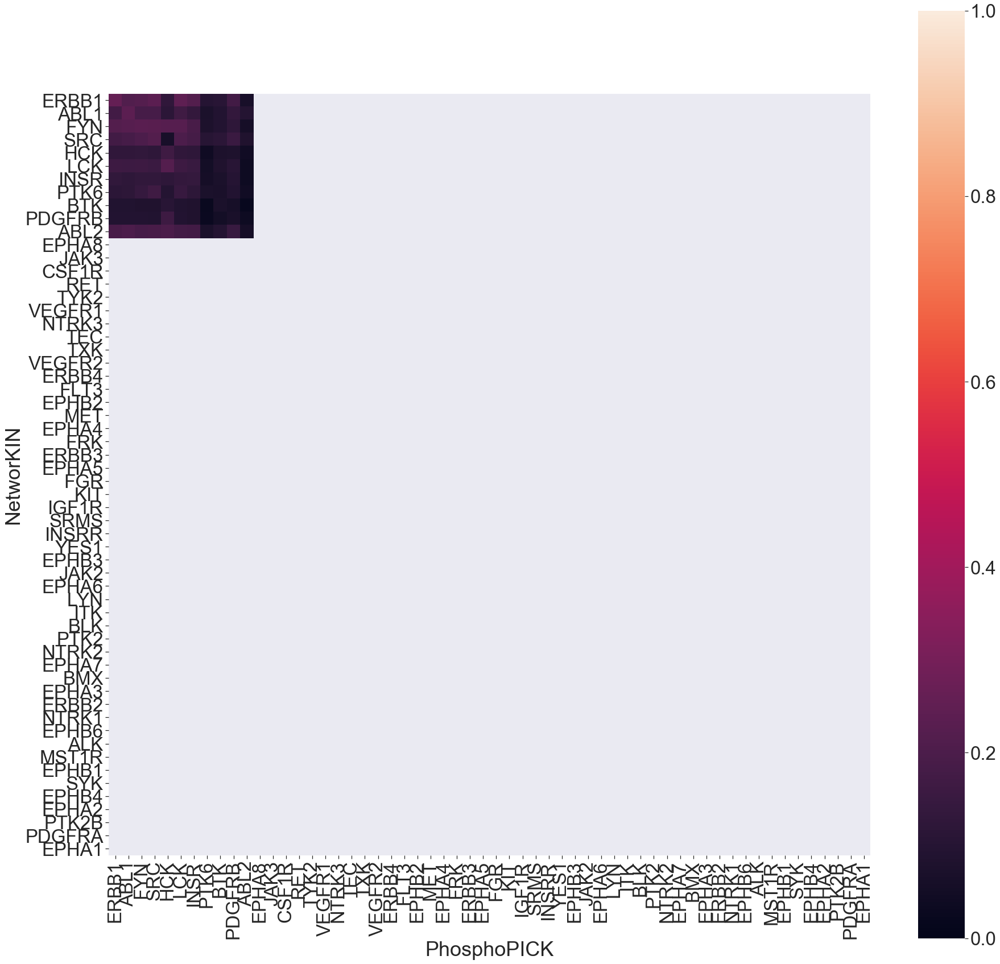

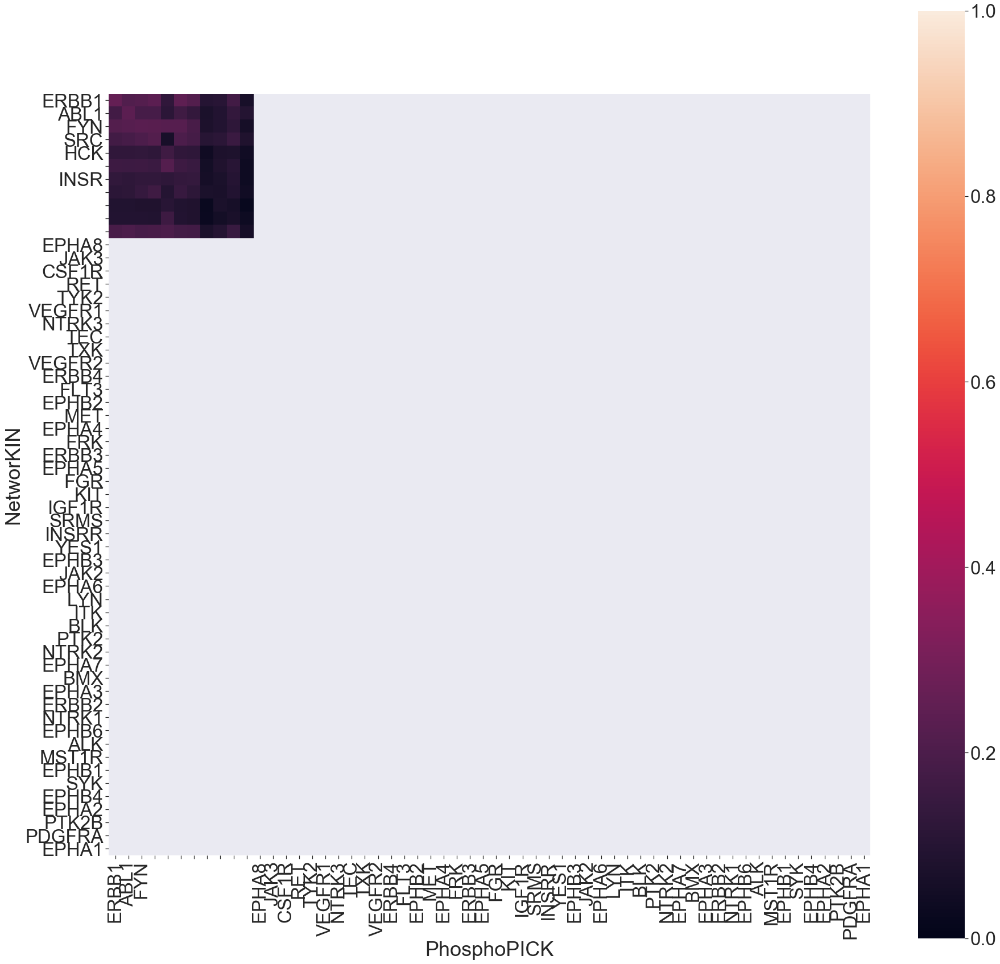

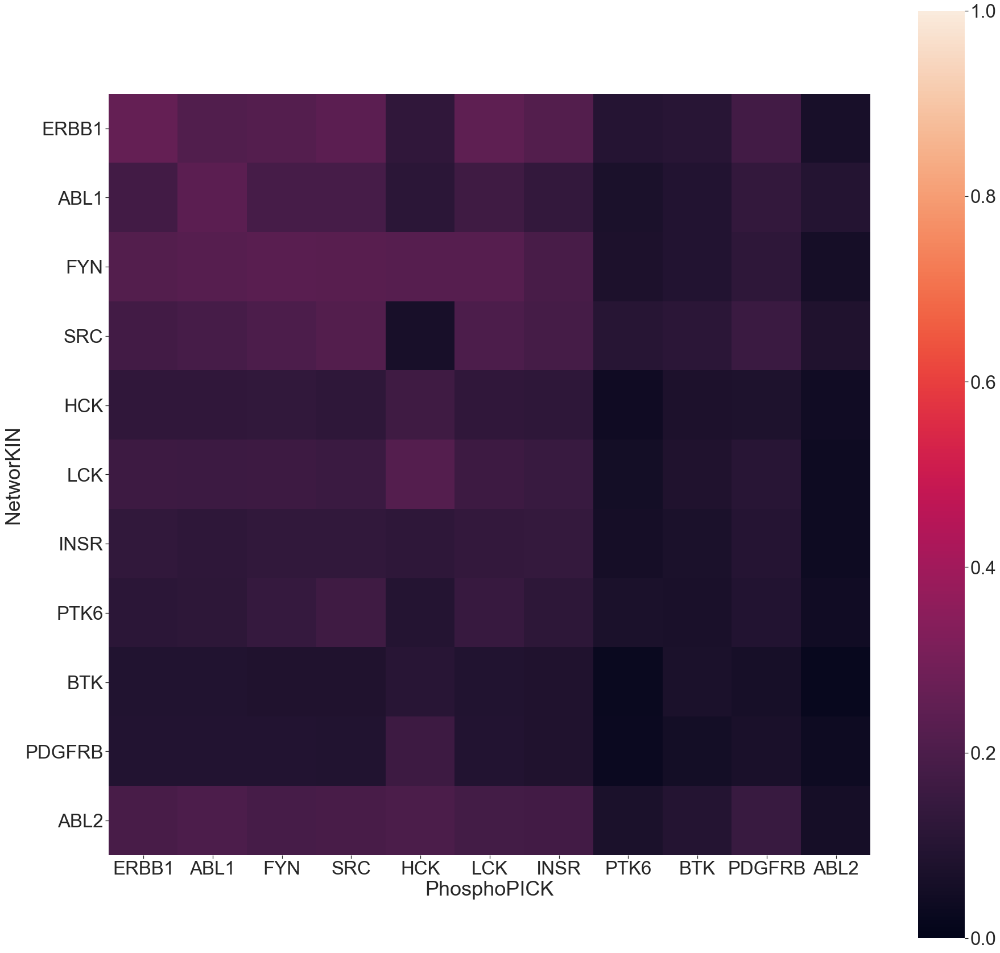

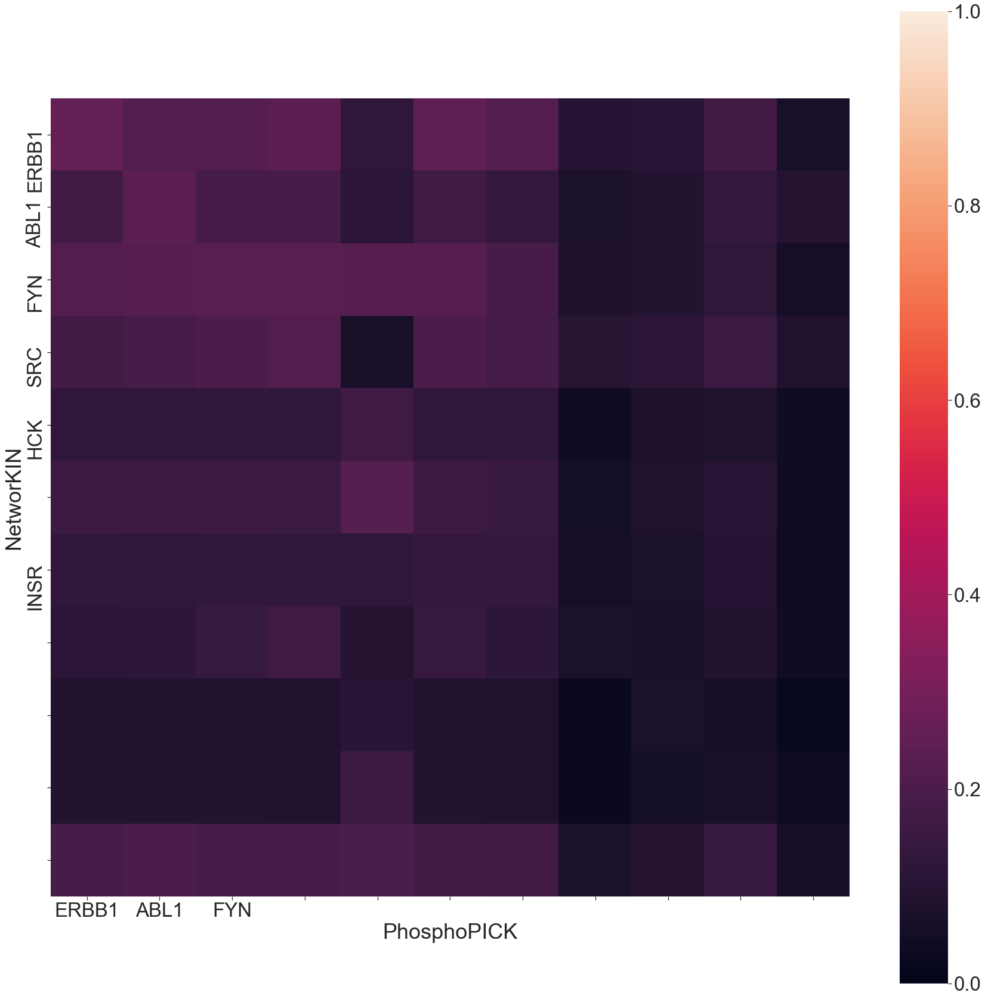

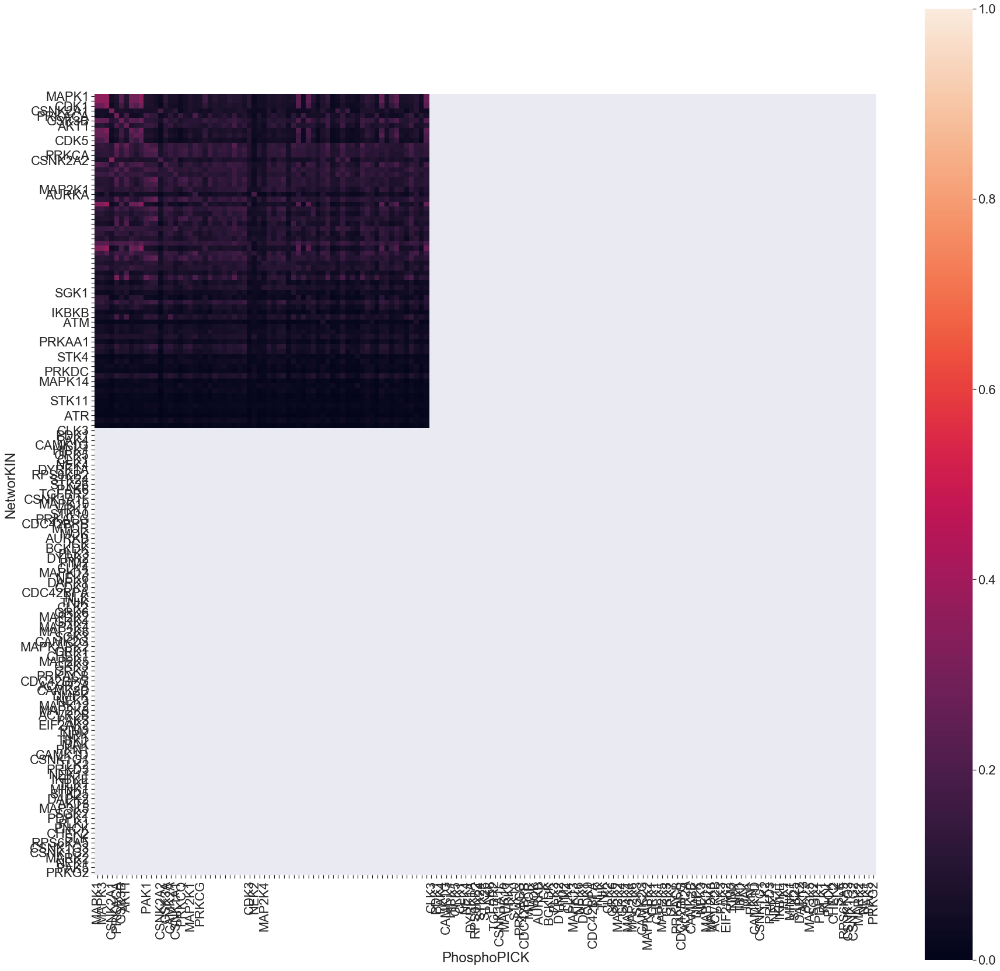

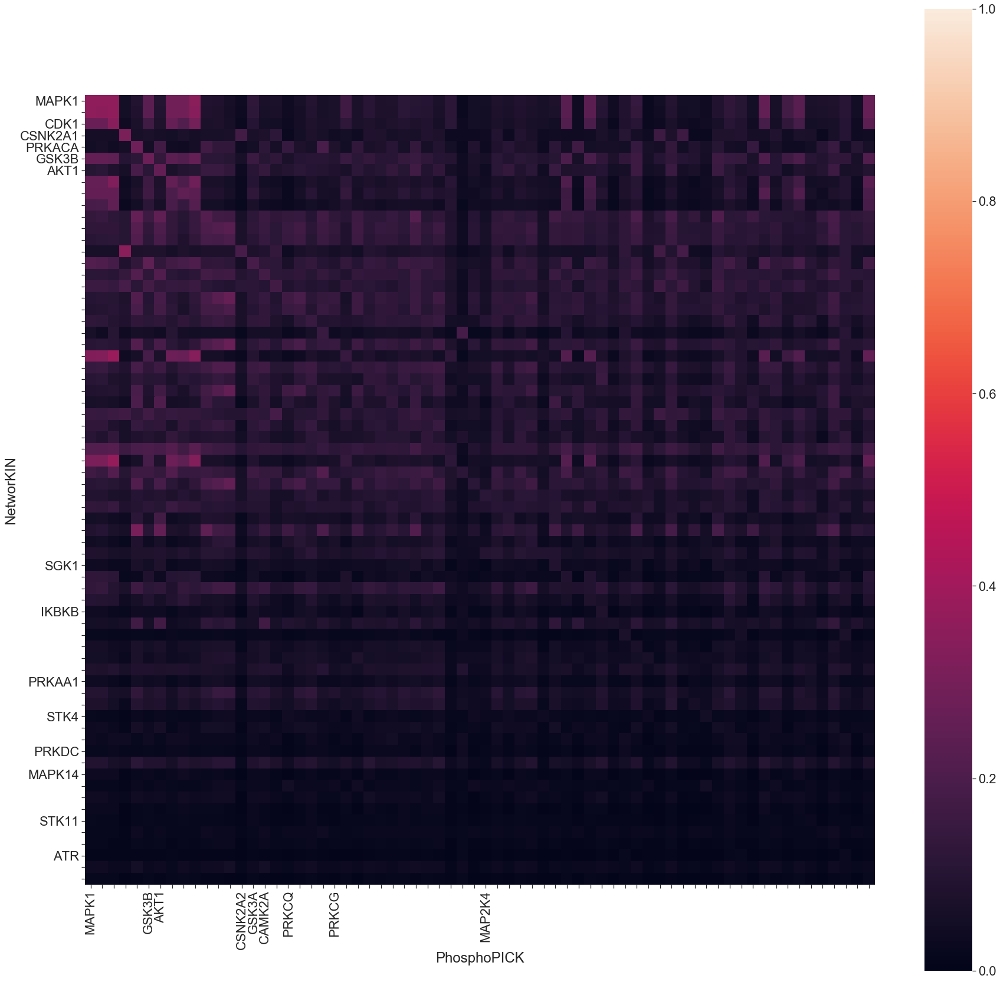

In [32]:
heatmap_y_mx = kinase_mutual_information.between_predictors(nw03_y, pp06_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_low_vs_PhosphoPICK_med_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_NetworKIN_low_vs_PhosphoPICK_med_Y_kinase','NetworKIN','PhosphoPICK', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(nw03_st, pp06_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_low_vs_PhosphoPICK_med_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_NetworKIN_low_vs_PhosphoPICK_med_ST_kinase', 'NetworKIN', 'PhosphoPICK', 'st')


11 overlapped kinases 
 NetworKIN :  50 kinases 
 PhosphoPICK :  19 kinases 



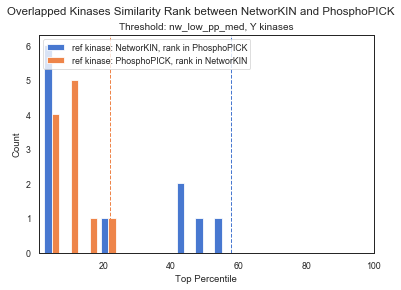

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


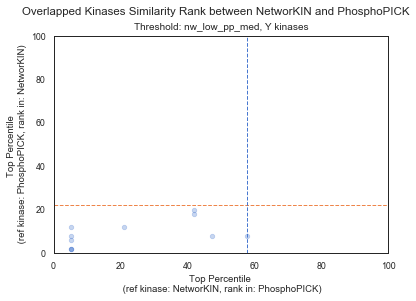

68 overlapped kinases 
 NetworKIN :  140 kinases 
 PhosphoPICK :  87 kinases 



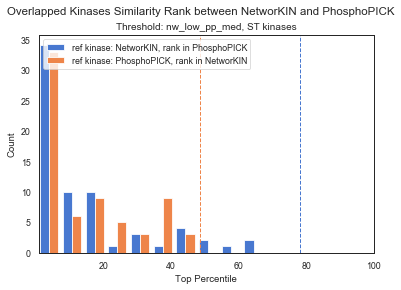

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


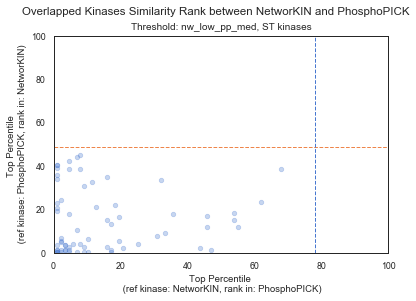

In [49]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_low_vs_PhosphoPICK_med_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, nw03_y, pp06_y , 'NetworKIN', 'PhosphoPICK' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_nw_low_pp_med.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'pp', 'nw_low_pp_med', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_low_vs_PhosphoPICK_med_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, nw03_st, pp06_st , 'NetworKIN', 'PhosphoPICK' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_nw_low_pp_med.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'pp', 'nw_low_pp_med', 'ST kinases', rank_dir + d_type + '_')


### NetworKIN(0.3) vs PhosphoPICK (0.02)
- index: kinases in NetworKIN
- column: kinases in PhosphoPICK

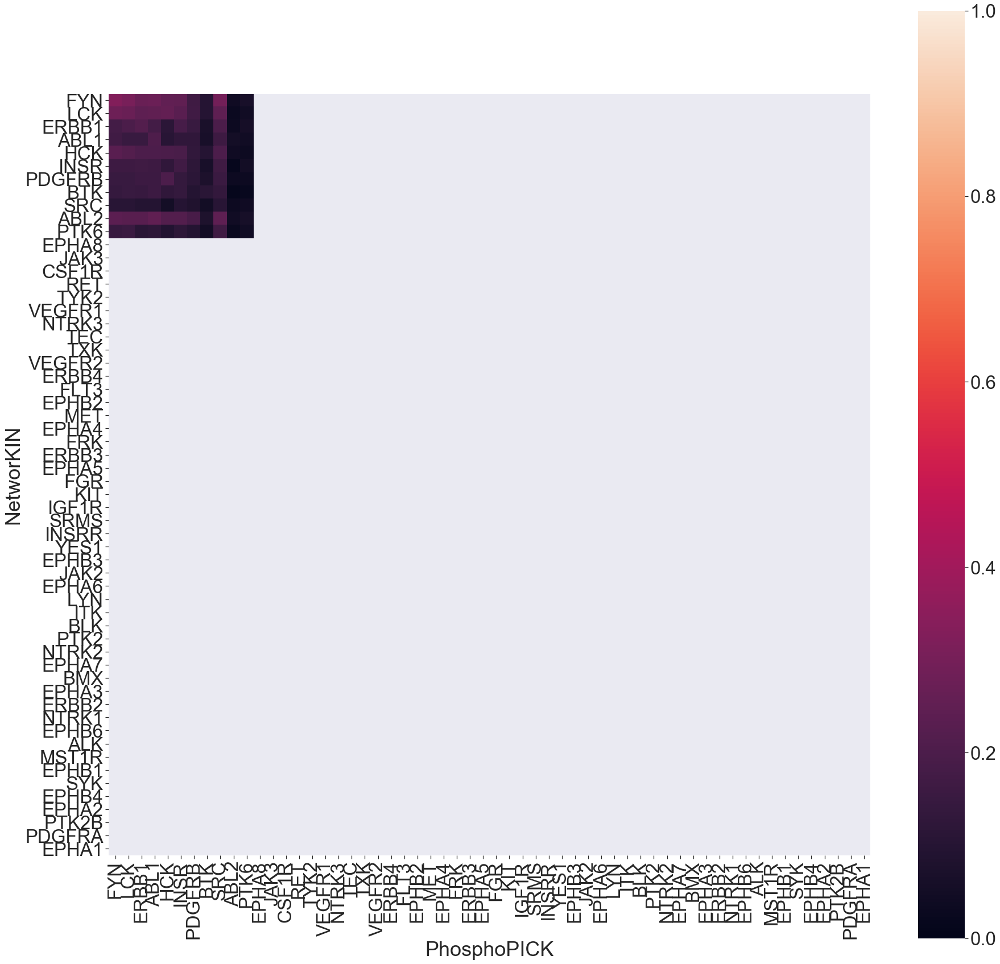

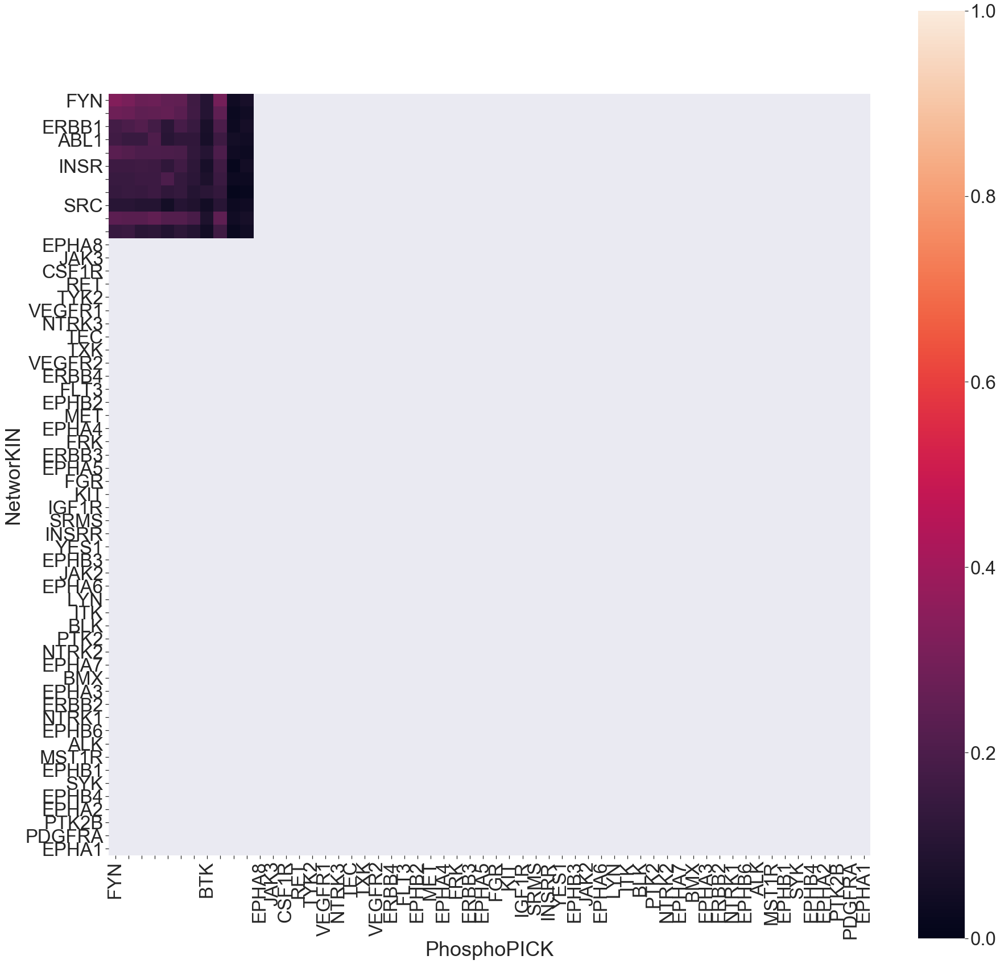

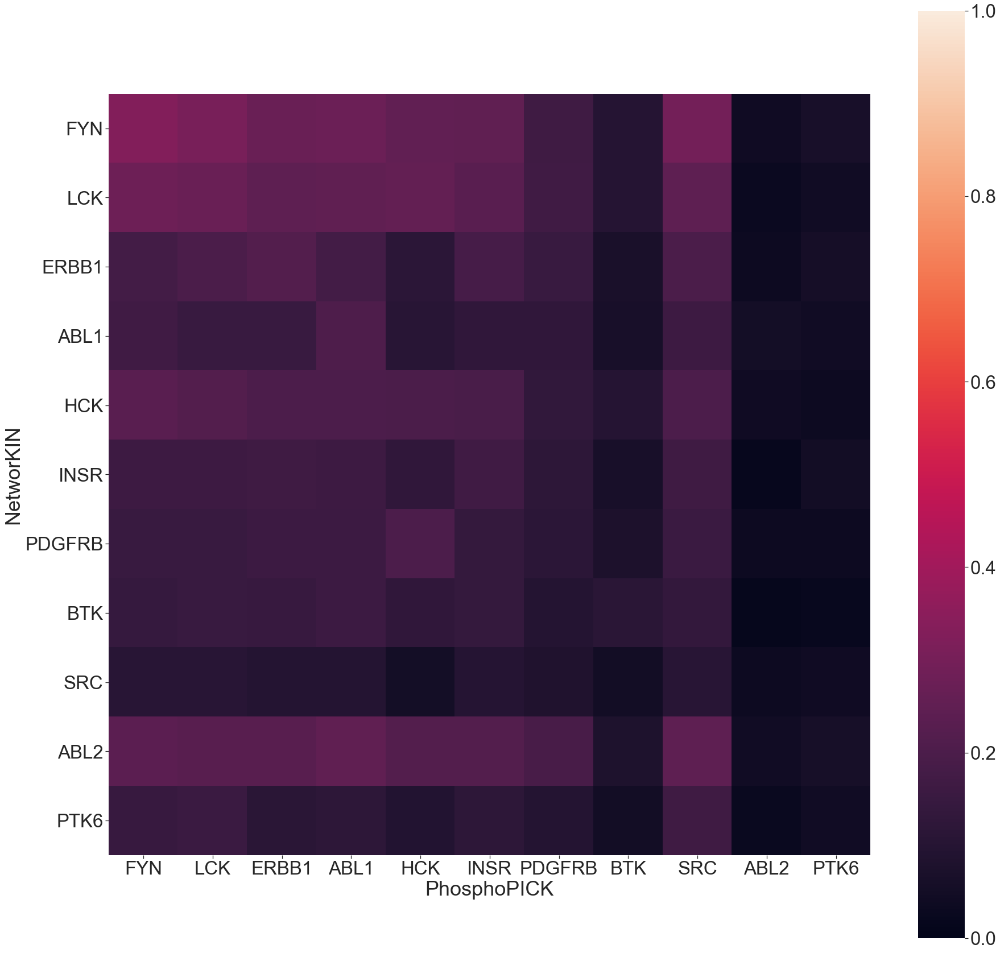

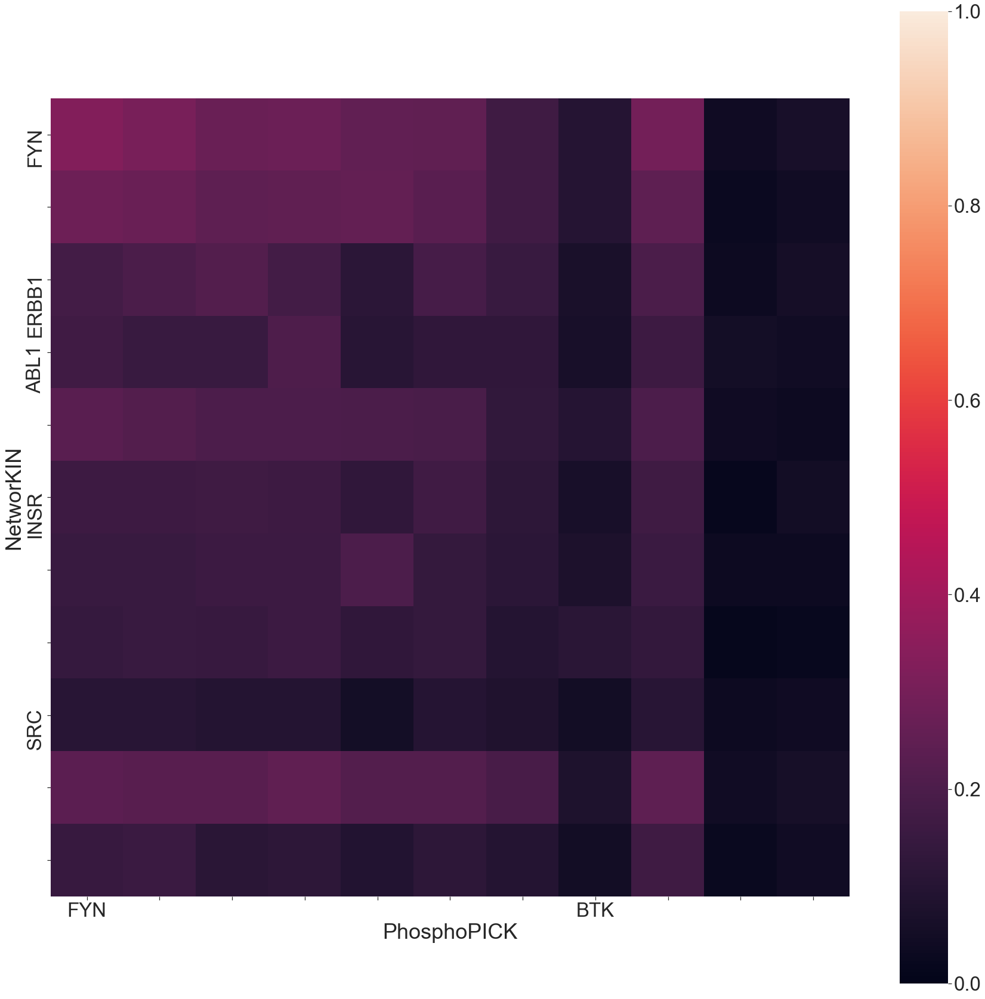

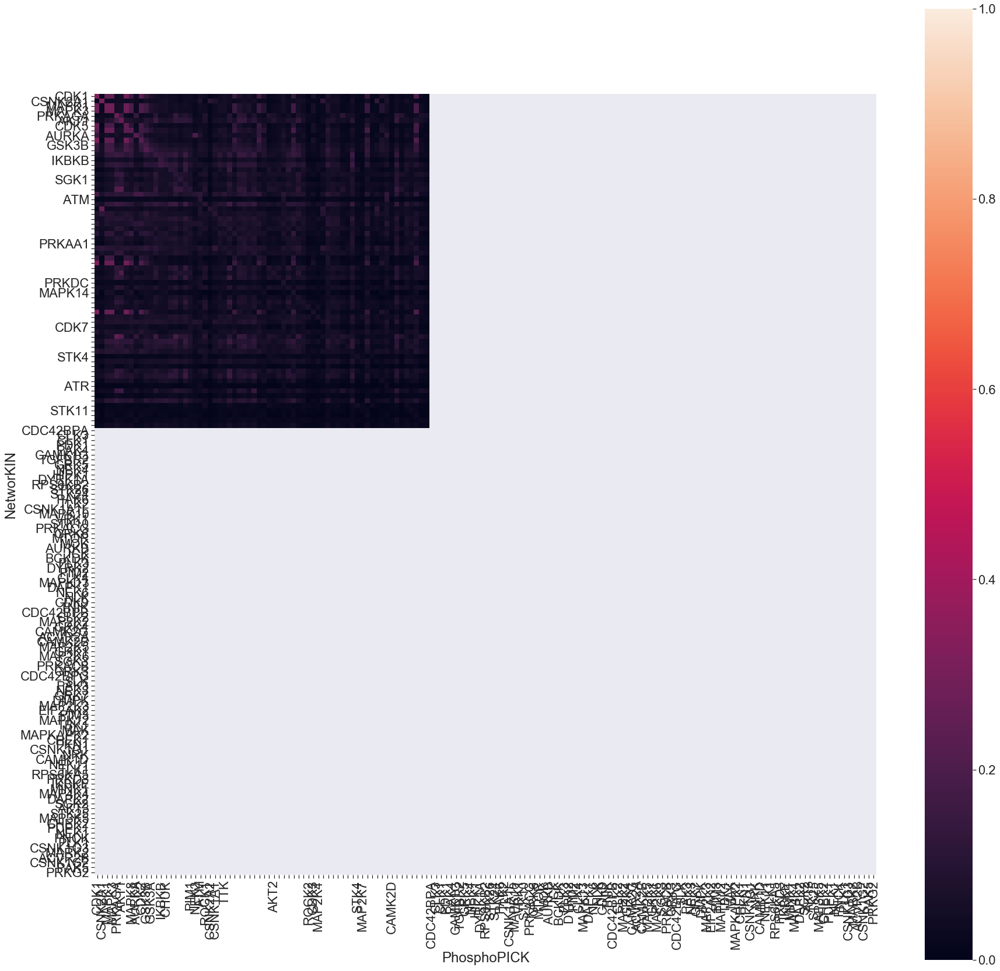

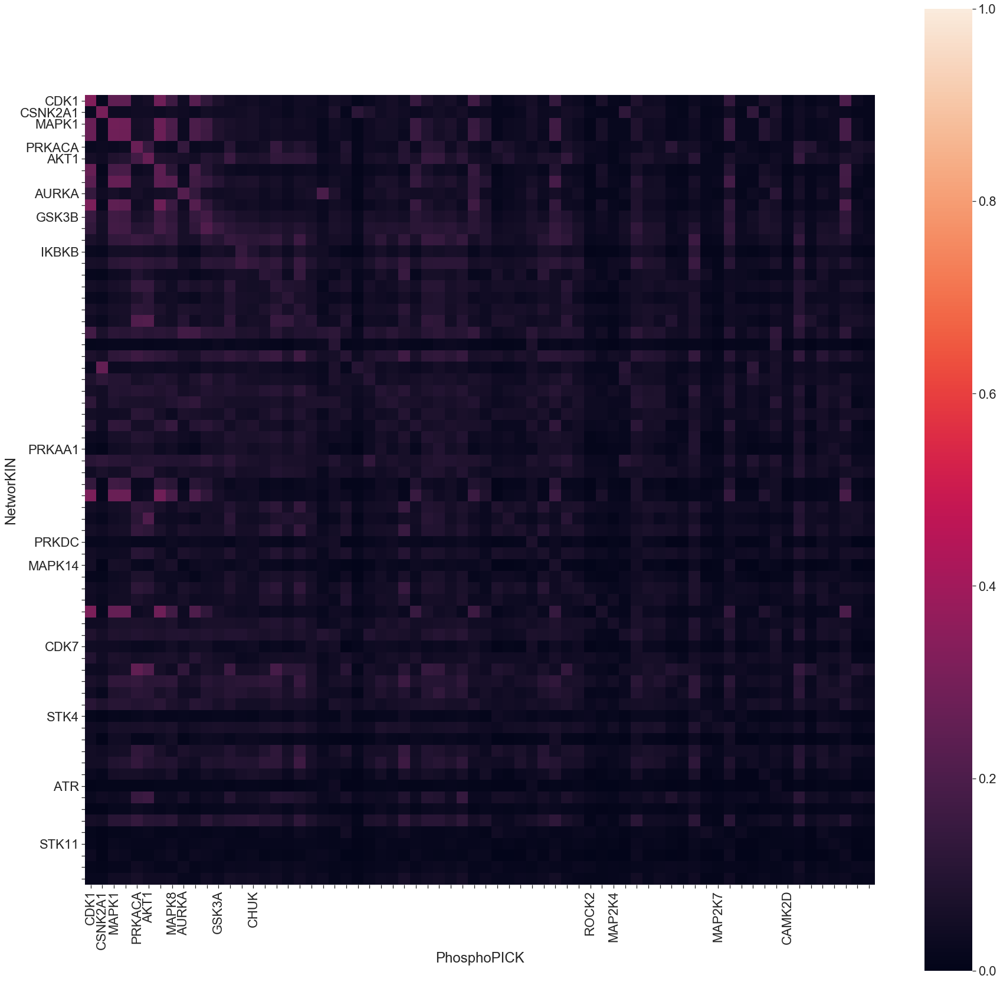

In [34]:
heatmap_y_mx = kinase_mutual_information.between_predictors(nw03_y, pp02_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_low_vs_PhosphoPICK_high_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_NetworKIN_low_vs_PhosphoPICK_high_Y_kinase','NetworKIN','PhosphoPICK', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(nw03_st, pp02_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_low_vs_PhosphoPICK_high_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_NetworKIN_low_vs_PhosphoPICK_high_ST_kinase', 'NetworKIN', 'PhosphoPICK', 'st')


11 overlapped kinases 
 NetworKIN :  50 kinases 
 PhosphoPICK :  19 kinases 



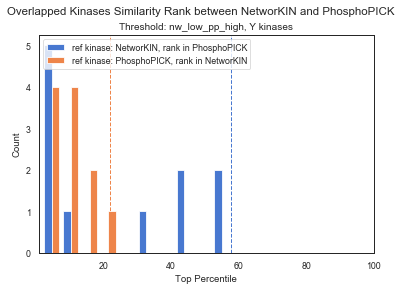

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


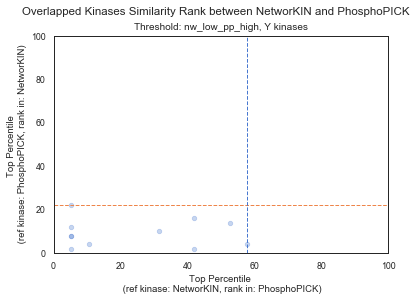

68 overlapped kinases 
 NetworKIN :  140 kinases 
 PhosphoPICK :  87 kinases 



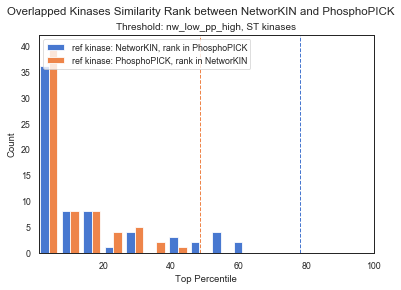

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


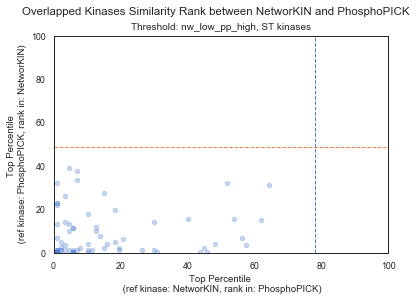

In [48]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_low_vs_PhosphoPICK_high_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, nw03_y, pp02_y , 'NetworKIN', 'PhosphoPICK' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_nw_low_pp_high.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'pp', 'nw_low_pp_high', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_low_vs_PhosphoPICK_high_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, nw03_st, pp02_st , 'NetworKIN', 'PhosphoPICK' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_nw_low_pp_high.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'pp', 'nw_low_pp_high', 'ST kinases', rank_dir + d_type + '_')


### NetworKIN(0.5) vs PhosphoPICK (0.02)
- index: kinases in NetworKIN
- column: kinases in PhosphoPICK

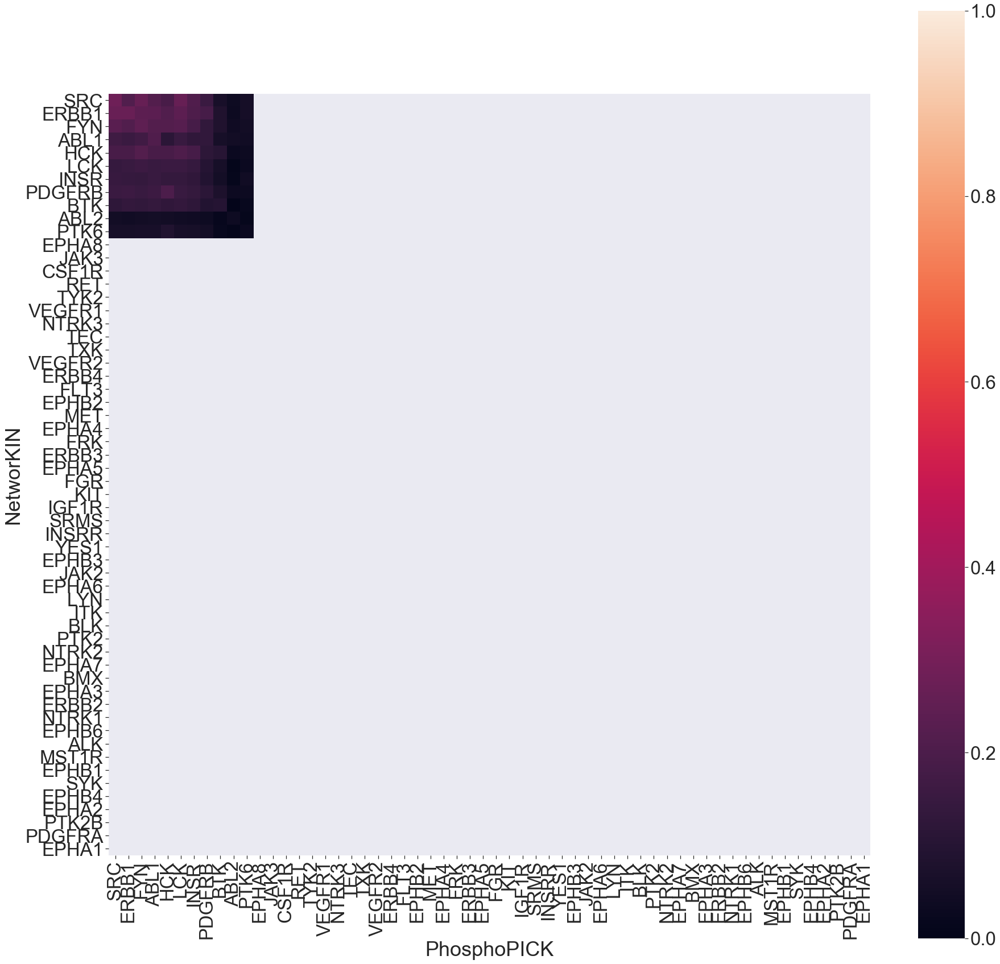

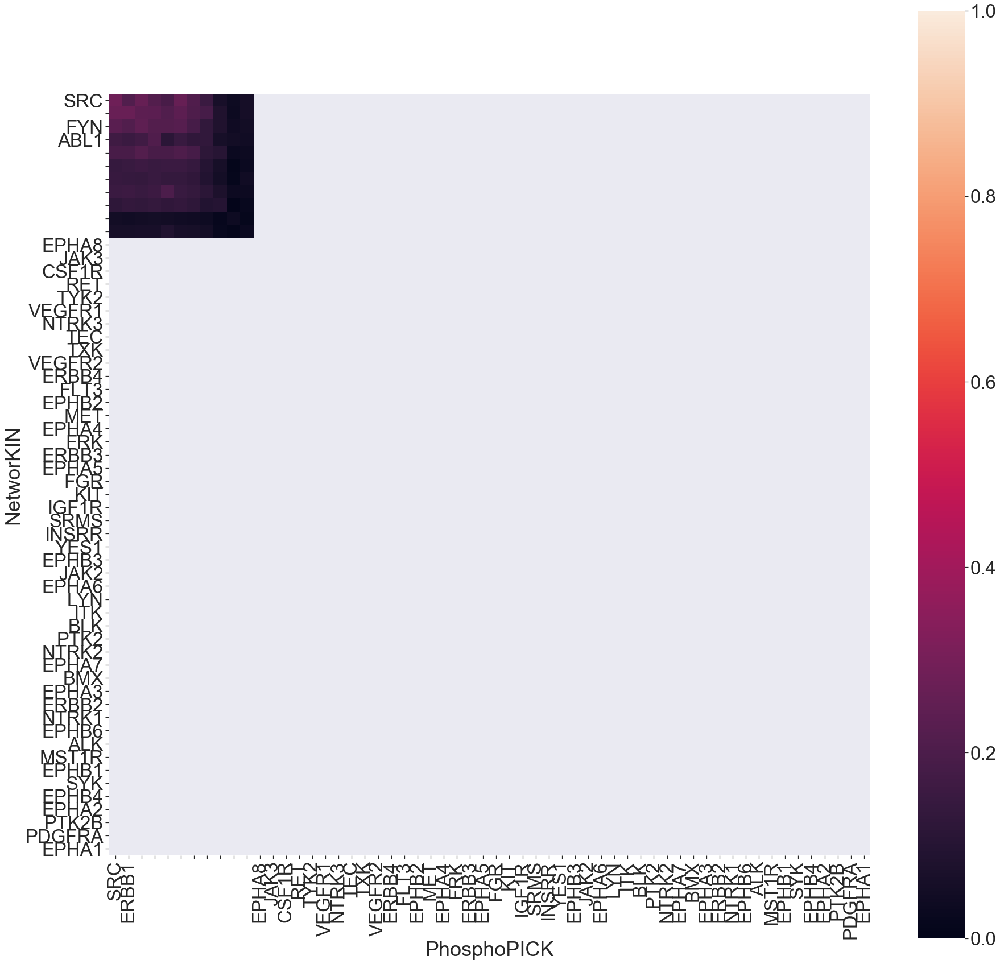

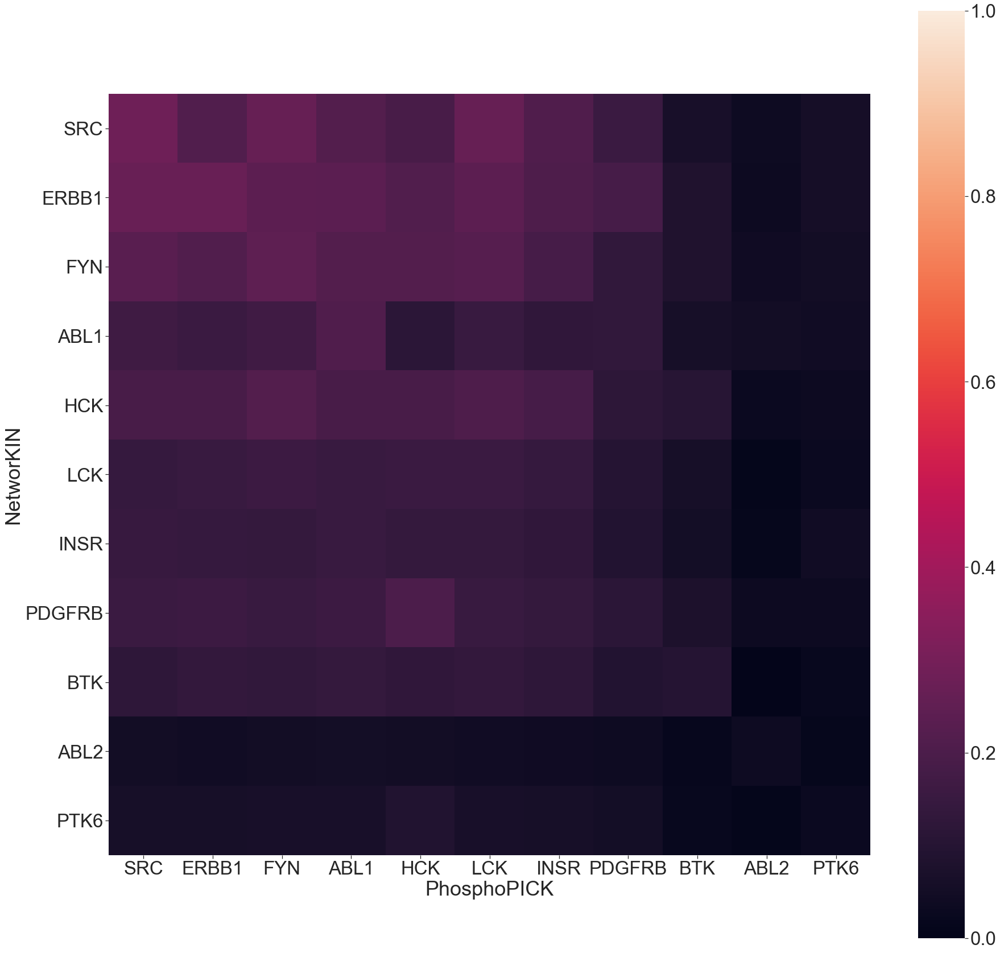

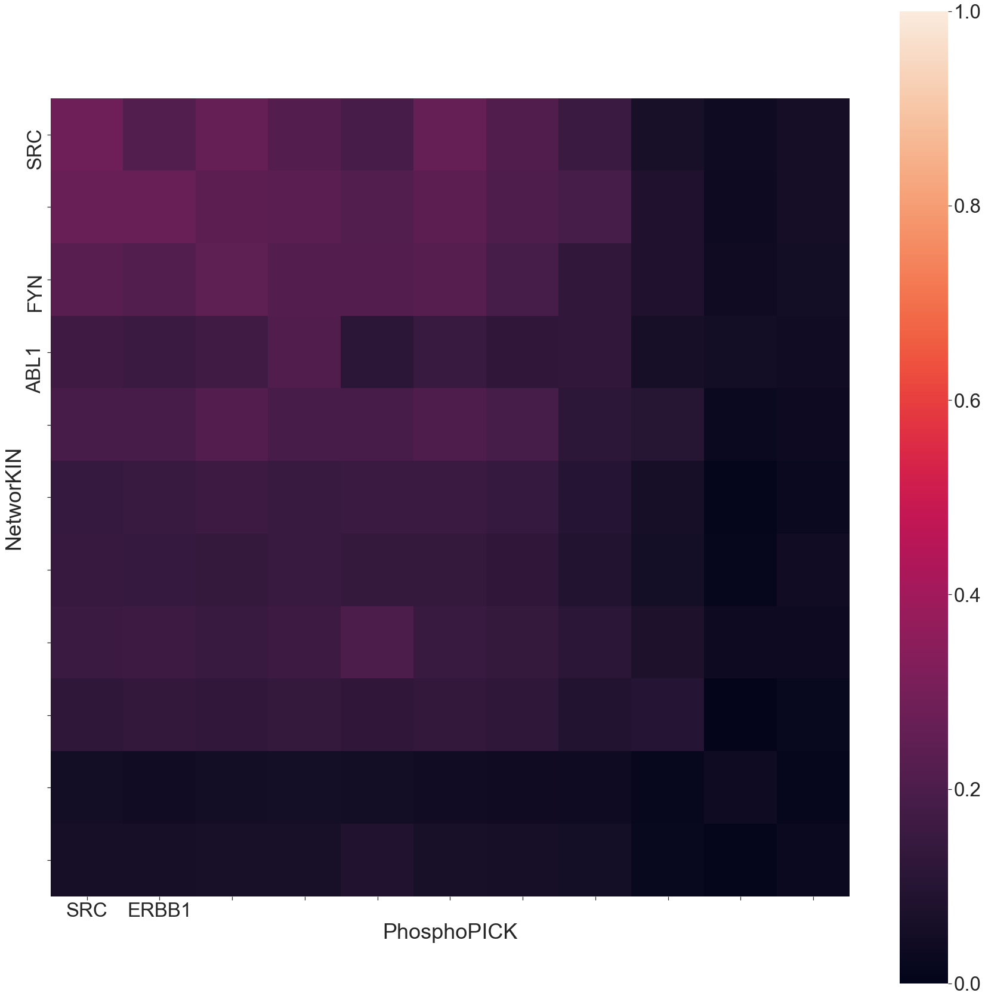

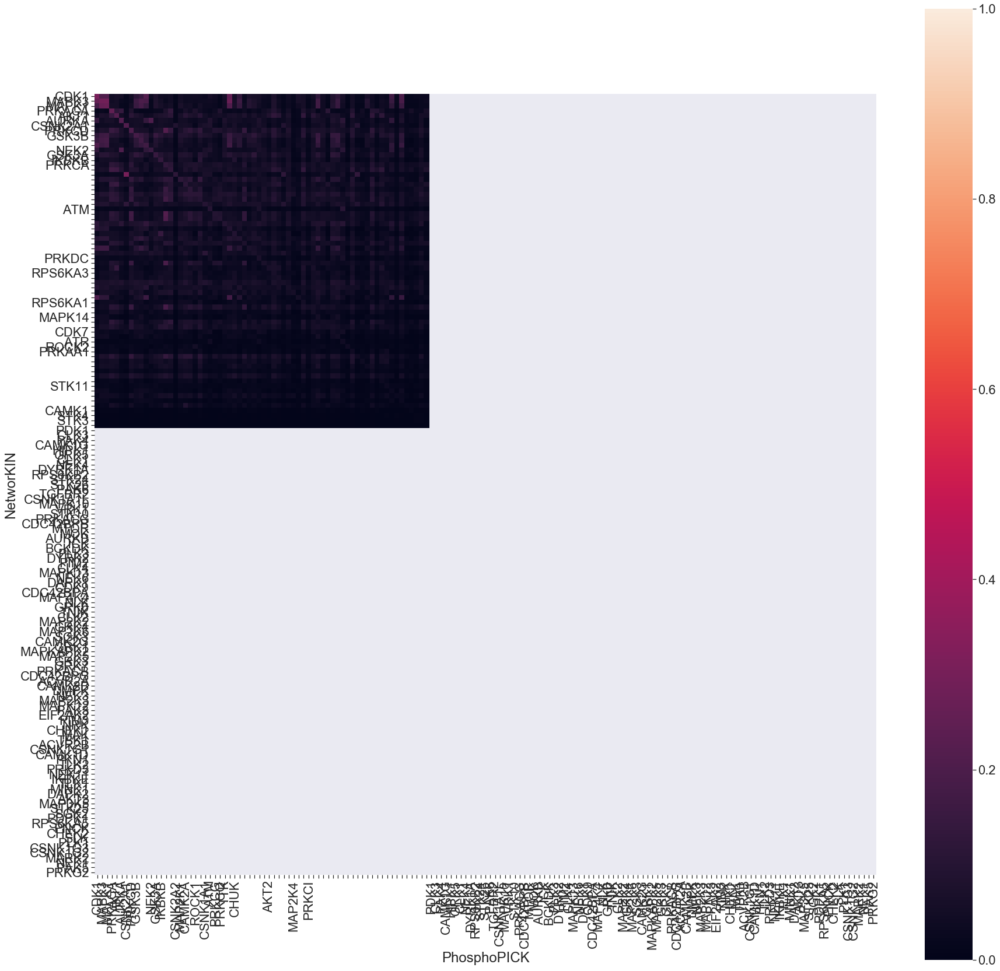

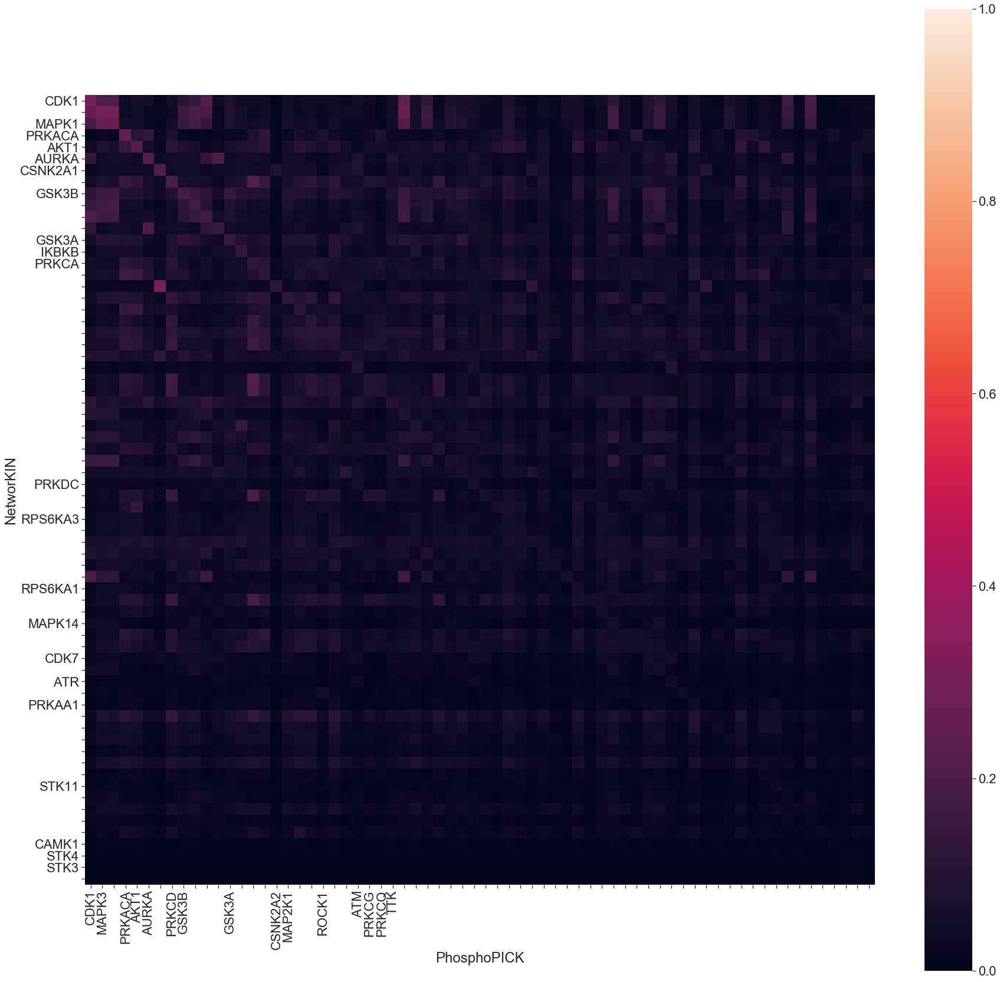

In [36]:
heatmap_y_mx = kinase_mutual_information.between_predictors(nw05_y, pp02_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_med_vs_PhosphoPICK_high_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_NetworKIN_med_vs_PhosphoPICK_high_Y_kinase','NetworKIN','PhosphoPICK', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(nw05_st, pp02_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_med_vs_PhosphoPICK_high_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_NetworKIN_med_vs_PhosphoPICK_high_ST_kinase', 'NetworKIN', 'PhosphoPICK', 'st')


11 overlapped kinases 
 NetworKIN :  50 kinases 
 PhosphoPICK :  19 kinases 



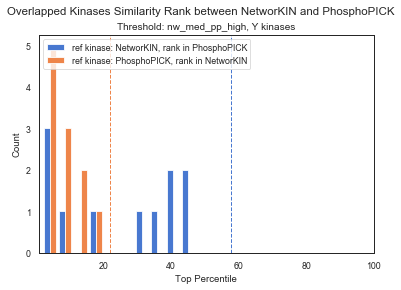

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


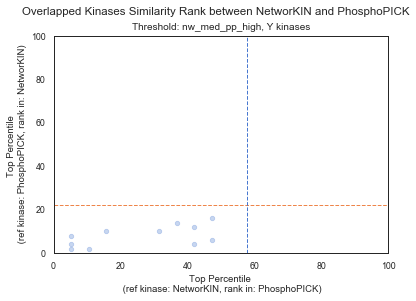

68 overlapped kinases 
 NetworKIN :  140 kinases 
 PhosphoPICK :  87 kinases 



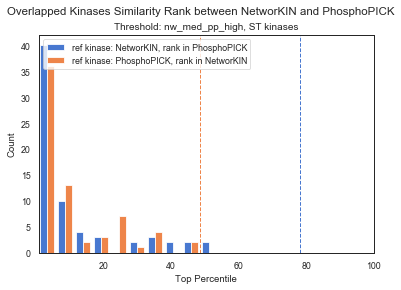

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


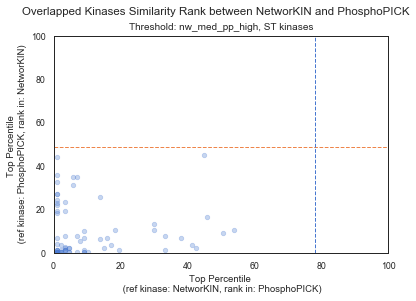

In [47]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_med_vs_PhosphoPICK_high_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, nw05_y, pp02_y , 'NetworKIN', 'PhosphoPICK' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_nw_med_pp_high.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'pp', 'nw_med_pp_high', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_med_vs_PhosphoPICK_high_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, nw05_st, pp02_st , 'NetworKIN', 'PhosphoPICK' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_nw_med_pp_high.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'pp', 'nw_med_pp_high', 'ST kinases', rank_dir + d_type + '_')


### NetworKIN(0.5) vs PhosphoPICK (0.1)
- index: kinases in NetworKIN
- column: kinases in PhosphoPICK

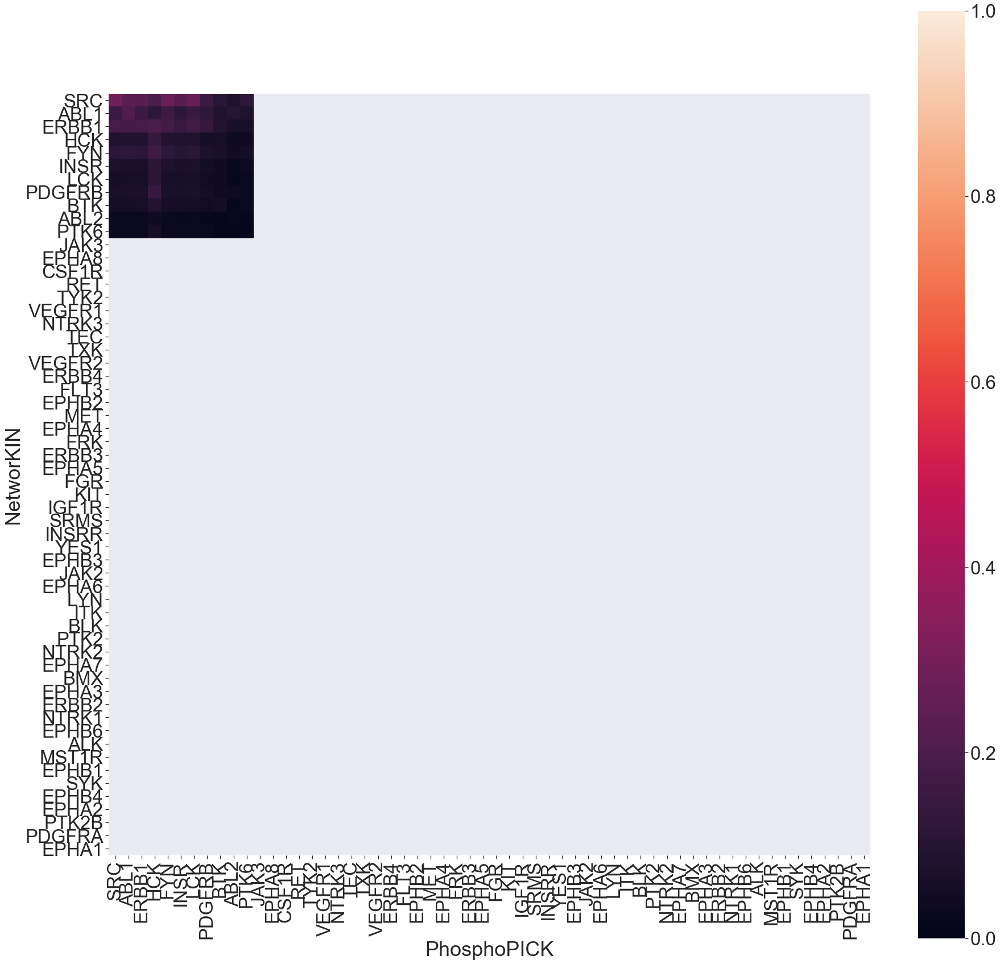

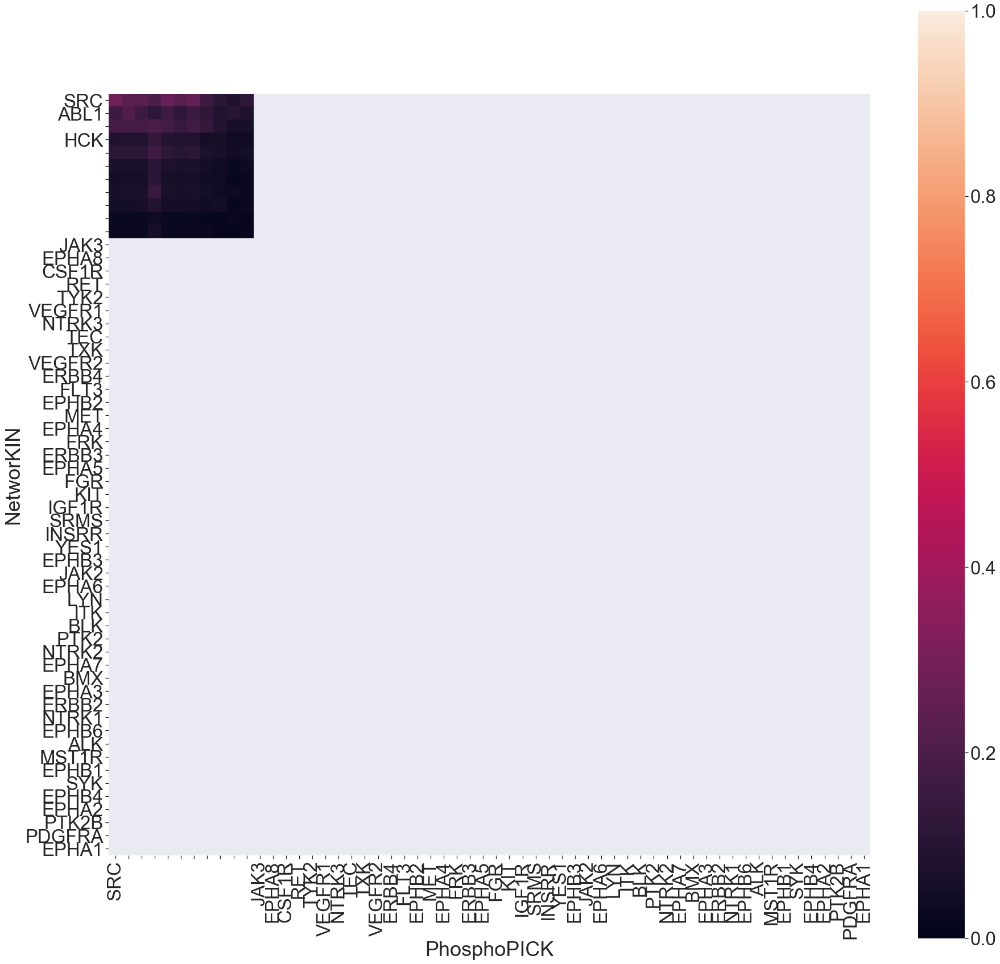

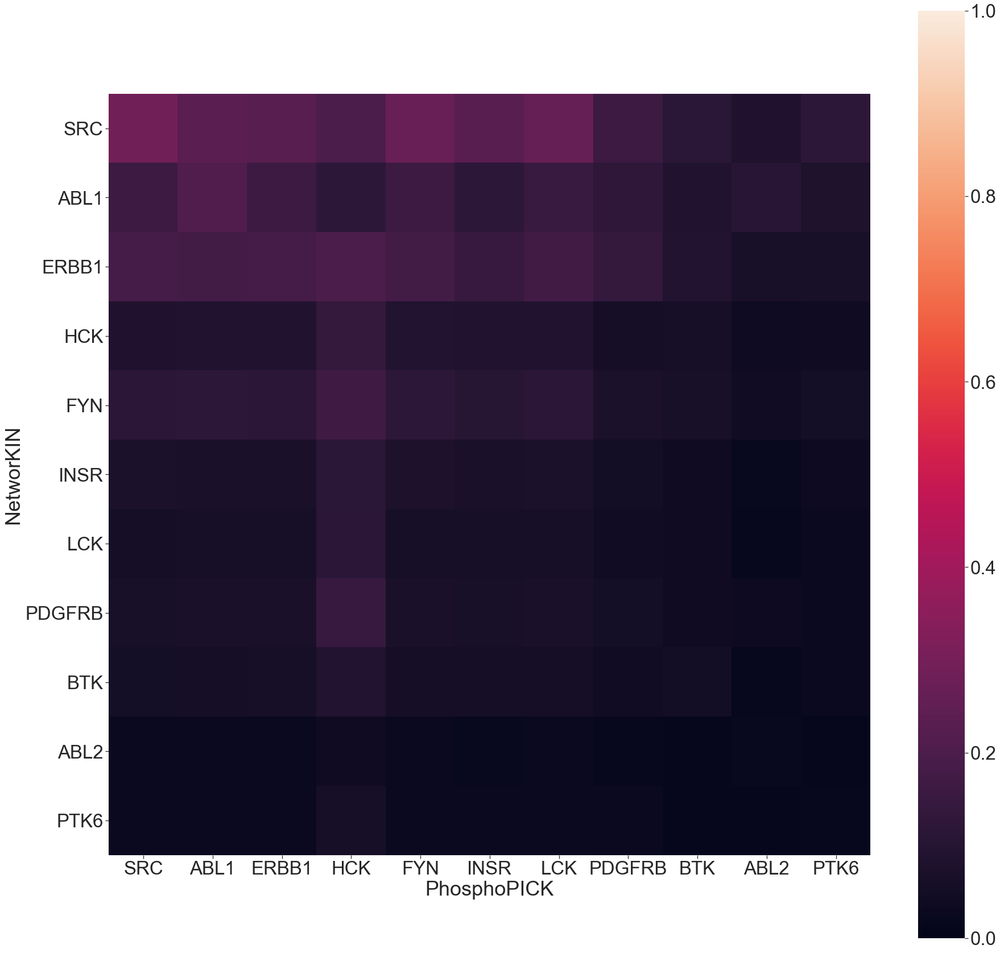

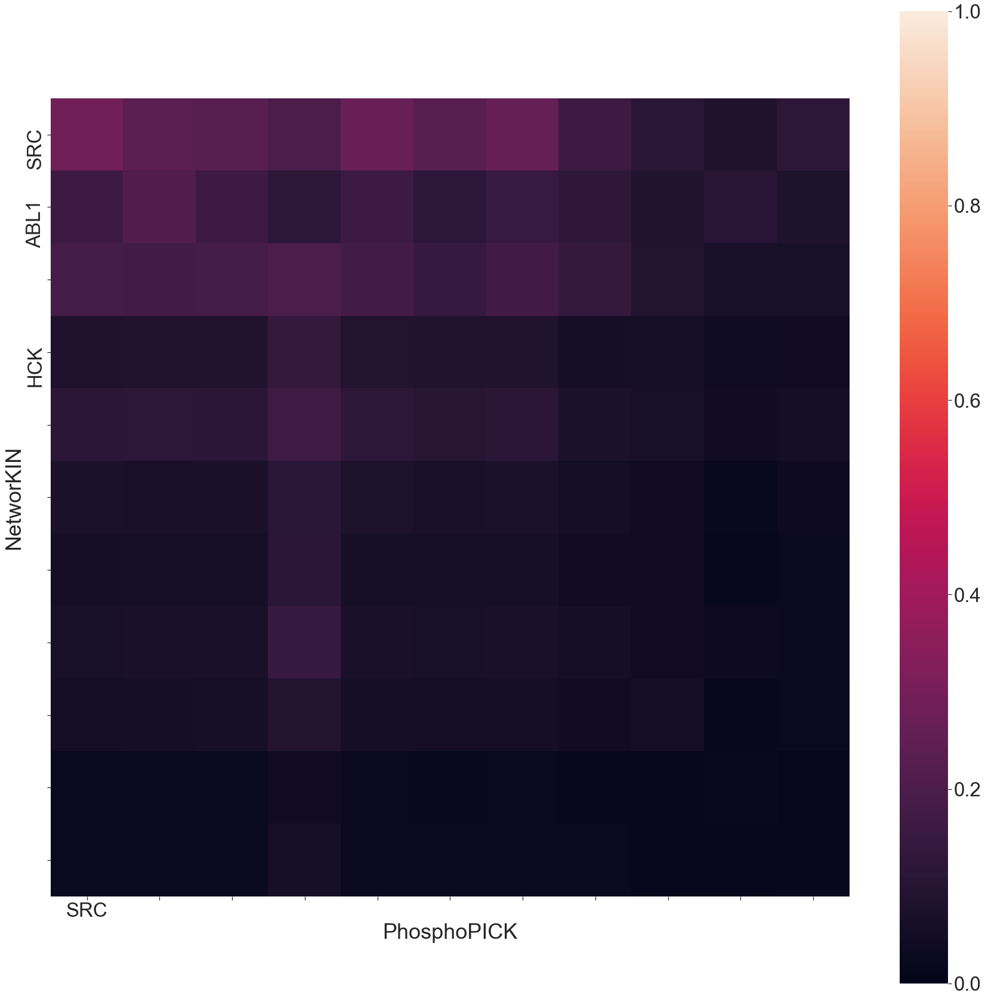

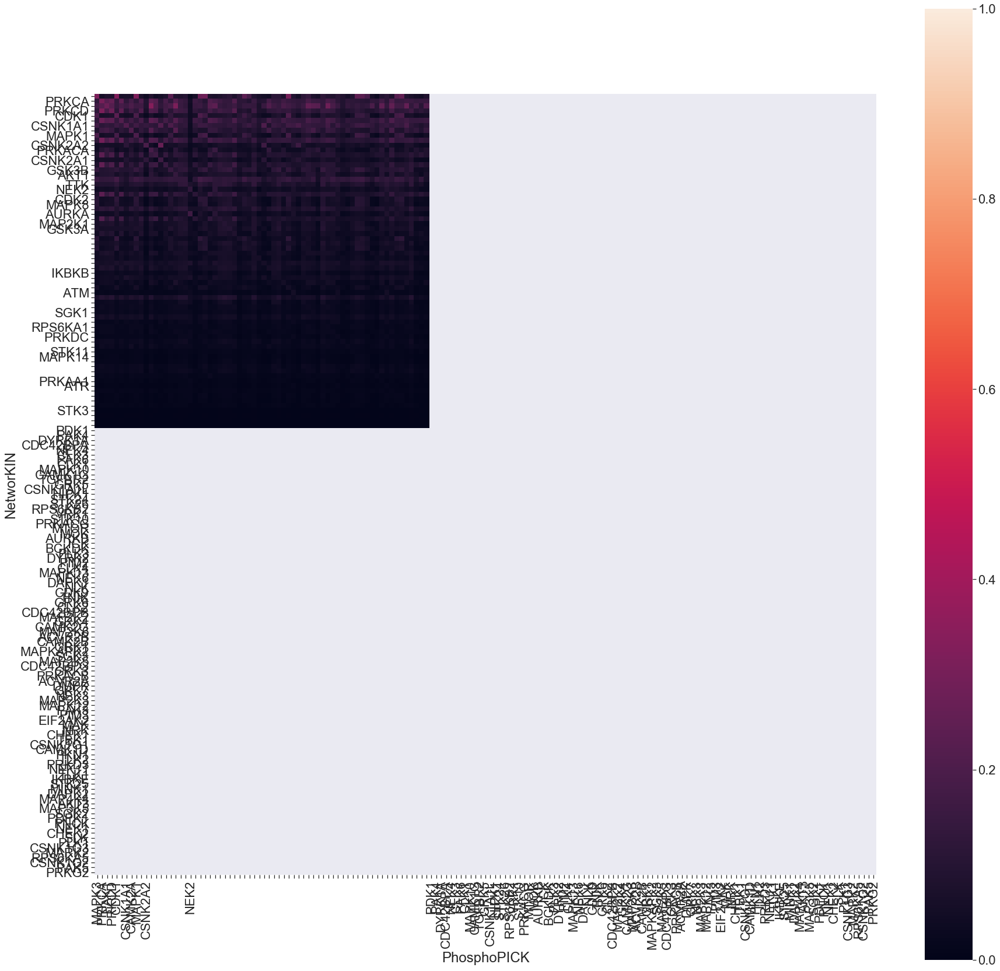

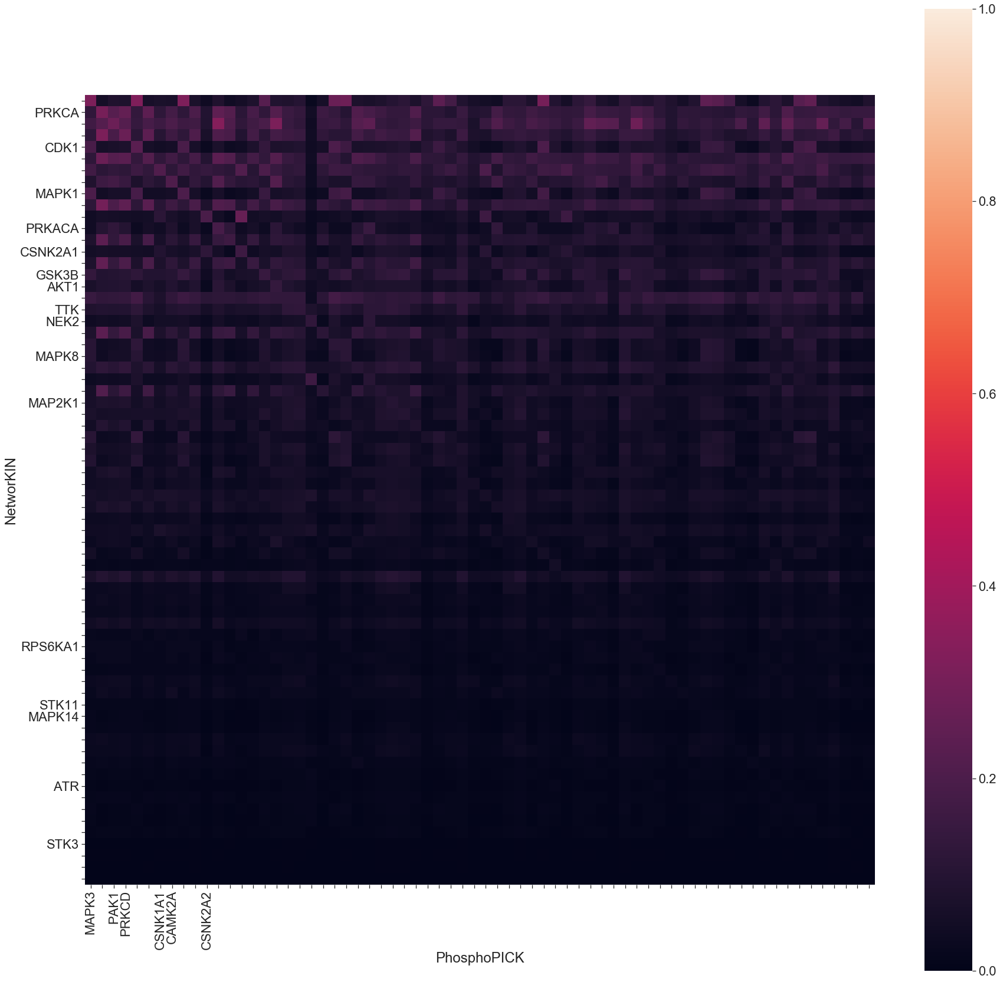

In [38]:
heatmap_y_mx = kinase_mutual_information.between_predictors(nw05_y, pp1_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_med_vs_PhosphoPICK_low_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_NetworKIN_med_vs_PhosphoPICK_low_Y_kinase','NetworKIN','PhosphoPICK', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(nw05_st, pp1_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_med_vs_PhosphoPICK_low_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_NetworKIN_med_vs_PhosphoPICK_low_ST_kinase', 'NetworKIN', 'PhosphoPICK', 'st')


11 overlapped kinases 
 NetworKIN :  50 kinases 
 PhosphoPICK :  19 kinases 



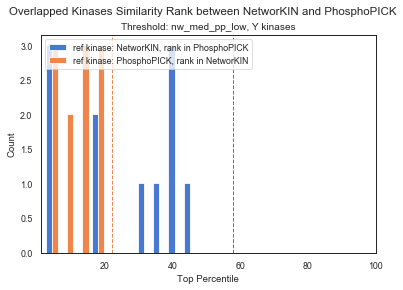

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


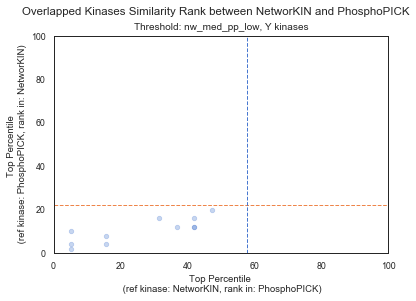

68 overlapped kinases 
 NetworKIN :  140 kinases 
 PhosphoPICK :  87 kinases 



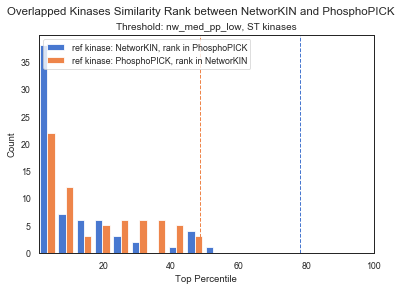

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


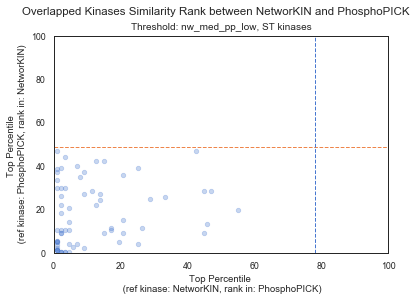

In [46]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_med_vs_PhosphoPICK_low_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, nw05_y, pp1_y , 'NetworKIN', 'PhosphoPICK' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_nw_med_pp_low.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'pp', 'nw_med_pp_low', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_med_vs_PhosphoPICK_low_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, nw05_st, pp1_st , 'NetworKIN', 'PhosphoPICK' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_nw_med_pp_low.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'pp', 'nw_med_pp_low', 'ST kinases', rank_dir + d_type + '_')


### NetworKIN(1) vs PhosphoPICK (0.1)
- index: kinases in NetworKIN
- column: kinases in PhosphoPICK

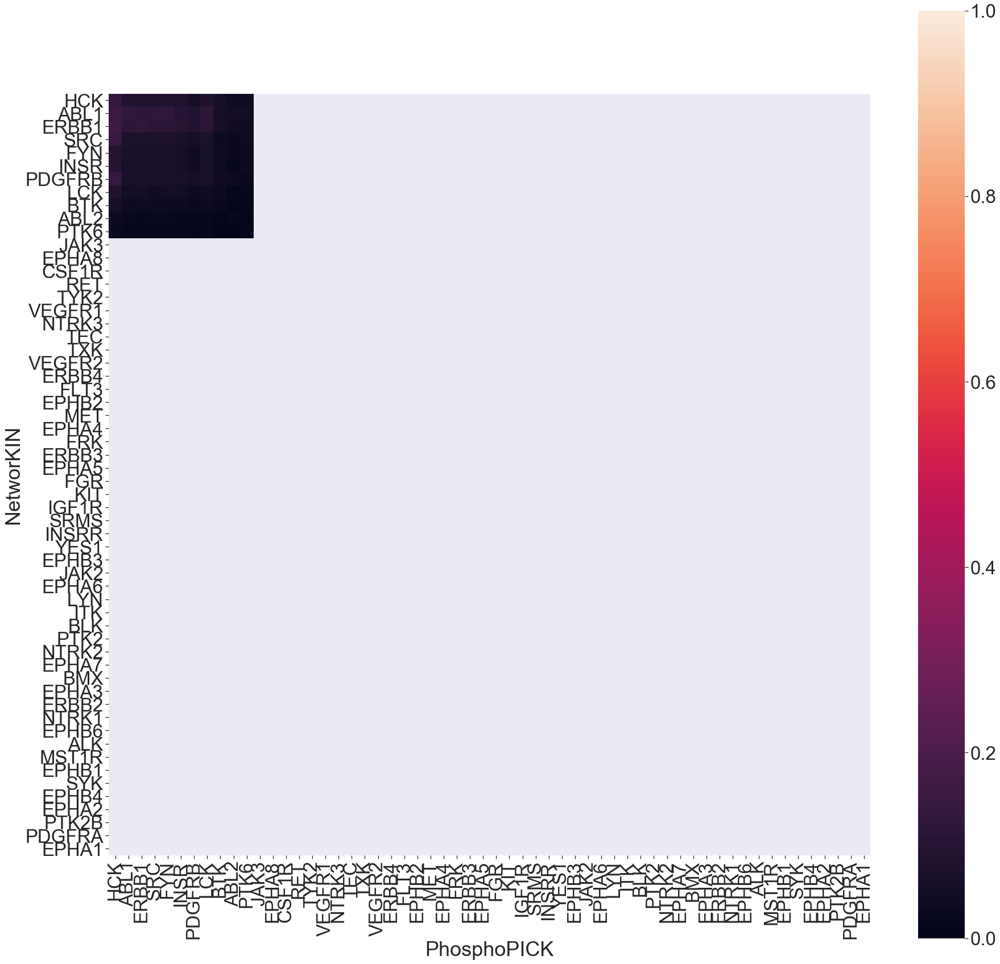

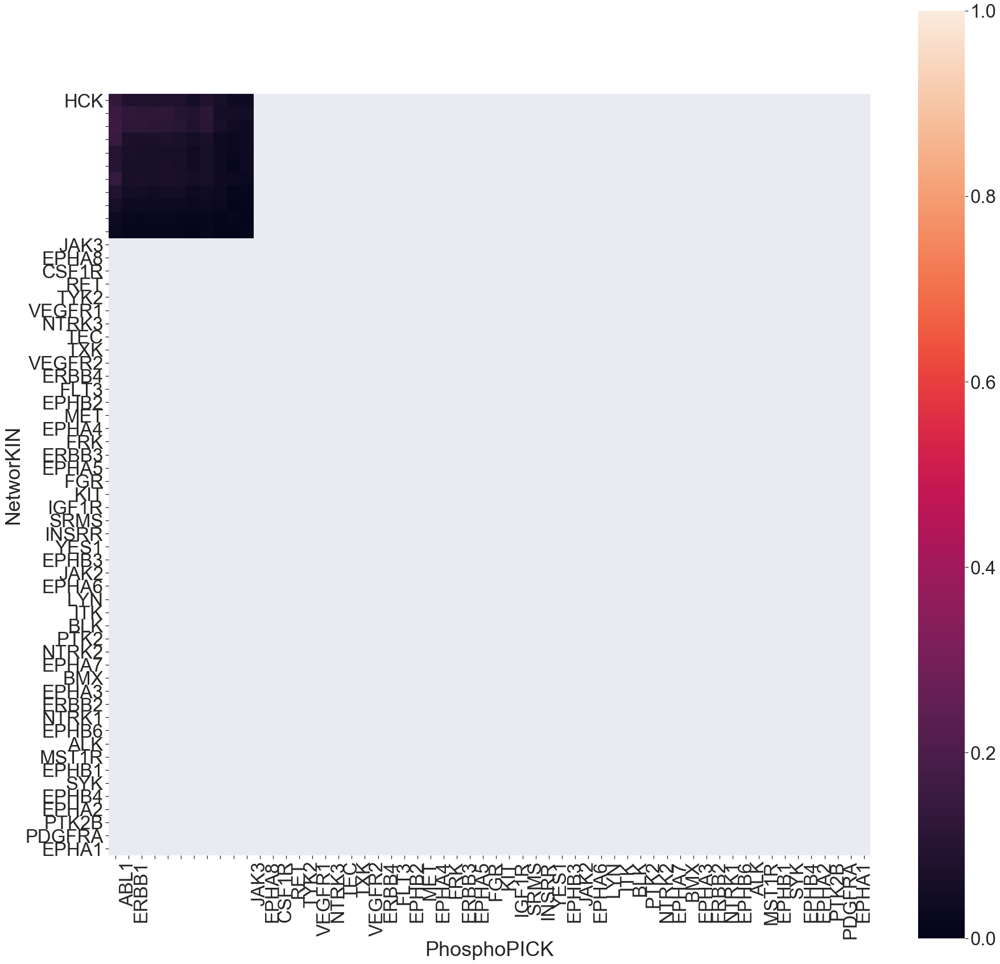

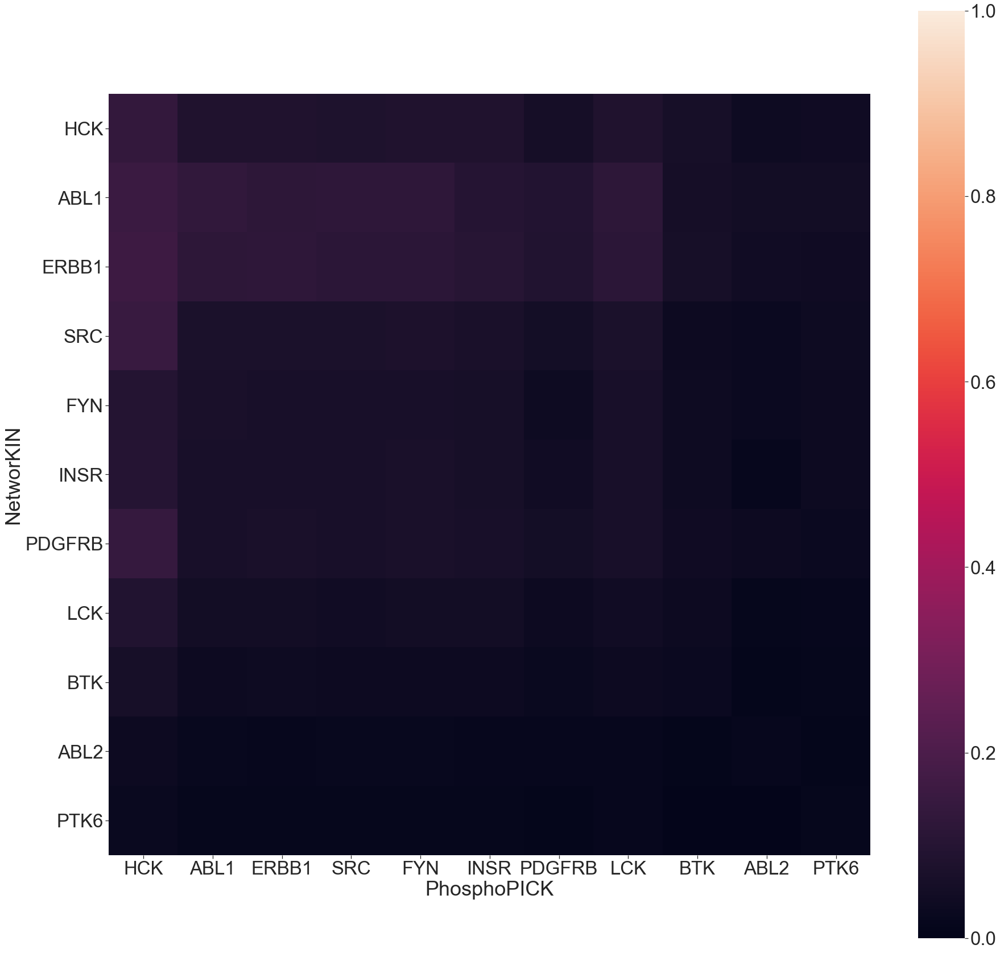

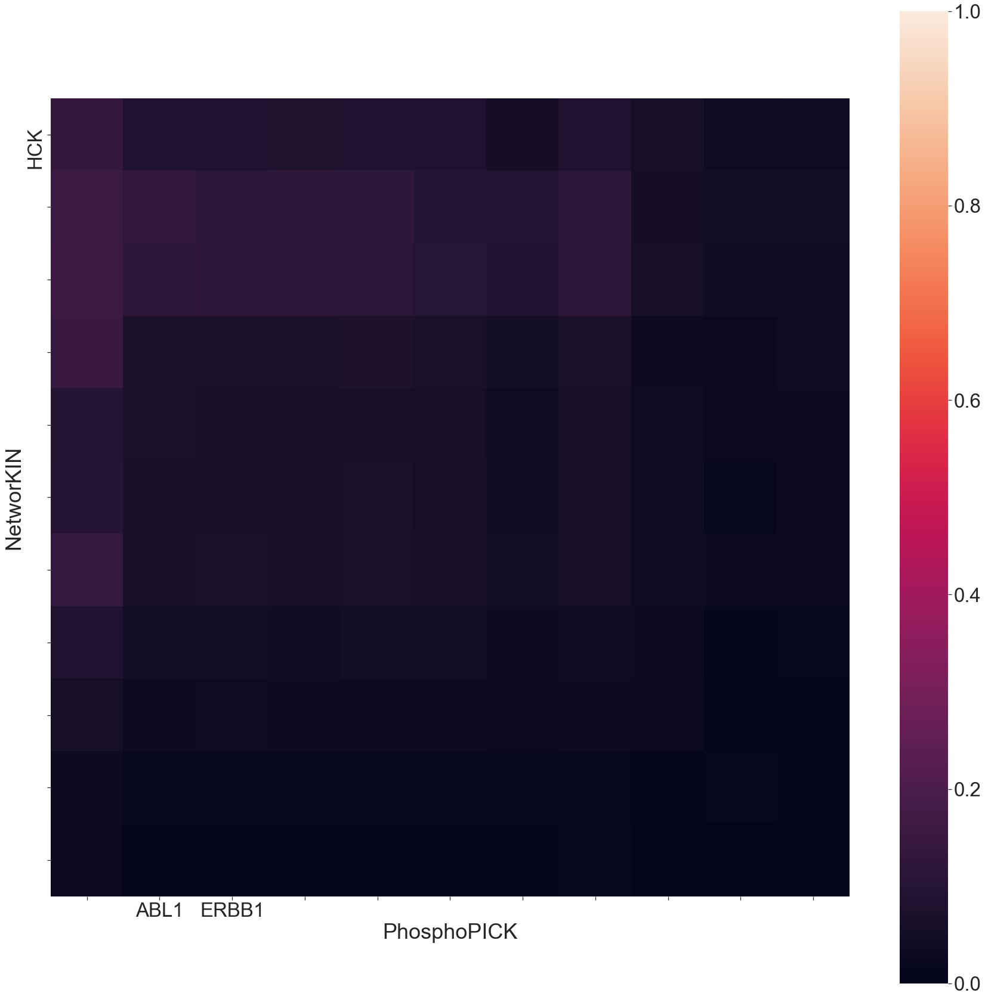

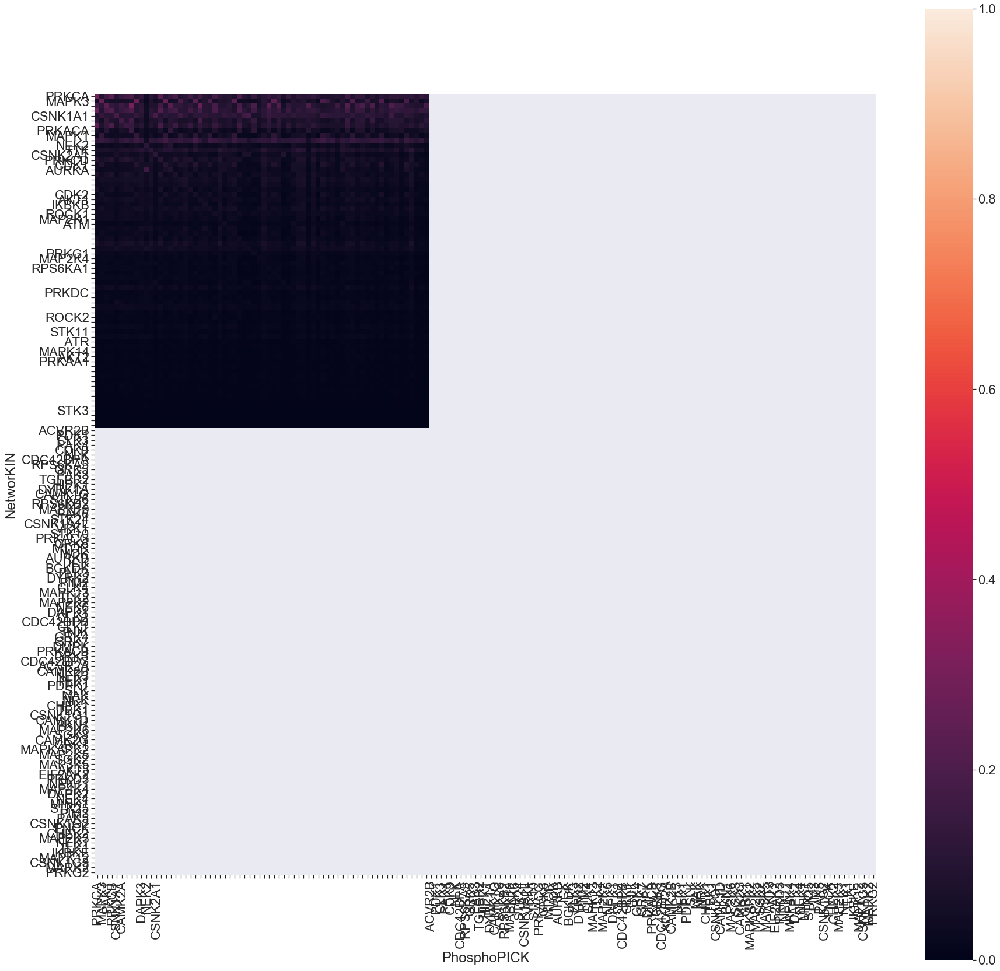

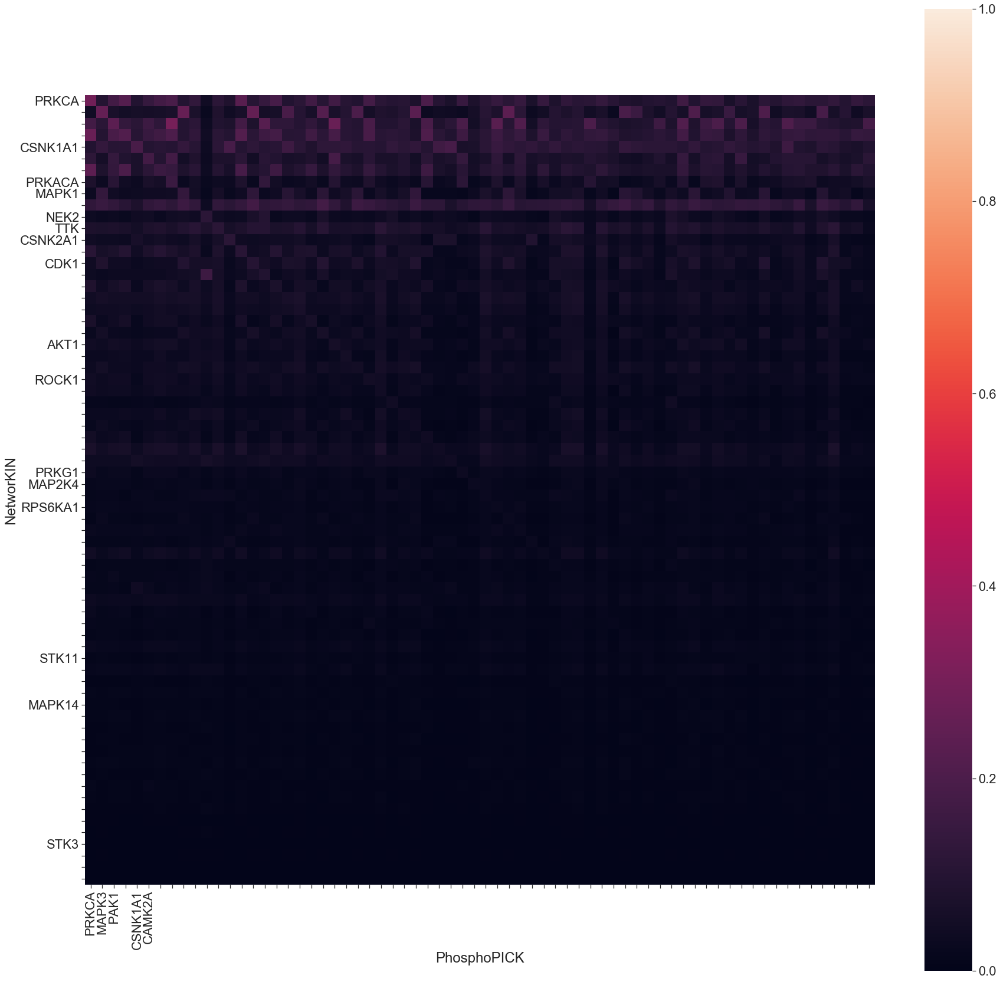

In [40]:
heatmap_y_mx = kinase_mutual_information.between_predictors(nw1_y, pp1_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_high_vs_PhosphoPICK_low_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_NetworKIN_high_vs_PhosphoPICK_low_Y_kinase','NetworKIN','PhosphoPICK', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(nw1_st, pp1_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_high_vs_PhosphoPICK_low_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_NetworKIN_high_vs_PhosphoPICK_low_ST_kinase', 'NetworKIN', 'PhosphoPICK', 'st')


11 overlapped kinases 
 NetworKIN :  50 kinases 
 PhosphoPICK :  19 kinases 



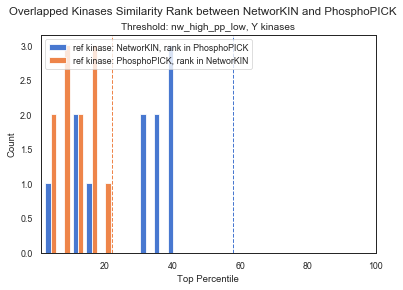

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


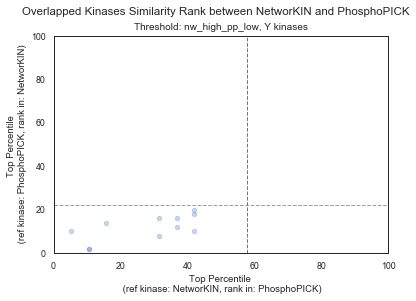

68 overlapped kinases 
 NetworKIN :  140 kinases 
 PhosphoPICK :  87 kinases 



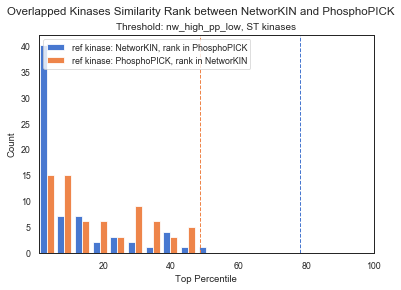

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


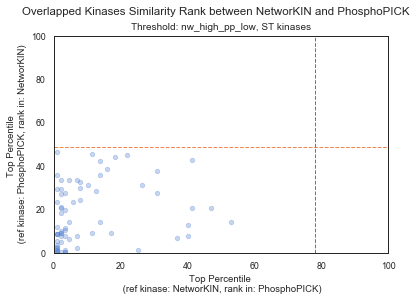

In [45]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_high_vs_PhosphoPICK_low_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, nw1_y, pp1_y , 'NetworKIN', 'PhosphoPICK' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_nw_high_pp_low.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'pp', 'nw_high_pp_low', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_high_vs_PhosphoPICK_low_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, nw1_st, pp1_st , 'NetworKIN', 'PhosphoPICK' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_nw_high_pp_low.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'pp', 'nw_high_pp_low', 'ST kinases', rank_dir + d_type + '_')


### NetworKIN(1) vs PhosphoPICK (0.06)
- index: kinases in NetworKIN
- column: kinases in PhosphoPICK

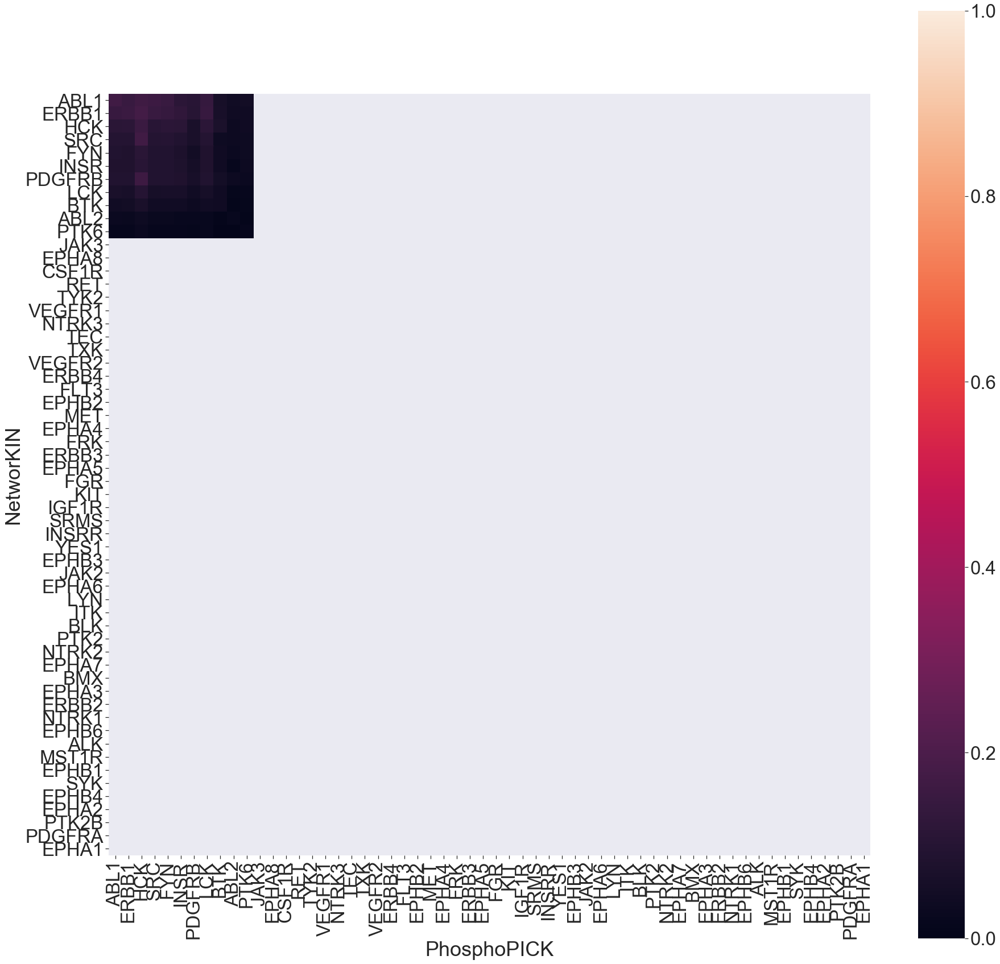

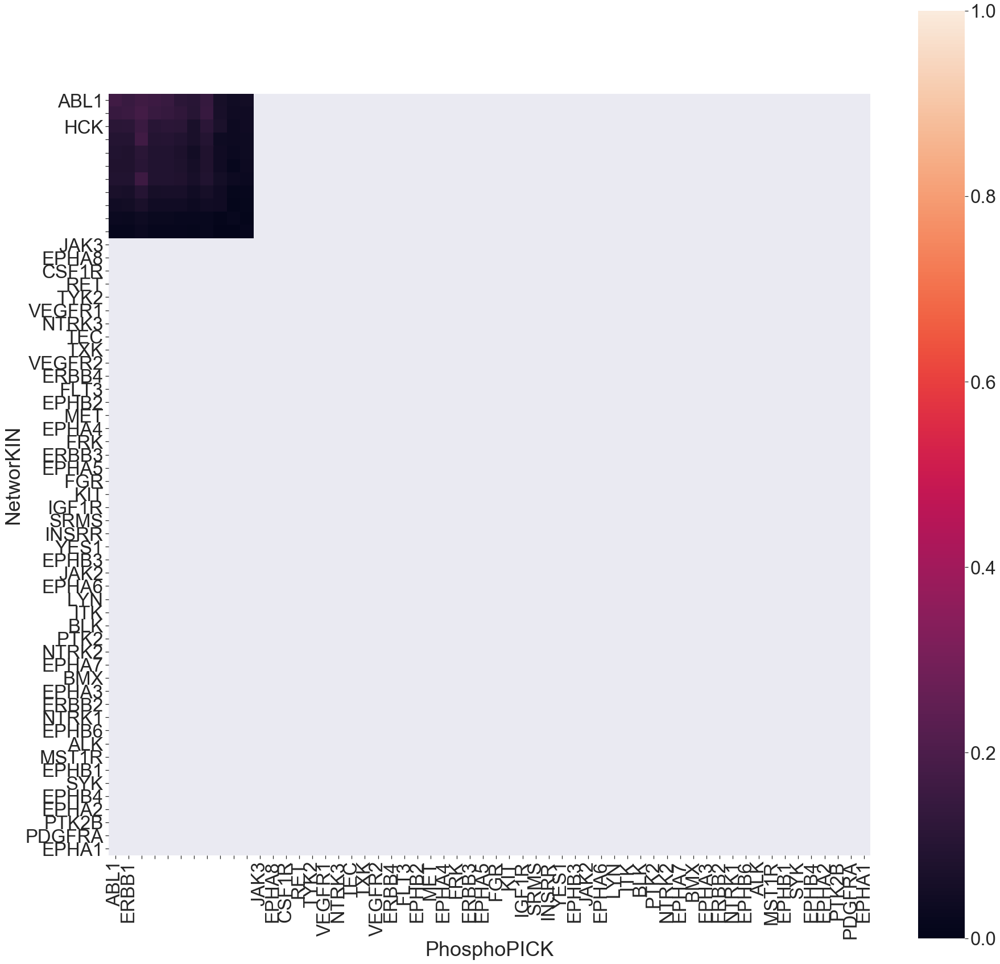

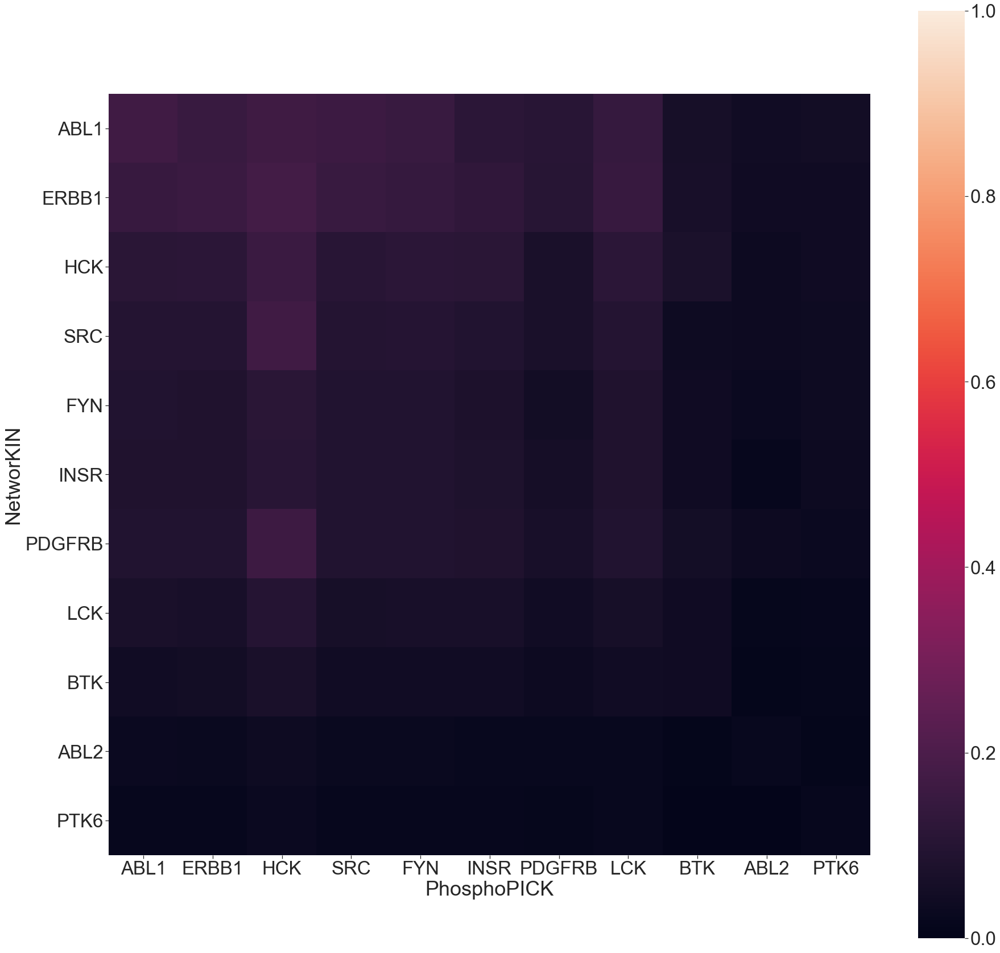

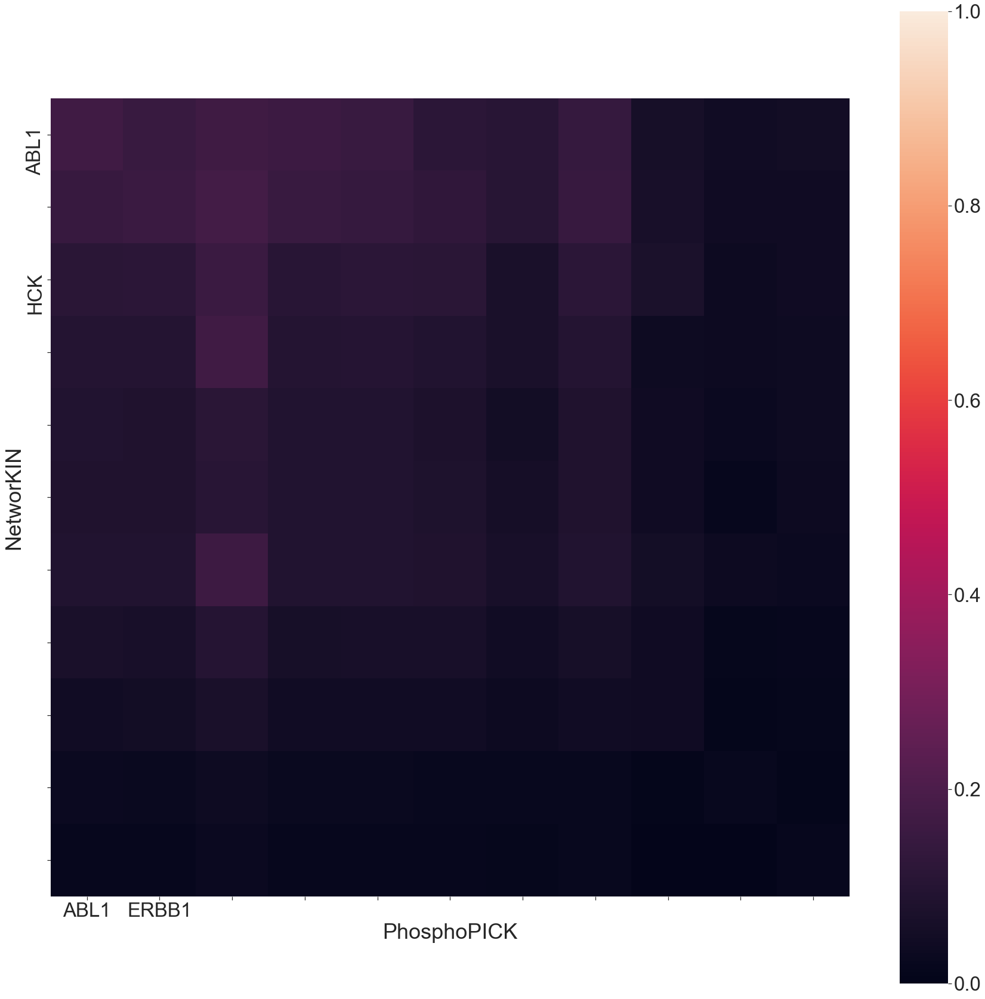

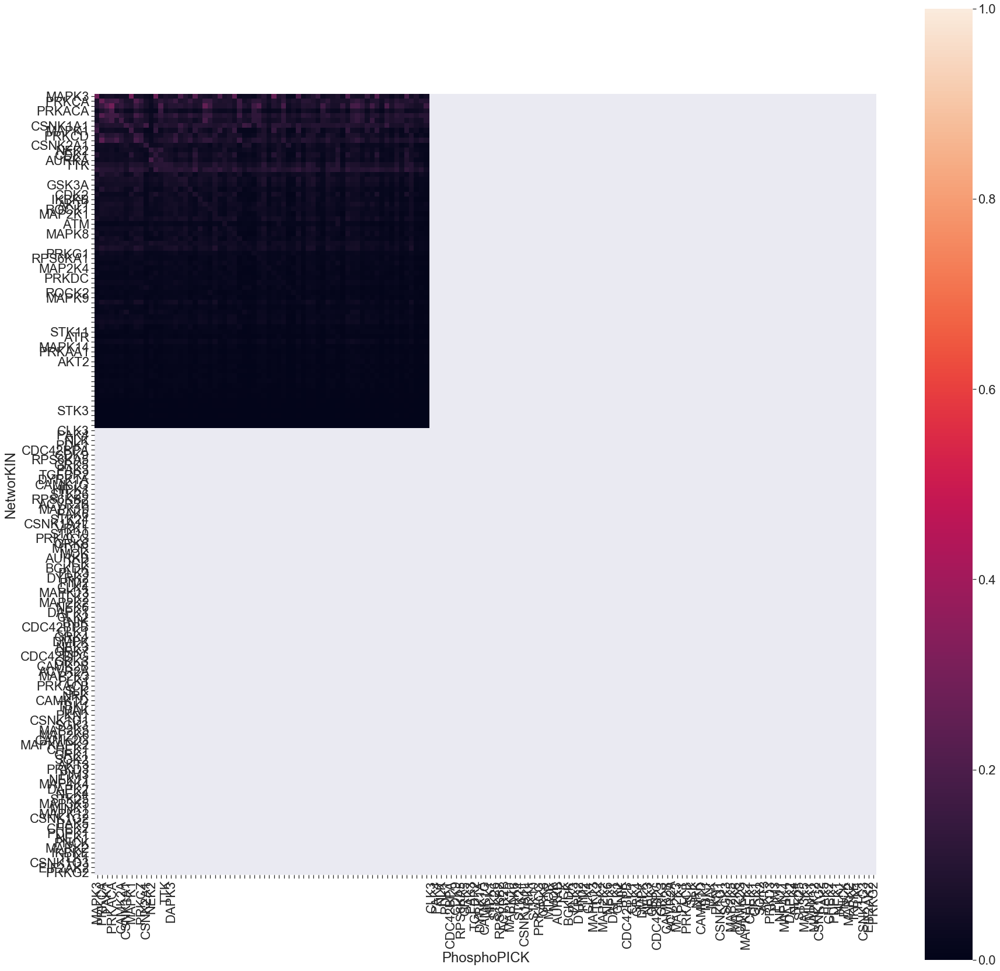

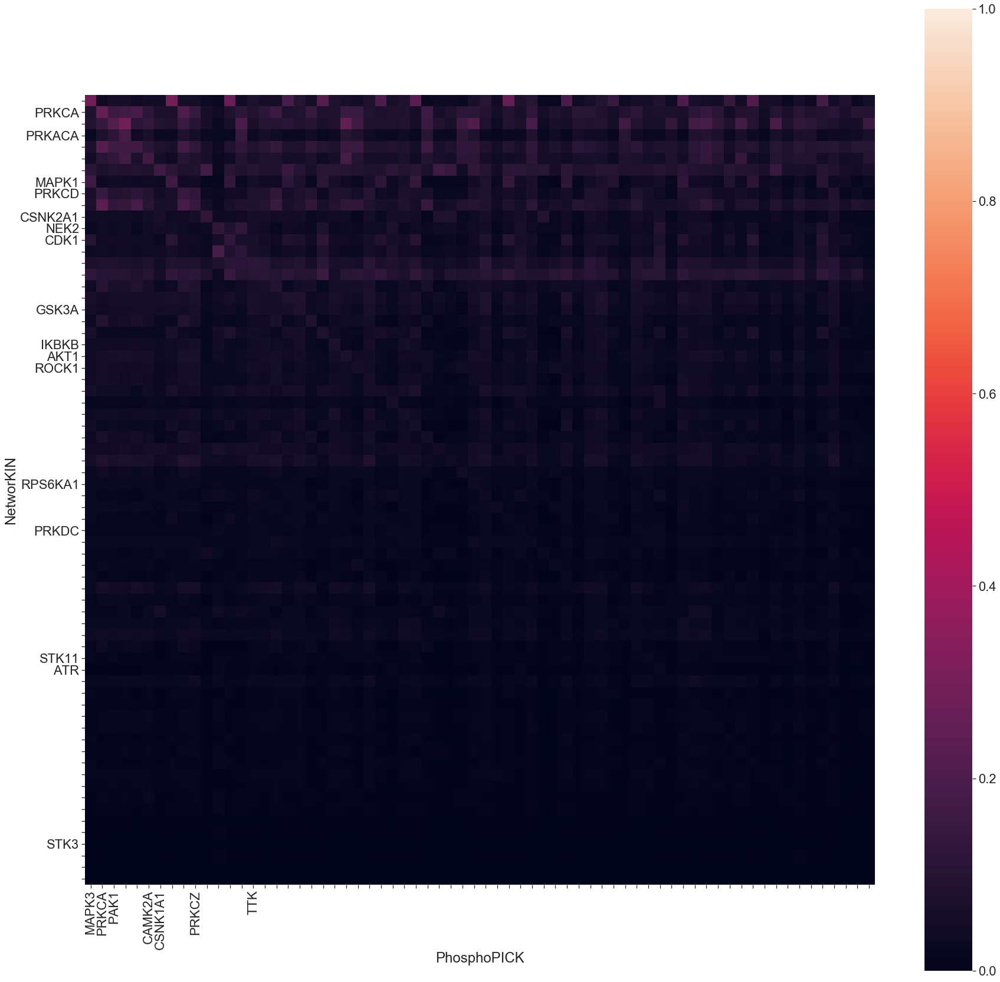

In [42]:
heatmap_y_mx = kinase_mutual_information.between_predictors(nw1_y, pp06_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_high_vs_PhosphoPICK_med_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_NetworKIN_high_vs_PhosphoPICK_med_Y_kinase','NetworKIN','PhosphoPICK', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(nw1_st, pp06_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_high_vs_PhosphoPICK_med_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_NetworKIN_high_vs_PhosphoPICK_med_ST_kinase', 'NetworKIN', 'PhosphoPICK', 'st')


11 overlapped kinases 
 NetworKIN :  50 kinases 
 PhosphoPICK :  19 kinases 



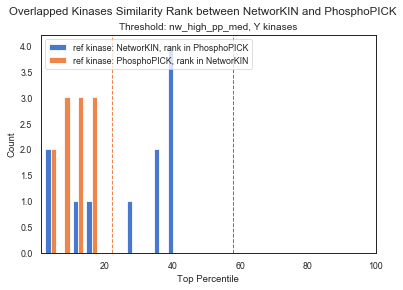

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


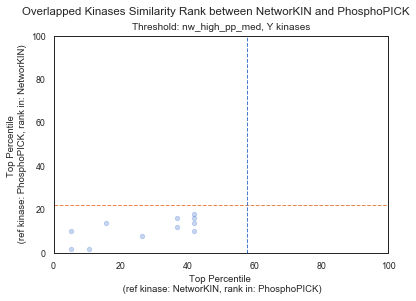

68 overlapped kinases 
 NetworKIN :  140 kinases 
 PhosphoPICK :  87 kinases 



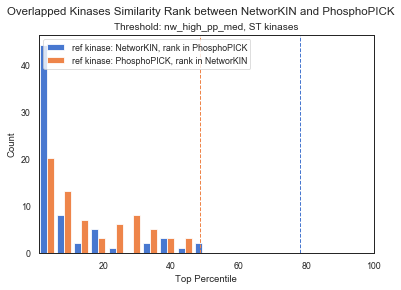

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


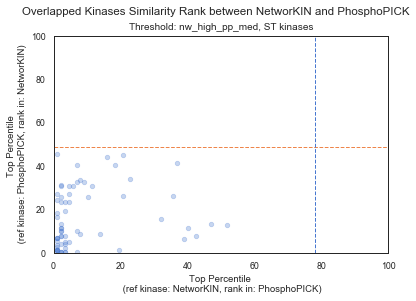

In [44]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_high_vs_PhosphoPICK_med_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, nw1_y, pp06_y , 'NetworKIN', 'PhosphoPICK' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_nw_high_pp_med.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'pp', 'nw_high_pp_med', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_high_vs_PhosphoPICK_med_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, nw1_st, pp06_st , 'NetworKIN', 'PhosphoPICK' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_nw_high_pp_med.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'pp', 'nw_high_pp_med', 'ST kinases', rank_dir + d_type + '_')


### NetworKIN(0.3) vs GPS(m)
- index: kinases in NetworKIN
- column: kinases in GPS

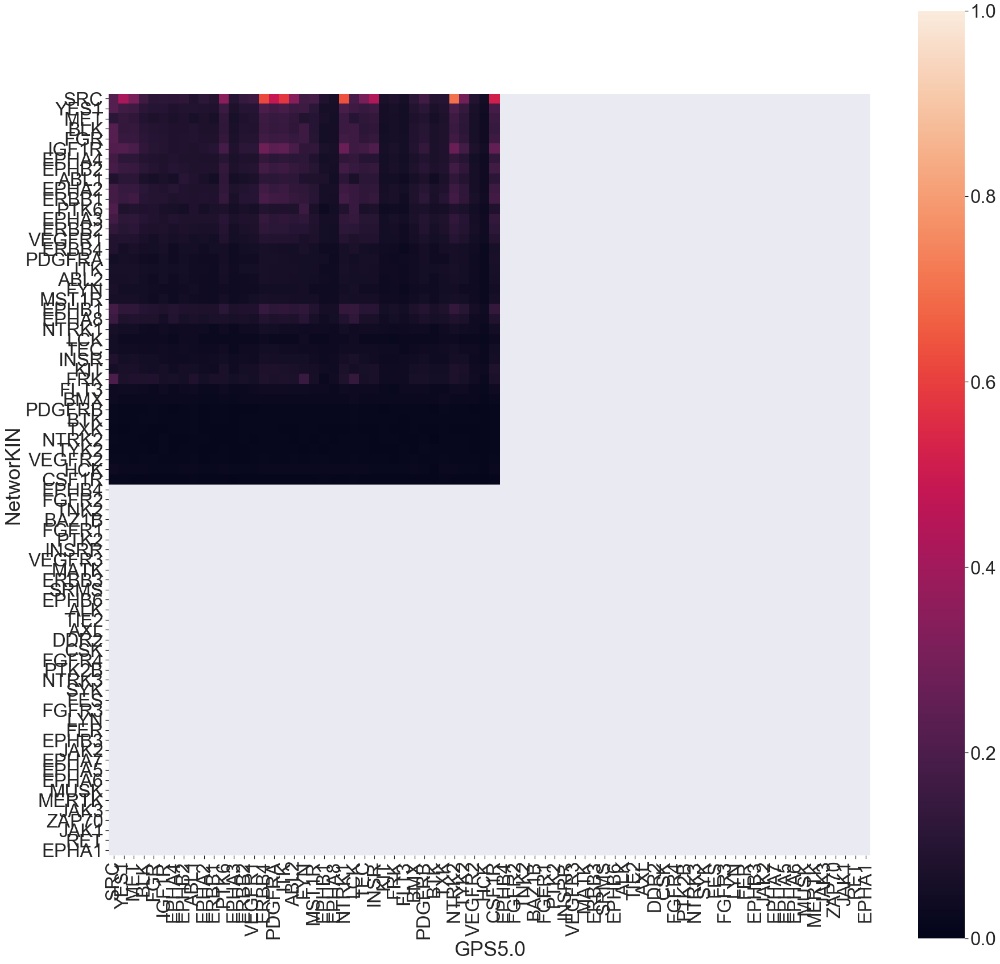

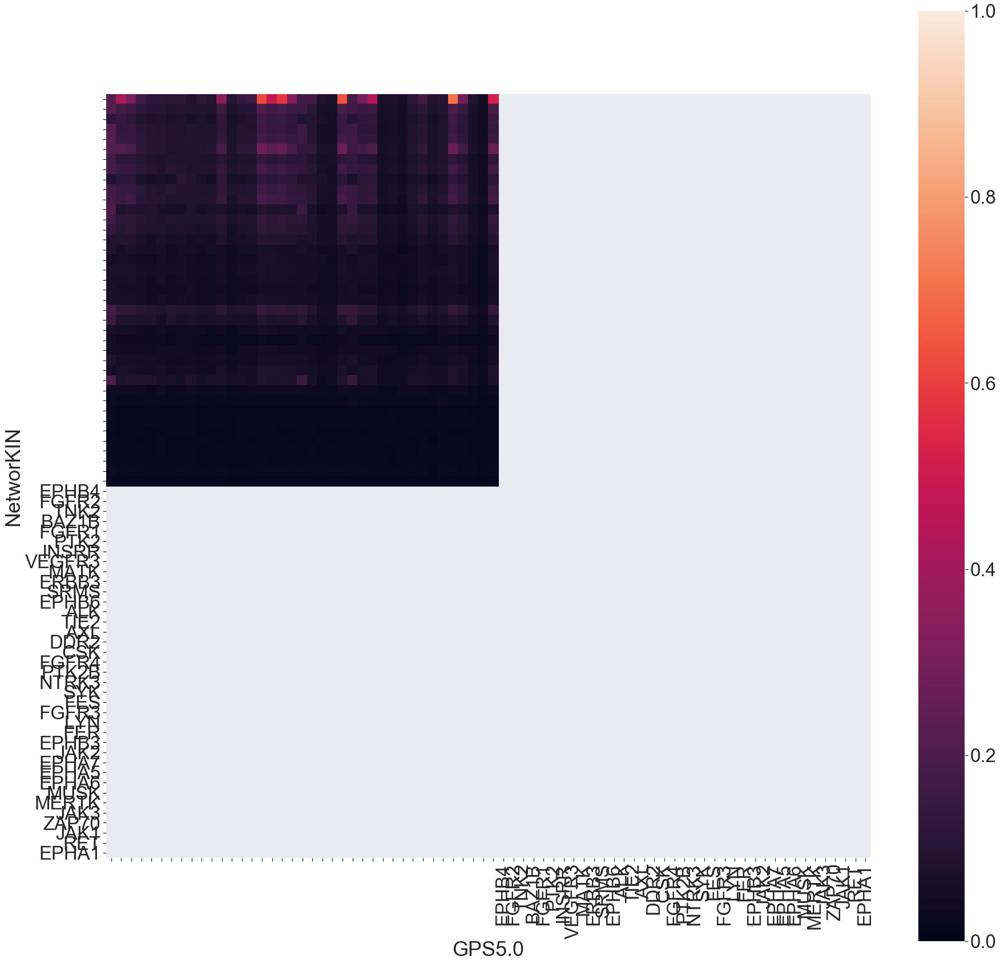

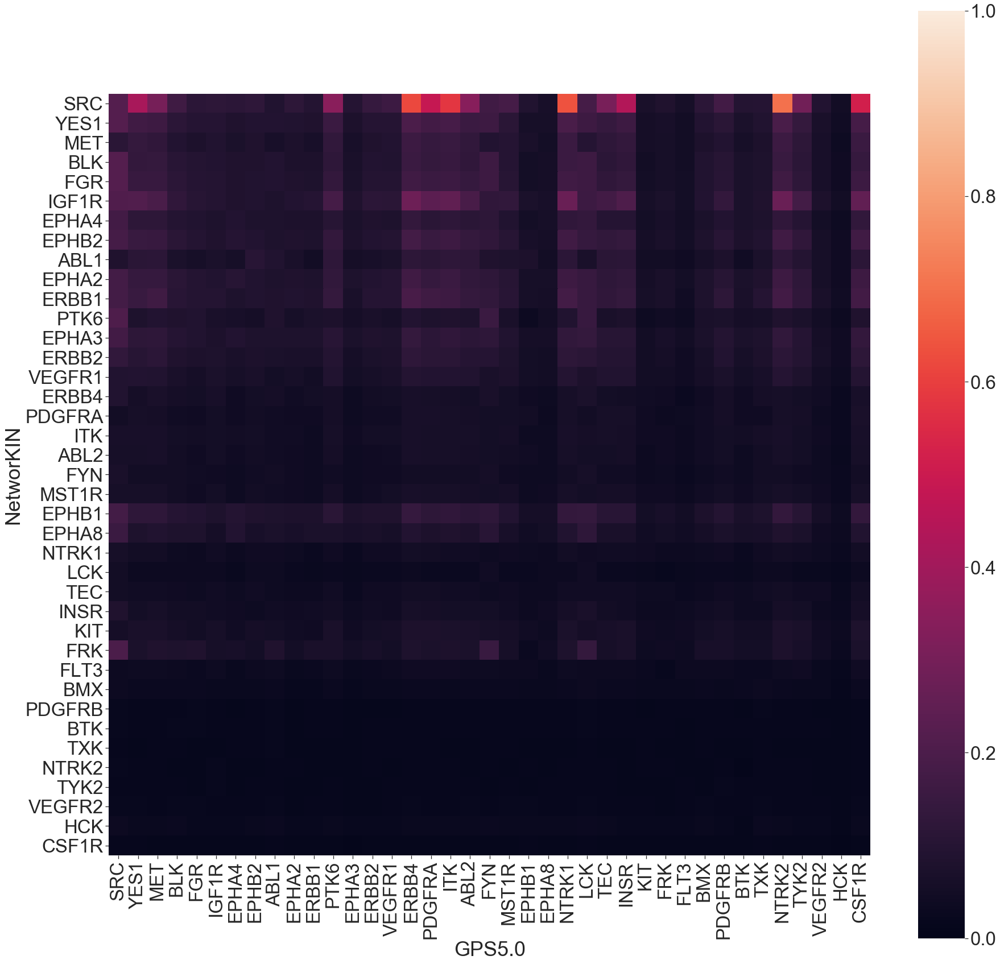

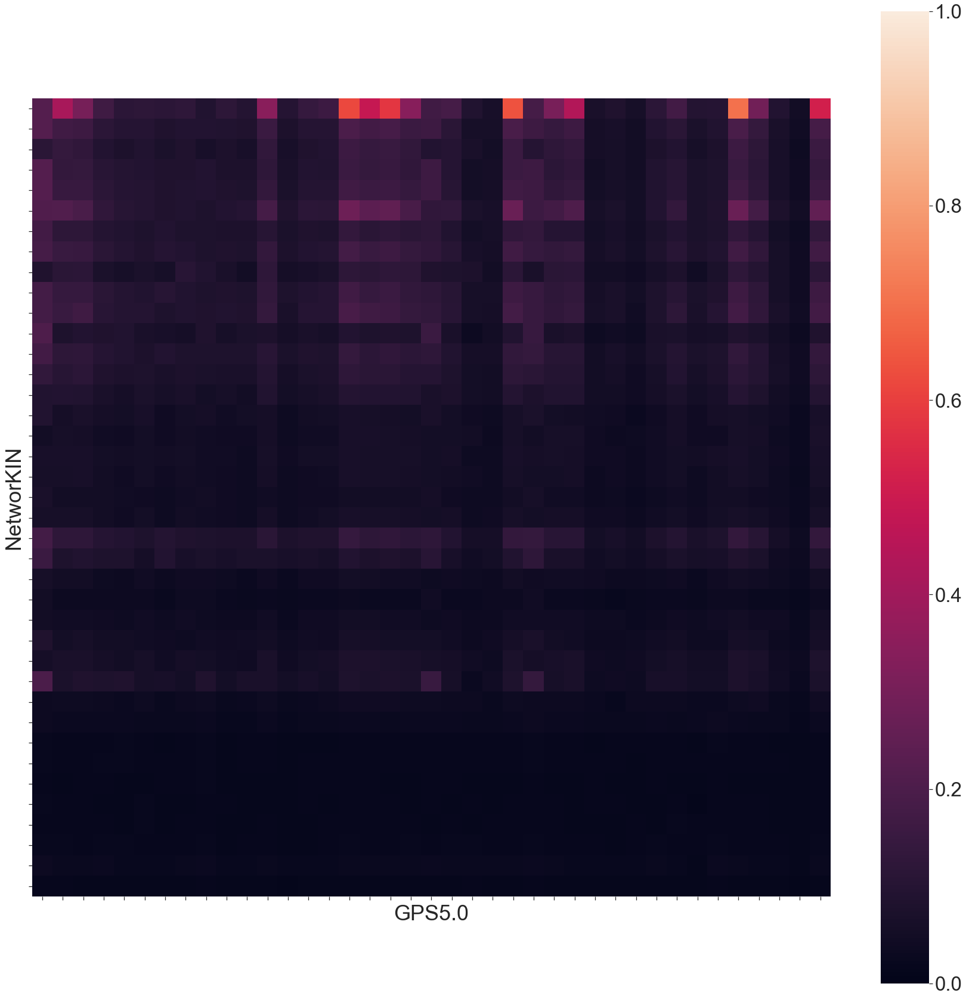

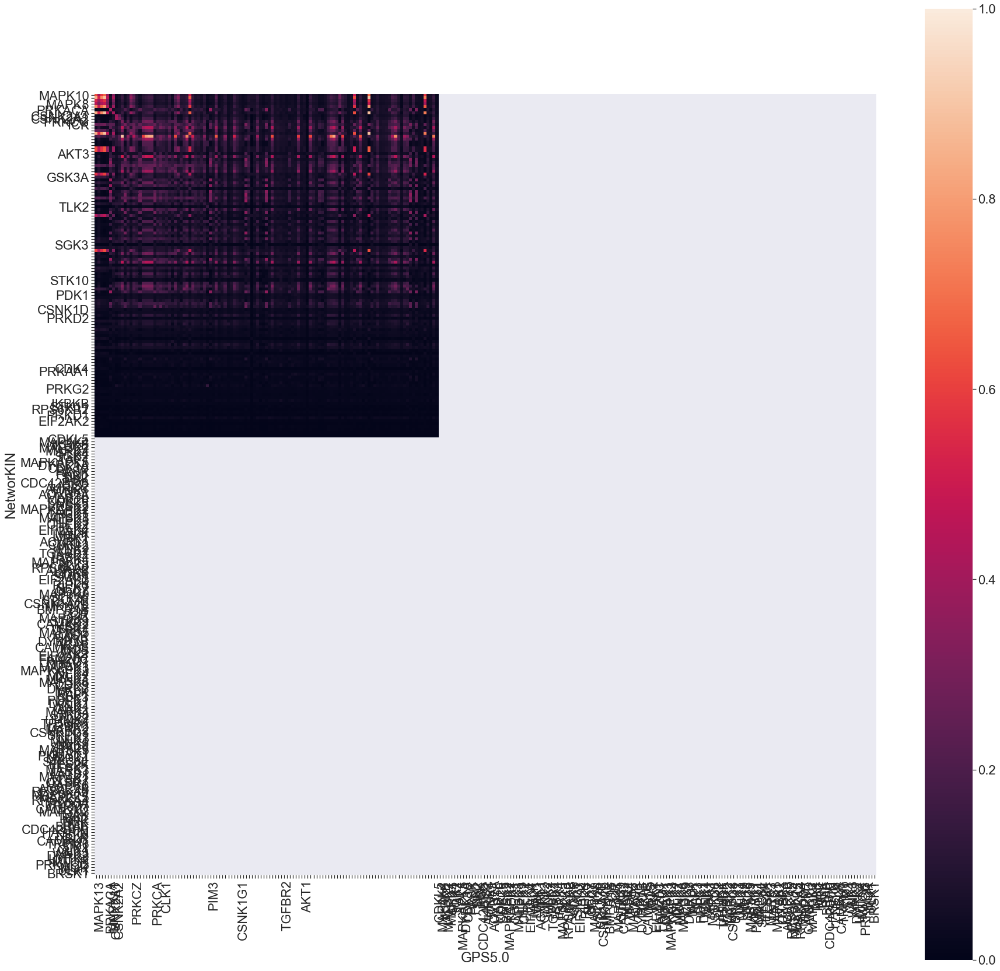

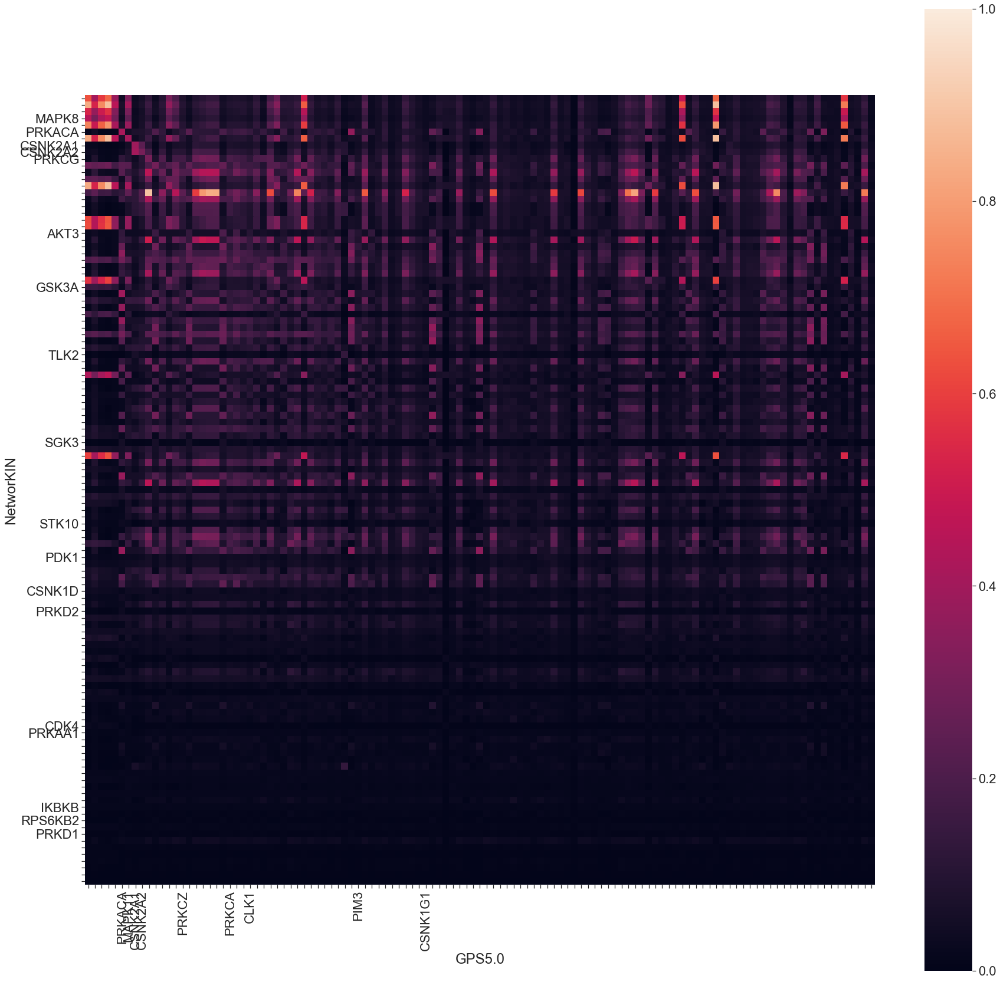

In [44]:
heatmap_y_mx = kinase_mutual_information.between_predictors(nw03_y, gpsm_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_low_vs_GPS5.0_med_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_NetworKIN_low_vs_GPS5.0_med_Y_kinase','NetworKIN','GPS5.0', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(nw03_st, gpsm_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_low_vs_GPS5.0_med_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_NetworKIN_low_vs_GPS5.0_med_ST_kinase', 'NetworKIN', 'GPS5.0', 'st')


39 overlapped kinases 
 NetworKIN :  50 kinases 
 GPS :  65 kinases 



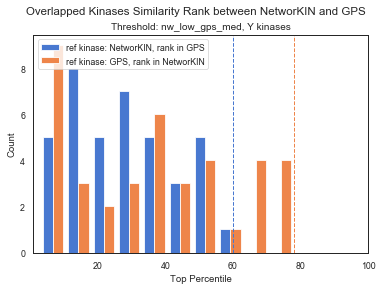

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


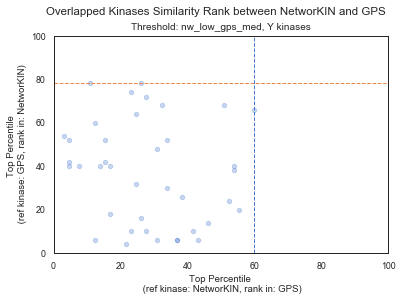

117 overlapped kinases 
 NetworKIN :  140 kinases 
 GPS :  243 kinases 



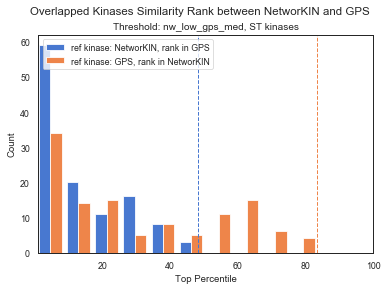

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


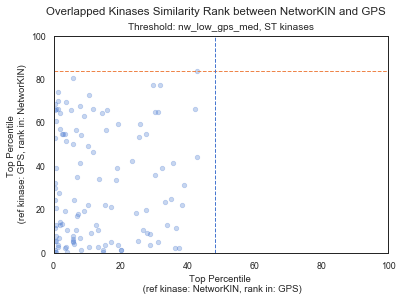

In [43]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_low_vs_GPS5.0_med_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, nw03_y, gpsm_y , 'NetworKIN', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_nw_low_gps_med.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'gps', 'nw_low_gps_med', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_low_vs_GPS5.0_med_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, nw03_st, gpsm_st , 'NetworKIN', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_nw_low_gps_med.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'gps', 'nw_low_gps_med', 'ST kinases', rank_dir + d_type + '_')


### NetworKIN(0.3) vs GPS(h)
- index: kinases in NetworKIN
- column: kinases in GPS

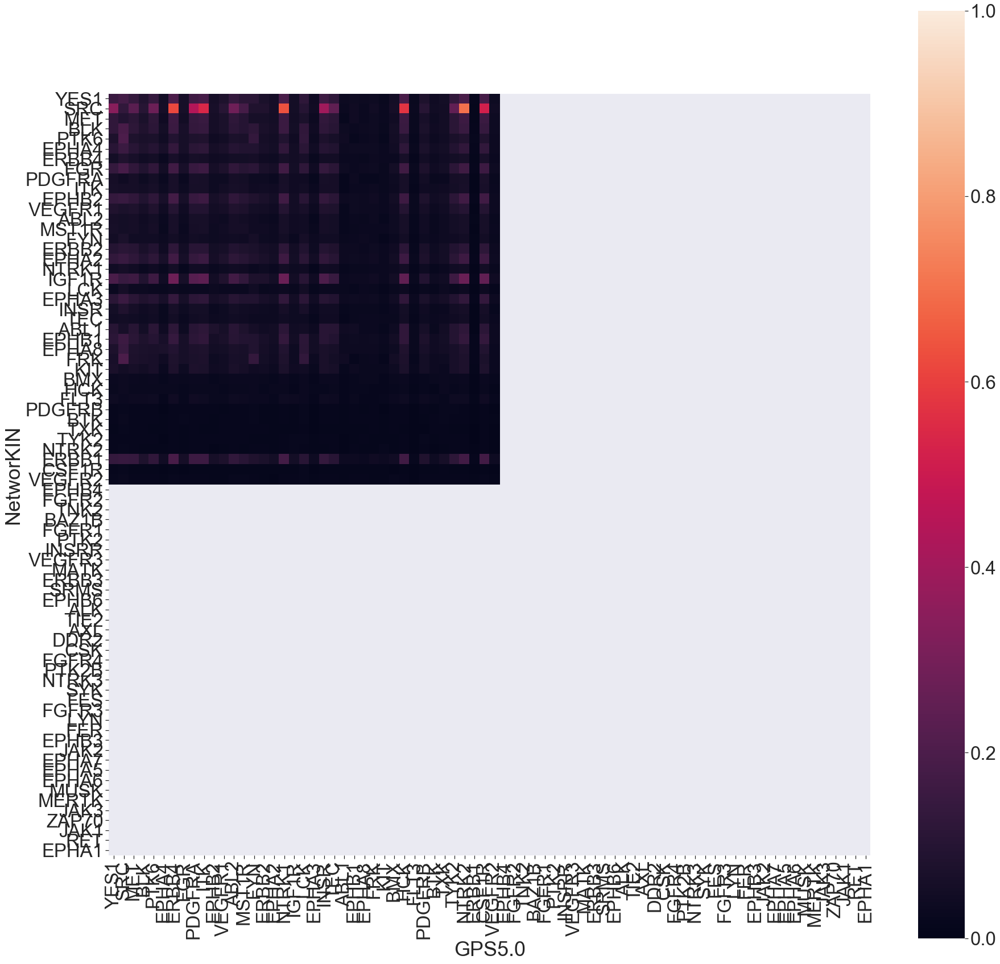

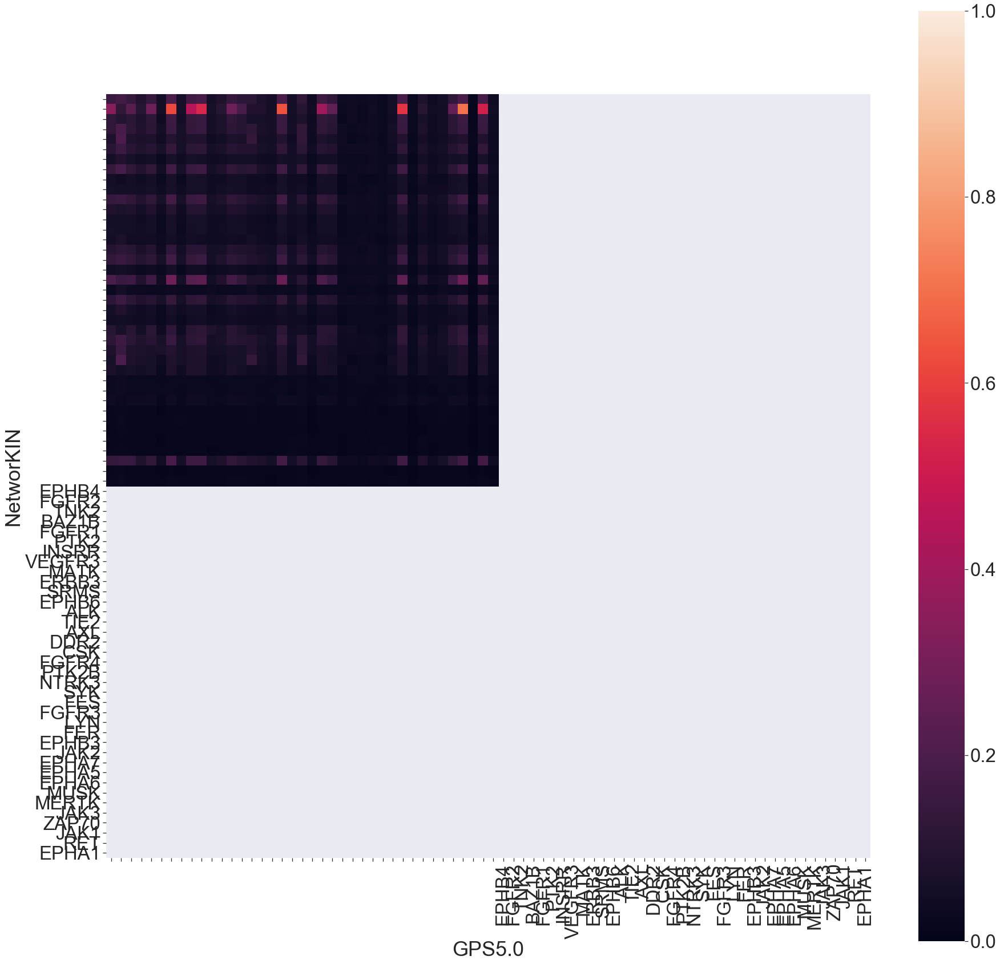

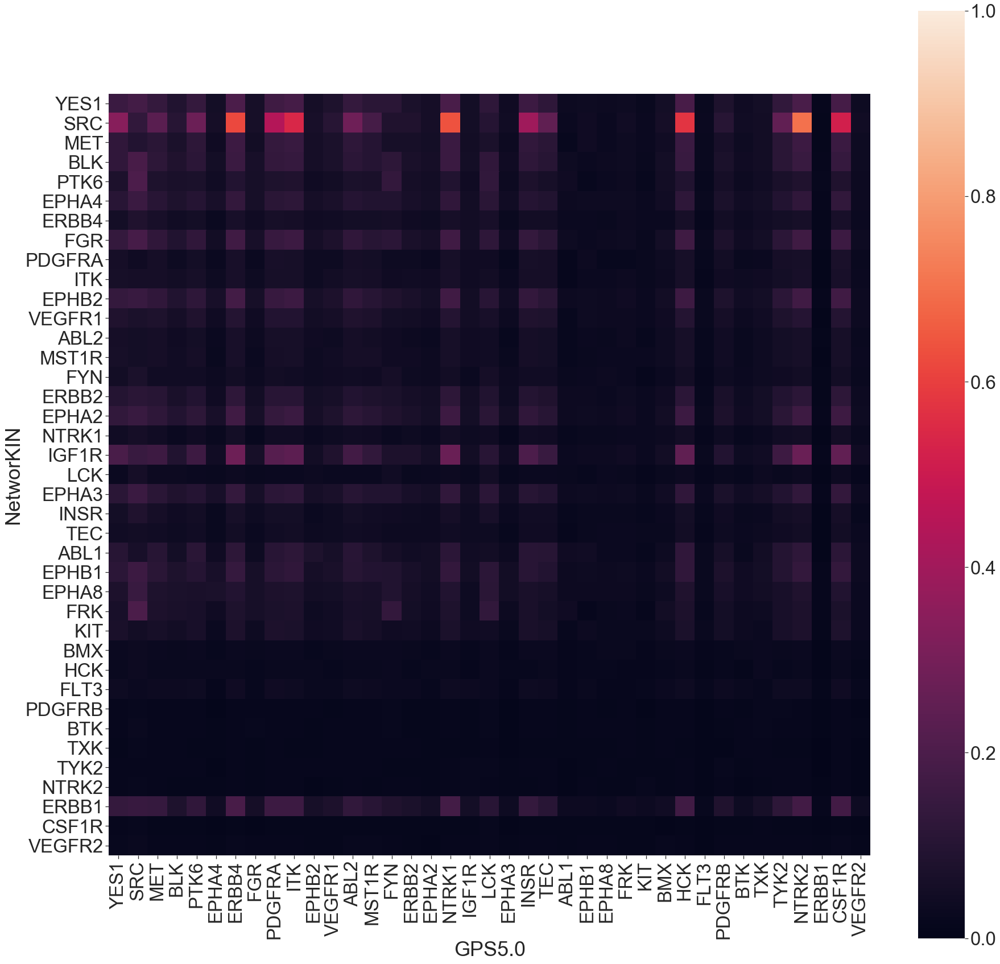

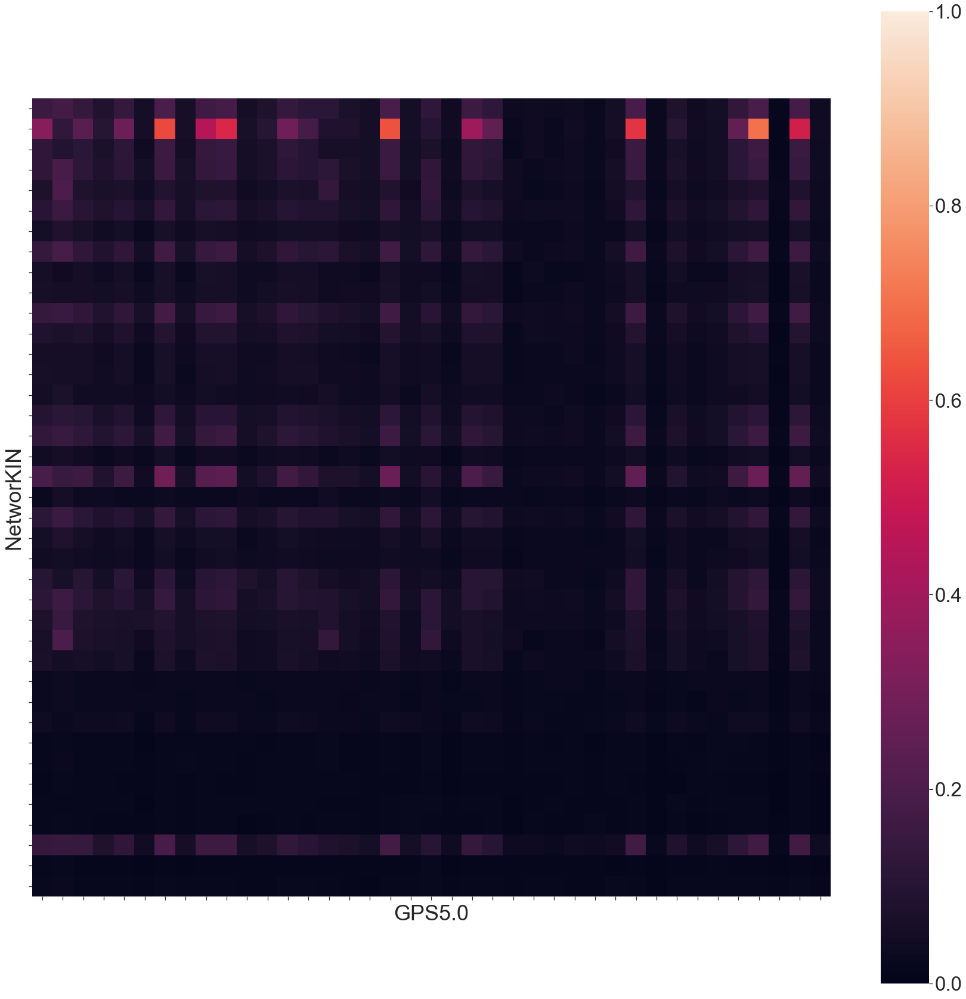

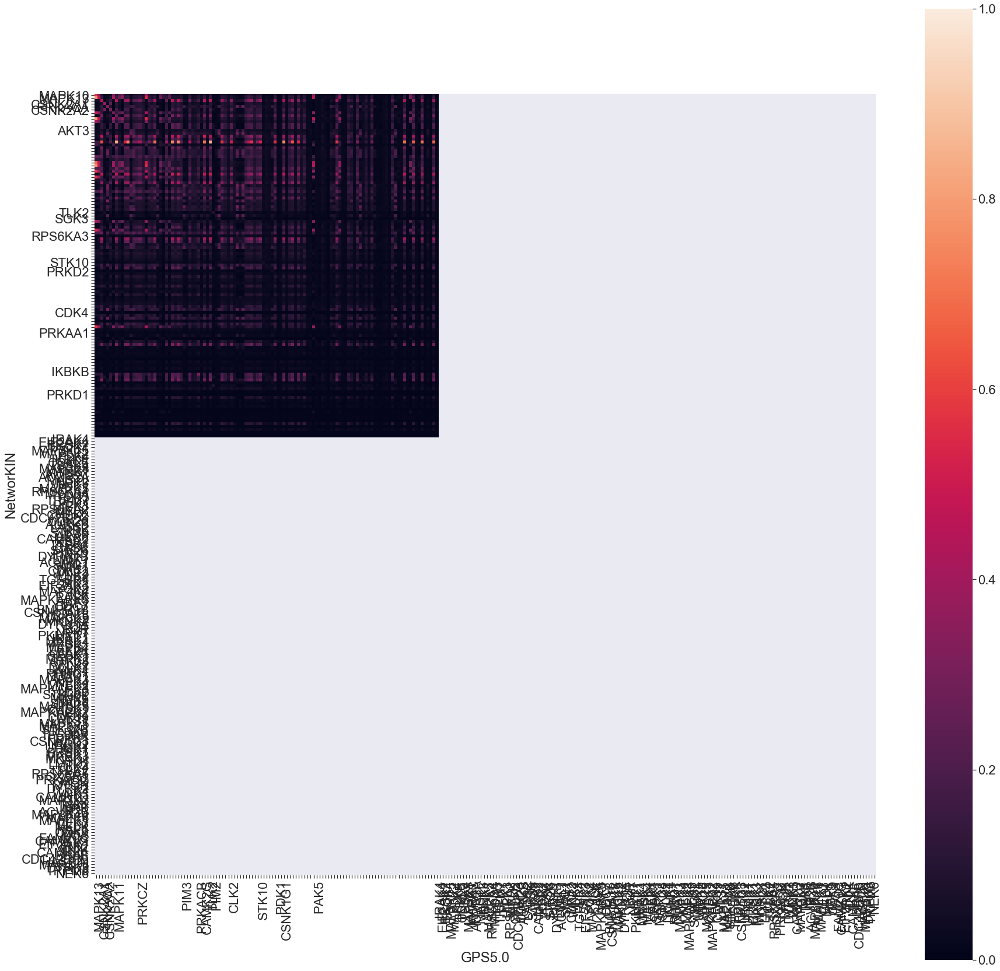

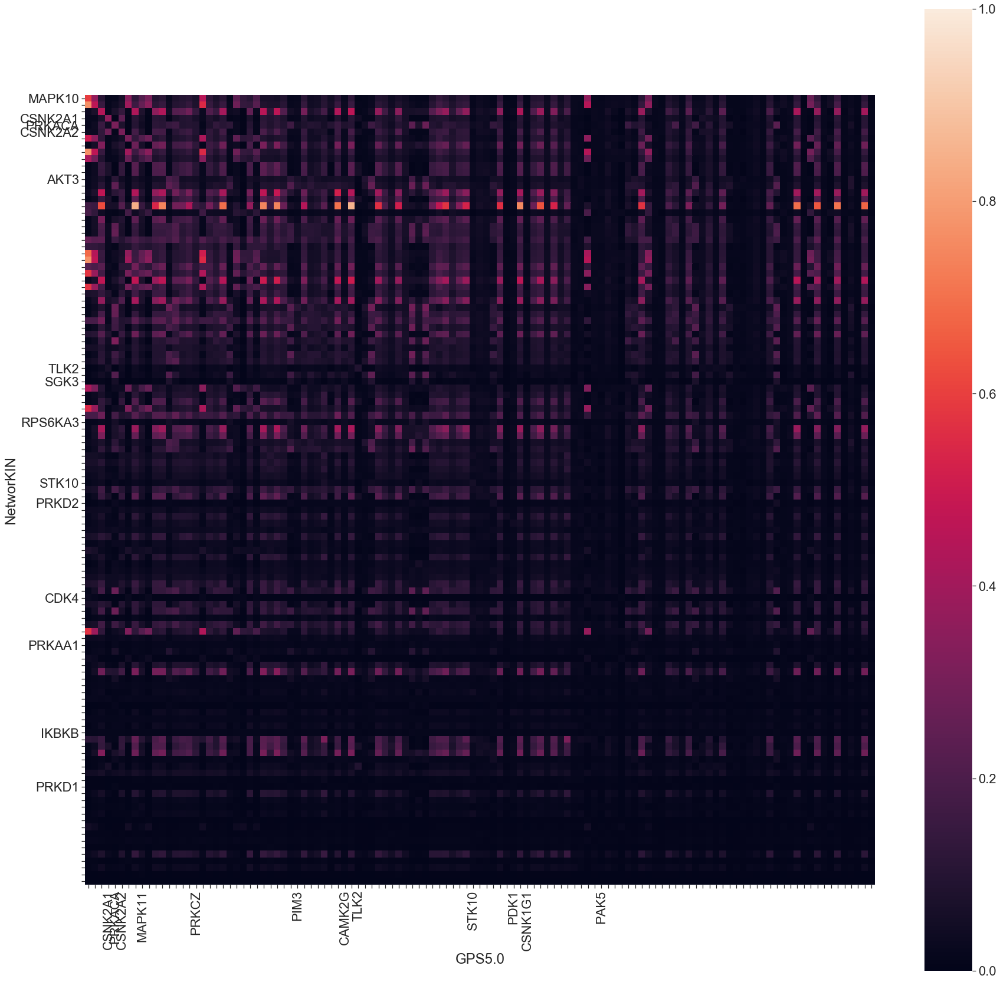

In [46]:
heatmap_y_mx = kinase_mutual_information.between_predictors(nw03_y, gpsh_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_low_vs_GPS5.0_high_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_NetworKIN_low_vs_GPS5.0_high_Y_kinase','NetworKIN','GPS5.0', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(nw03_st, gpsh_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_low_vs_GPS5.0_high_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_NetworKIN_low_vs_GPS5.0_high_ST_kinase', 'NetworKIN', 'GPS5.0', 'st')


39 overlapped kinases 
 NetworKIN :  50 kinases 
 GPS :  65 kinases 



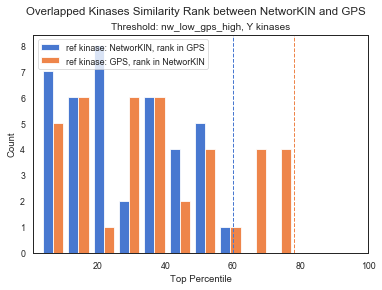

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


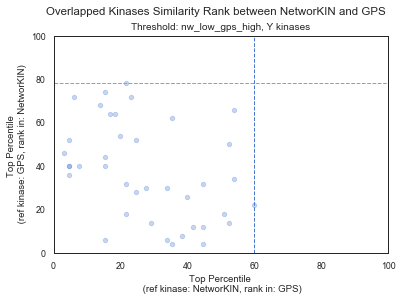

117 overlapped kinases 
 NetworKIN :  140 kinases 
 GPS :  243 kinases 



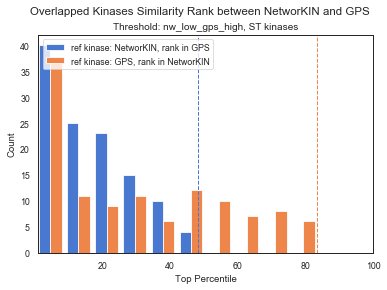

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


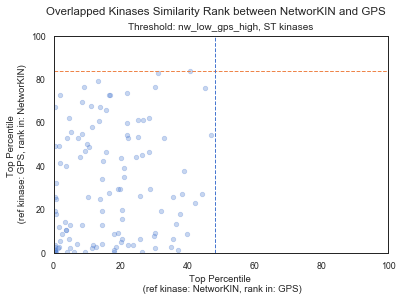

In [22]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_low_vs_GPS5.0_high_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, nw03_y, gpsh_y , 'NetworKIN', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_nw_low_gps_high.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'gps', 'nw_low_gps_high', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_low_vs_GPS5.0_high_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, nw03_st, gpsh_st , 'NetworKIN', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_nw_low_gps_high.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'gps', 'nw_low_gps_high', 'ST kinases', rank_dir + d_type + '_')


### NetworKIN(0.5) vs GPS(h)
- index: kinases in NetworKIN
- column: kinases in GPS

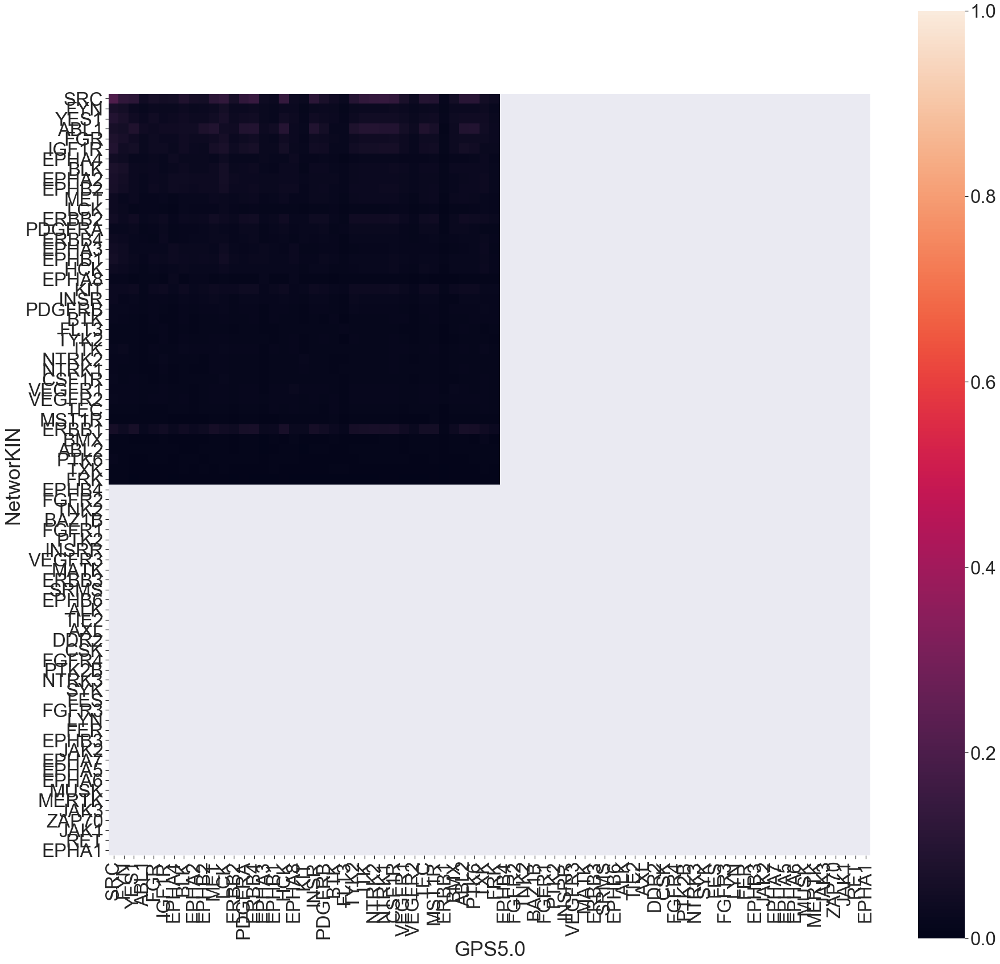

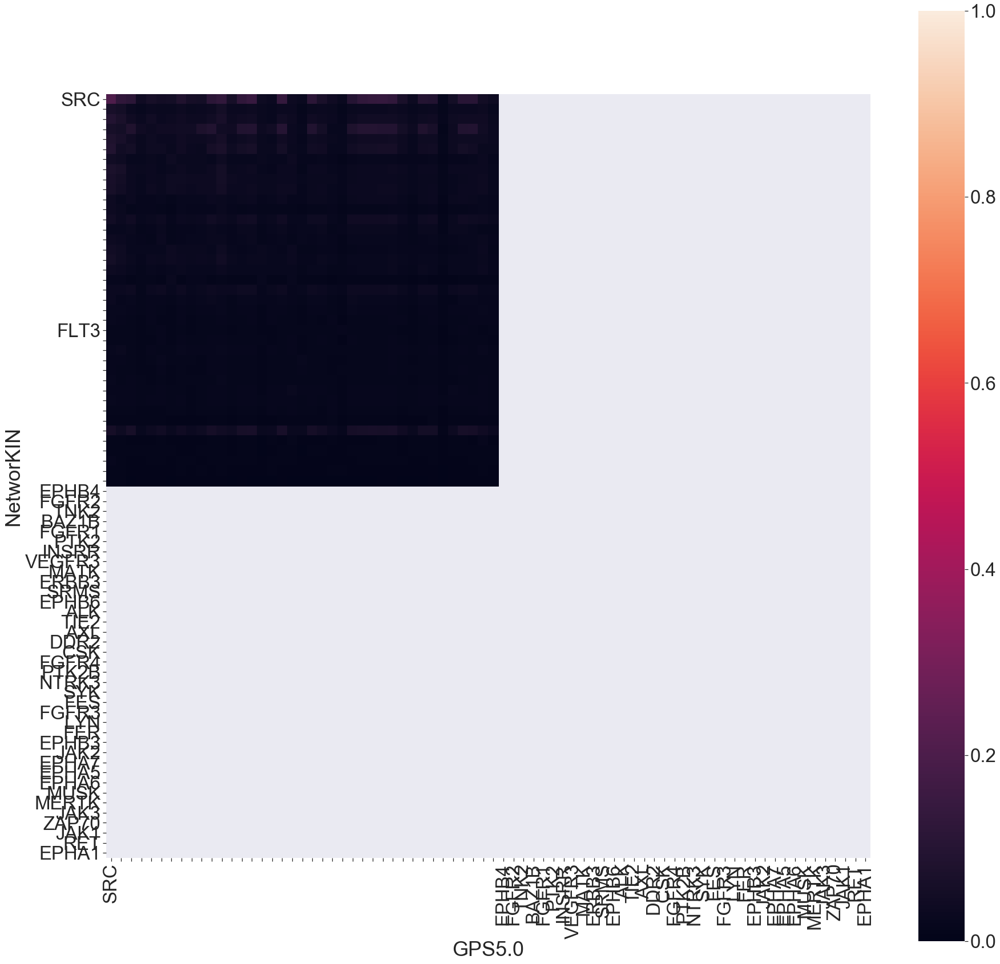

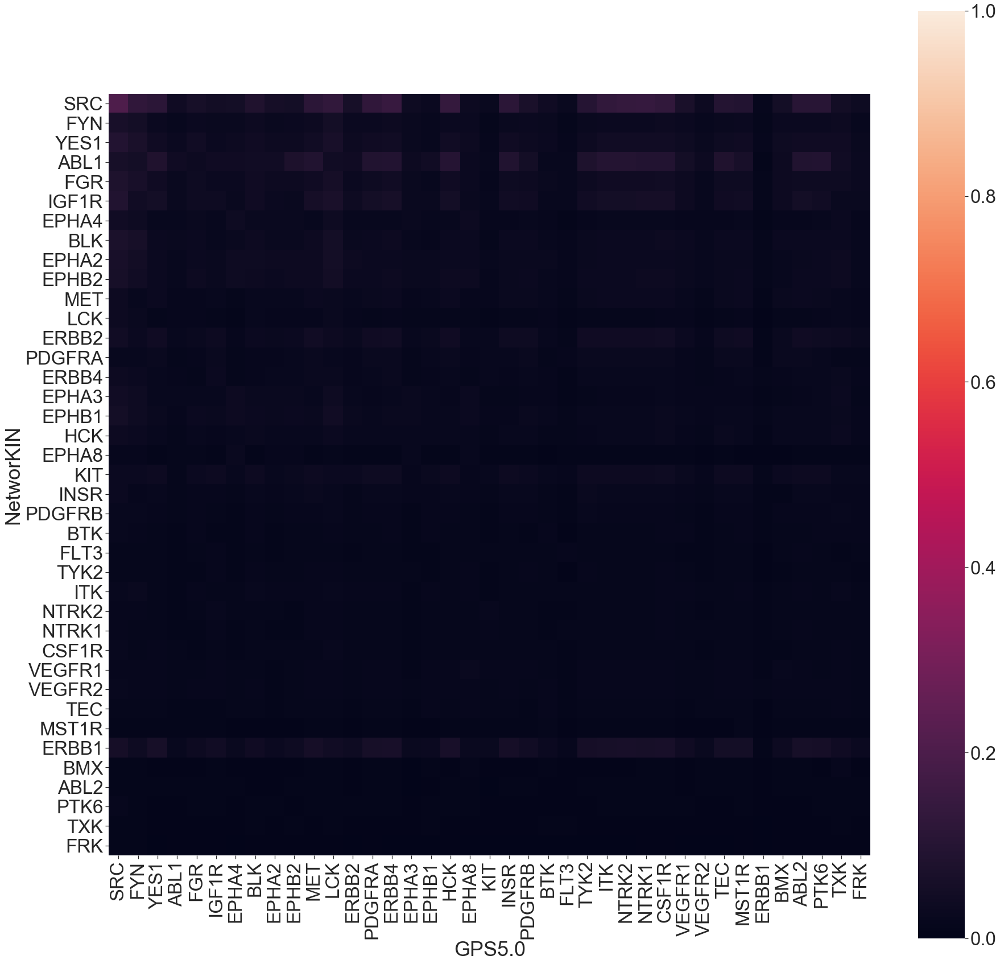

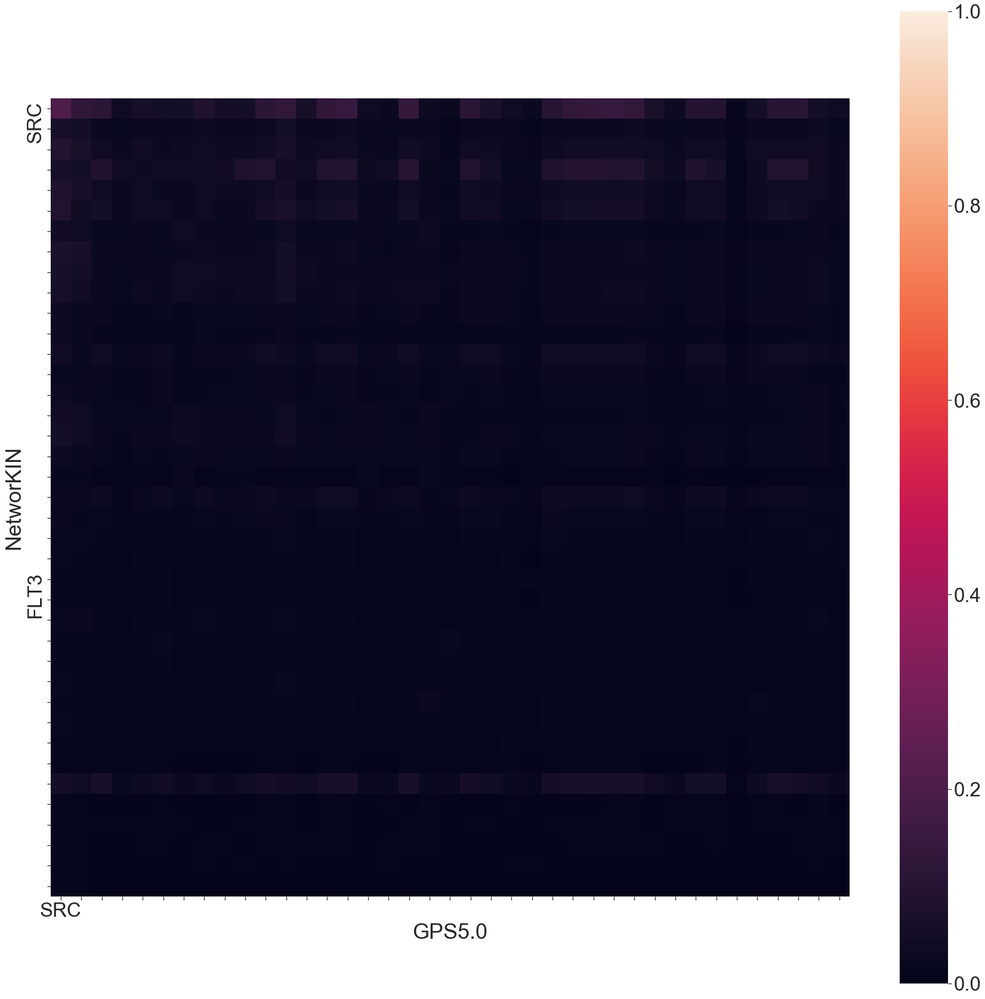

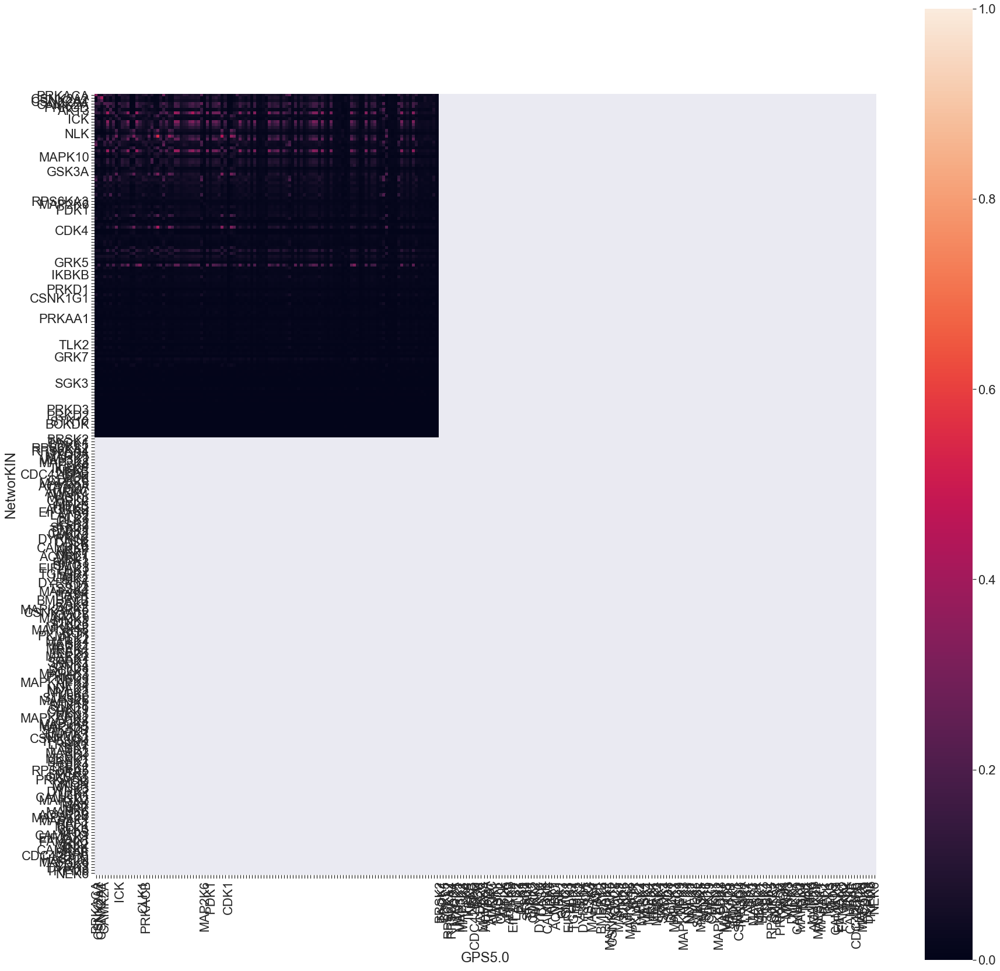

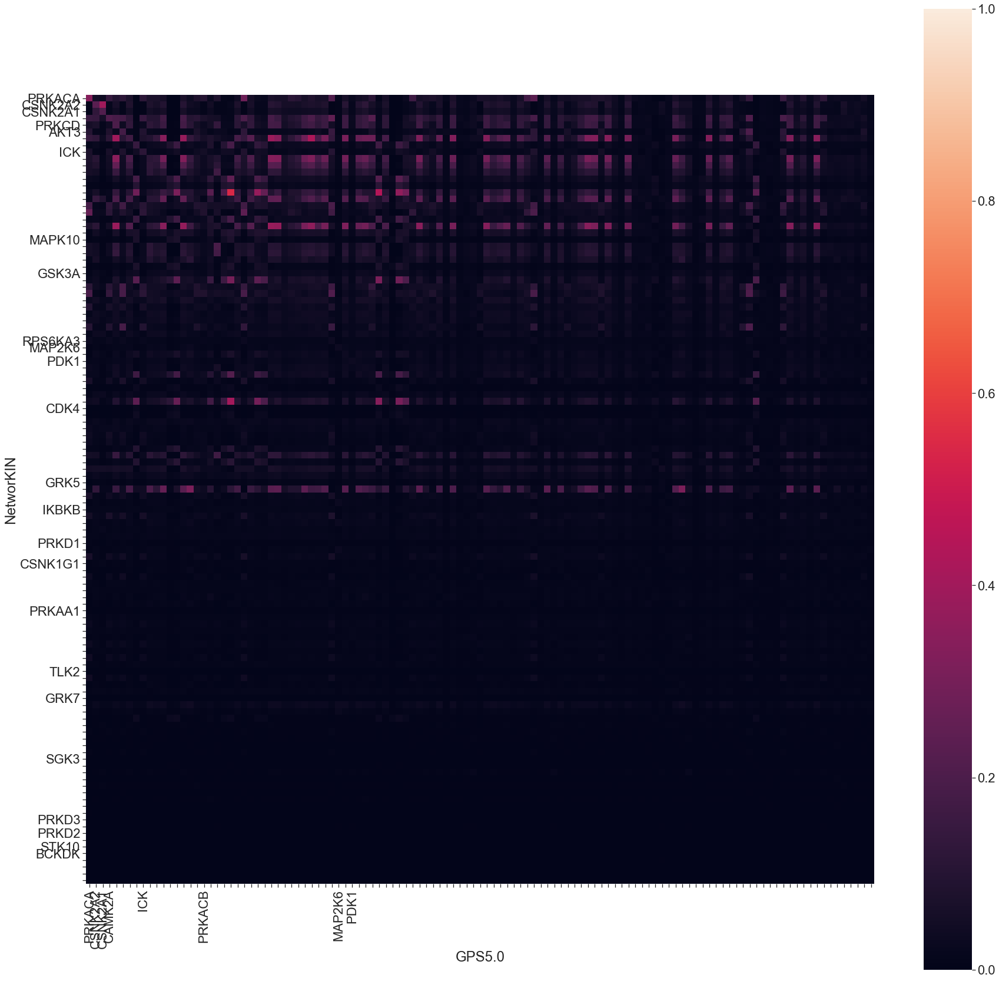

In [48]:
heatmap_y_mx = kinase_mutual_information.between_predictors(nw05_y, gpsh_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_med_vs_GPS5.0_high_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_NetworKIN_med_vs_GPS5.0_high_Y_kinase','NetworKIN','GPS5.0', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(nw05_st, gpsh_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_med_vs_GPS5.0_high_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_NetworKIN_med_vs_GPS5.0_high_ST_kinase', 'NetworKIN', 'GPS5.0', 'st')


39 overlapped kinases 
 NetworKIN :  50 kinases 
 GPS :  65 kinases 



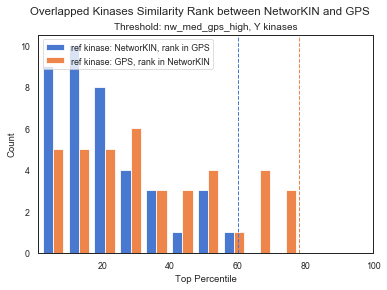

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


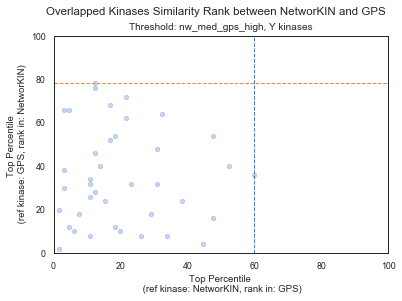

117 overlapped kinases 
 NetworKIN :  140 kinases 
 GPS :  243 kinases 



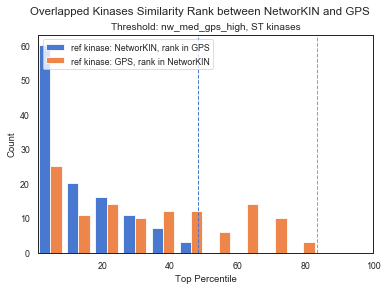

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


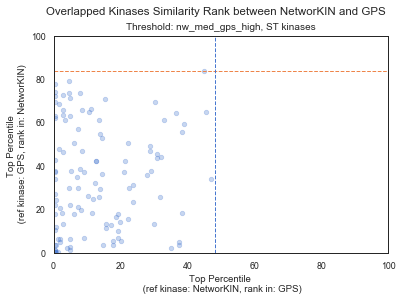

In [42]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_med_vs_GPS5.0_high_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, nw05_y, gpsh_y , 'NetworKIN', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_nw_med_gps_high.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'gps', 'nw_med_gps_high', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_med_vs_GPS5.0_high_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, nw05_st, gpsh_st , 'NetworKIN', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_nw_med_gps_high.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'gps', 'nw_med_gps_high', 'ST kinases', rank_dir + d_type + '_')


### NetworKIN(0.5) vs GPS(l)
- index: kinases in NetworKIN
- column: kinases in GPS

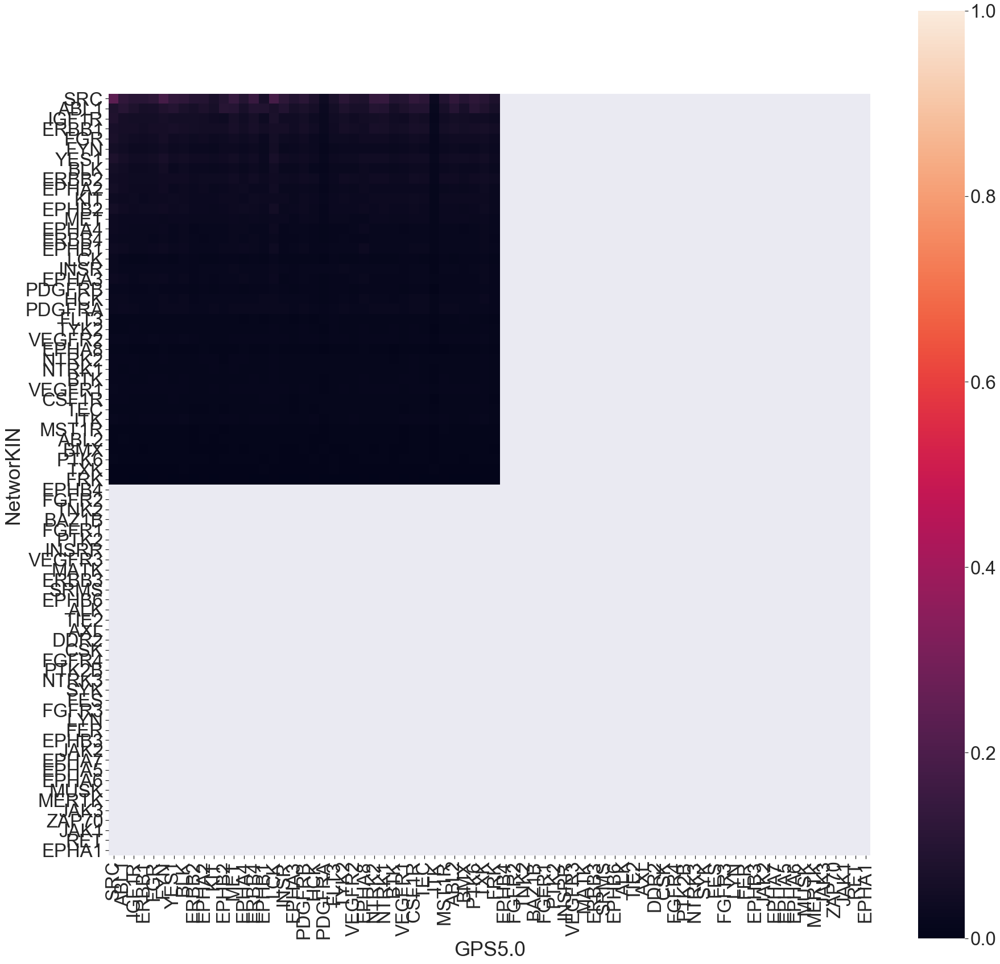

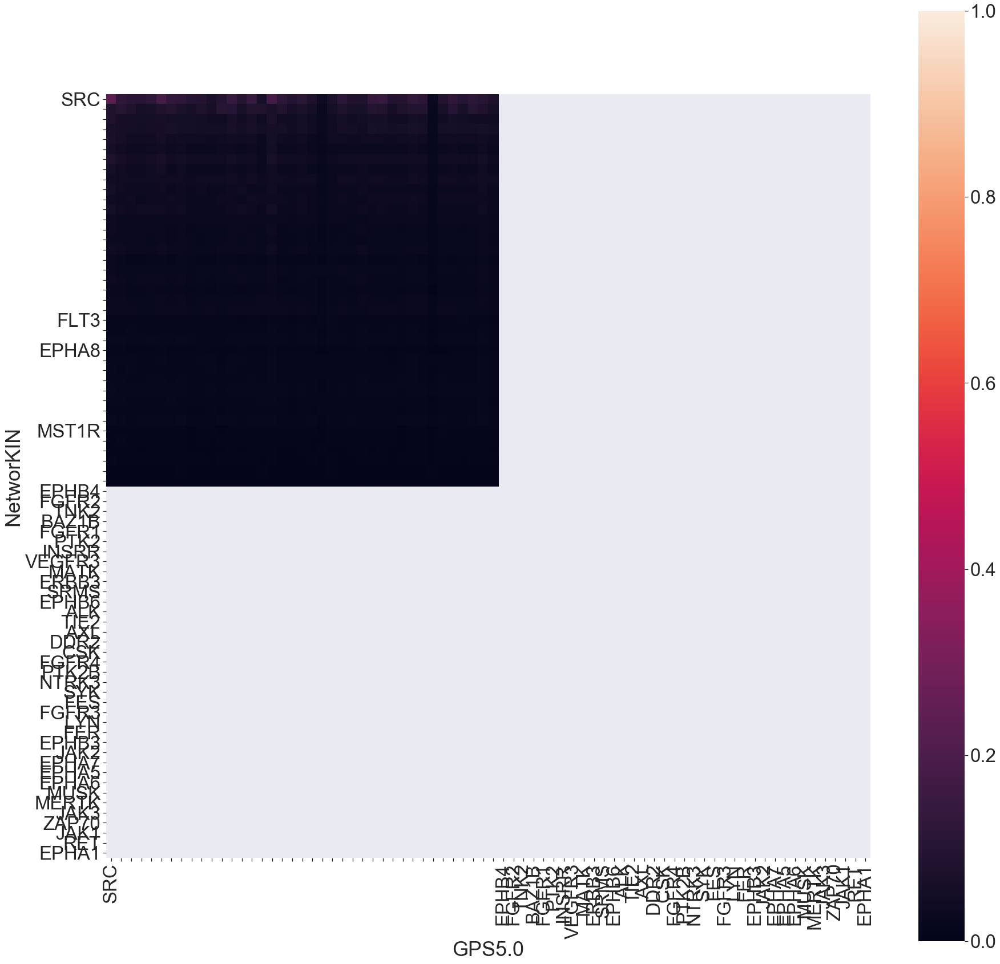

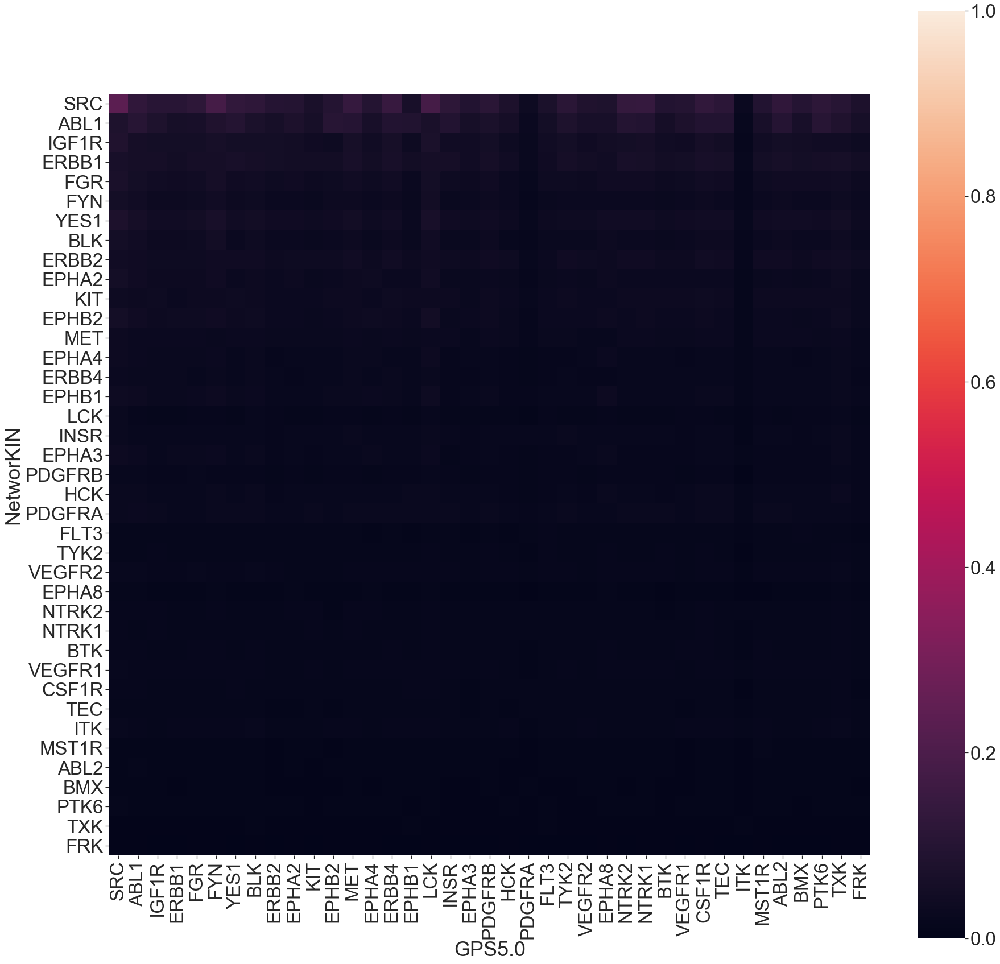

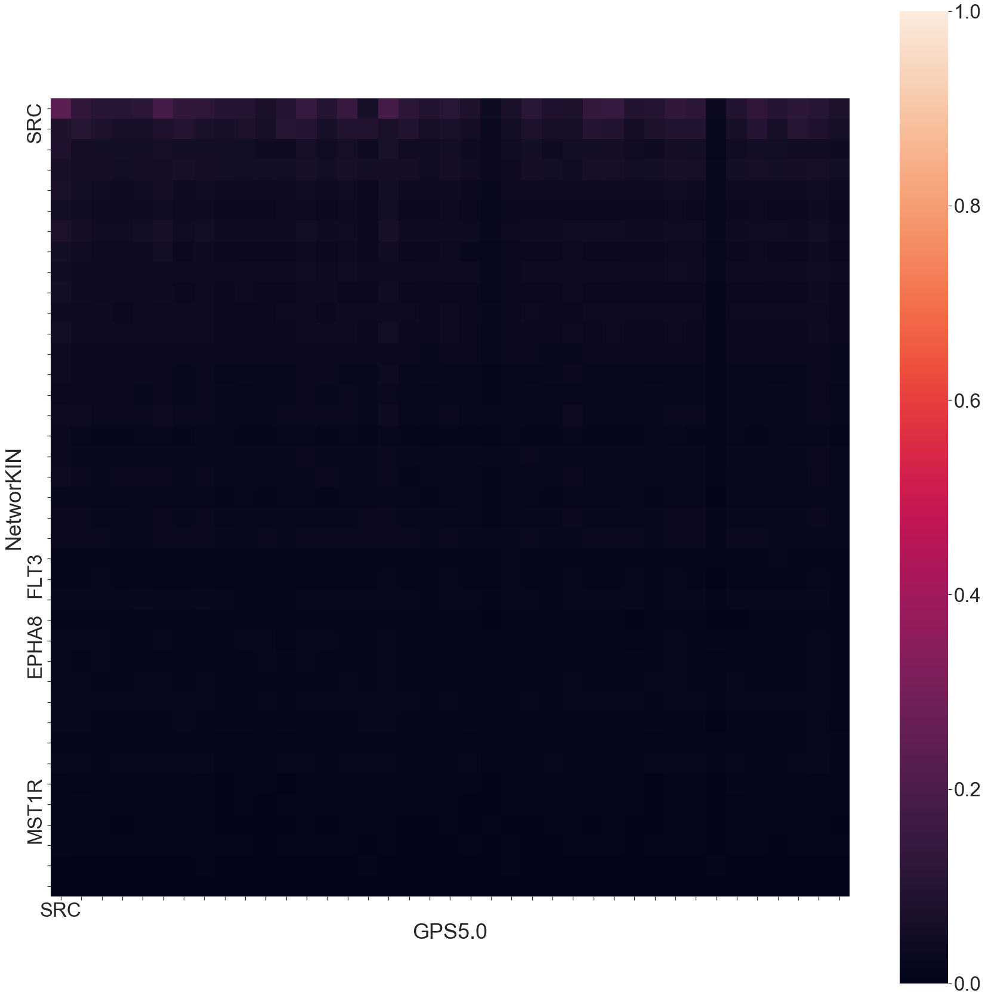

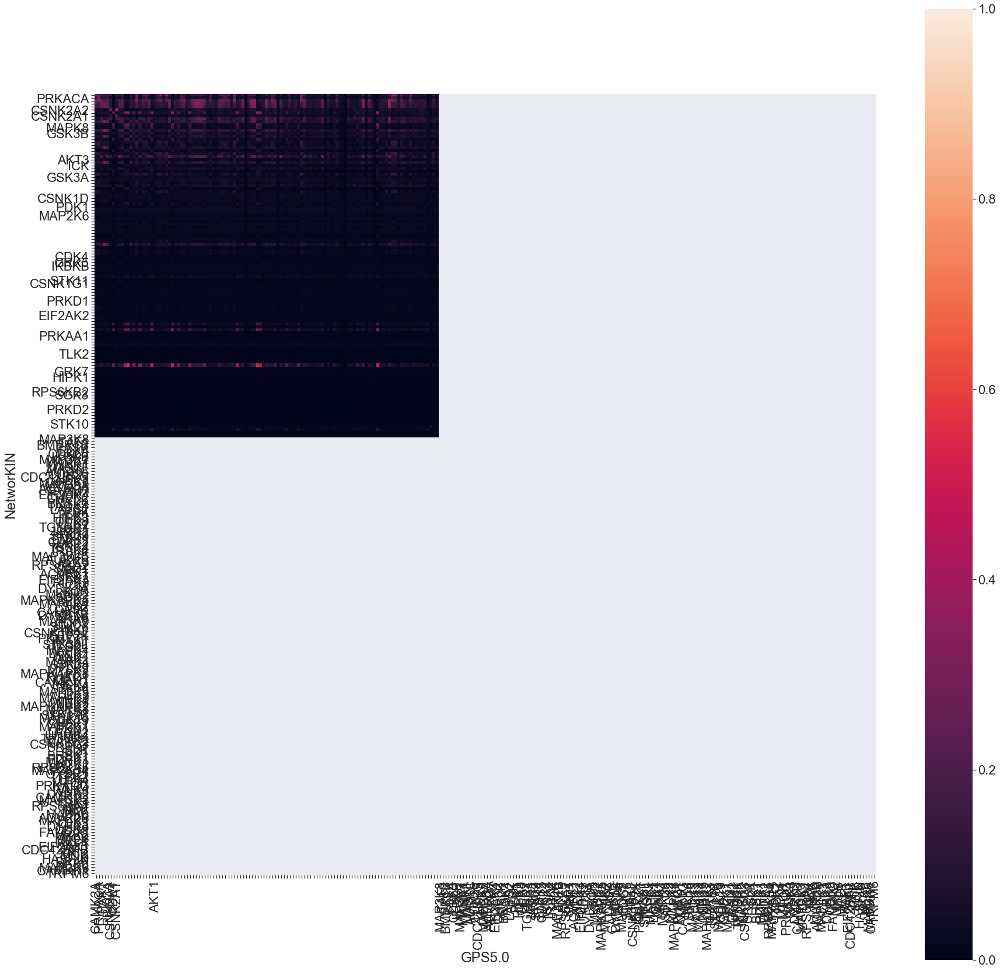

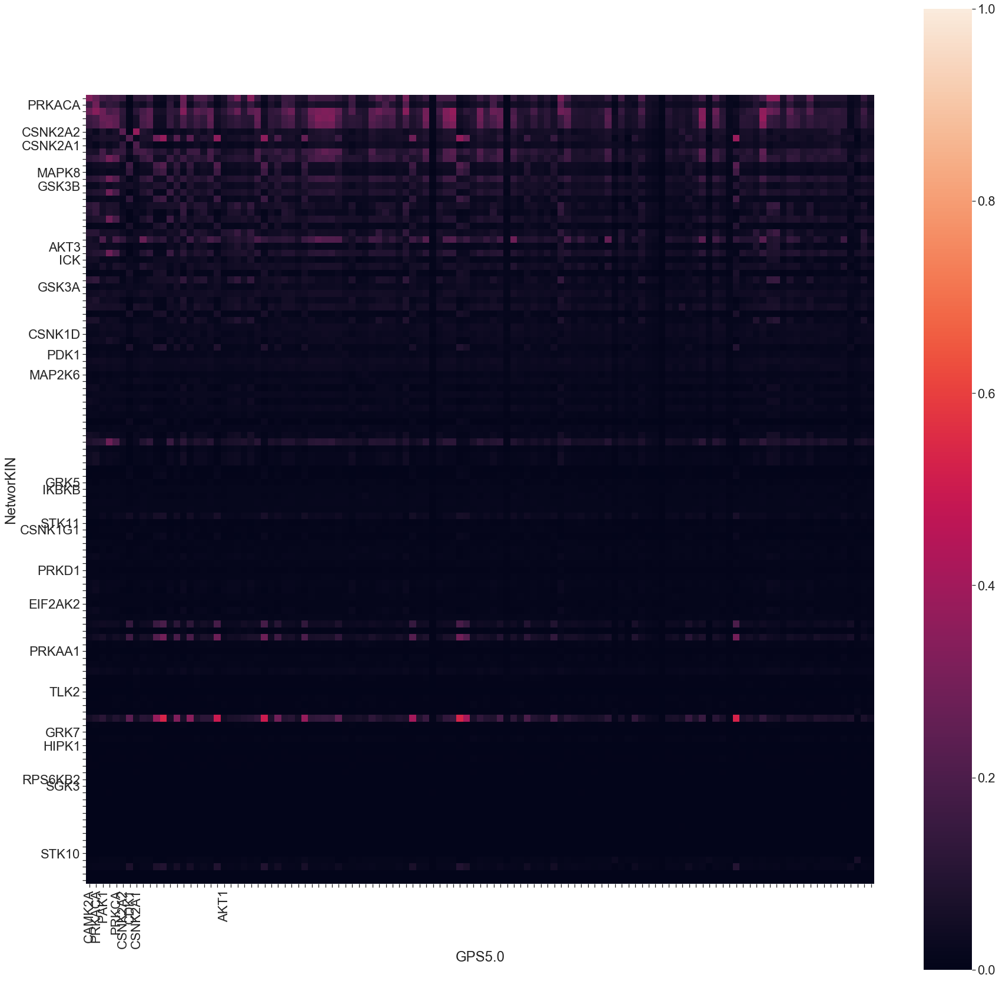

In [50]:
heatmap_y_mx = kinase_mutual_information.between_predictors(nw05_y, gpsl_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_med_vs_GPS5.0_low_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_NetworKIN_med_vs_GPS5.0_low_Y_kinase','NetworKIN','GPS5.0', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(nw05_st, gpsl_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_med_vs_GPS5.0_low_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_NetworKIN_med_vs_GPS5.0_low_ST_kinase', 'NetworKIN', 'GPS5.0', 'st')


39 overlapped kinases 
 NetworKIN :  50 kinases 
 GPS :  65 kinases 



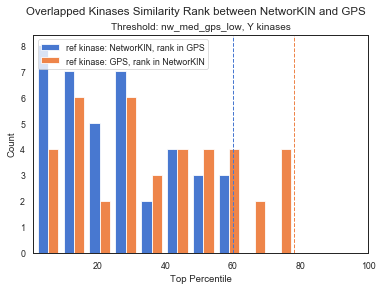

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


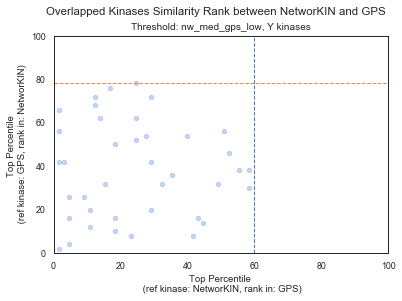

117 overlapped kinases 
 NetworKIN :  140 kinases 
 GPS :  243 kinases 



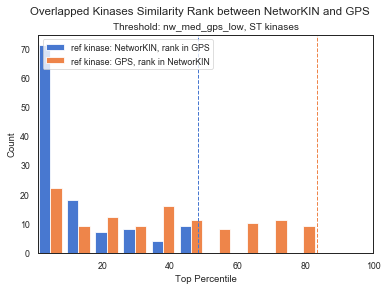

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


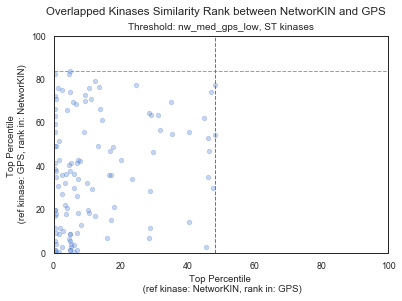

In [41]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_med_vs_GPS5.0_low_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, nw05_y, gpsl_y , 'NetworKIN', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_nw_med_gps_low.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'gps', 'nw_med_gps_low', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_med_vs_GPS5.0_low_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, nw05_st, gpsl_st , 'NetworKIN', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_nw_med_gps_low.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'gps', 'nw_med_gps_low', 'ST kinases', rank_dir + d_type + '_')


### NetworKIN(1) vs GPS(l)
- index: kinases in NetworKIN
- column: kinases in GPS

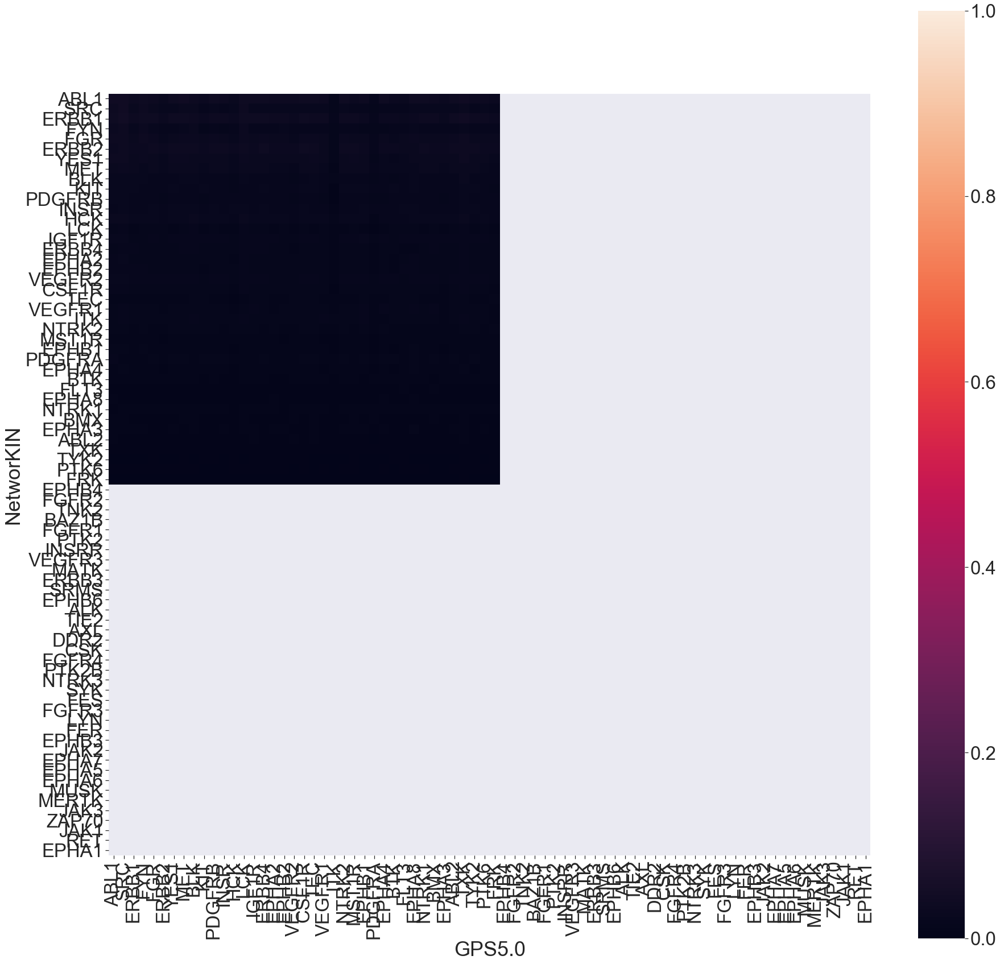

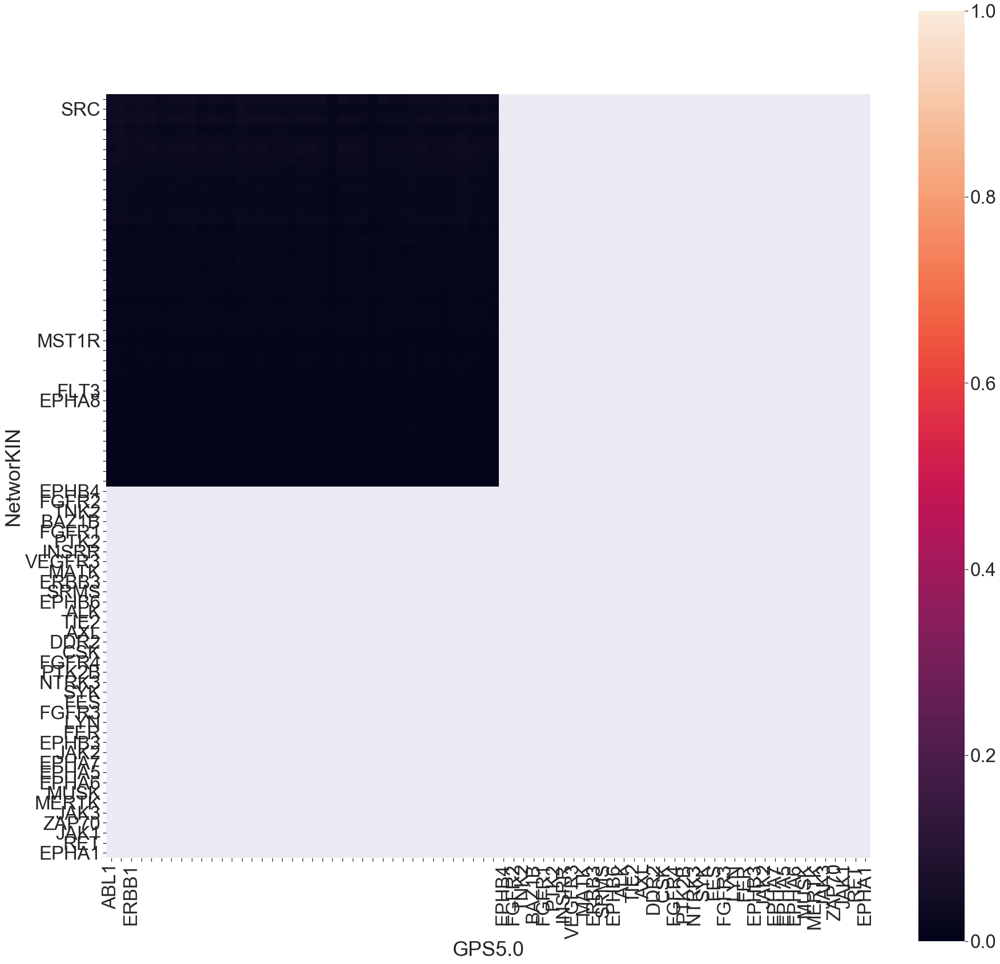

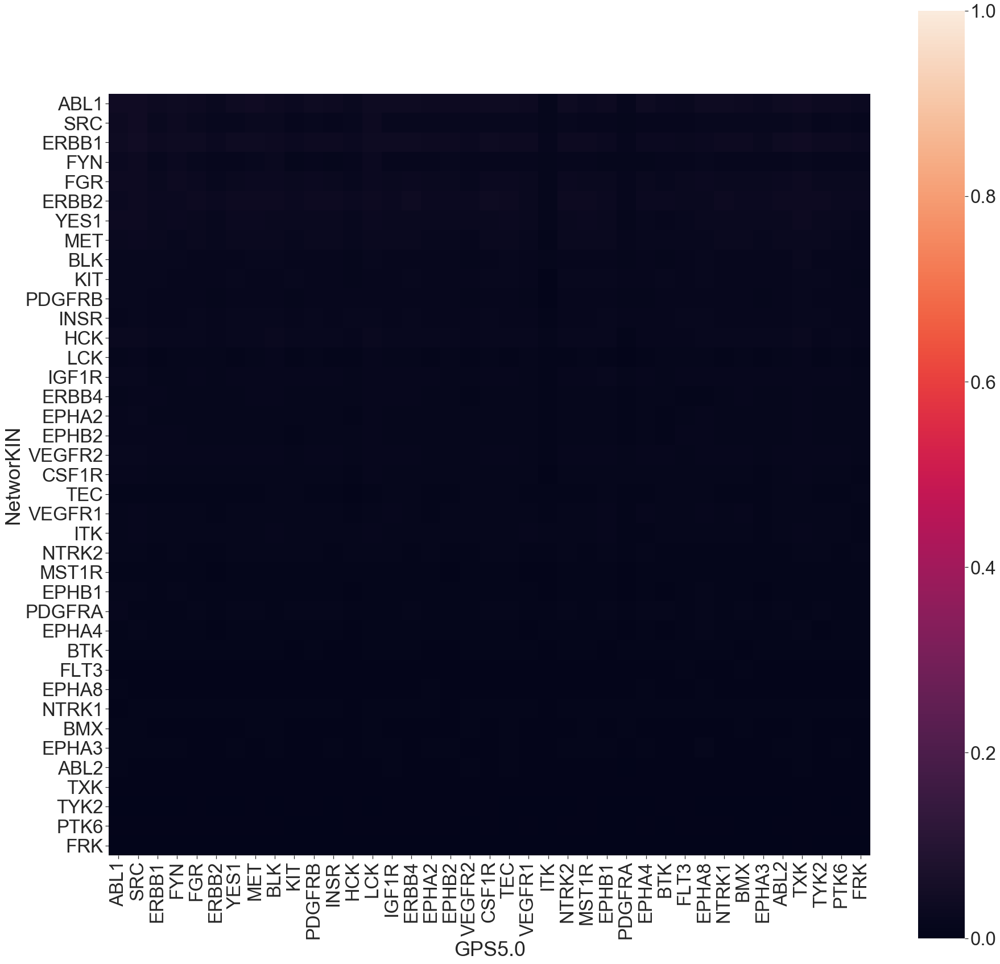

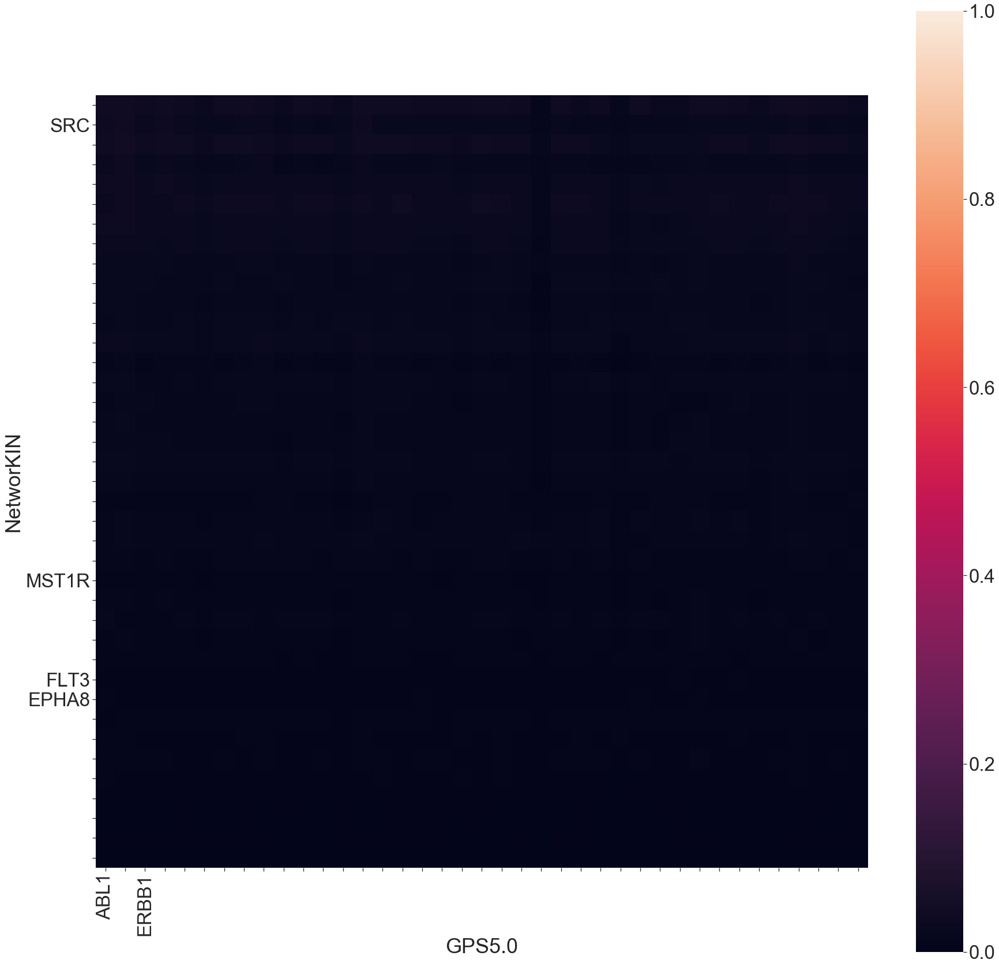

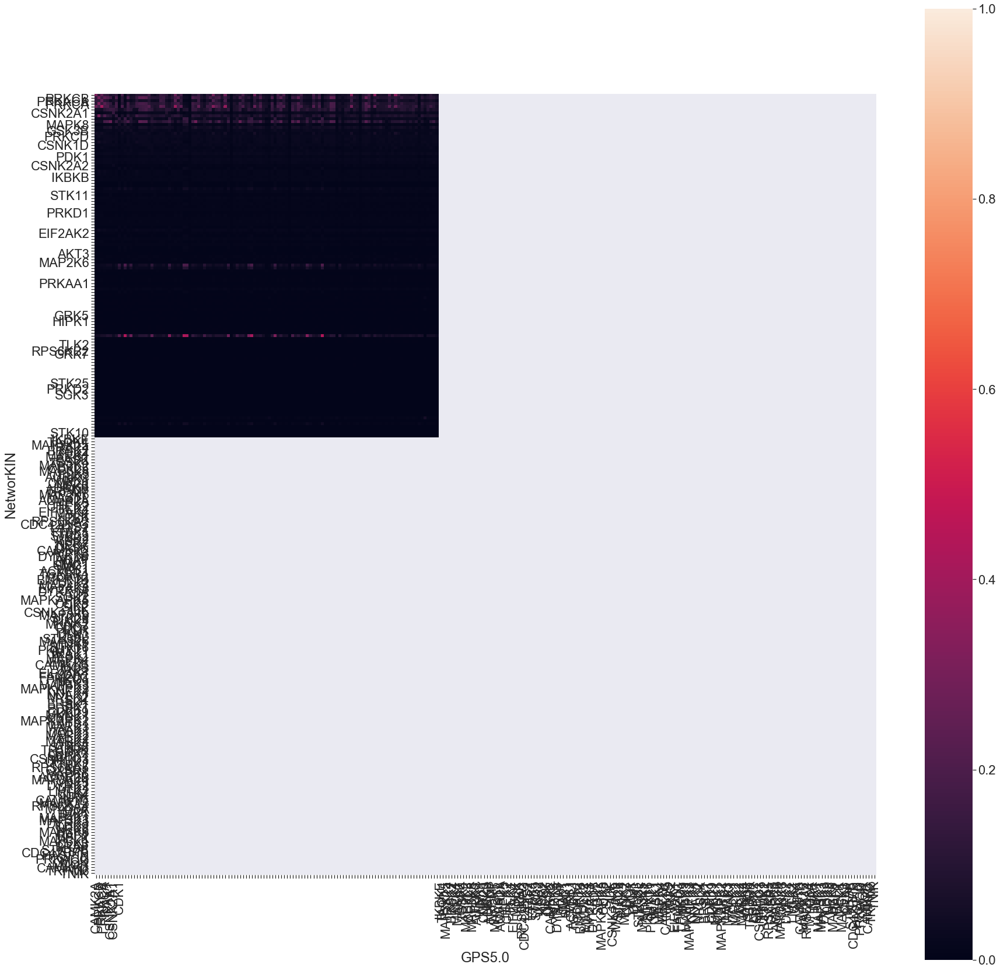

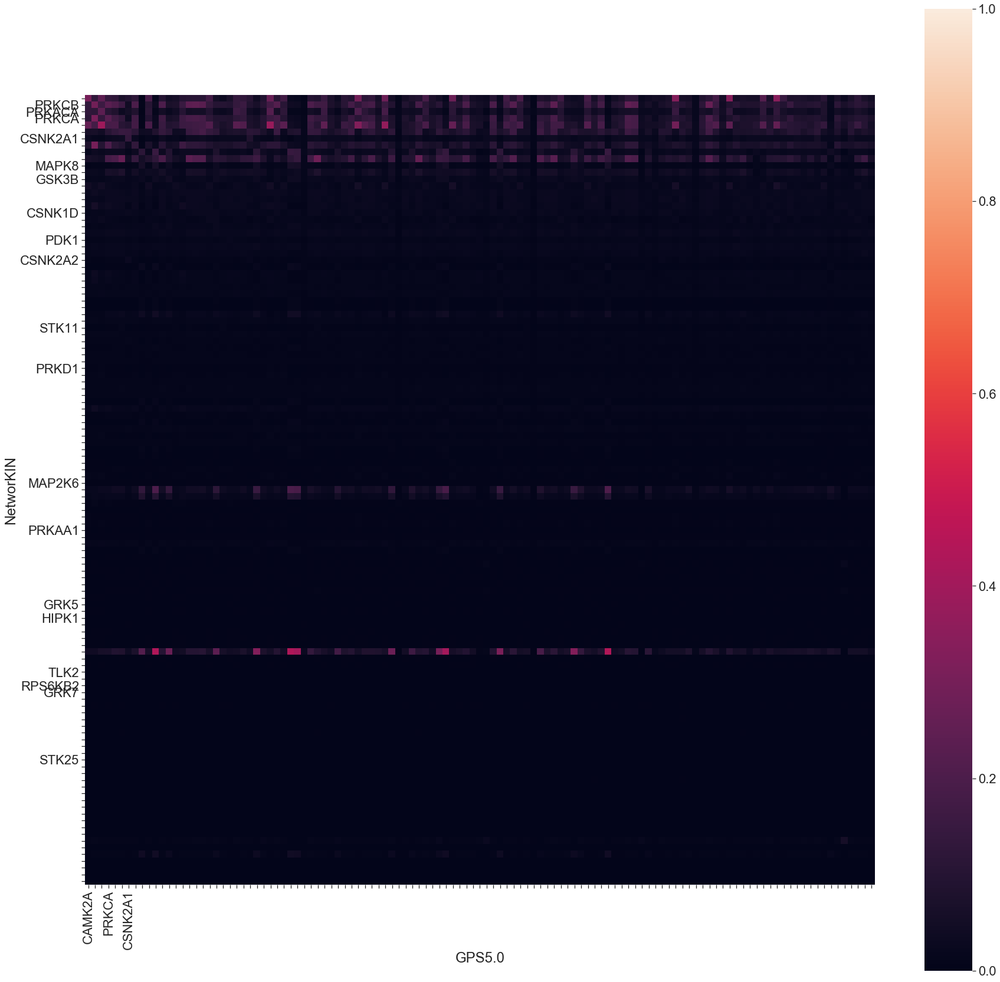

In [52]:
heatmap_y_mx = kinase_mutual_information.between_predictors(nw1_y, gpsl_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_high_vs_GPS5.0_low_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_NetworKIN_high_vs_GPS5.0_low_Y_kinase','NetworKIN','GPS5.0', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(nw1_st, gpsl_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_high_vs_GPS5.0_low_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_NetworKIN_high_vs_GPS5.0_low_ST_kinase', 'NetworKIN', 'GPS5.0', 'st')


39 overlapped kinases 
 NetworKIN :  50 kinases 
 GPS :  65 kinases 



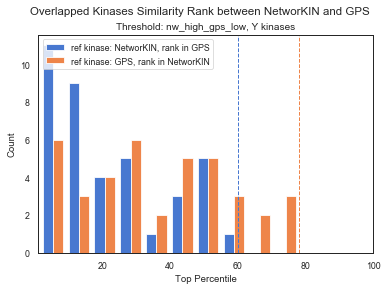

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


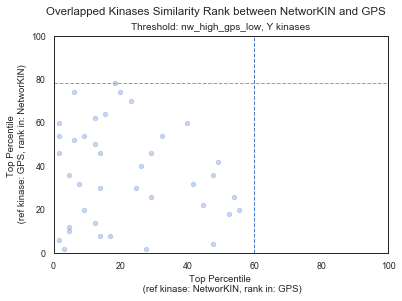

117 overlapped kinases 
 NetworKIN :  140 kinases 
 GPS :  243 kinases 



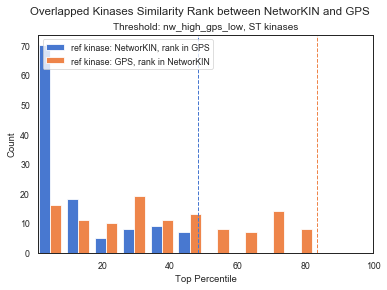

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


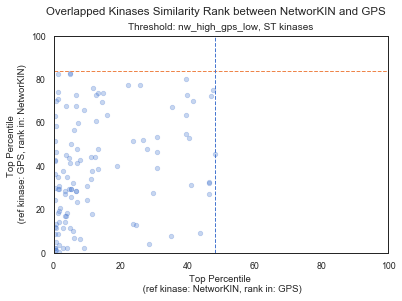

In [40]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_high_vs_GPS5.0_low_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, nw1_y, gpsl_y , 'NetworKIN', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_nw_high_gps_low.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'gps', 'nw_high_gps_low', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_high_vs_GPS5.0_low_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, nw1_st, gpsl_st , 'NetworKIN', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_nw_high_gps_low.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'gps', 'nw_high_gps_low', 'ST kinases', rank_dir + d_type + '_')


### NetworKIN(1) vs GPS(m)
- index: kinases in NetworKIN
- column: kinases in GPS

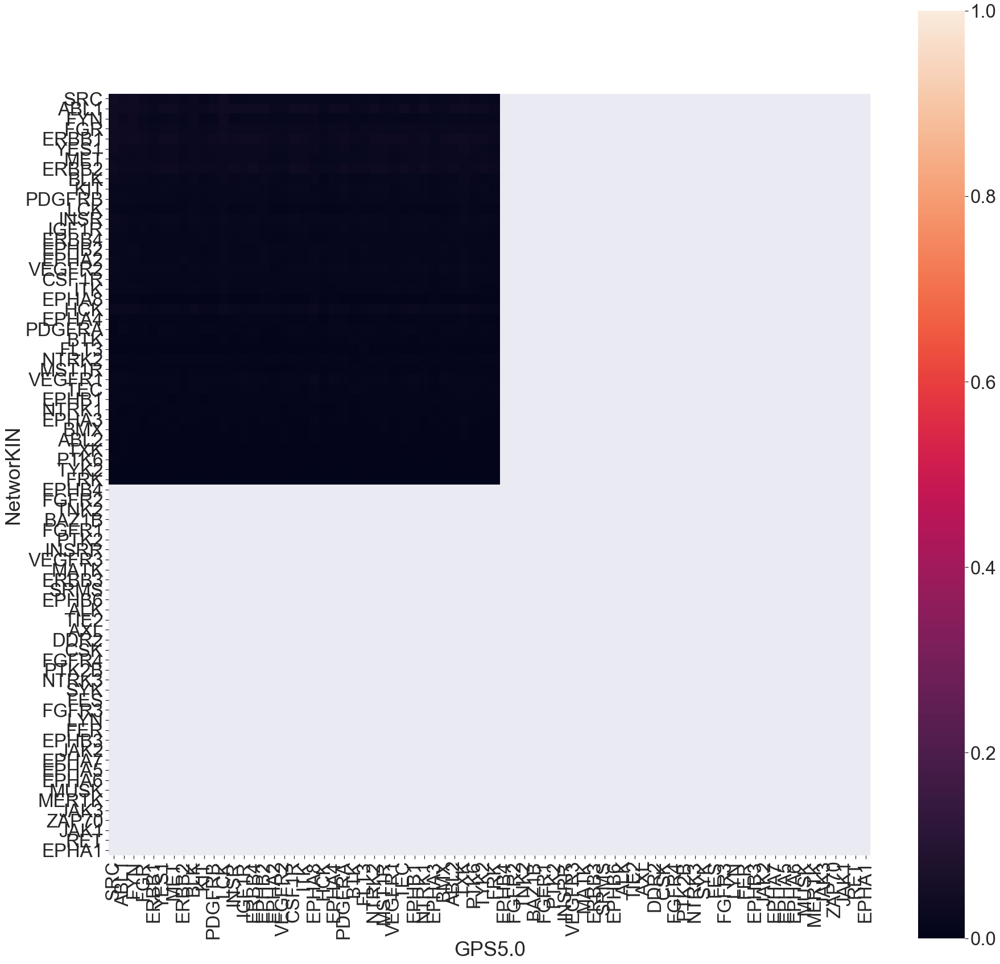

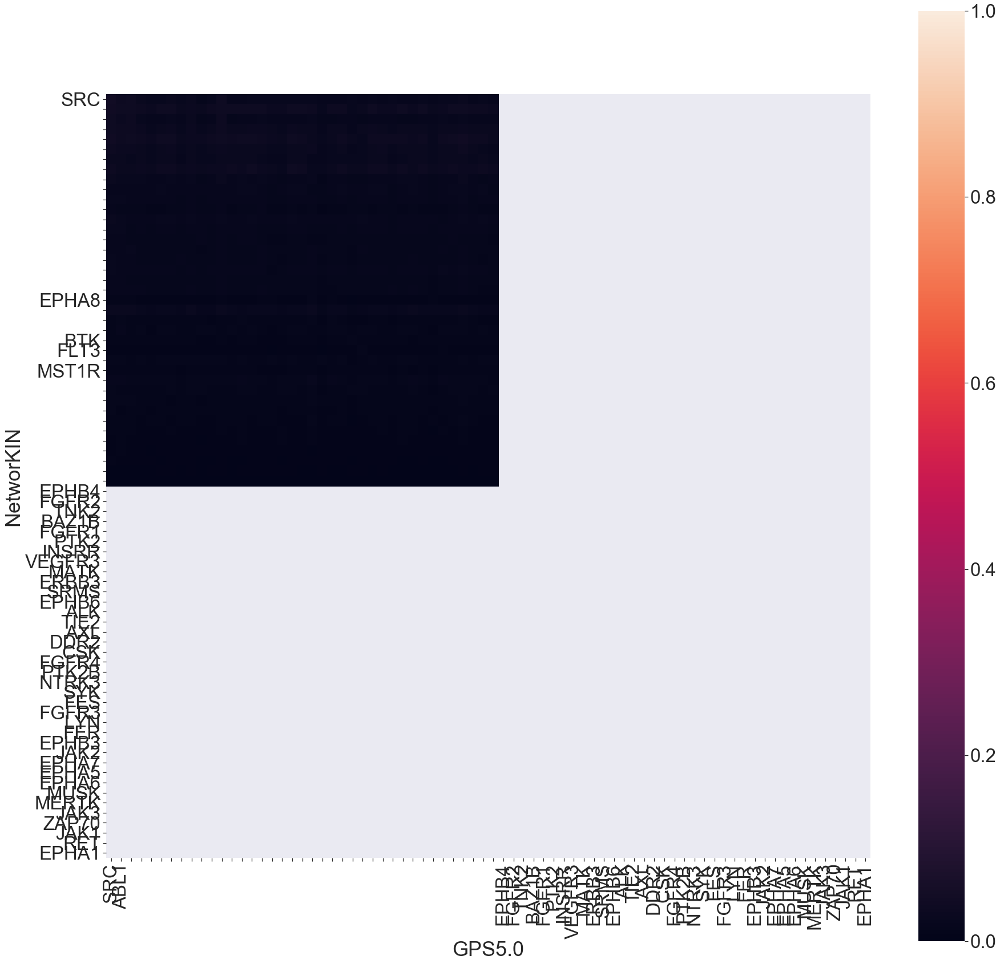

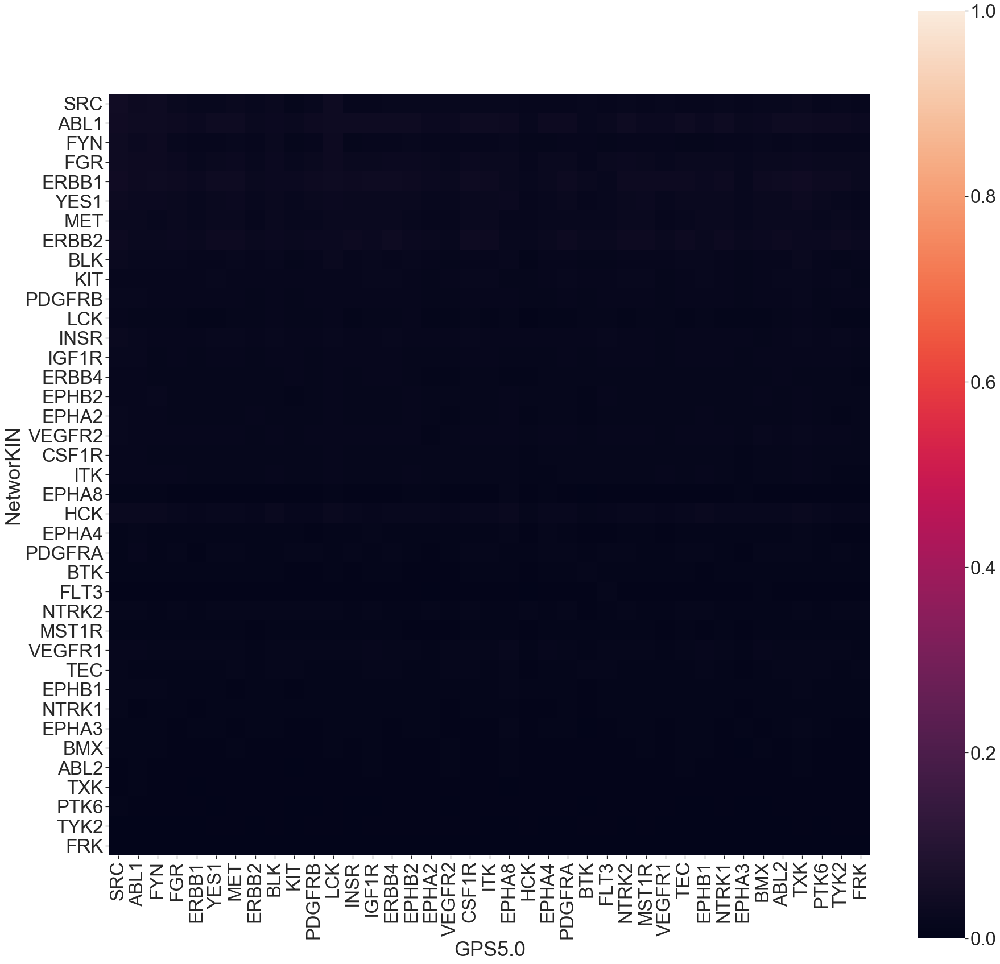

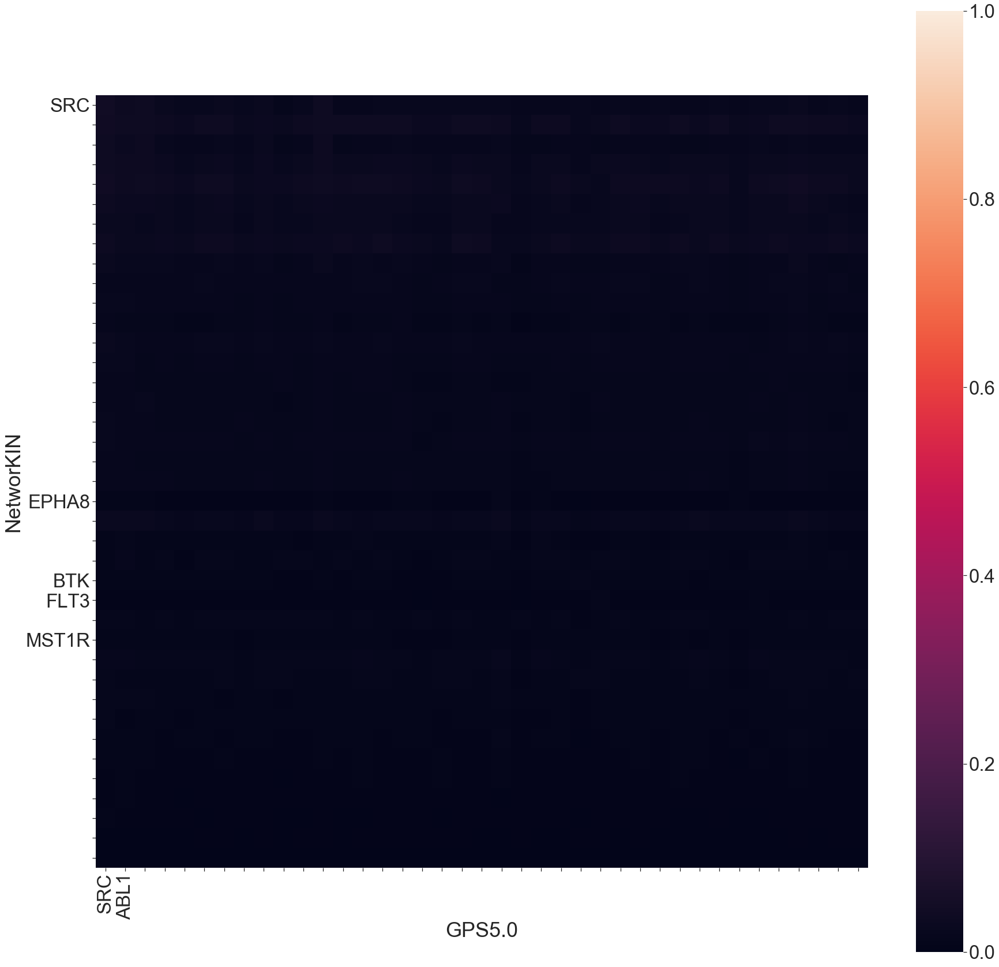

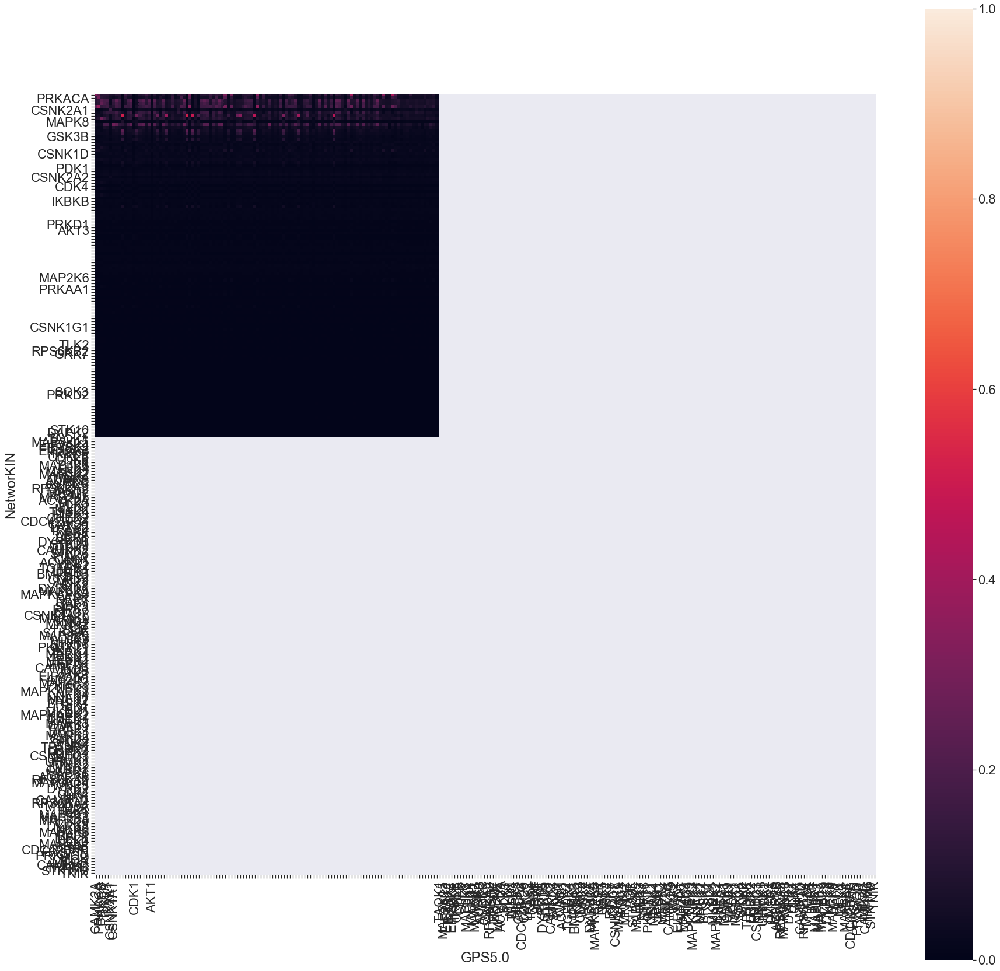

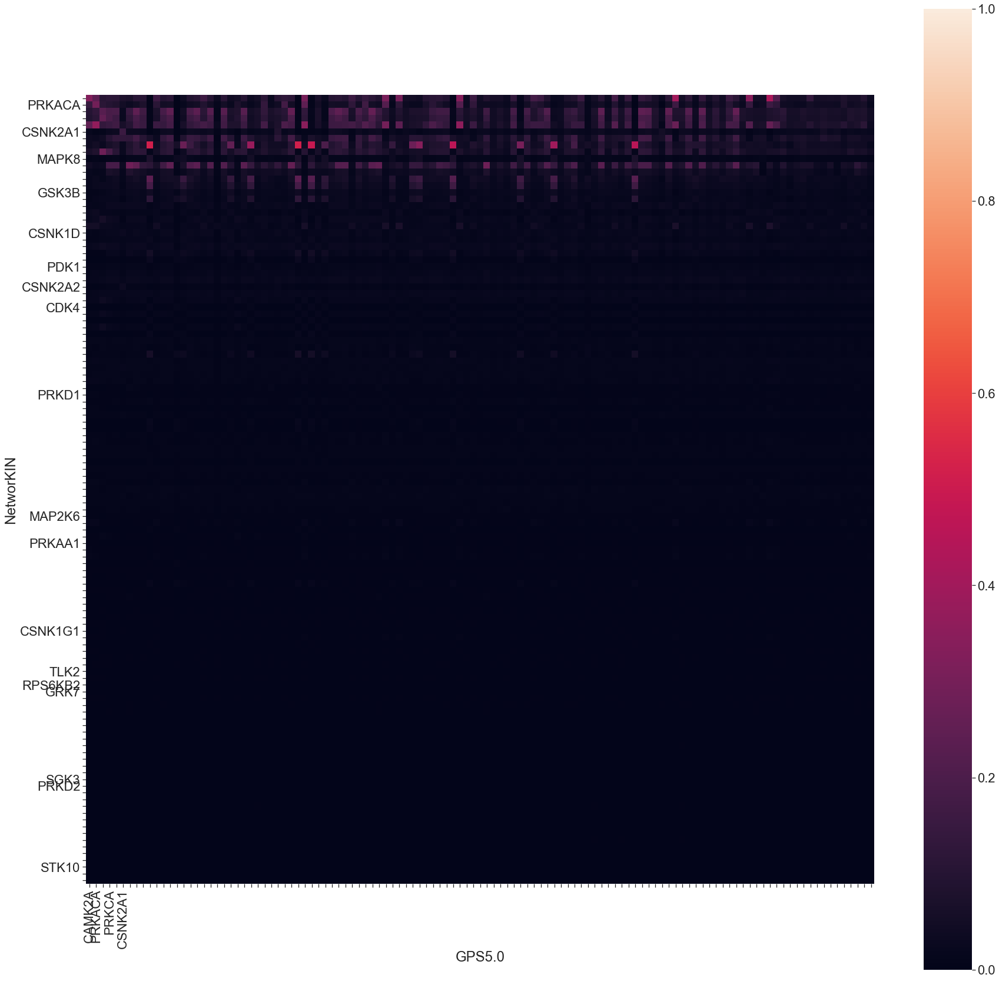

In [54]:
heatmap_y_mx = kinase_mutual_information.between_predictors(nw1_y, gpsm_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_high_vs_GPS5.0_med_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_NetworKIN_high_vs_GPS5.0_med_Y_kinase','NetworKIN','GPS5.0', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(nw1_st, gpsm_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_NetworKIN_high_vs_GPS5.0_med_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_NetworKIN_high_vs_GPS5.0_med_ST_kinase', 'NetworKIN', 'GPS5.0', 'st')


39 overlapped kinases 
 NetworKIN :  50 kinases 
 GPS :  65 kinases 



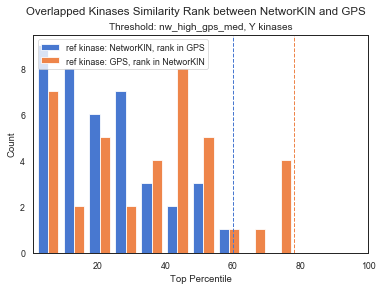

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


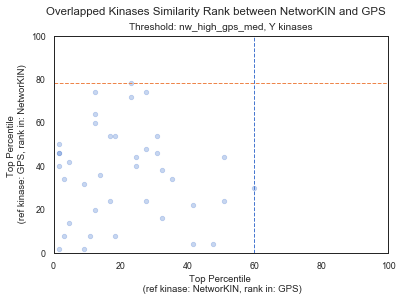

117 overlapped kinases 
 NetworKIN :  140 kinases 
 GPS :  243 kinases 



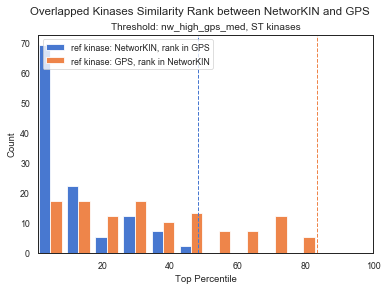

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


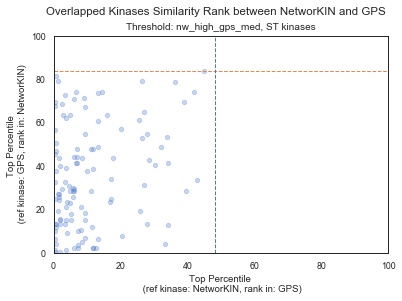

In [39]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_high_vs_GPS5.0_med_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, nw1_y, gpsm_y , 'NetworKIN', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_nw_high_gps_med.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'nw', 'gps', 'nw_high_gps_med', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_NetworKIN_high_vs_GPS5.0_med_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, nw1_st, gpsm_st , 'NetworKIN', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_nw_high_gps_med.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'nw', 'gps', 'nw_high_gps_med', 'ST kinases', rank_dir + d_type + '_')


### PhosphoPICK(0.01) vs GPS(m)
- index: kinases in PhosphoPICK
- column: kinases in GPS

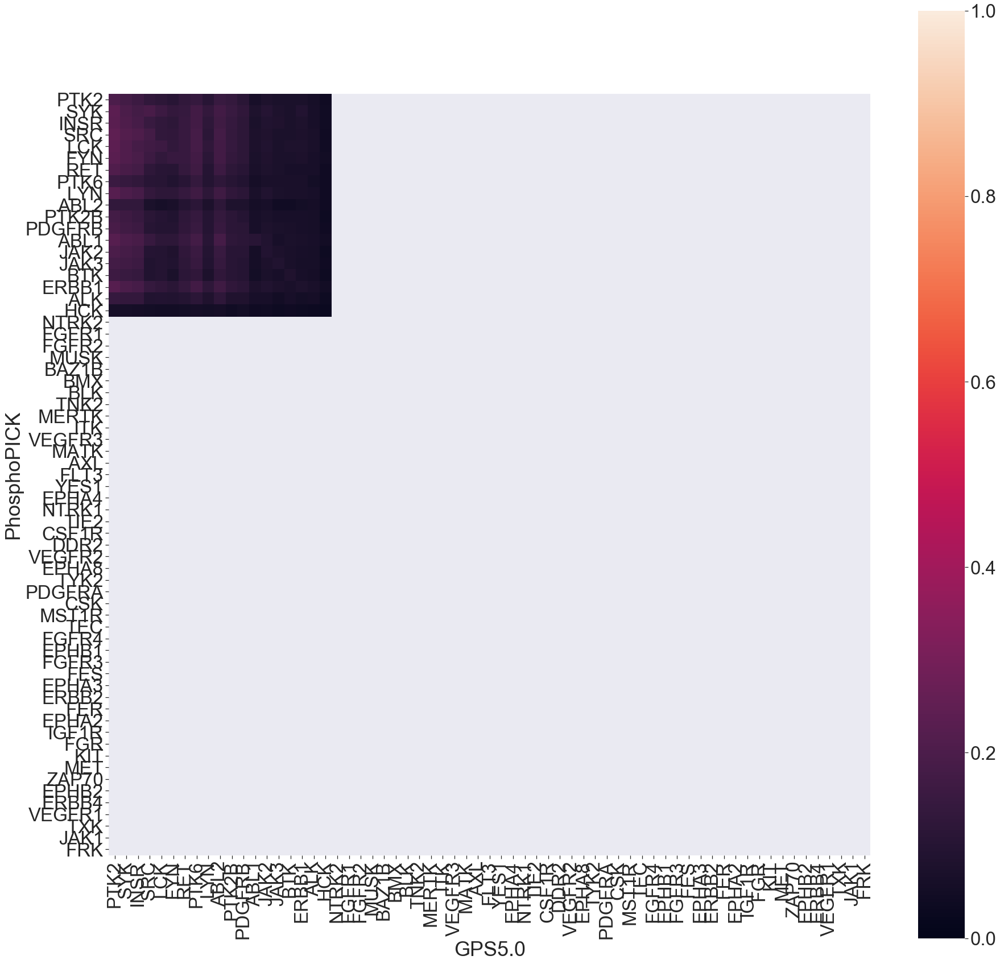

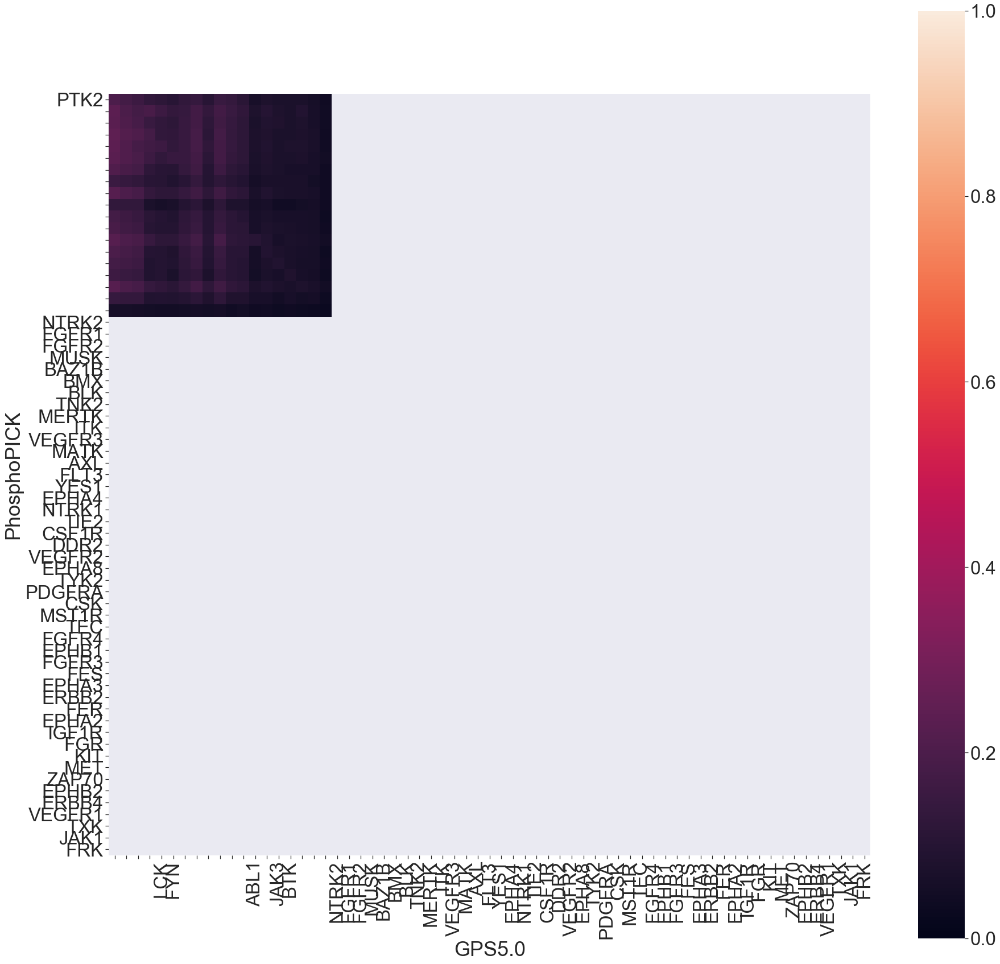

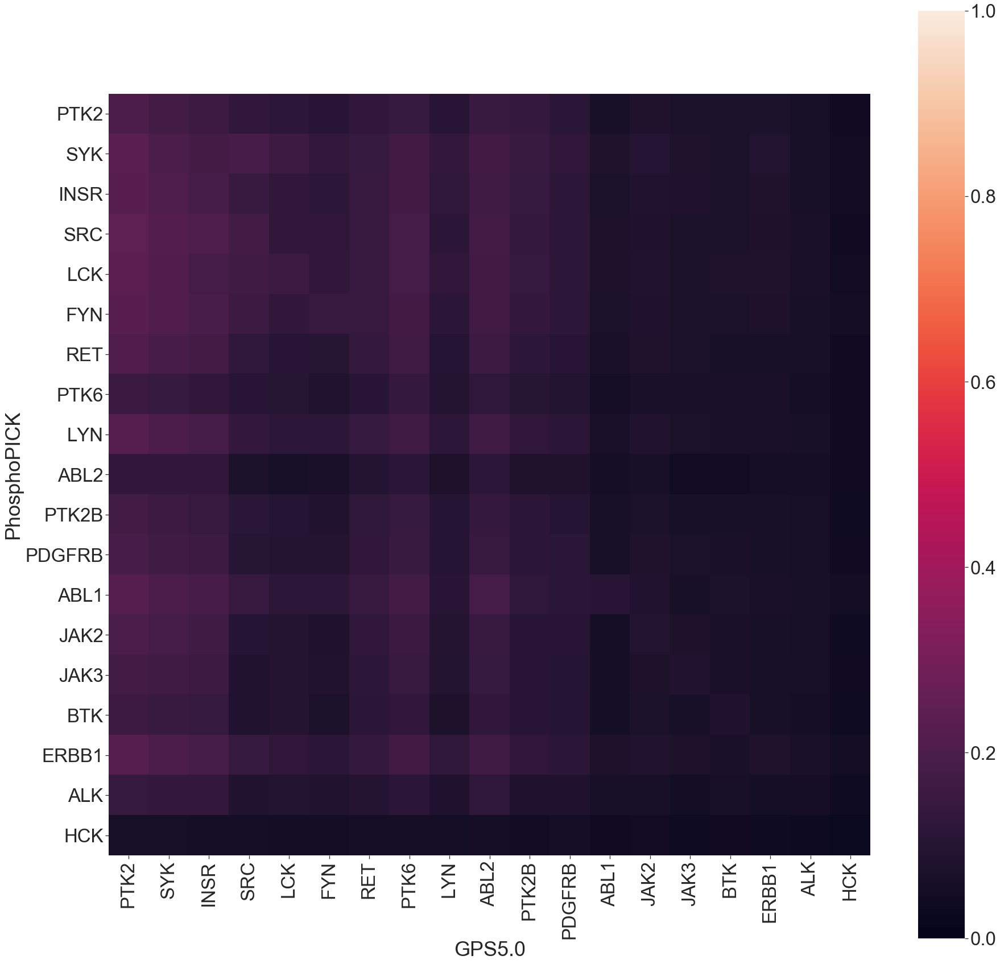

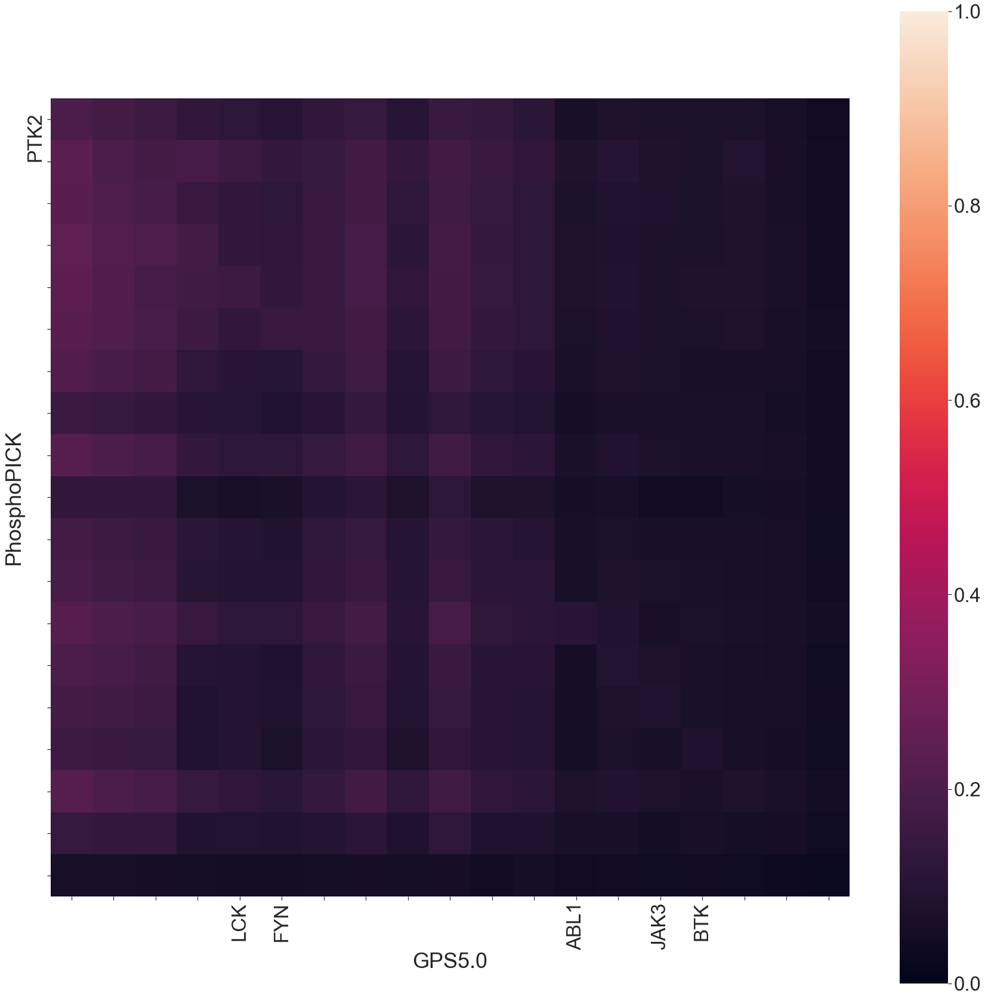

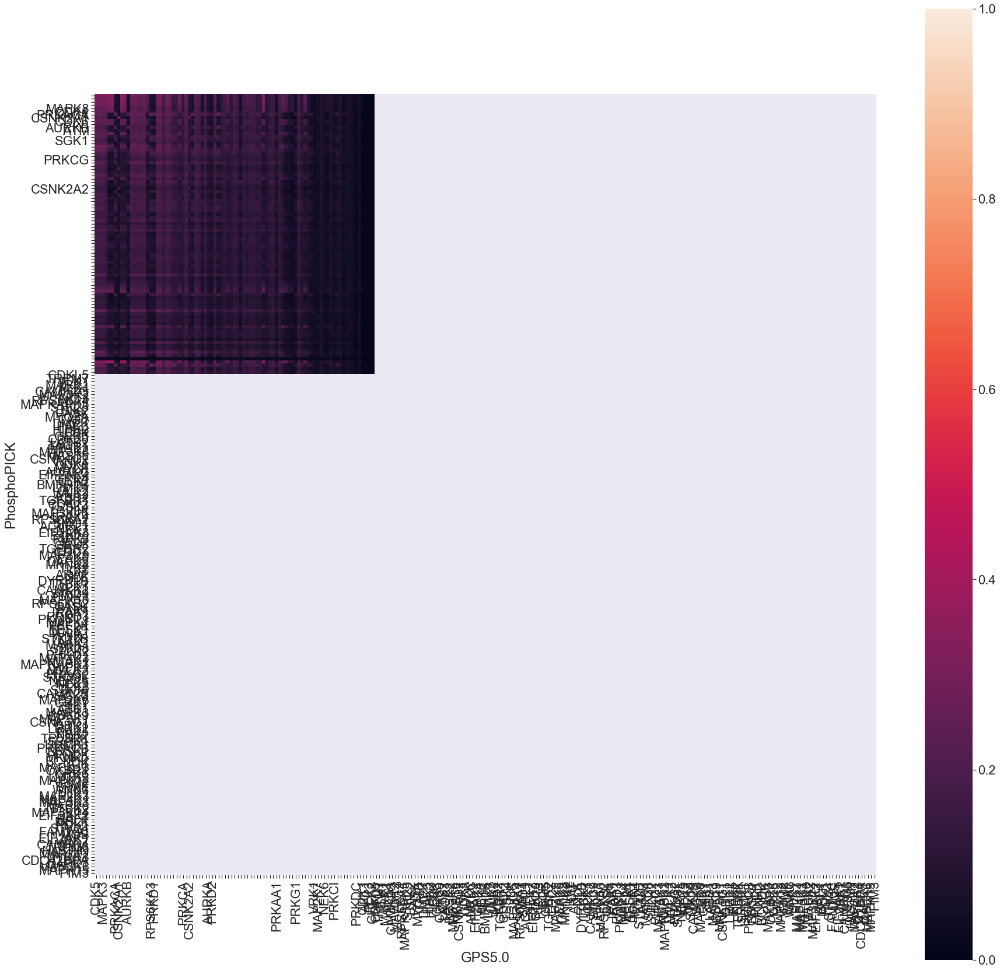

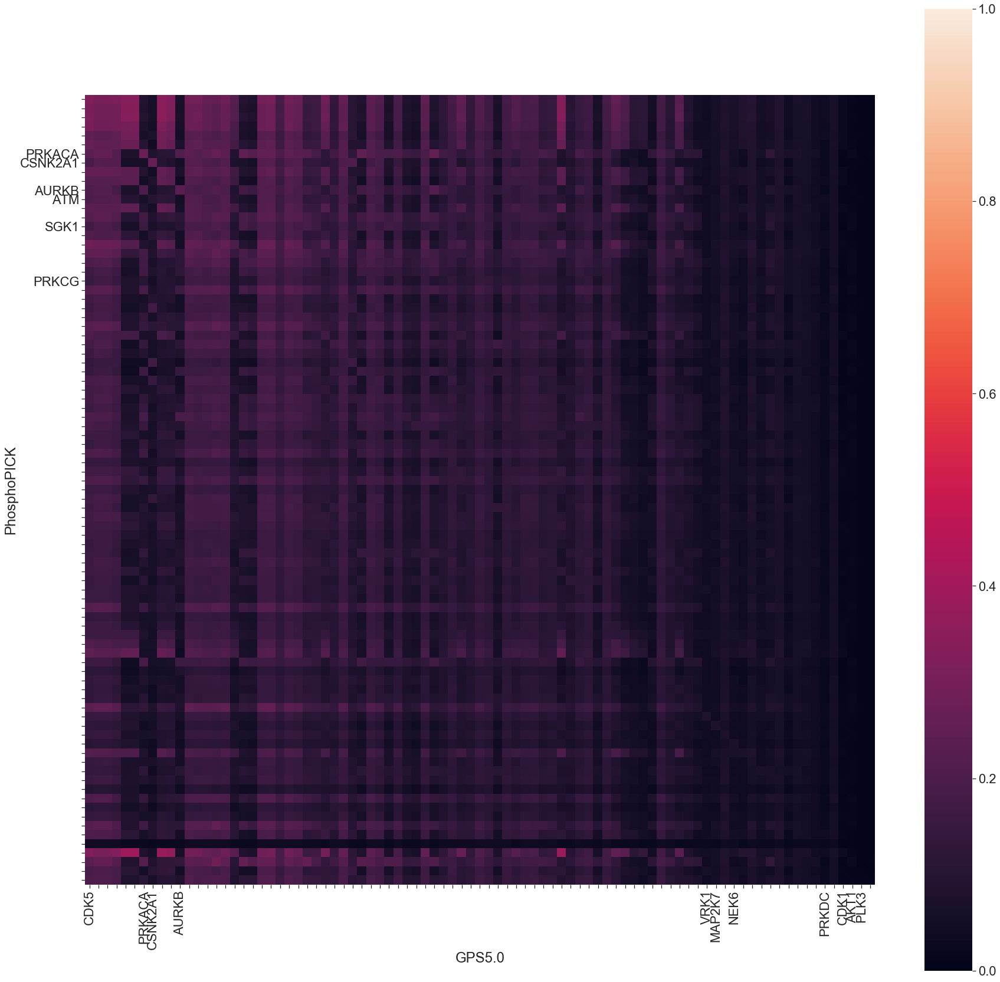

In [56]:
heatmap_y_mx = kinase_mutual_information.between_predictors(pp1_y, gpsm_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_PhosphoPICK_low_vs_GPS5.0_med_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_PhosphoPICK_low_vs_GPS5.0_med_Y_kinase','PhosphoPICK','GPS5.0', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(pp1_st, gpsm_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_PhosphoPICK_low_vs_GPS5.0_med_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_PhosphoPICK_low_vs_GPS5.0_med_ST_kinase', 'PhosphoPICK', 'GPS5.0', 'st')


19 overlapped kinases 
 PhosphoPICK :  19 kinases 
 GPS :  65 kinases 



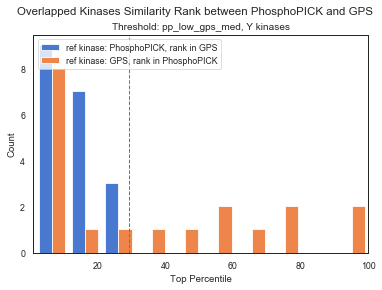

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


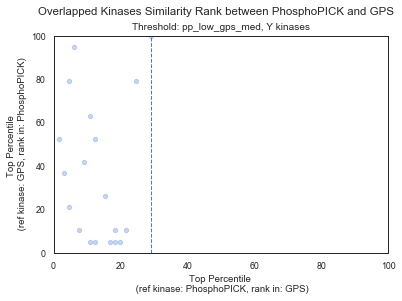

87 overlapped kinases 
 PhosphoPICK :  87 kinases 
 GPS :  243 kinases 



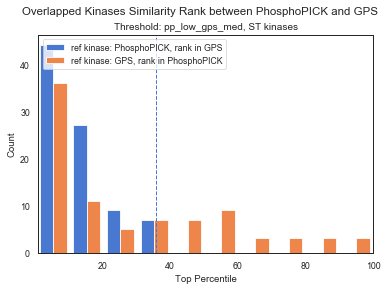

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


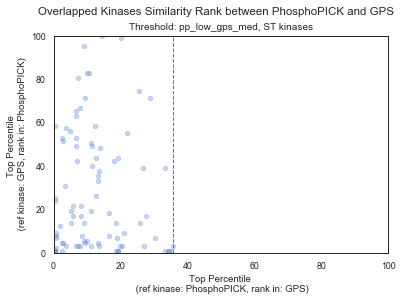

In [38]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_low_vs_GPS5.0_med_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, pp1_y, gpsm_y , 'PhosphoPICK', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_pp_low_gps_med.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'pp', 'gps', 'pp_low_gps_med', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_low_vs_GPS5.0_med_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, pp1_st, gpsm_st , 'PhosphoPICK', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_pp_low_gps_med.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'pp', 'gps', 'pp_low_gps_med', 'ST kinases', rank_dir + d_type + '_')


### PhosphoPICK(0.01) vs GPS(h)
- index: kinases in PhosphoPICK
- column: kinases in GPS

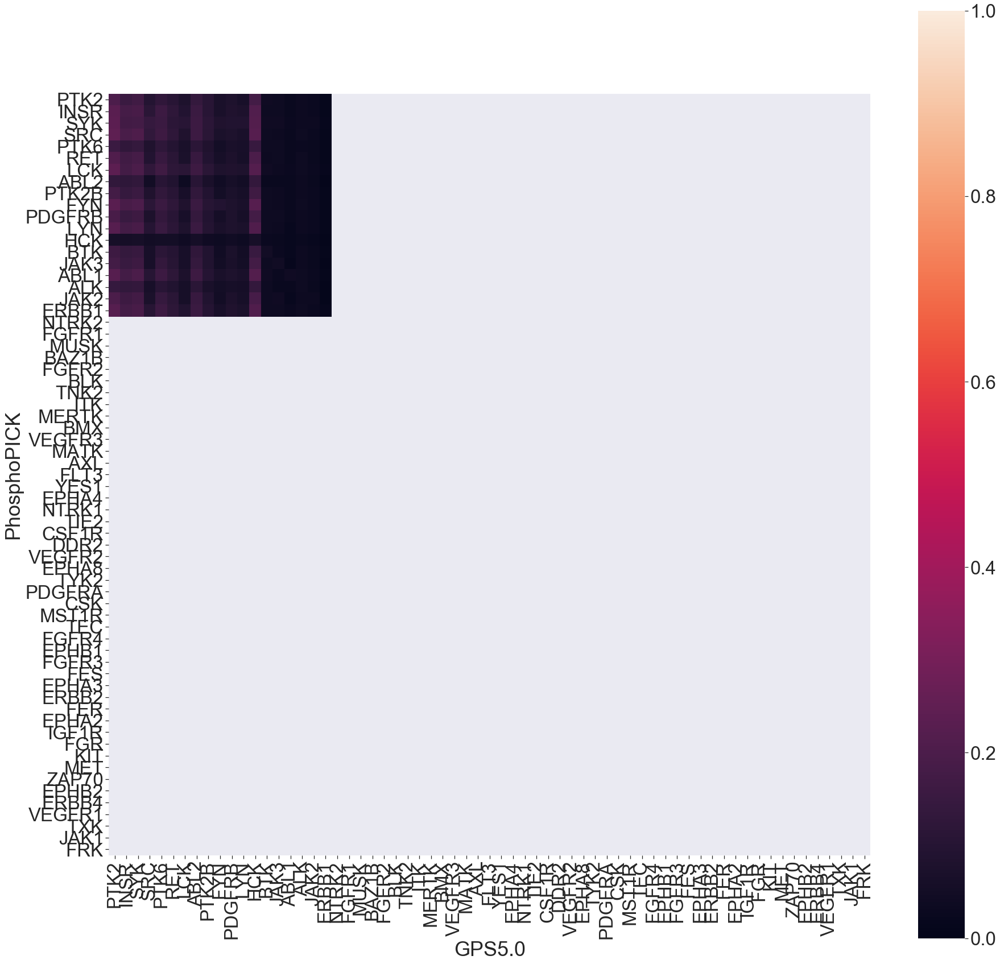

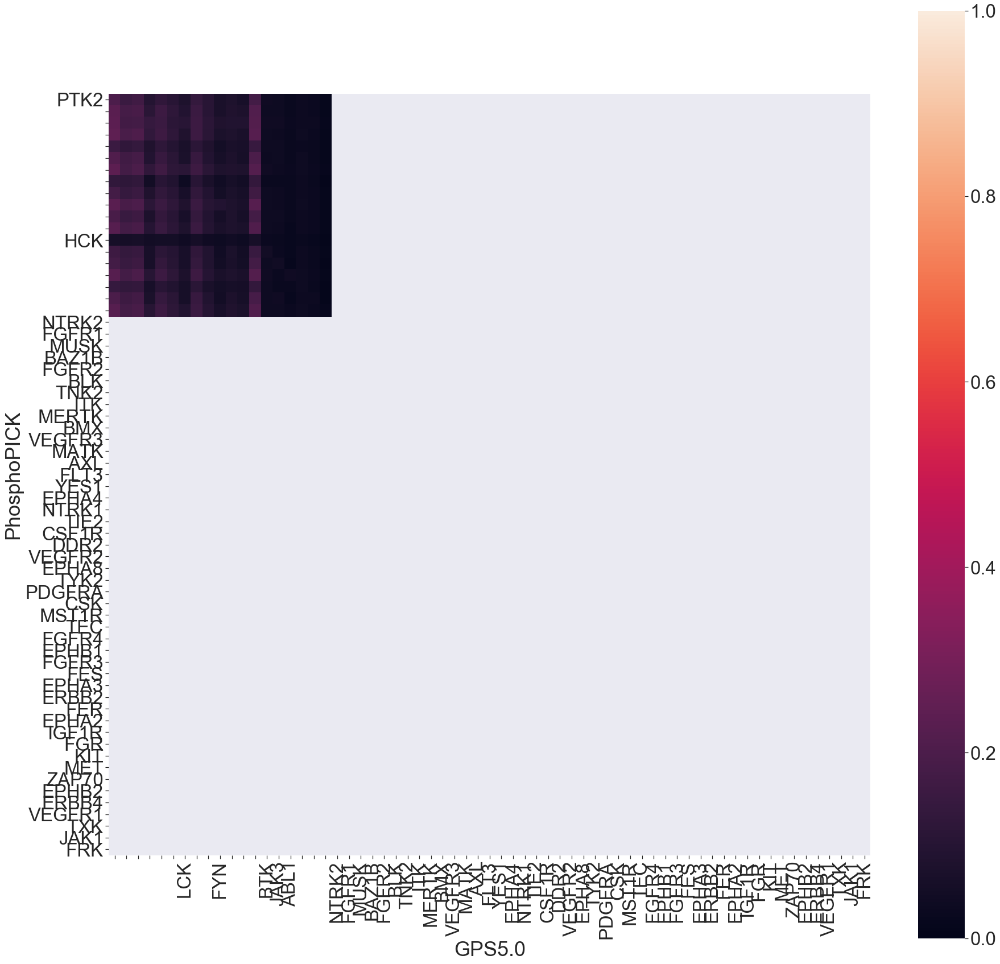

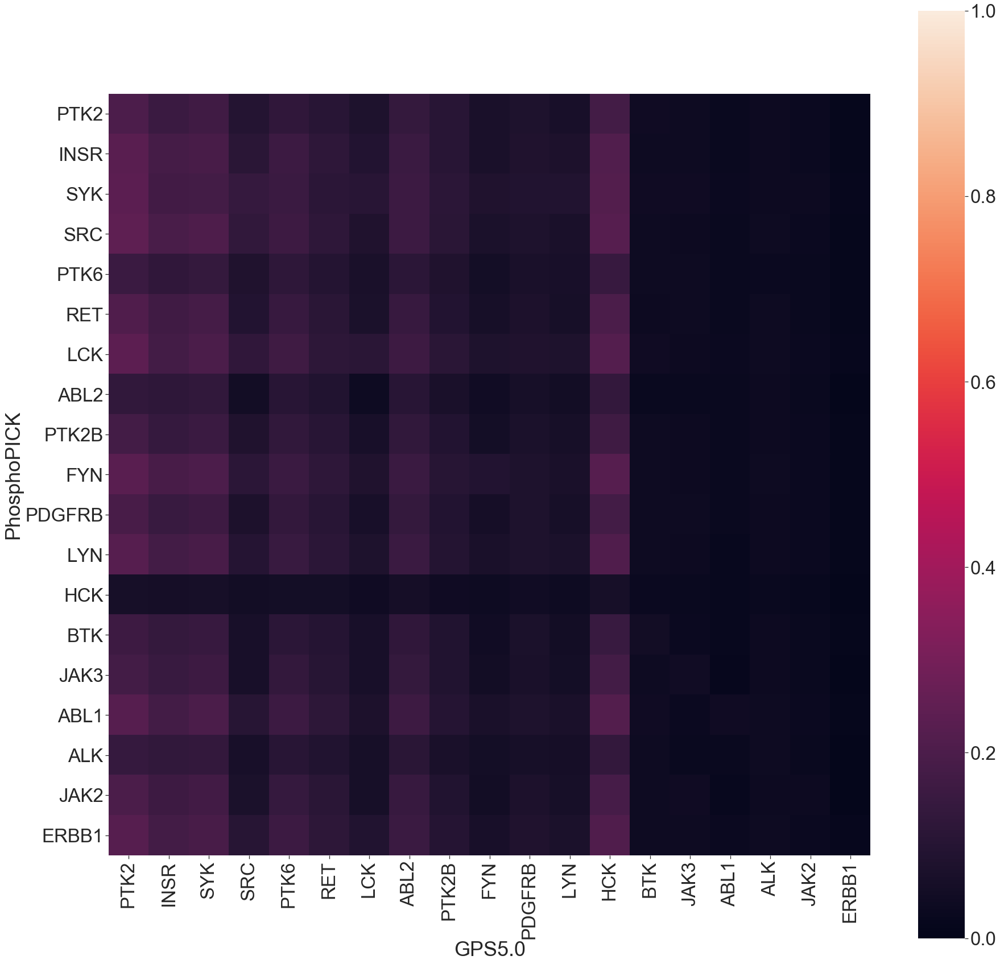

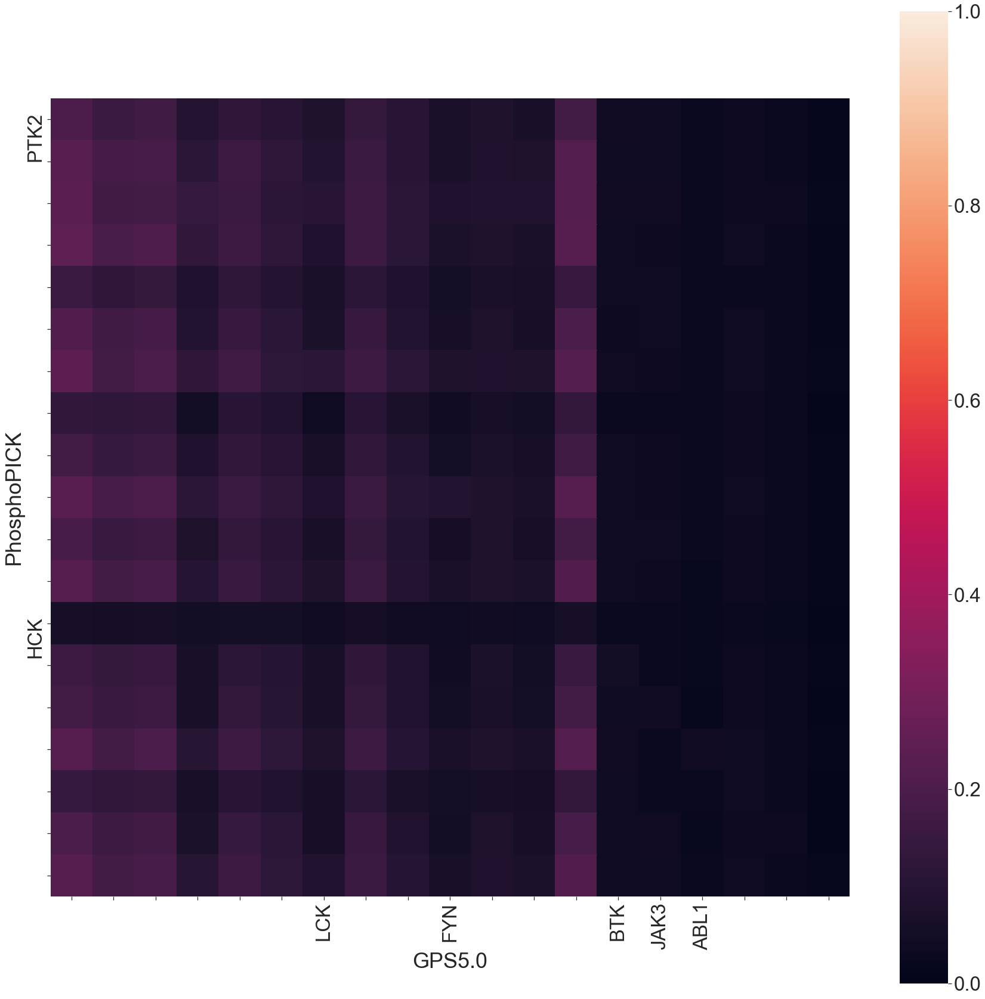

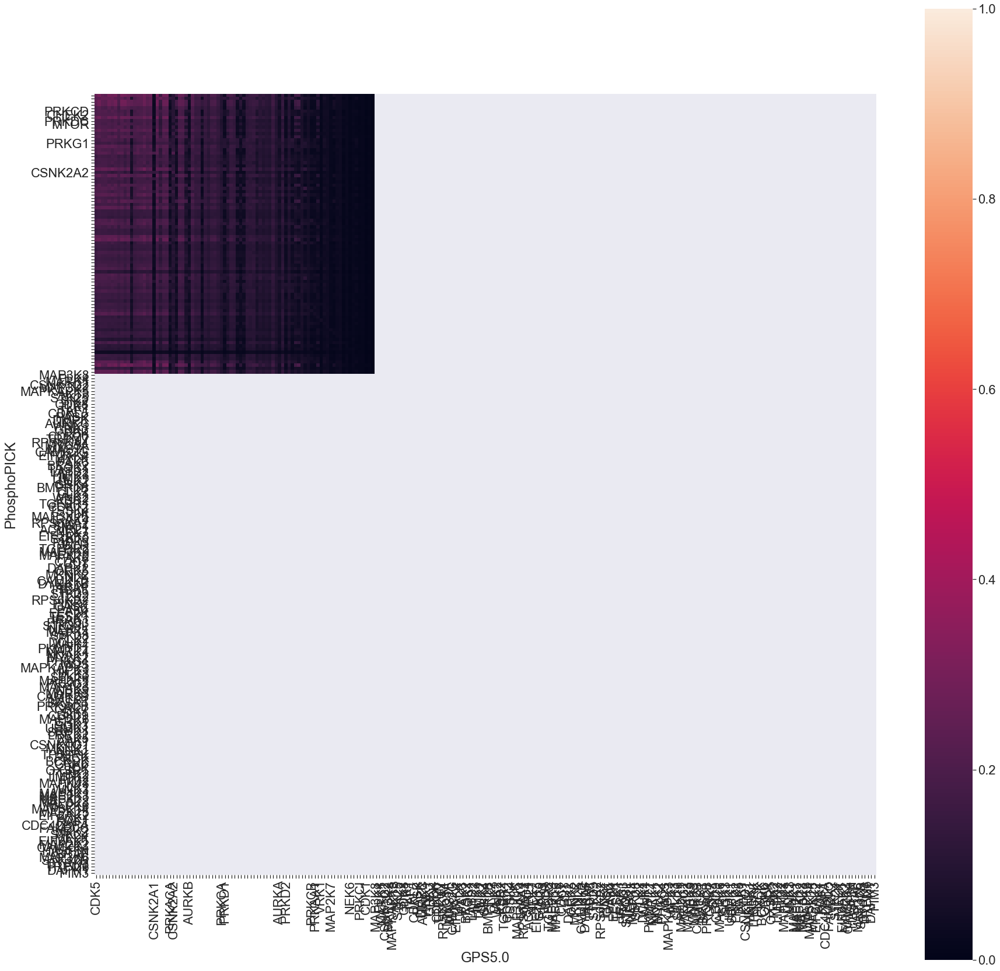

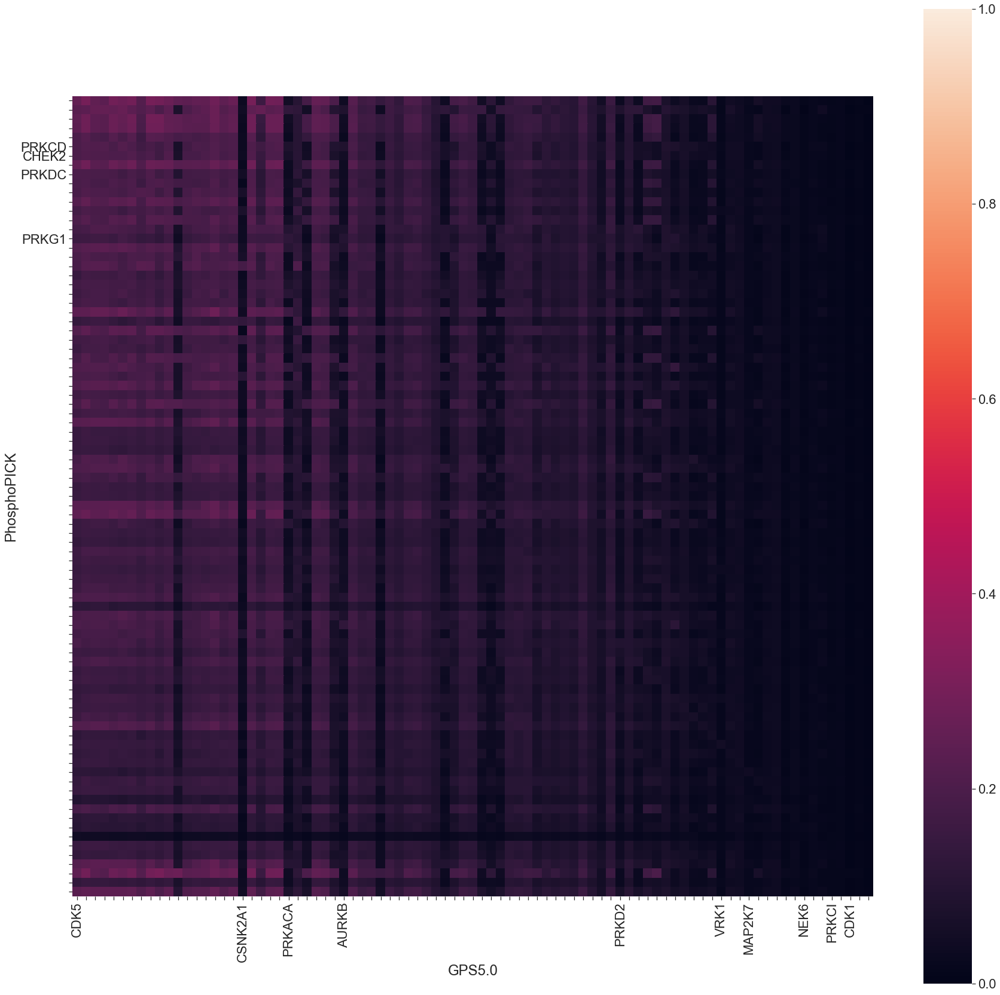

In [58]:
heatmap_y_mx = kinase_mutual_information.between_predictors(pp1_y, gpsh_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_PhosphoPICK_low_vs_GPS5.0_high_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_PhosphoPICK_low_vs_GPS5.0_high_Y_kinase','PhosphoPICK','GPS5.0', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(pp1_st, gpsh_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_PhosphoPICK_low_vs_GPS5.0_high_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_PhosphoPICK_low_vs_GPS5.0_high_ST_kinase', 'PhosphoPICK', 'GPS5.0', 'st')


19 overlapped kinases 
 PhosphoPICK :  19 kinases 
 GPS :  65 kinases 



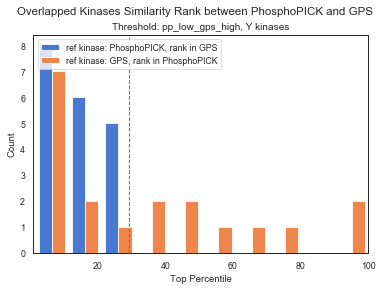

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


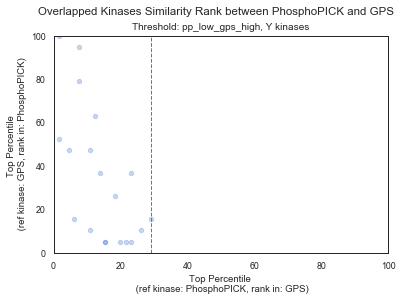

87 overlapped kinases 
 PhosphoPICK :  87 kinases 
 GPS :  243 kinases 



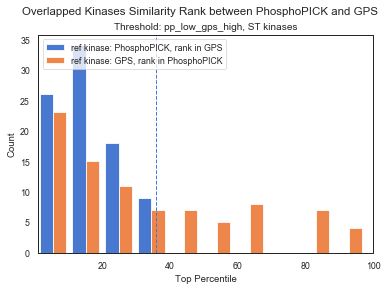

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


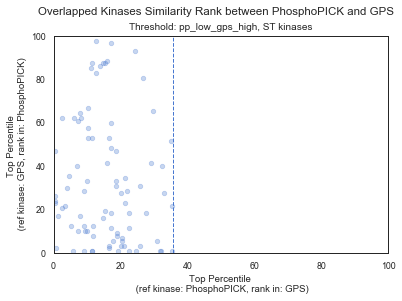

In [37]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_low_vs_GPS5.0_high_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, pp1_y, gpsh_y , 'PhosphoPICK', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_pp_low_gps_high.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'pp', 'gps', 'pp_low_gps_high', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_low_vs_GPS5.0_high_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, pp1_st, gpsh_st , 'PhosphoPICK', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_pp_low_gps_high.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'pp', 'gps', 'pp_low_gps_high', 'ST kinases', rank_dir + d_type + '_')


### PhosphoPICK(0.06) vs GPS(h)
- index: kinases in PhosphoPICK
- column: kinases in GPS

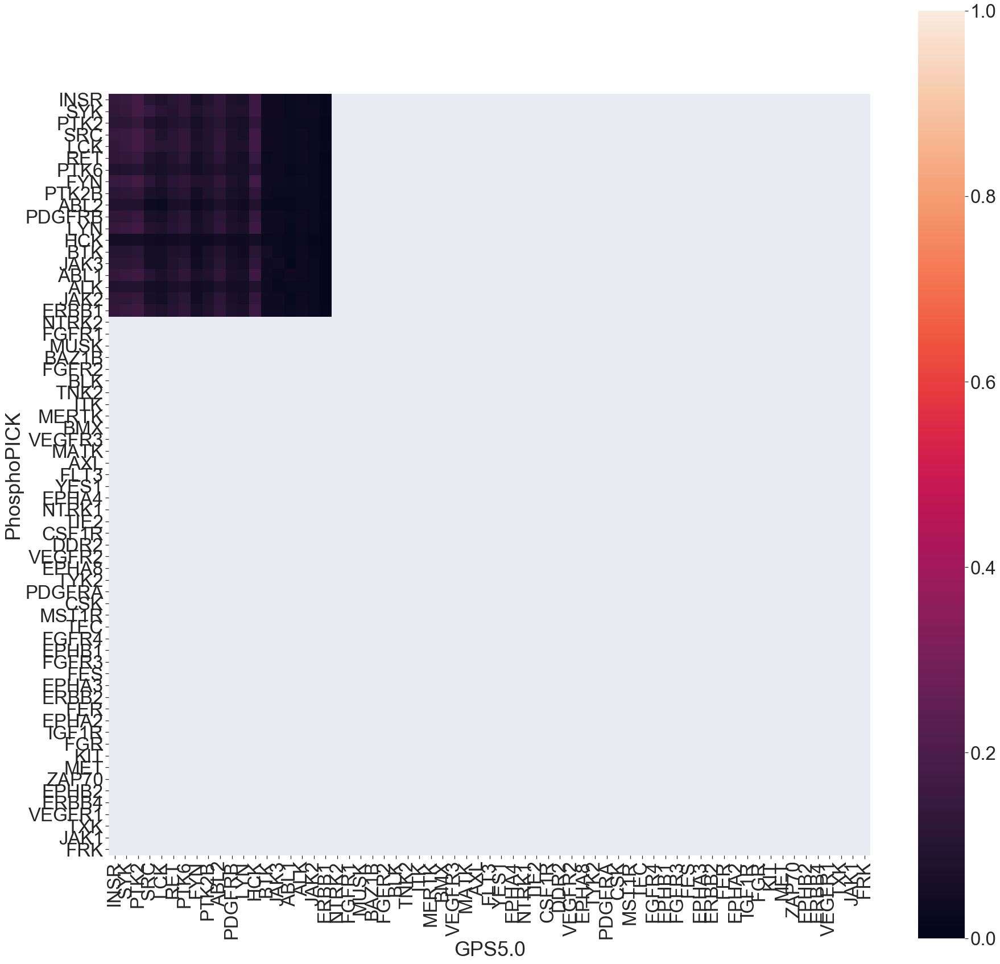

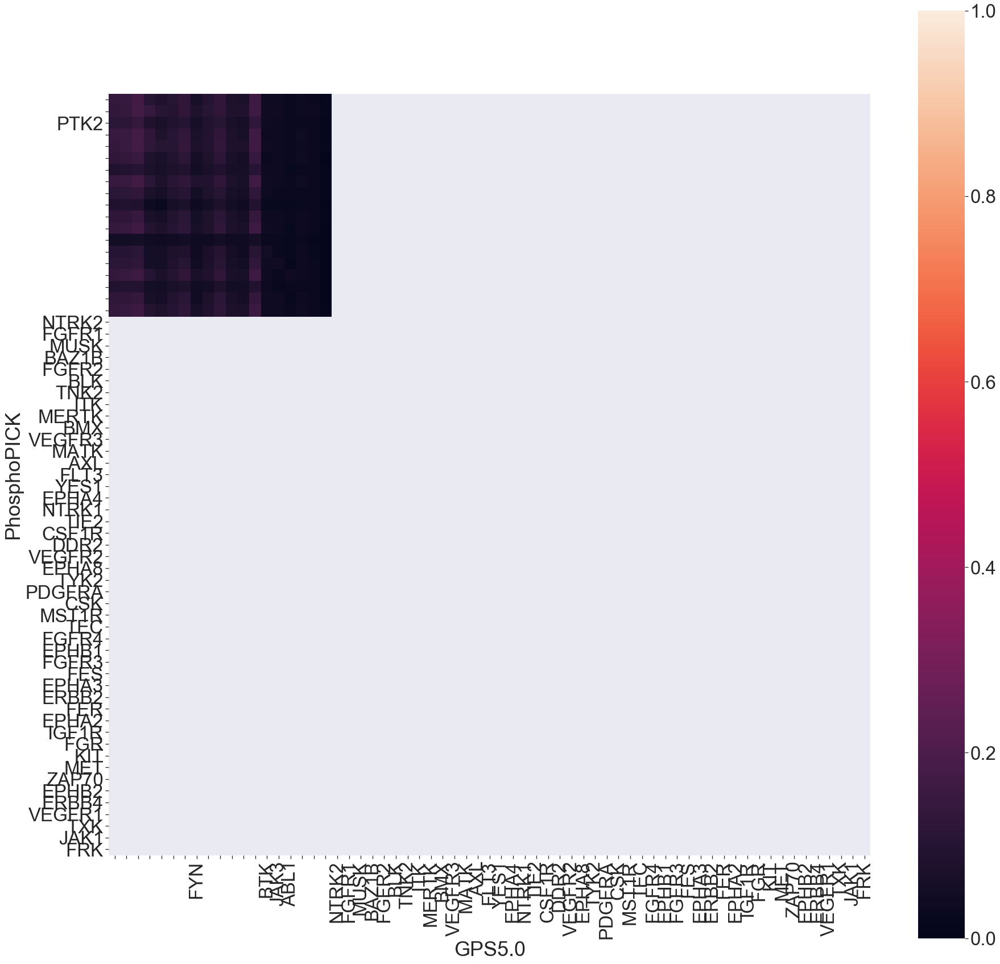

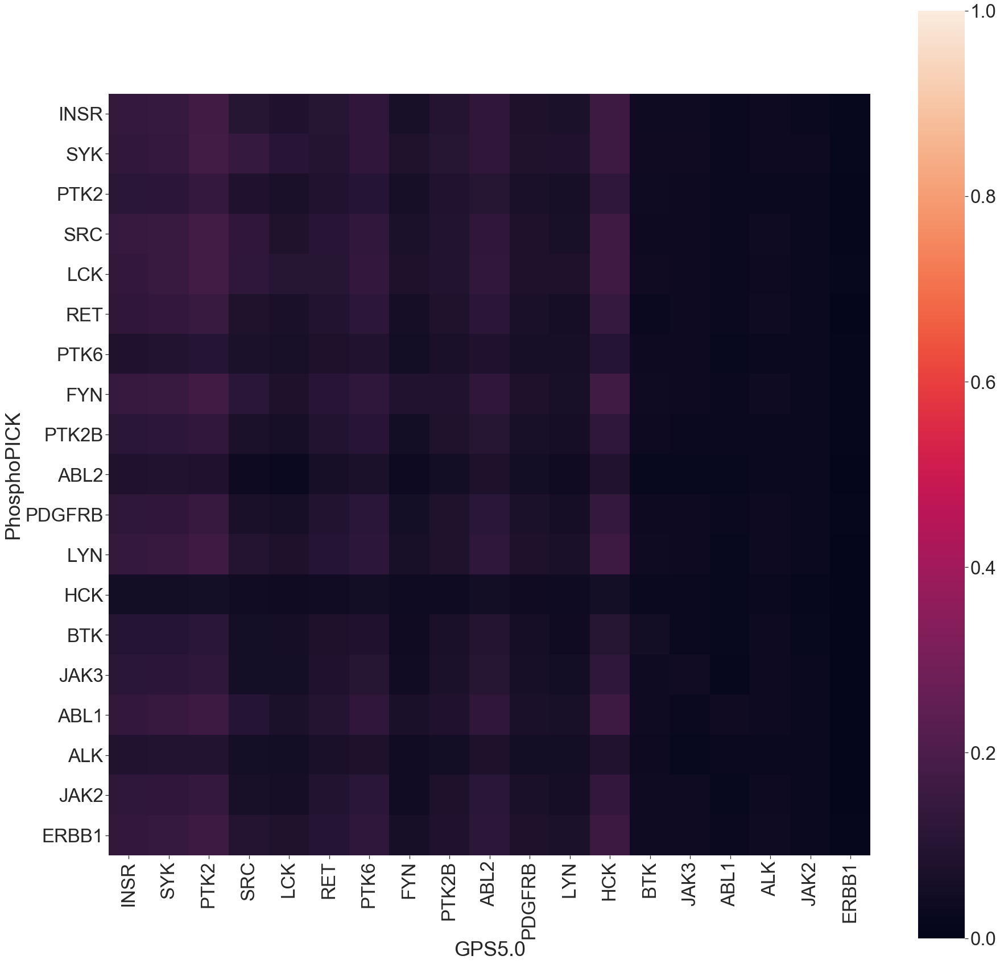

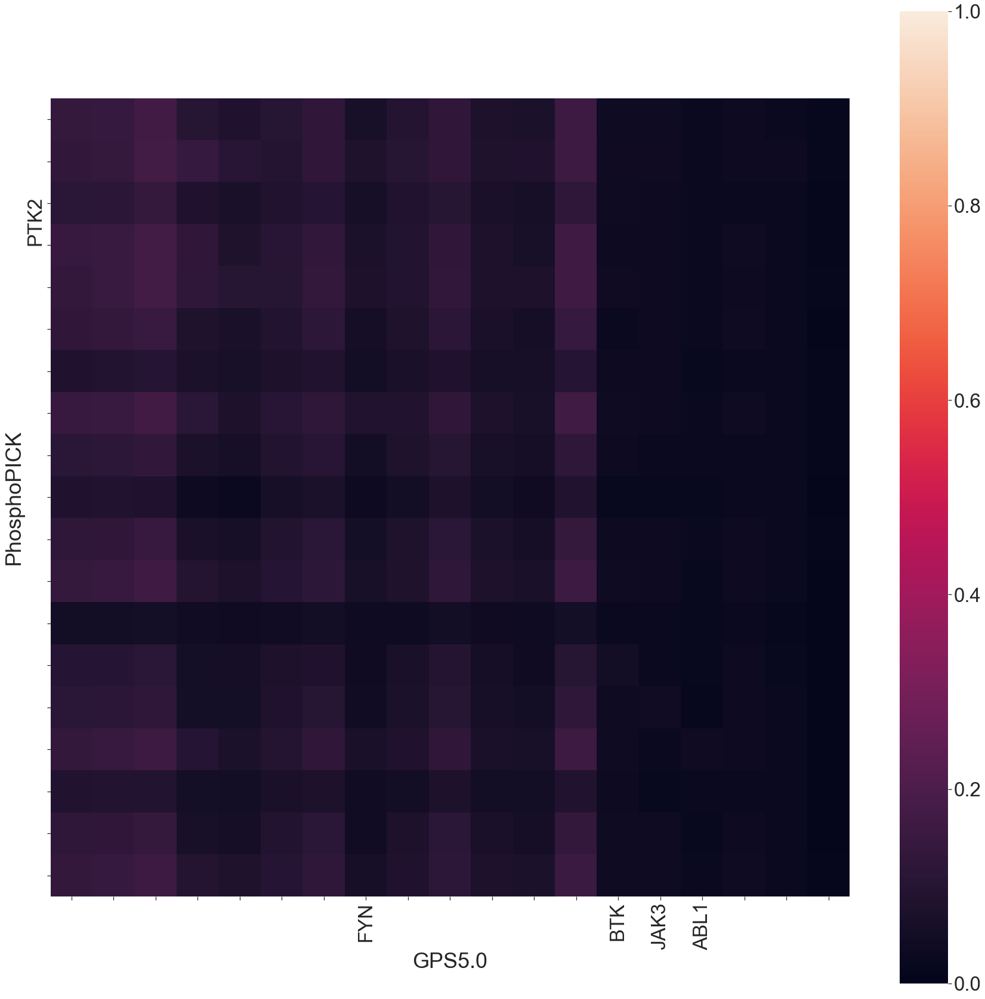

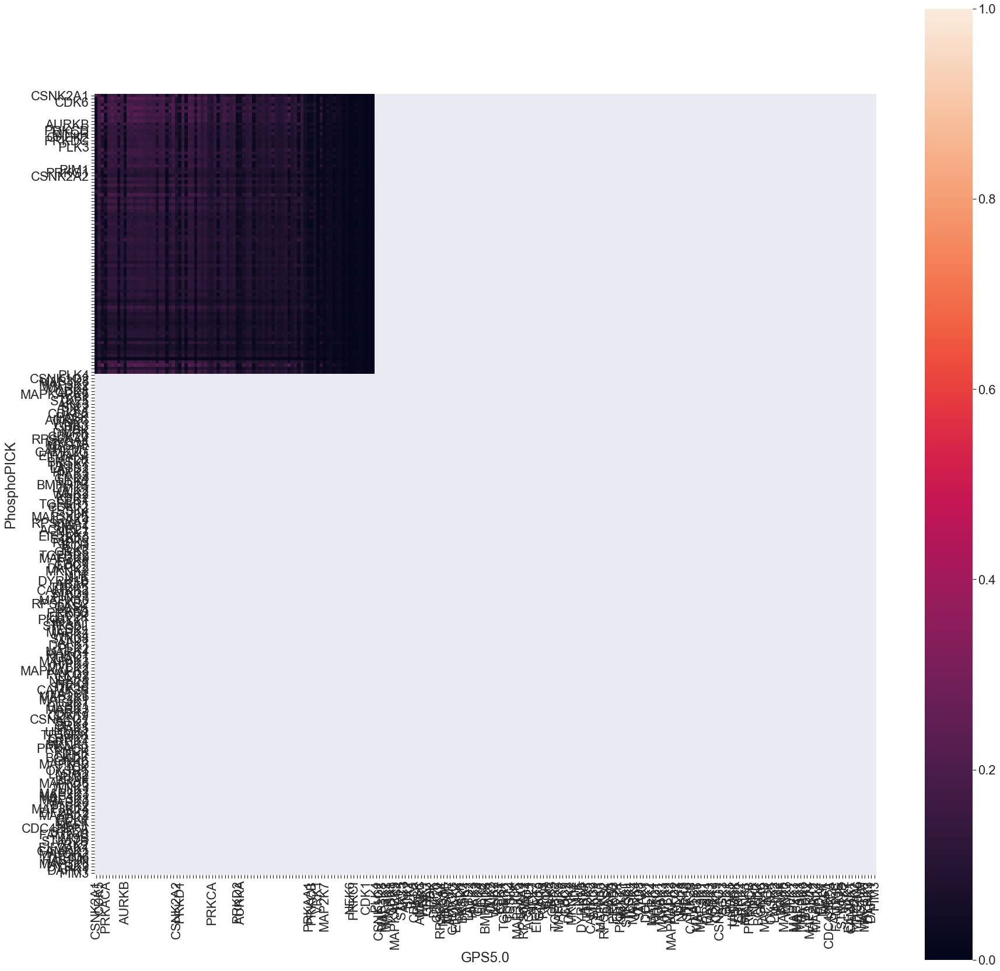

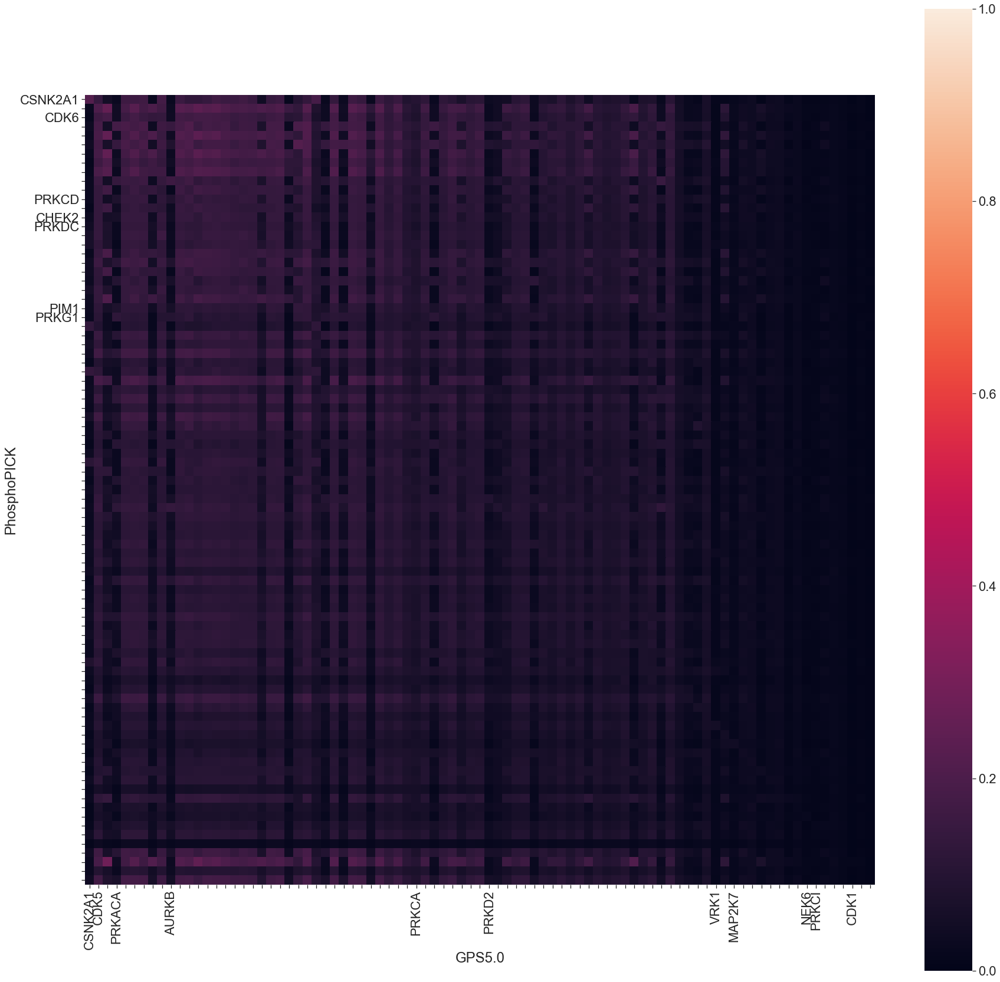

In [60]:
heatmap_y_mx = kinase_mutual_information.between_predictors(pp06_y, gpsh_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_PhosphoPICK_med_vs_GPS5.0_high_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_PhosphoPICK_med_vs_GPS5.0_high_Y_kinase','PhosphoPICK','GPS5.0', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(pp06_st, gpsh_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_PhosphoPICK_med_vs_GPS5.0_high_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_PhosphoPICK_med_vs_GPS5.0_high_ST_kinase', 'PhosphoPICK', 'GPS5.0', 'st')


19 overlapped kinases 
 PhosphoPICK :  19 kinases 
 GPS :  65 kinases 



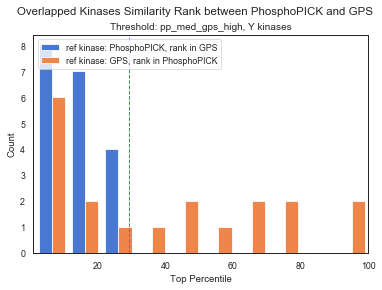

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


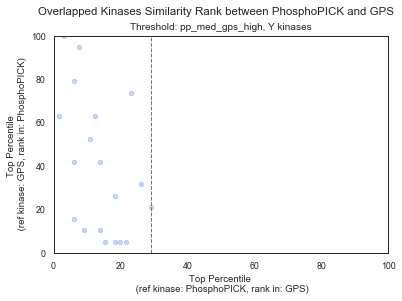

87 overlapped kinases 
 PhosphoPICK :  87 kinases 
 GPS :  243 kinases 



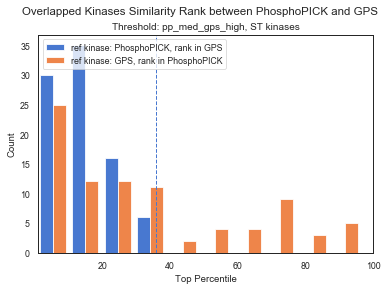

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


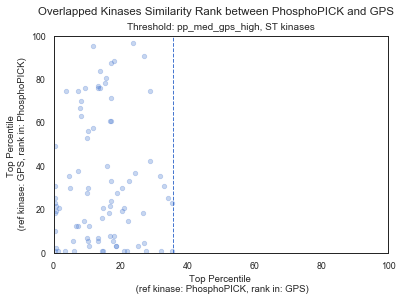

In [36]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_med_vs_GPS5.0_high_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, pp06_y, gpsh_y , 'PhosphoPICK', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_pp_med_gps_high.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'pp', 'gps', 'pp_med_gps_high', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_med_vs_GPS5.0_high_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, pp06_st, gpsh_st , 'PhosphoPICK', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_pp_med_gps_high.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'pp', 'gps', 'pp_med_gps_high', 'ST kinases', rank_dir + d_type + '_')


### PhosphoPICK(0.06) vs GPS(l)
- index: kinases in PhosphoPICK
- column: kinases in GPS

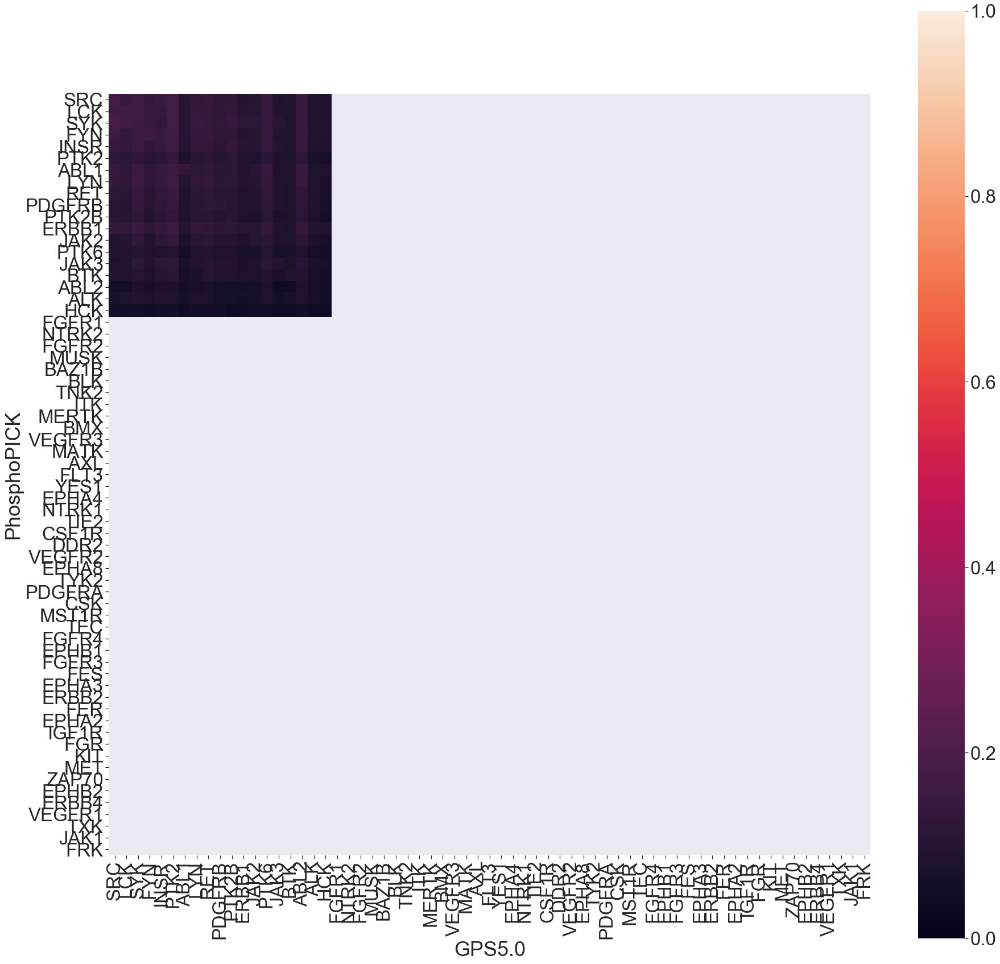

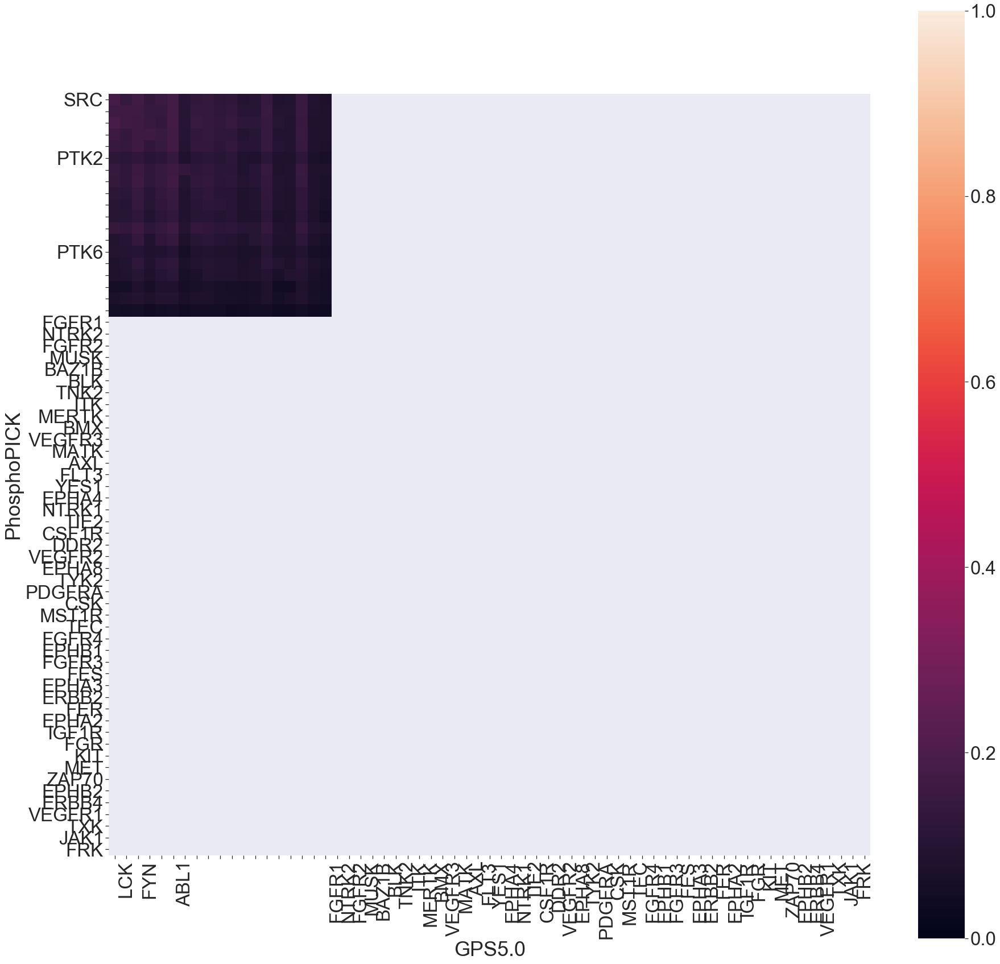

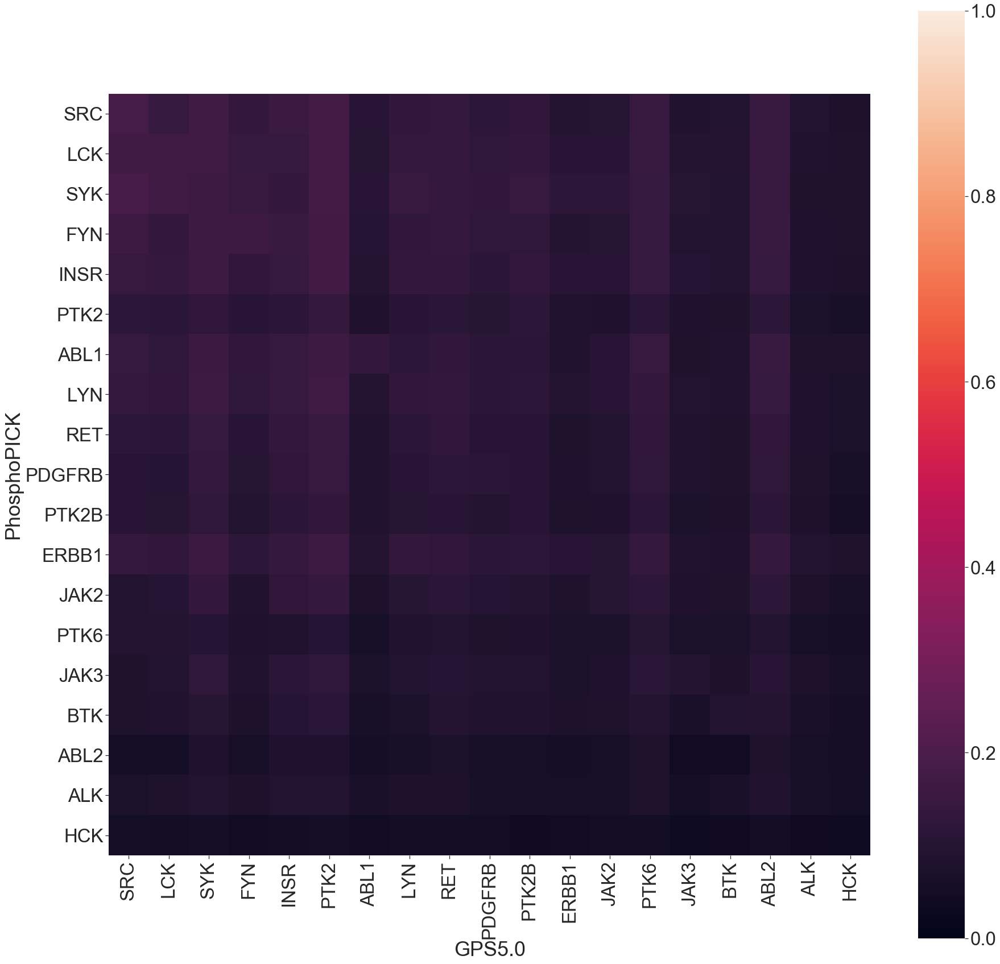

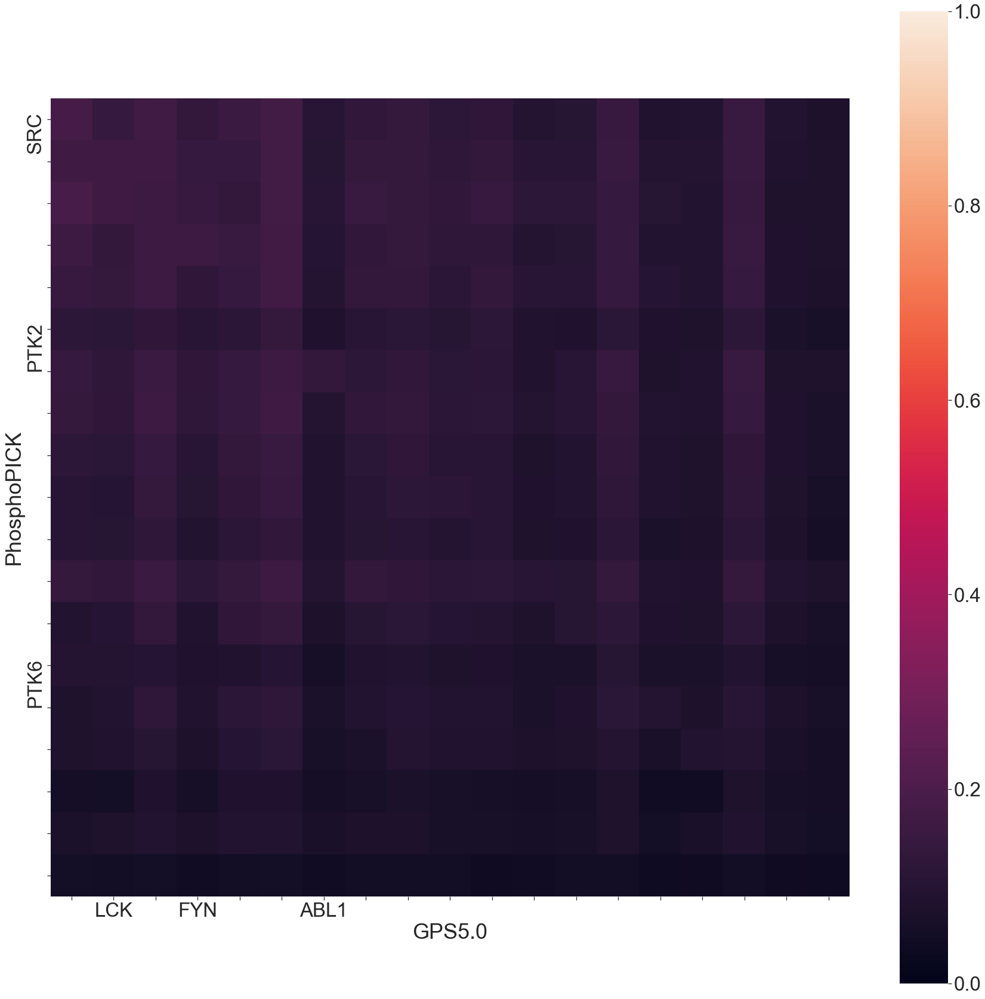

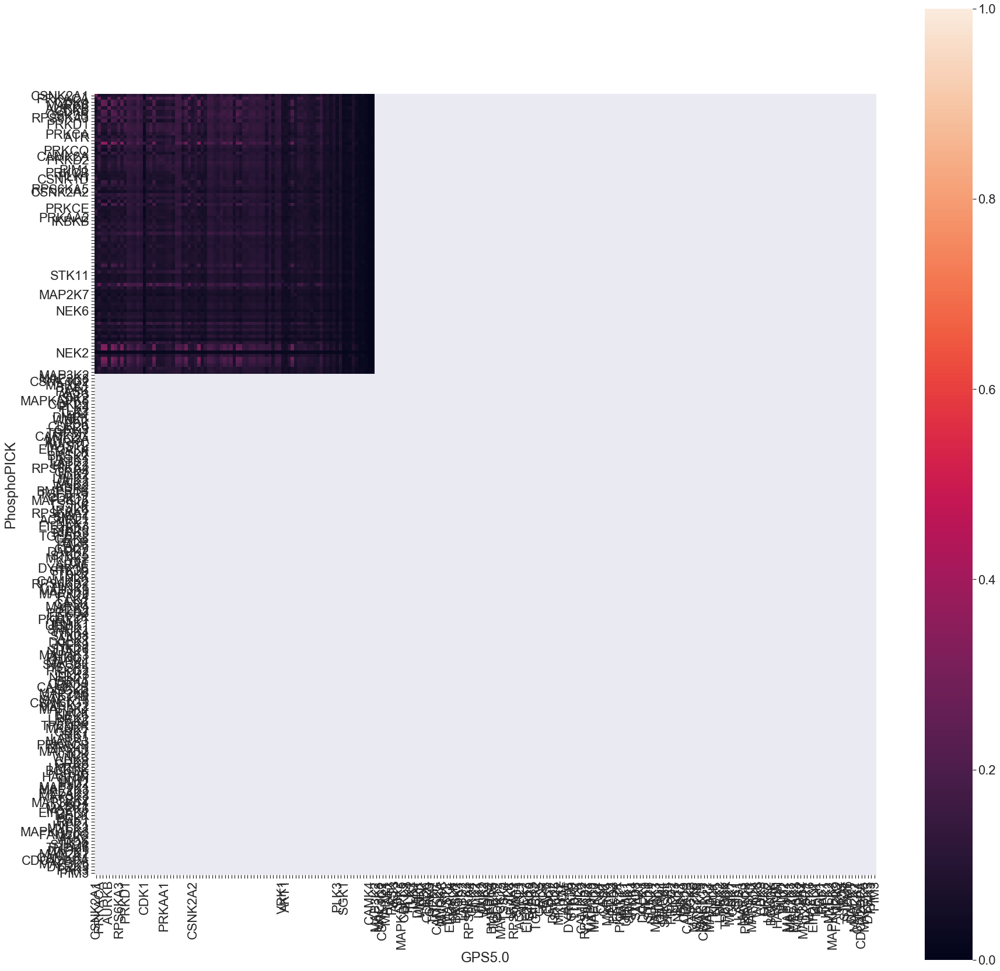

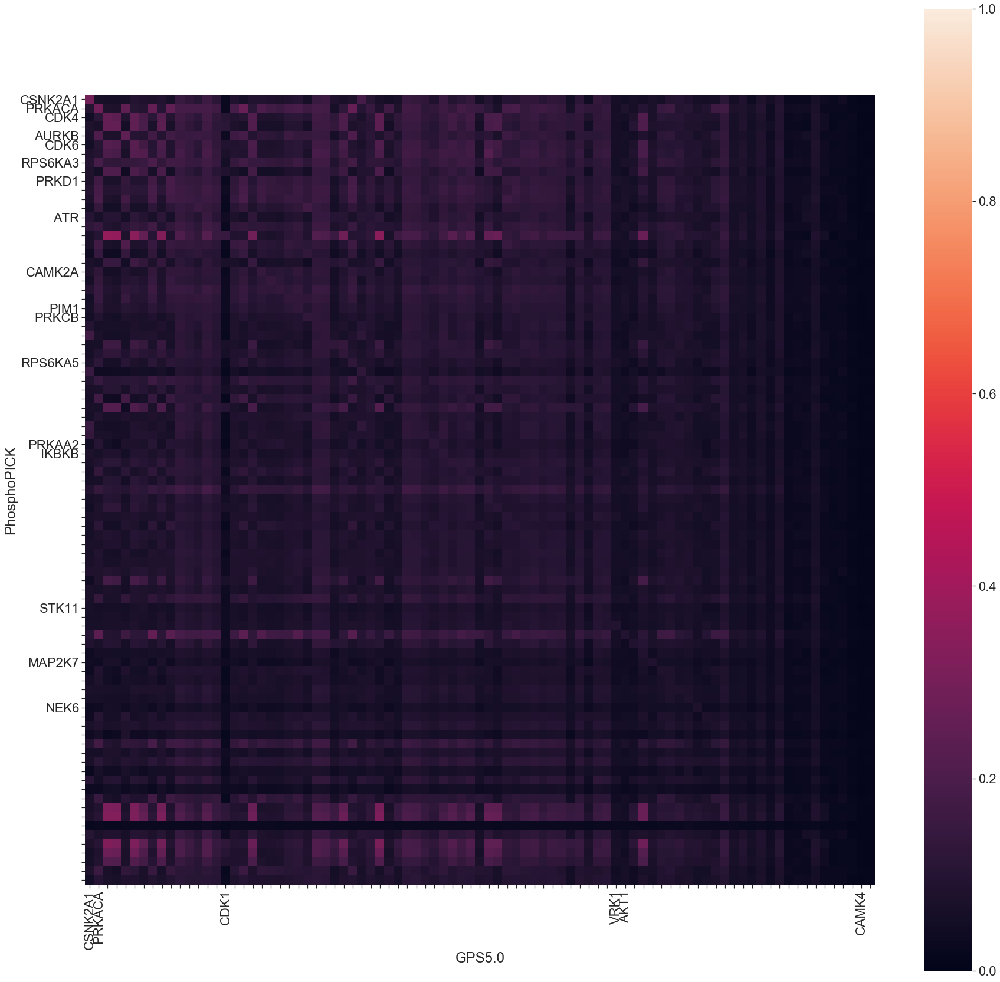

In [62]:
heatmap_y_mx = kinase_mutual_information.between_predictors(pp06_y, gpsl_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_PhosphoPICK_med_vs_GPS5.0_low_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_PhosphoPICK_med_vs_GPS5.0_low_Y_kinase','PhosphoPICK','GPS5.0', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(pp06_st, gpsl_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_PhosphoPICK_med_vs_GPS5.0_low_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_PhosphoPICK_med_vs_GPS5.0_low_ST_kinase', 'PhosphoPICK', 'GPS5.0', 'st')


19 overlapped kinases 
 PhosphoPICK :  19 kinases 
 GPS :  65 kinases 



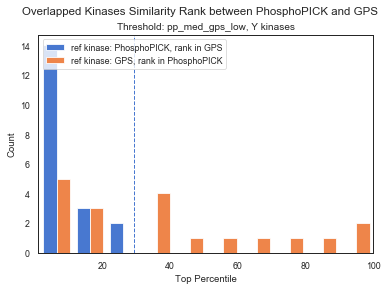

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


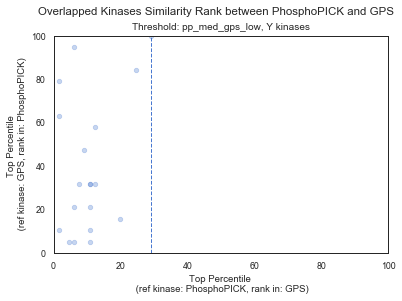

87 overlapped kinases 
 PhosphoPICK :  87 kinases 
 GPS :  243 kinases 



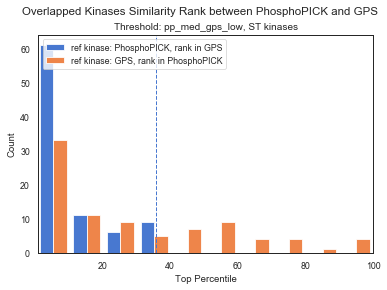

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


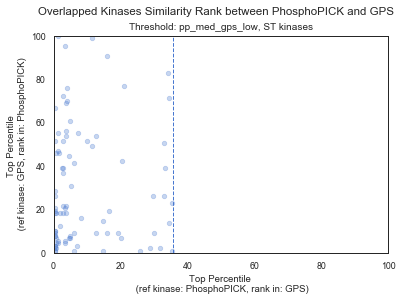

In [35]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_med_vs_GPS5.0_low_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, pp06_y, gpsl_y , 'PhosphoPICK', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_pp_med_gps_low.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'pp', 'gps', 'pp_med_gps_low', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_med_vs_GPS5.0_low_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, pp06_st, gpsl_st , 'PhosphoPICK', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_pp_med_gps_low.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'pp', 'gps', 'pp_med_gps_low', 'ST kinases', rank_dir + d_type + '_')


### PhosphPICK(0.02) vs GPS(l)
- index: kinases in PhosphPICK
- column: kinases in GPS

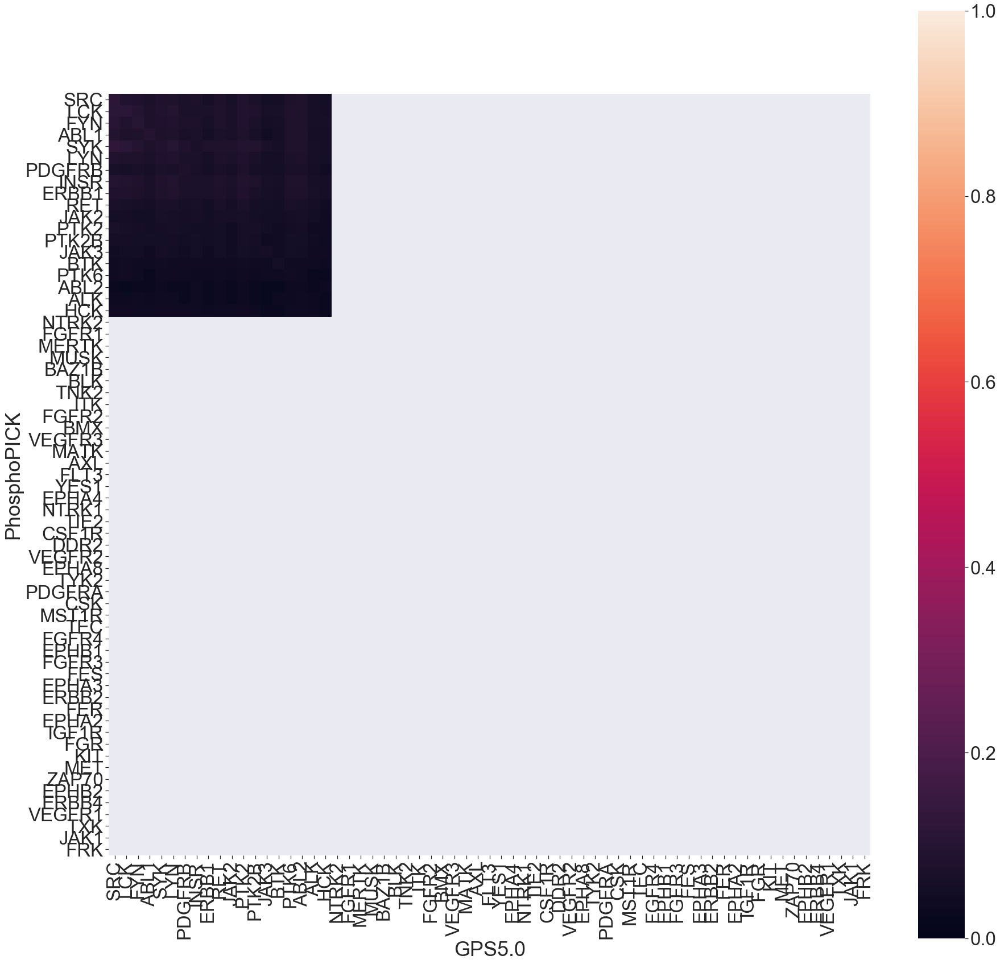

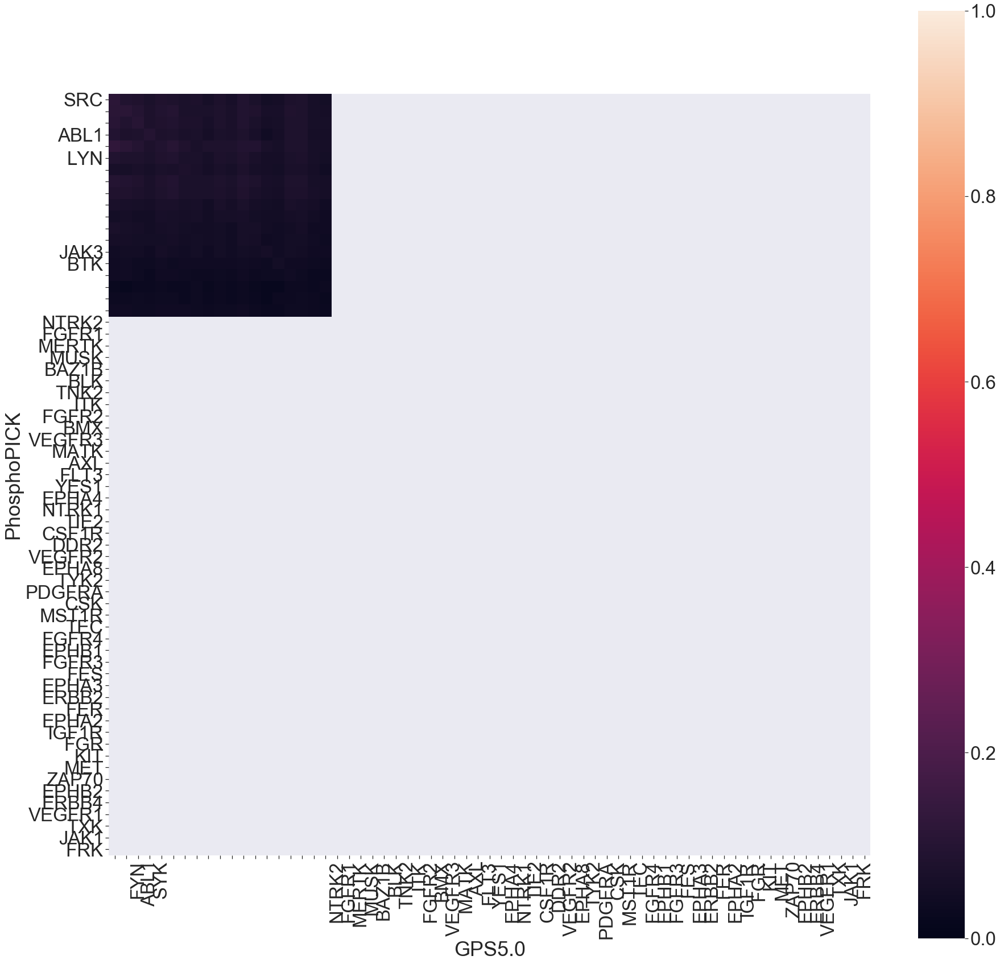

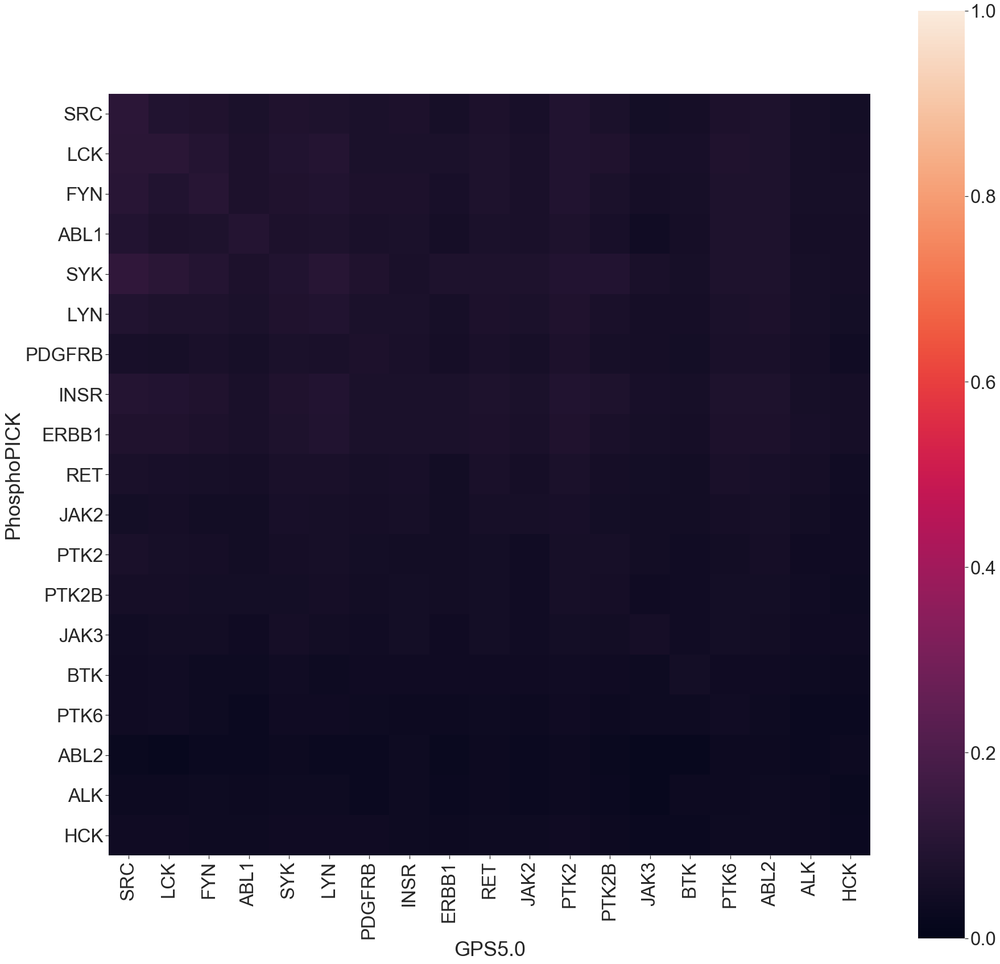

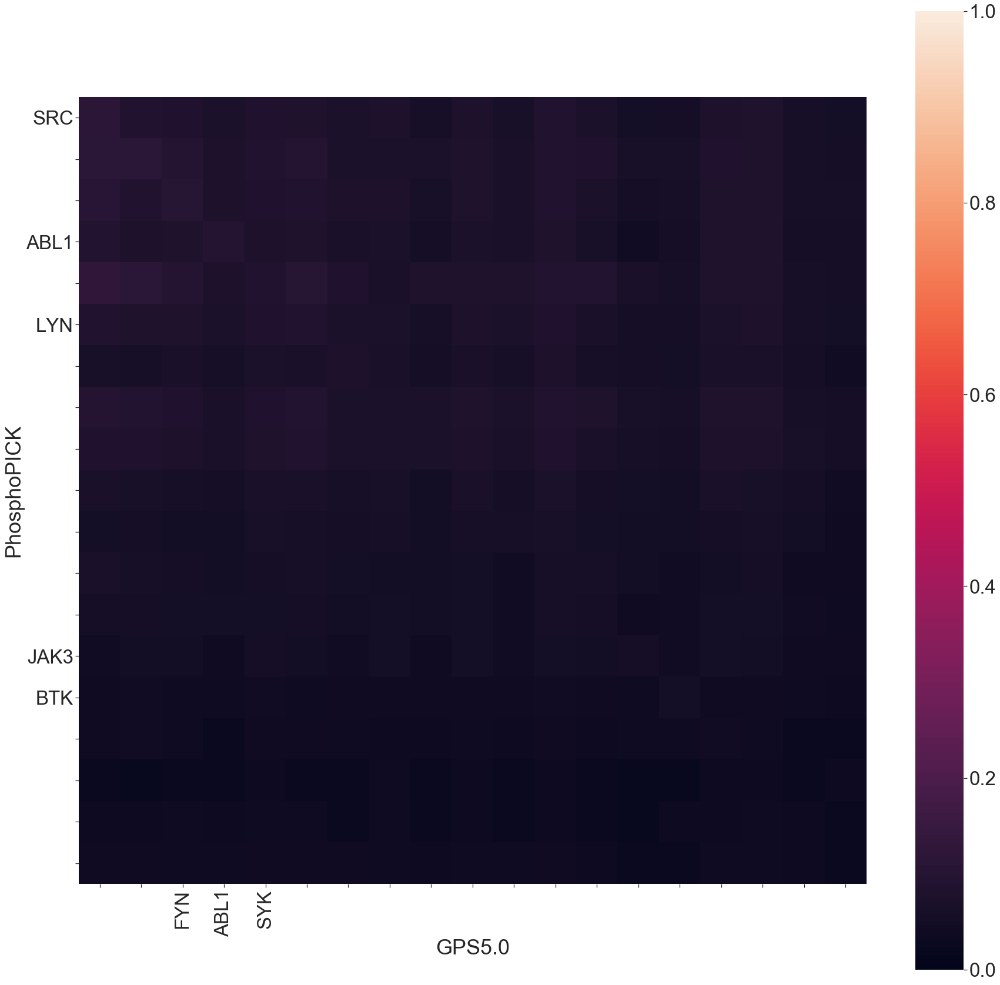

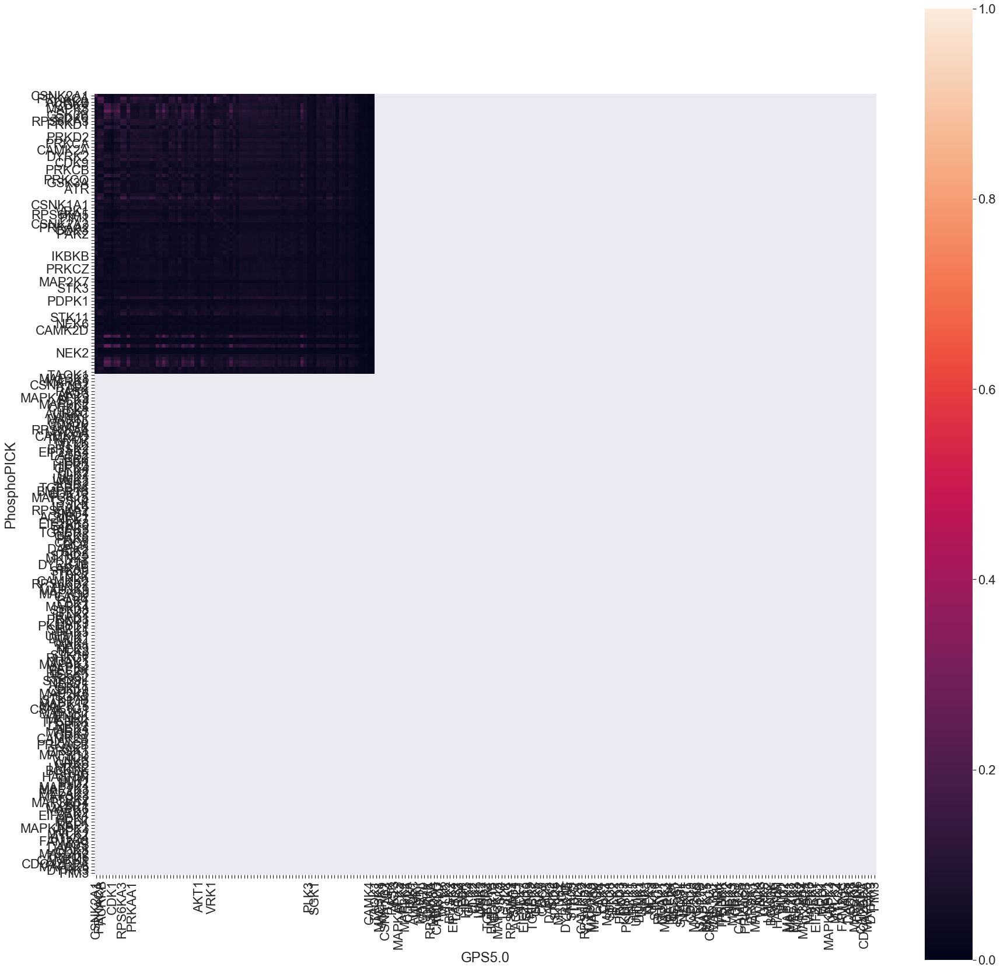

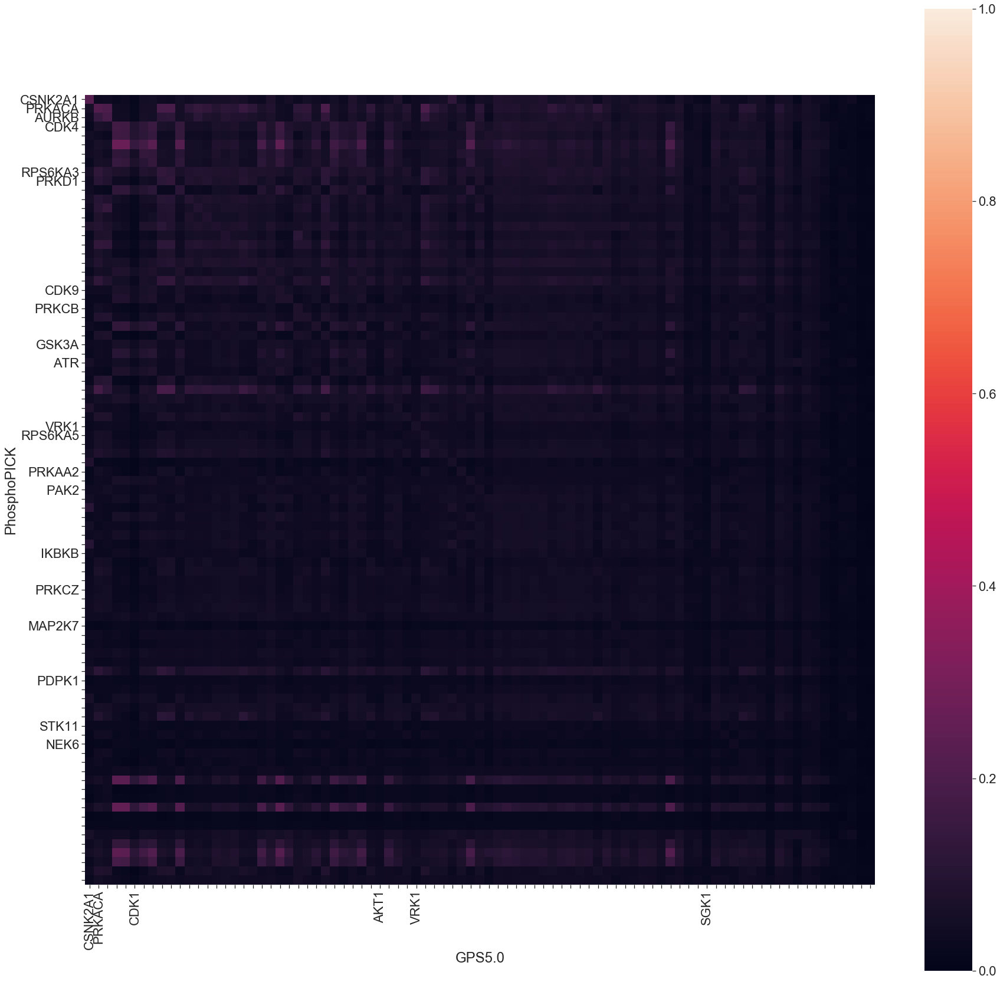

In [64]:
heatmap_y_mx = kinase_mutual_information.between_predictors(pp02_y, gpsl_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_PhosphoPICK_high_vs_GPS5.0_low_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_PhosphoPICK_high_vs_GPS5.0_low_Y_kinase','PhosphoPICK','GPS5.0', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(pp02_st, gpsl_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_PhosphoPICK_high_vs_GPS5.0_low_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_PhosphoPICK_high_vs_GPS5.0_low_ST_kinase', 'PhosphoPICK', 'GPS5.0', 'st')


19 overlapped kinases 
 PhosphoPICK :  19 kinases 
 GPS :  65 kinases 



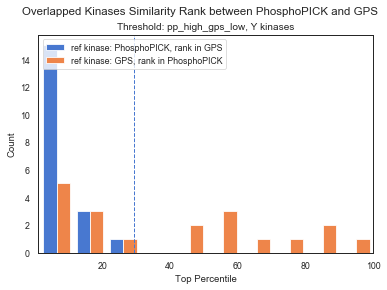

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


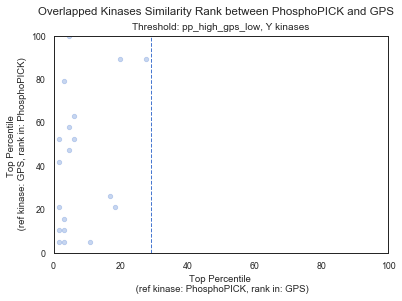

87 overlapped kinases 
 PhosphoPICK :  87 kinases 
 GPS :  243 kinases 



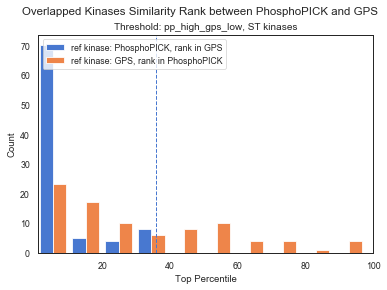

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


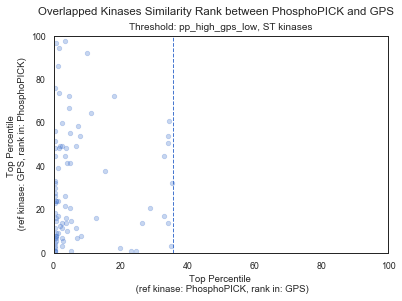

In [34]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_high_vs_GPS5.0_low_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, pp02_y, gpsl_y , 'PhosphoPICK', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_pp_high_gps_low.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'pp', 'gps', 'pp_high_gps_low', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_high_vs_GPS5.0_low_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, pp02_st, gpsl_st , 'PhosphoPICK', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_pp_high_gps_low.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'pp', 'gps', 'pp_high_gps_low', 'ST kinases', rank_dir + d_type + '_')


### PhosphPICK(0.02) vs GPS(m)
- index: kinases in PhosphPICK
- column: kinases in GPS

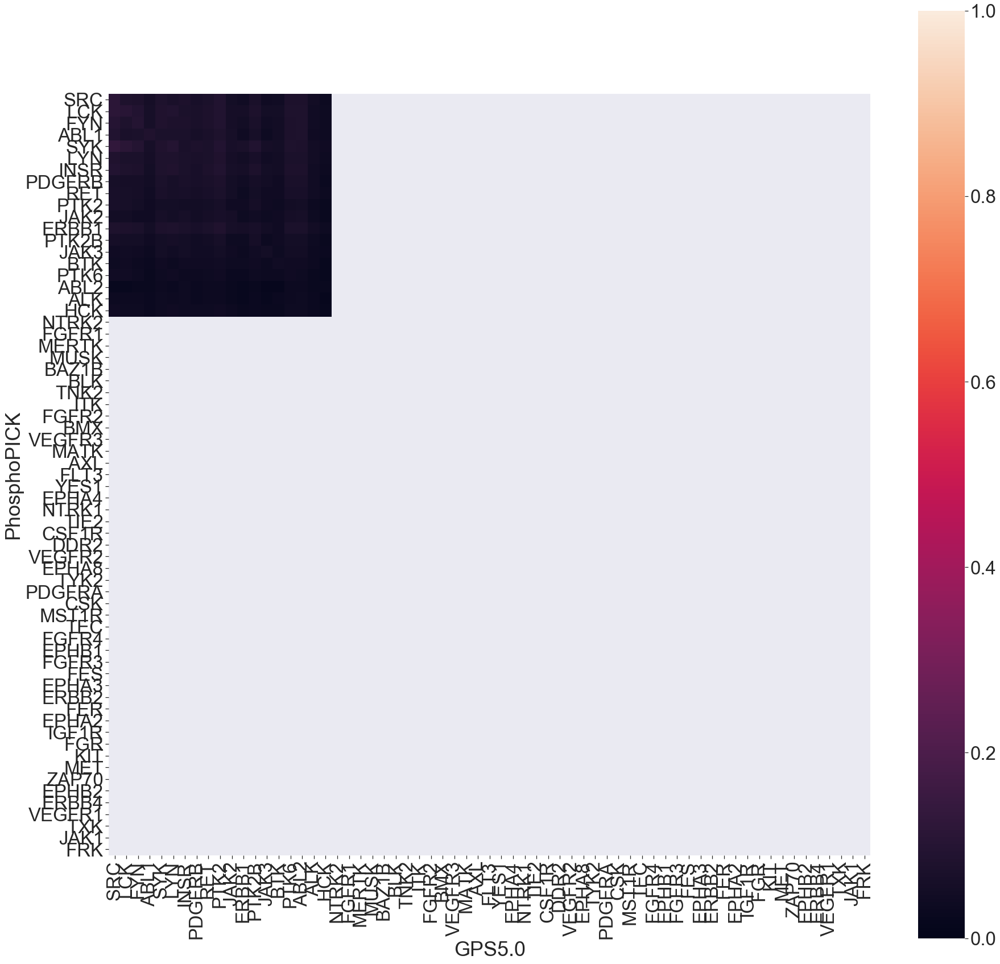

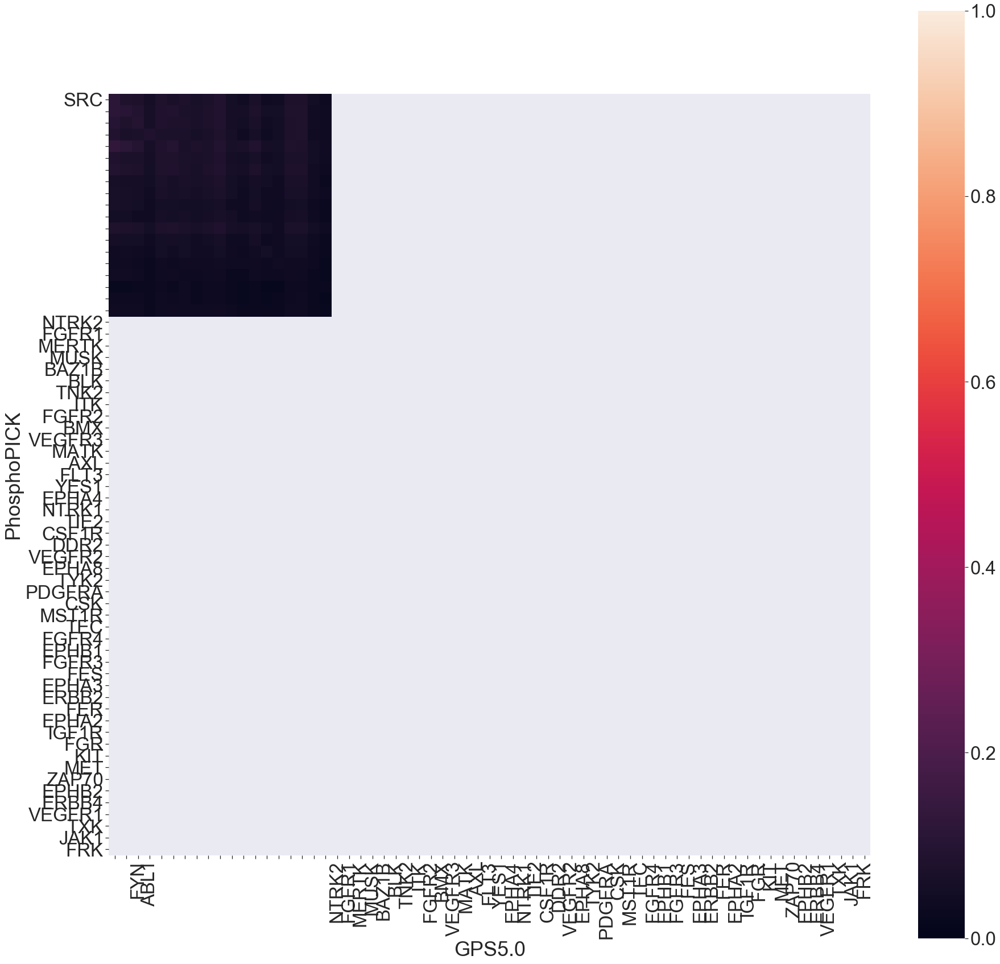

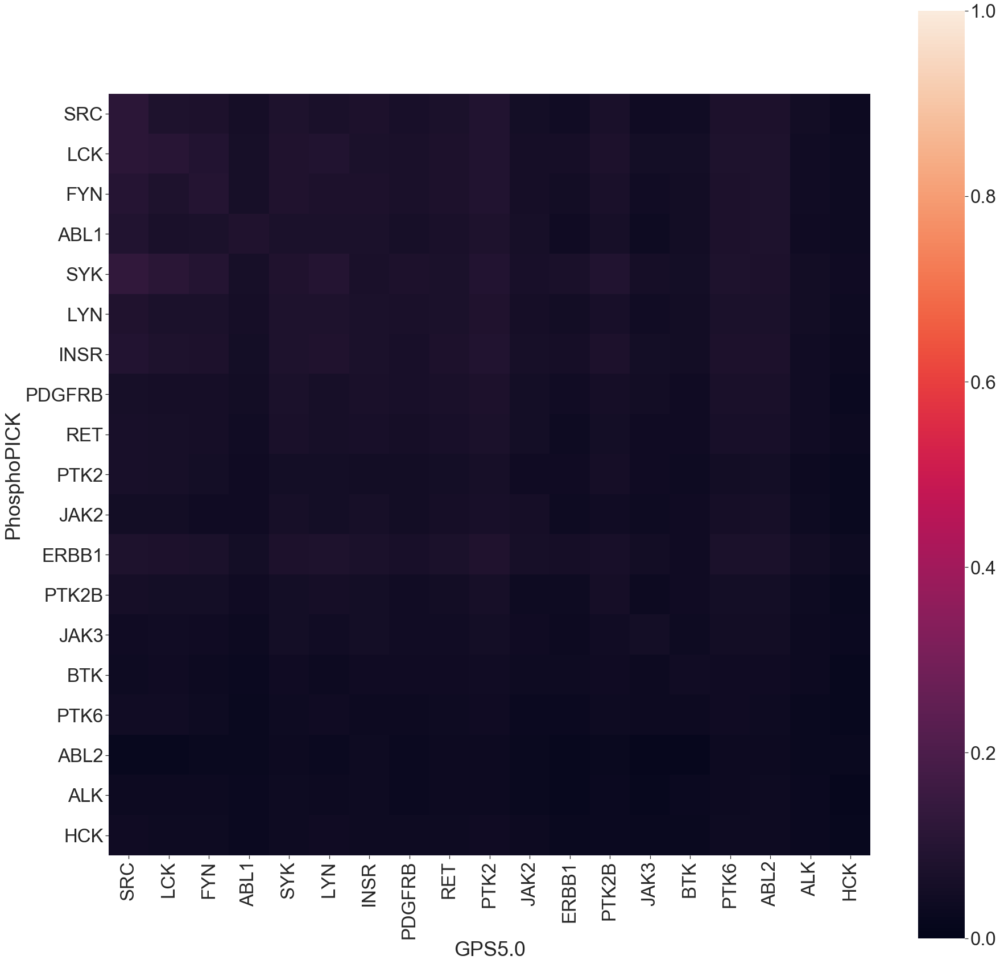

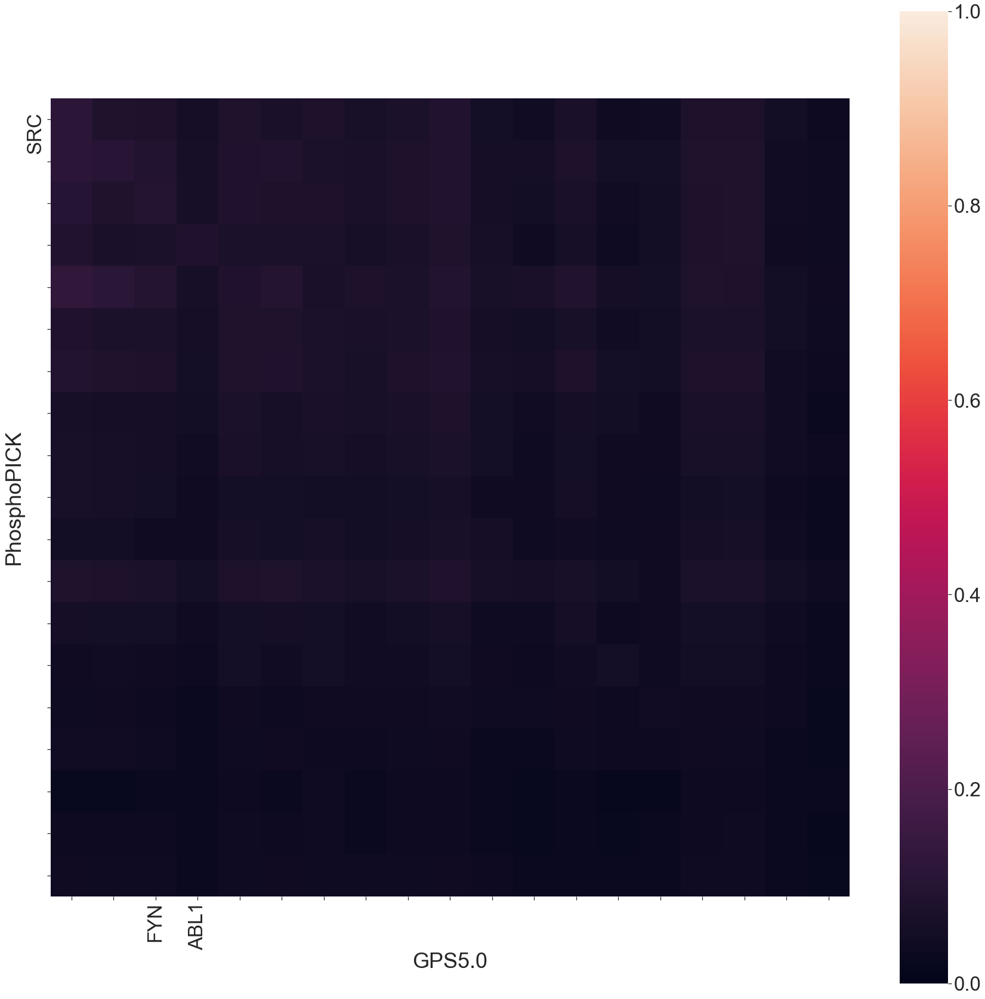

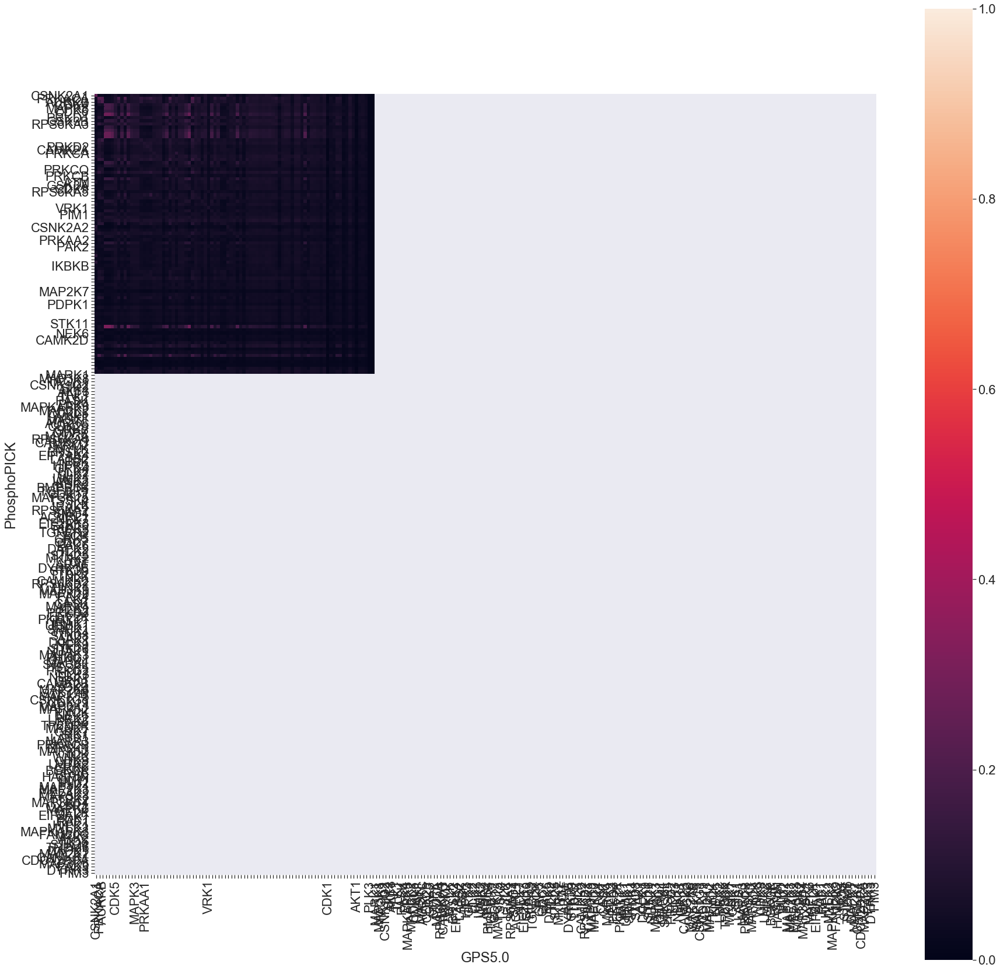

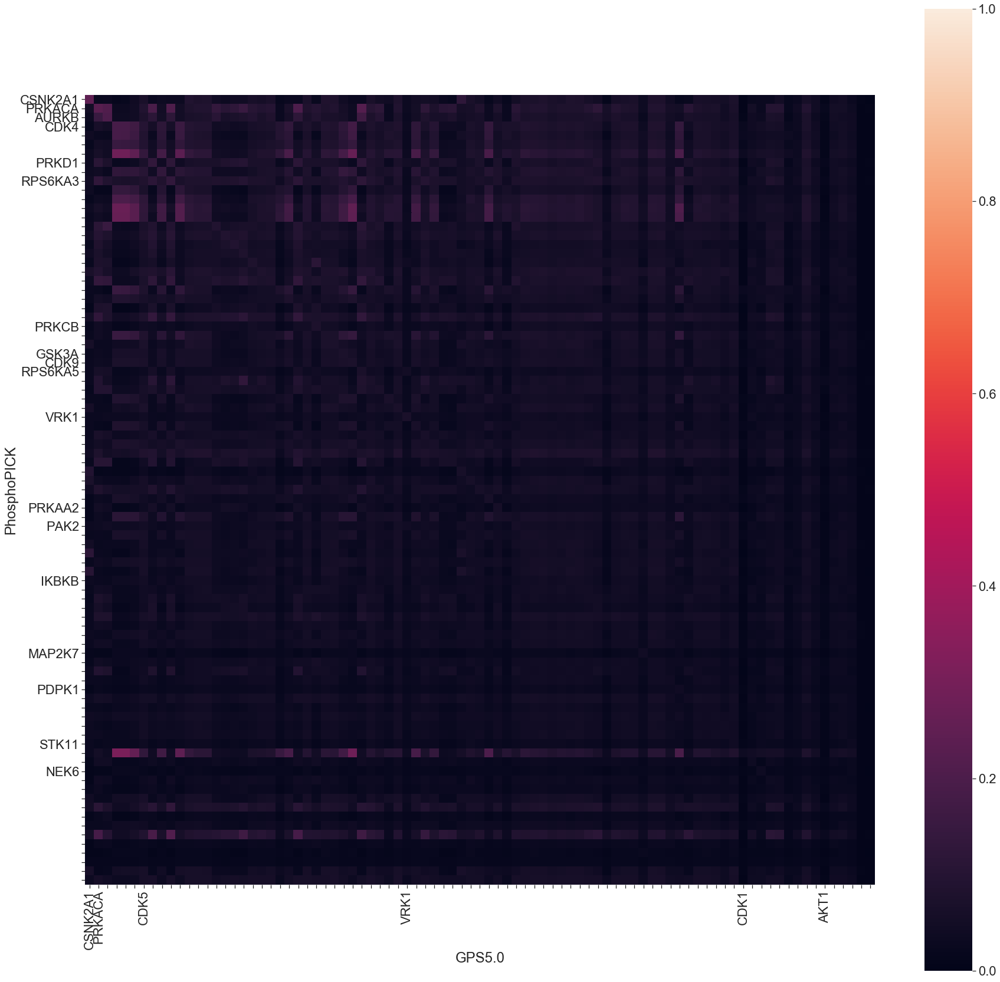

In [66]:
heatmap_y_mx = kinase_mutual_information.between_predictors(pp02_y, gpsm_y, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_PhosphoPICK_high_vs_GPS5.0_med_Y_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_y_mx, heatmap_p_dir + d_type +'_PhosphoPICK_high_vs_GPS5.0_med_Y_kinase','PhosphoPICK','GPS5.0', 'y')

heatmap_st_mx = kinase_mutual_information.between_predictors(pp02_st, gpsm_st, 'Kinase Name', 'substrate_id', heatmap_p_data_dir + d_type +'_PhosphoPICK_high_vs_GPS5.0_med_ST_kinase_heatmap_df')
plot_kinase_heatmap.plot_kinase_heatmap(heatmap_st_mx, heatmap_p_dir + d_type +'_PhosphoPICK_high_vs_GPS5.0_med_ST_kinase', 'PhosphoPICK', 'GPS5.0', 'st')


19 overlapped kinases 
 PhosphoPICK :  19 kinases 
 GPS :  65 kinases 



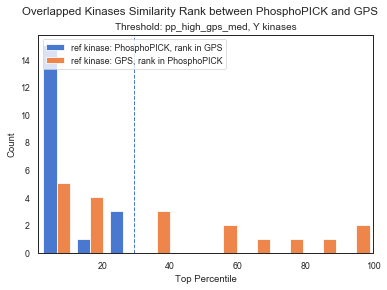

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


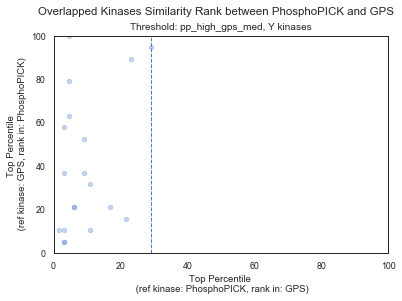

87 overlapped kinases 
 PhosphoPICK :  87 kinases 
 GPS :  243 kinases 



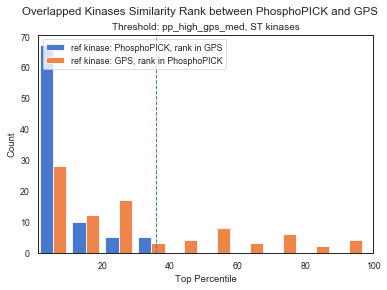

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


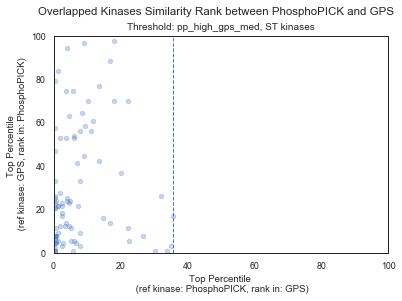

In [33]:
heatmap_y_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_high_vs_GPS5.0_med_Y_kinase_heatmap_df.csv', index_col = 0)
kin_rank_y = sameKinase_rank.kinase_rank(heatmap_y_mx, pp02_y, gpsm_y , 'PhosphoPICK', 'GPS' )
kin_rank_y.to_csv(rank_data_dir + d_type +'_Y_pp_high_gps_med.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_y, 'pp', 'gps', 'pp_high_gps_med', 'Y kinases', rank_dir + d_type + '_')

heatmap_st_mx = pd.read_csv(heatmap_p_data_dir + d_type +'_PhosphoPICK_high_vs_GPS5.0_med_ST_kinase_heatmap_df.csv', index_col = 0)
kin_rank_st = sameKinase_rank.kinase_rank(heatmap_st_mx, pp02_st, gpsm_st , 'PhosphoPICK', 'GPS' )
kin_rank_st.to_csv(rank_data_dir + d_type +'_ST_pp_high_gps_med.csv')
plot_sameKinase_rank.plot_rank_relation (kin_rank_st, 'pp', 'gps', 'pp_high_gps_med', 'ST kinases', rank_dir + d_type + '_')


### CDFs for the same-kinase ranking (mixed stringencies comparisom)

In [9]:
# NetworKIN vs. GPS
df1_y = pd.read_csv(rank_data_dir + d_type + '_low_Y_nw_gps.csv')
df2_y = pd.read_csv(rank_data_dir + d_type + '_Y_nw_low_gps_med.csv')
df3_y = pd.read_csv(rank_data_dir + d_type + '_Y_nw_low_gps_high.csv')
df4_y = pd.read_csv(rank_data_dir + d_type + '_Y_nw_med_gps_low.csv')
df5_y = pd.read_csv(rank_data_dir + d_type + '_med_Y_nw_gps.csv')
df6_y = pd.read_csv(rank_data_dir + d_type + '_Y_nw_med_gps_high.csv')
df7_y = pd.read_csv(rank_data_dir + d_type + '_Y_nw_high_gps_low.csv')
df8_y = pd.read_csv(rank_data_dir + d_type + '_Y_nw_high_gps_med.csv')
df9_y = pd.read_csv(rank_data_dir + d_type + '_high_Y_nw_gps.csv')
dfs_y_nw_gps = [df1_y, df2_y, df3_y, df4_y, df5_y, df6_y, df7_y, df8_y, df9_y]

df1_st = pd.read_csv(rank_data_dir + d_type + '_low_ST_nw_gps.csv')
df2_st = pd.read_csv(rank_data_dir + d_type + '_ST_nw_low_gps_med.csv')
df3_st = pd.read_csv(rank_data_dir + d_type + '_ST_nw_low_gps_high.csv')
df4_st = pd.read_csv(rank_data_dir + d_type + '_ST_nw_med_gps_low.csv')
df5_st = pd.read_csv(rank_data_dir + d_type + '_med_ST_nw_gps.csv')
df6_st = pd.read_csv(rank_data_dir + d_type + '_ST_nw_med_gps_high.csv')
df7_st = pd.read_csv(rank_data_dir + d_type + '_ST_nw_high_gps_low.csv')
df8_st = pd.read_csv(rank_data_dir + d_type + '_ST_nw_high_gps_med.csv')
df9_st = pd.read_csv(rank_data_dir + d_type + '_high_ST_nw_gps.csv')
dfs_st_nw_gps = [df1_st, df2_st, df3_st, df4_st, df5_st, df6_st, df7_st, df8_st, df9_st]


In [8]:
# NetworKIN vs. PhosphoPICK
# Y kinase
df1_y = pd.read_csv(rank_data_dir + d_type + '_low_Y_nw_pp.csv')
df2_y = pd.read_csv(rank_data_dir + d_type + '_Y_nw_low_pp_med.csv')
df3_y = pd.read_csv(rank_data_dir + d_type + '_Y_nw_low_pp_high.csv')
df4_y = pd.read_csv(rank_data_dir + d_type + '_Y_nw_med_pp_low.csv')
df5_y = pd.read_csv(rank_data_dir + d_type + '_med_Y_nw_pp.csv')
df6_y = pd.read_csv(rank_data_dir + d_type + '_Y_nw_med_pp_high.csv')
df7_y = pd.read_csv(rank_data_dir + d_type + '_Y_nw_high_pp_low.csv')
df8_y = pd.read_csv(rank_data_dir + d_type + '_Y_nw_high_pp_med.csv')
df9_y = pd.read_csv(rank_data_dir + d_type + '_high_Y_nw_pp.csv')
dfs_y_nw_pp = [df1_y, df2_y, df3_y, df4_y, df5_y, df6_y, df7_y, df8_y, df9_y]

# S/T kinase
df1_st = pd.read_csv(rank_data_dir + d_type + '_low_ST_nw_pp.csv')
df2_st = pd.read_csv(rank_data_dir + d_type + '_ST_nw_low_pp_med.csv')
df3_st = pd.read_csv(rank_data_dir + d_type + '_ST_nw_low_pp_high.csv')
df4_st = pd.read_csv(rank_data_dir + d_type + '_ST_nw_med_pp_low.csv')
df5_st = pd.read_csv(rank_data_dir + d_type + '_med_ST_nw_pp.csv')
df6_st = pd.read_csv(rank_data_dir + d_type + '_ST_nw_med_pp_high.csv')
df7_st = pd.read_csv(rank_data_dir + d_type + '_ST_nw_high_pp_low.csv')
df8_st = pd.read_csv(rank_data_dir + d_type + '_ST_nw_high_pp_med.csv')
df9_st = pd.read_csv(rank_data_dir + d_type + '_high_ST_nw_pp.csv')
dfs_st_nw_pp = [df1_st, df2_st, df3_st, df4_st, df5_st, df6_st, df7_st, df8_st, df9_st]


In [10]:
# PhosphoPICK vs. GPS
df1_y = pd.read_csv(rank_data_dir + d_type + '_low_Y_pp_gps.csv')
df2_y = pd.read_csv(rank_data_dir + d_type + '_Y_pp_low_gps_med.csv')
df3_y = pd.read_csv(rank_data_dir + d_type + '_Y_pp_low_gps_high.csv')
df4_y = pd.read_csv(rank_data_dir + d_type + '_Y_pp_med_gps_low.csv')
df5_y = pd.read_csv(rank_data_dir + d_type + '_med_Y_pp_gps.csv')
df6_y = pd.read_csv(rank_data_dir + d_type + '_Y_pp_med_gps_high.csv')
df7_y = pd.read_csv(rank_data_dir + d_type + '_Y_pp_high_gps_low.csv')
df8_y = pd.read_csv(rank_data_dir + d_type + '_Y_pp_high_gps_med.csv')
df9_y = pd.read_csv(rank_data_dir + d_type + '_high_Y_pp_gps.csv')
dfs_y_pp_gps = [df1_y, df2_y, df3_y, df4_y, df5_y, df6_y, df7_y, df8_y, df9_y]

df1_st = pd.read_csv(rank_data_dir + d_type + '_low_ST_pp_gps.csv')
df2_st = pd.read_csv(rank_data_dir + d_type + '_ST_pp_low_gps_med.csv')
df3_st = pd.read_csv(rank_data_dir + d_type + '_ST_pp_low_gps_high.csv')
df4_st = pd.read_csv(rank_data_dir + d_type + '_ST_pp_med_gps_low.csv')
df5_st = pd.read_csv(rank_data_dir + d_type + '_med_ST_pp_gps.csv')
df6_st = pd.read_csv(rank_data_dir + d_type + '_ST_pp_med_gps_high.csv')
df7_st = pd.read_csv(rank_data_dir + d_type + '_ST_pp_high_gps_low.csv')
df8_st = pd.read_csv(rank_data_dir + d_type + '_ST_pp_high_gps_med.csv')
df9_st = pd.read_csv(rank_data_dir + d_type + '_high_ST_pp_gps.csv')
dfs_st_pp_gps  = [df1_st, df2_st, df3_st, df4_st, df5_st, df6_st, df7_st, df8_st, df9_st]


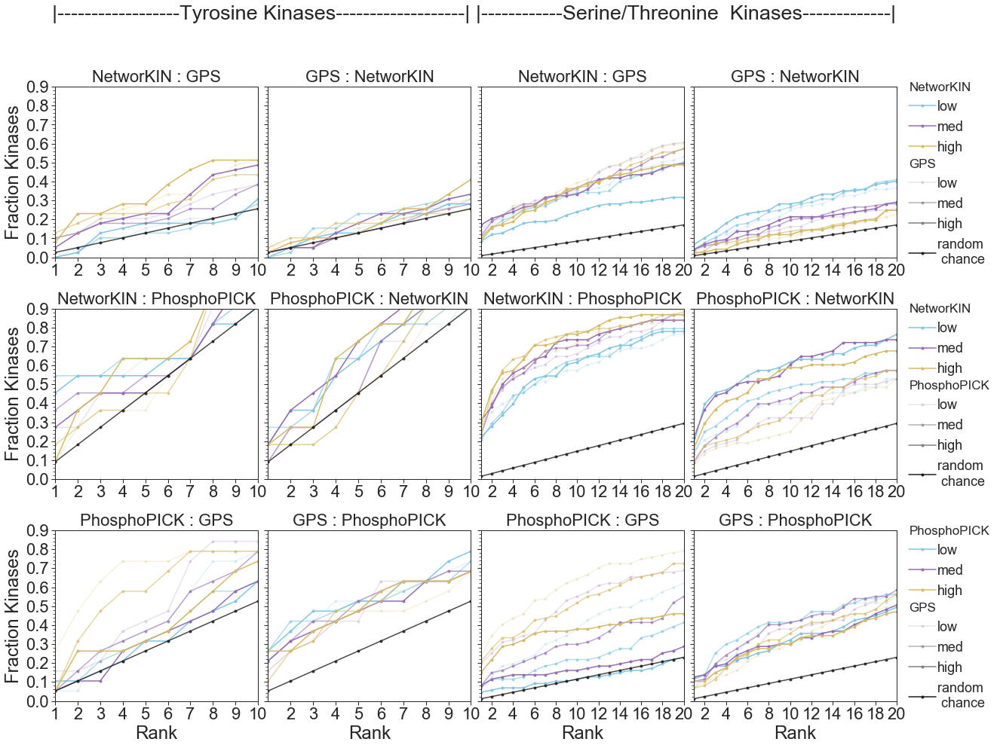

In [11]:
dfs = [dfs_y_nw_gps, dfs_st_nw_gps,
       dfs_y_nw_pp, dfs_st_nw_pp,
       dfs_y_pp_gps, dfs_st_pp_gps]

plot_sameKinase_rank.plot_rank_density (dfs, rank_dir + d_type + '_')